# First Step: Filtering signal noise

In [1]:
pip install PyWavelets obspy

In [2]:
# Importar las librerías necesarias
import math
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.signal import butter, filtfilt
from datetime import datetime
import os
import numpy as np
import pandas as pd
from obspy import read
from datetime import datetime, timedelta
import matplotlib.pyplot as plt
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import pywt
import sys

# Montar Google Drive
from google.colab import drive
drive.mount('/content/drive')

# Directorio y archivo del catálogo
cat_directory = '/content/drive/MyDrive/data/lunar/training/catalogs/'
cat_file = os.path.join(cat_directory, 'apollo12_catalog_GradeA_final.csv')

# Lectura del catálogo
cat = pd.read_csv(cat_file)

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
pip install ruptures

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 26.7 MB/s eta 0:00:00


In [4]:
import numpy as np
import pandas as pd
import os
from scipy.fft import fft, ifft
from ruptures import Binseg


In [5]:
def procesar_senal(file_path,window_size,downs):
    """
    Processes a signal from a given file, applies filtering and smoothing, and saves the result in a CSV file.

    Parameters:
    - file_path: Full path to the input file.

    The output file will have the same name as the input file, with '_filtered' added before the extension.
    """
    # Read the file size
    file_size = os.path.getsize(file_path) / (1024 * 1024)  # Size in MB
    use_advanced_plot = file_size <= 6  # Use advanced plots if the file is 6 MB or less

    # Read data from the file, ignoring the first row (header)
    try:
        # Load the CSV file without header, reading by column index
        df = pd.read_csv(file_path , header=0)
        # Ensure that there are at least three columns
        if df.shape[1] < 3:
            print("The file does not contain at least three columns.")
            return
        # Extract the necessary columns by index
        # It is assumed that the first column (index 0) is the date
        # The second column (index 1) is the relative time
        # The third column (index 2) is the velocity
        time = df.iloc[:, 1]
        f = df.iloc[:, 2]
        if ("lunar" in file_path):
          time = time.iloc[::downs].reset_index(drop=True)
          f = f.iloc[::downs].reset_index(drop=True)
        time = time.to_numpy()
        f = f.to_numpy()

    except Exception as e:
        print(f"Error loading the file: {e}")
        return

    # Ensure there is enough data
    if len(time) < 2 or len(f) < 2:
        print("The file does not contain enough data to process.")
        return

    # Sampling frequency
    dt = time[1] - time[0]  # Time interval
    Fs = 1 / dt  # Sampling frequency

    # --- Automatic change-point detection for segmentation ---

    # Convert the signal to a suitable format for 'ruptures'
    signal = f.reshape(-1, 1)

    # Instantiate the segmentation model (we will use the Binseg algorithm)
    model = "l2"  # Model for changes in mean and variance
    algo = Binseg(model=model)

    # Set the maximum number of changes to detect
    max_changes = 5  # You can adjust this value as needed

    # Fit the model to the signal
    algo.fit(signal)

    # Get the breakpoints (change points)
    result = algo.predict(n_bkps=max_changes)

    # The breakpoints give us the indices where to segment the signal
    # The segments are defined between the breakpoints
    breakpoints = [0] + result  # Add the start of the signal

    # Ensure there are no empty or very small segments
    min_segment_length = 0  # You can adjust this value
    segments_indices = []
    for i in range(len(breakpoints)-1):
        start = breakpoints[i]
        end = breakpoints[i+1]
        if end - start >= min_segment_length:
            segments_indices.append((start, end))

    # If not enough segments are detected, divide the signal into at least 2
    if len(segments_indices) < 1:
        segments_indices = [(0, len(f)//2), (len(f)//2, len(f))]

    # Create lists to store the segments
    segments_f = [f[start:end] for start, end in segments_indices]
    segments_time = [time[start:end] for start, end in segments_indices]

    # Energy threshold
    energy_threshold = 0.80  # You can adjust this value or request it from the user

    # Lists to store data for each segment
    filtered_segments = []
    energies = []
    low_freqs = []
    high_freqs = []
    segment_data_list = []

    def process_segment(f_segment, Fs, energy_threshold):
        N = len(f_segment)
        f_fft = fft(f_segment)
        f_abs = np.abs(f_fft / N)
        f_single_sided = f_abs[:N//2+1]
        if len(f_single_sided) > 2:
            f_single_sided[1:-1] = 2 * f_single_sided[1:-1]

        frequencies = Fs * np.arange(0, N//2+1) / N

        harmonics = f_single_sided

        energy_total = np.sum(harmonics ** 2)
        energy_cumulative = np.cumsum(harmonics ** 2) / energy_total

        # Low and high cutoff frequencies
        low_freq_idx = np.where(energy_cumulative >= (1 - energy_threshold))[0][0]
        high_freq_idx = np.where(energy_cumulative >= energy_threshold)[0][0]

        low_freq = frequencies[low_freq_idx]
        high_freq = frequencies[high_freq_idx]

        return {
            'f_fft': f_fft,
            'frequencies': frequencies,
            'harmonics': harmonics,
            'energy_total': energy_total,
            'low_freq': low_freq,
            'high_freq': high_freq,
            'N': N
        }

    # Process each segment
    for idx, f_segment in enumerate(segments_f):
        segment_data = process_segment(f_segment, Fs, energy_threshold)
        segment_data_list.append(segment_data)
        energies.append(segment_data['energy_total'])
        low_freqs.append(segment_data['low_freq'])
        high_freqs.append(segment_data['high_freq'])
        print(f"\nSegment {idx+1}:")
        print(f"  Low cutoff frequency: {segment_data['low_freq']} Hz")
        print(f"  High cutoff frequency: {segment_data['high_freq']} Hz")
        print(f"  Total energy: {segment_data['energy_total']}")

    # --- Adjusting thresholds and cutoff frequencies ---

    # Instead of comparing with the maximum energy, we will use the average and standard deviation
    energy_mean = np.mean(energies)
    energy_std = np.std(energies)

    for idx, segment_data in enumerate(segment_data_list):
        energy = segment_data['energy_total']
        energy_ratio = (energy - energy_mean) / energy_std if energy_std != 0 else 0

        # If the energy is below (mean - 1 standard deviation), we will use the average cutoff frequencies
        if energy < (energy_mean - energy_std)*0.5:
            # Use the average cutoff frequencies
            low_freq = np.mean(low_freqs)
            high_freq = np.mean(high_freqs)
            print(f"Segment {idx+1} has significantly lower energy. Average frequency threshold will be used.")
        else:
            # Use its own cutoff frequencies
            low_freq = segment_data['low_freq']
            high_freq = segment_data['high_freq']

        # Apply the filtering with the defined cutoff frequencies
        frequencies = segment_data['frequencies']
        N = segment_data['N']
        f_fft = segment_data['f_fft']

        filter_mask = (frequencies >= low_freq) & (frequencies <= high_freq)
        if N % 2 == 0:  # N is even
            filter_full = np.concatenate([filter_mask, filter_mask[1:-1][::-1]])
        else:  # N is odd
            filter_full = np.concatenate([filter_mask, filter_mask[1:][::-1]])

        # Ensure the lengths match
        if len(filter_full) != len(f_fft):
            print(f"Warning: The lengths of filter_full and f_fft do not match in segment {idx+1}.")
            continue  # Skip this segment

        # Apply the filter
        f_fft_filtered = f_fft * filter_full

        # Inverse transform
        f_filtered = ifft(f_fft_filtered)

        # Store the filtered segment (real part)
        filtered_segments.append(f_filtered.real)

    # Combine the filtered segments
    f_filtered_complete = np.concatenate(filtered_segments)

    # Ensure 'time' and 'f_filtered_complete' have the same length
    min_len = min(len(time), len(f_filtered_complete))
    time = time[:min_len]
    f = f[:min_len]
    f_filtered_complete = f_filtered_complete[:min_len]

    # --- Applying moving average filter ---

    # Calculate the energy of the filtered signal
    energy_filtered = np.abs(f_filtered_complete) ** 2

    # Set an energy threshold (adjust as necessary)
    energy_threshold_ma = np.mean(energy_filtered) + np.std(energy_filtered)

    # Identify the indices where the energy is higher than the threshold
    indices_high_energy = energy_filtered > energy_threshold_ma

    # Moving average filter parameters

    # Apply the moving average filter to the complete filtered signal
    # We will use pandas to handle large windows efficiently
    f_filtered_series = pd.Series(f_filtered_complete)
    f_smoothed = f_filtered_series.rolling(window=window_size, min_periods=1, center=True).mean().to_numpy()

    # Overwrite the smoothed signal with the original values where there is high energy
    f_final = f_smoothed.copy()  # Initialize the final signal with the smoothed one
    f_final[indices_high_energy] = f_filtered_complete[indices_high_energy]  # Retain original values

    # --- Save the data to a CSV file ---

    # Create a DataFrame with the final data
    df_output = pd.DataFrame({
        'time_rel(sec)': time,
        'velocity(m/s)': f_final
    })

    # Generate the output file name
    base_name, ext = os.path.splitext(file_path)
    output_file = f"{base_name}_filtered{ext}"

    '''
    # Save the DataFrame to a CSV file
    df_output.to_csv(output_file, index=False)
    print(f"Filtered and smoothed file saved as: {output_file}")

    #Download the data
    from google.colab import files
    files.download(output_file)
    '''

    # --- Generate the plots ---

    if use_advanced_plot:
        # Use interactive plots with Plotly
        import plotly.graph_objs as go
        from plotly.subplots import make_subplots

        # Create the figure
        fig = go.Figure()

        # Add the original signal
        fig.add_trace(go.Scatter(
            x=time,
            y=f,
            mode='lines',
            name='Original signal',
            line=dict(color='black', dash='dash')
        ))

        # Add the filtered signal
        fig.add_trace(go.Scatter(
            x=time,
            y=f_filtered_complete,
            mode='lines',
            name='Filtered signal',
            line=dict(color='blue')
        ))

        # Add the final smoothed signal
        fig.add_trace(go.Scatter(
            x=time,
            y=f_final,
            mode='lines',
            name='Final smoothed signal',
            line=dict(color='red')
        ))

        # Configure the layout
        fig.update_layout(
            title='Comparison between original, filtered, and smoothed signals',
            xaxis_title='Time (s)',
            yaxis_title='Amplitude',
            hovermode='x',
            legend=dict(x=0, y=1.0)
        )

        # Display the interactive plot
        fig.show()
        return df_output
    else:
        # Use simple plots with Matplotlib
        import matplotlib.pyplot as plt

        plt.figure()
        plt.plot(time, f, '--k', label='Original signal')  # Original signal
        plt.plot(time, f_filtered_complete, 'b', label='Filtered signal')  # Filtered signal
        plt.plot(time, f_final, 'r', label='Final smoothed signal')  # Final signal
        plt.title('Comparison between original, filtered, and smoothed signals')
        plt.xlabel('Time (s)')
        plt.ylabel('Amplitude')
        plt.legend()
        plt.grid(True)
        plt.show()
        return df_output



In [6]:
def butter_lowpass_filter(data, cutoff, fs, order=4):
      """Aplica un filtro pasa-bajas Butterworth a los datos."""
      nyquist = 0.5 * fs
      normal_cutoff = cutoff / nyquist
      if not 0 < normal_cutoff < 1:
          raise ValueError(f"La frecuencia de corte debe estar entre 0 y {nyquist}")
      b, a = butter(order, normal_cutoff, btype='low')
      y = filtfilt(b, a, data)
      return y

In [49]:
# Access to data mars
bigDFmars = []
df_names = []

data_dir = r'/content/drive/MyDrive/data/mars/training/data'

files = os.listdir(data_dir)
for fold in files:
  if fold.endswith('.csv'):
    print(os.path.join(data_dir,fold))

    df = procesar_senal(os.path.join(data_dir,fold),1,10)
    df_names.append(fold)
    bigDFmars.append(df)

/content/drive/MyDrive/data/mars/training/data/XB.ELYSE.02.BHV.2022-01-02HR04_evid0006.csv

Segment 1:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.06304728546409807 Hz
  Total energy: 29155.138683594196

Segment 2:
  Low cutoff frequency: 0.11736334405144695 Hz
  High cutoff frequency: 6.244372990353698 Hz
  Total energy: 73739.15858477654

Segment 3:
  Low cutoff frequency: 2.6879432624113475 Hz
  High cutoff frequency: 6.297872340425532 Hz
  Total energy: 68976.90709394617

Segment 4:
  Low cutoff frequency: 1.212934716290421 Hz
  High cutoff frequency: 3.648078096400244 Hz
  Total energy: 78905.81518838982

Segment 5:
  Low cutoff frequency: 0.003972194637537239 Hz
  High cutoff frequency: 3.801390268123138 Hz
  Total energy: 19477.666484892798

Segment 6:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.03956478733926805 Hz
  Total energy: 26310.060233927165


/content/drive/MyDrive/data/mars/training/data/XB.ELYSE.02.BHV.2022-02-03HR08_evid0005.csv

Segment 1:
  Low cutoff frequency: 0.020330368487928845 Hz
  High cutoff frequency: 2.3939008894536213 Hz
  Total energy: 4504.927274916823

Segment 2:
  Low cutoff frequency: 0.3356562137049942 Hz
  High cutoff frequency: 0.8077816492450639 Hz
  Total energy: 60815.9855086473

Segment 3:
  Low cutoff frequency: 0.02154882154882155 Hz
  High cutoff frequency: 2.043097643097643 Hz
  Total energy: 8039.126428473971

Segment 4:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.0 Hz
  Total energy: 256735.47151376042

Segment 5:
  Low cutoff frequency: 0.030303030303030304 Hz
  High cutoff frequency: 0.06818181818181818 Hz
  Total energy: 44570.843755728136

Segment 6:
  Low cutoff frequency: 0.006251953735542357 Hz
  High cutoff frequency: 0.1400437636761488 Hz
  Total energy: 24137.86823429152


S12_GradeA
/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1970-01-19HR00_evid00002.csv

Segment 1:
  Low cutoff frequency: 0.016508418367346938 Hz
  High cutoff frequency: 0.0570155612244898 Hz
  Total energy: 1.1547942738955451e-19

Segment 2:
  Low cutoff frequency: 0.026500000000000003 Hz
  High cutoff frequency: 0.026500000000000003 Hz
  Total energy: 9.747437040403077e-18

Segment 3:
  Low cutoff frequency: 0.0099375 Hz
  High cutoff frequency: 0.046375 Hz
  Total energy: 1.1968351817031545e-17

Segment 4:
  Low cutoff frequency: 0.0106 Hz
  High cutoff frequency: 0.053000000000000005 Hz
  Total energy: 6.533287305885496e-18

Segment 5:
  Low cutoff frequency: 0.0159 Hz
  High cutoff frequency: 0.0424 Hz
  Total energy: 4.9917972387652634e-18

Segment 6:
  Low cutoff frequency: 0.010572269457161543 Hz
  High cutoff frequency: 0.04757521255722695 Hz
  Total energy: 4.820723724816118e-19
Segment 1 has significantly lower energy. Average frequency threshold 

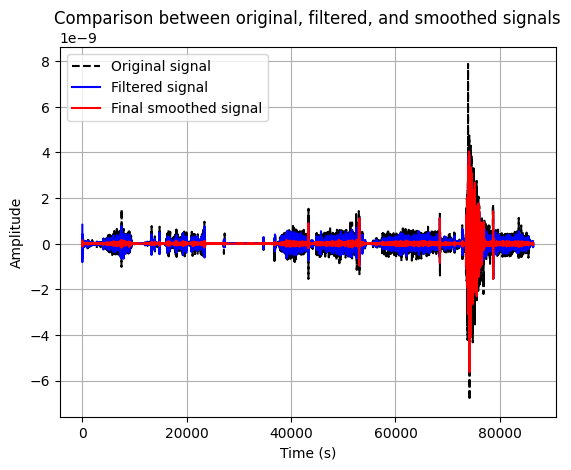

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1970-03-25HR00_evid00003.csv

Segment 1:
  Low cutoff frequency: 0.012430522088353416 Hz
  High cutoff frequency: 0.05148875502008033 Hz
  Total energy: 3.0958964780349466e-19

Segment 2:
  Low cutoff frequency: 0.008097222222222223 Hz
  High cutoff frequency: 0.050791666666666666 Hz
  Total energy: 4.250945096486943e-19

Segment 3:
  Low cutoff frequency: 0.013544444444444444 Hz
  High cutoff frequency: 0.04632592592592593 Hz
  Total energy: 1.8888855394580926e-19

Segment 4:
  Low cutoff frequency: 0.00572972972972973 Hz
  High cutoff frequency: 0.050851351351351354 Hz
  Total energy: 2.5552582558339853e-19

Segment 5:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.03975 Hz
  Total energy: 3.530956202974557e-19

Segment 6:
  Low cutoff frequency: 0.01336972891566265 Hz
  High cutoff frequency: 0.049354919678714866 Hz
  Total energy: 2.807945527037434e-19


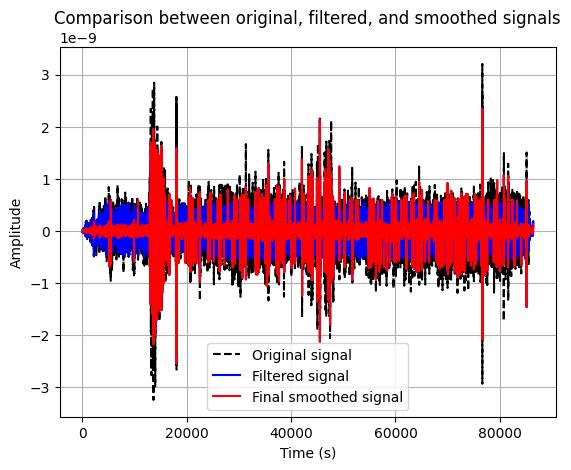

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1970-03-26HR00_evid00004.csv

Segment 1:
  Low cutoff frequency: 0.01342721193415638 Hz
  High cutoff frequency: 0.05298636831275721 Hz
  Total energy: 1.3266779239347785e-19

Segment 2:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.053000000000000005 Hz
  Total energy: 9.455269680077229e-19

Segment 3:
  Low cutoff frequency: 0.0159 Hz
  High cutoff frequency: 0.0424 Hz
  Total energy: 7.158632786841986e-18

Segment 4:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.026500000000000003 Hz
  Total energy: 9.164167077179057e-18

Segment 5:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.026500000000000003 Hz
  Total energy: 3.577775442216342e-18

Segment 6:
  Low cutoff frequency: 0.014669923031379515 Hz
  High cutoff frequency: 0.05397276494967437 Hz
  Total energy: 4.902430711708808e-19


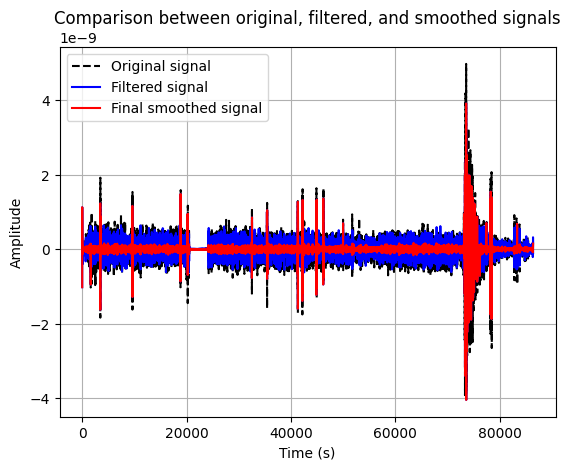

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1970-06-15HR00_evid00008.csv

Segment 1:
  Low cutoff frequency: 0.016595225027442373 Hz
  High cutoff frequency: 0.050818331503841935 Hz
  Total energy: 1.5642042182710363e-19

Segment 2:
  Low cutoff frequency: 0.013250000000000001 Hz
  High cutoff frequency: 0.059625000000000004 Hz
  Total energy: 4.13452287578593e-17

Segment 3:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.026500000000000003 Hz
  Total energy: 4.8917205291284547e-17

Segment 4:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.053000000000000005 Hz
  Total energy: 5.928864723163758e-17

Segment 5:
  Low cutoff frequency: 0.008833333333333334 Hz
  High cutoff frequency: 0.044166666666666674 Hz
  Total energy: 2.8818742045140753e-17

Segment 6:
  Low cutoff frequency: 0.012760554089709763 Hz
  High cutoff frequency: 0.0533146437994723 Hz
  Total energy: 1.0307136423458001e-18
Segment 1 has significantly lower energy. Average

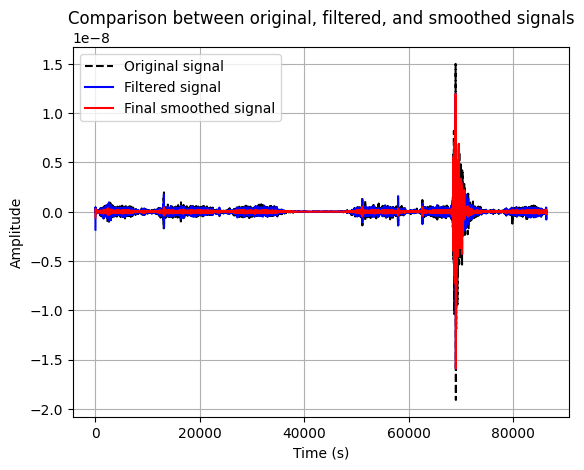

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1970-04-26HR00_evid00007.csv

Segment 1:
  Low cutoff frequency: 0.013478776978417267 Hz
  High cutoff frequency: 0.052084892086330936 Hz
  Total energy: 1.320231680279252e-19

Segment 2:
  Low cutoff frequency: 0.026500000000000003 Hz
  High cutoff frequency: 0.059625000000000004 Hz
  Total energy: 3.2093834419792535e-18

Segment 3:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.03975 Hz
  Total energy: 1.8665571231943418e-18

Segment 4:
  Low cutoff frequency: 0.014454545454545456 Hz
  High cutoff frequency: 0.053 Hz
  Total energy: 2.144404907162334e-18

Segment 5:
  Low cutoff frequency: 0.013250000000000001 Hz
  High cutoff frequency: 0.033125 Hz
  Total energy: 2.416826874248786e-18

Segment 6:
  Low cutoff frequency: 0.010704938552571689 Hz
  High cutoff frequency: 0.05192649066909422 Hz
  Total energy: 1.8779054273026329e-19
Segment 1 has significantly lower energy. Average frequency threshold w

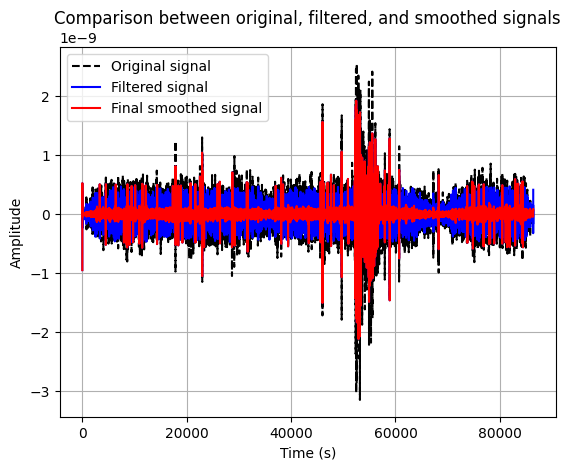

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1970-04-25HR00_evid00006.csv

Segment 1:
  Low cutoff frequency: 0.015863945578231294 Hz
  High cutoff frequency: 0.055523809523809524 Hz
  Total energy: 8.842301690372502e-19

Segment 2:
  Low cutoff frequency: 0.013250000000000001 Hz
  High cutoff frequency: 0.053000000000000005 Hz
  Total energy: 6.401861011798402e-18

Segment 3:
  Low cutoff frequency: 0.008833333333333334 Hz
  High cutoff frequency: 0.053000000000000005 Hz
  Total energy: 4.2718771133304355e-18

Segment 4:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.026500000000000003 Hz
  Total energy: 7.670666455783922e-18

Segment 5:
  Low cutoff frequency: 0.013250000000000001 Hz
  High cutoff frequency: 0.046375 Hz
  Total energy: 5.9251801794924696e-18

Segment 6:
  Low cutoff frequency: 0.012840642313832286 Hz
  High cutoff frequency: 0.05172340125833412 Hz
  Total energy: 1.4297008508204326e-19
Segment 6 has significantly lower energy. A

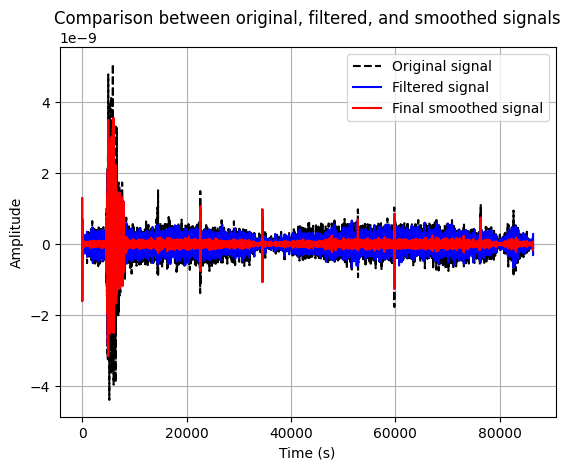

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1970-07-20HR00_evid00010.csv

Segment 1:
  Low cutoff frequency: 0.015073886639676114 Hz
  High cutoff frequency: 0.05101518218623482 Hz
  Total energy: 2.48166431288735e-19

Segment 2:
  Low cutoff frequency: 0.026500000000000003 Hz
  High cutoff frequency: 0.035333333333333335 Hz
  Total energy: 2.853118589901576e-17

Segment 3:
  Low cutoff frequency: 0.003785714285714286 Hz
  High cutoff frequency: 0.04921428571428572 Hz
  Total energy: 3.883429571830203e-17

Segment 4:
  Low cutoff frequency: 0.0212 Hz
  High cutoff frequency: 0.0371 Hz
  Total energy: 4.0238726187945646e-17

Segment 5:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.026500000000000003 Hz
  Total energy: 6.393531060419083e-17

Segment 6:
  Low cutoff frequency: 0.015365771434992697 Hz
  High cutoff frequency: 0.05181481065288235 Hz
  Total energy: 9.226238986875806e-19
Segment 1 has significantly lower energy. Average frequency thre

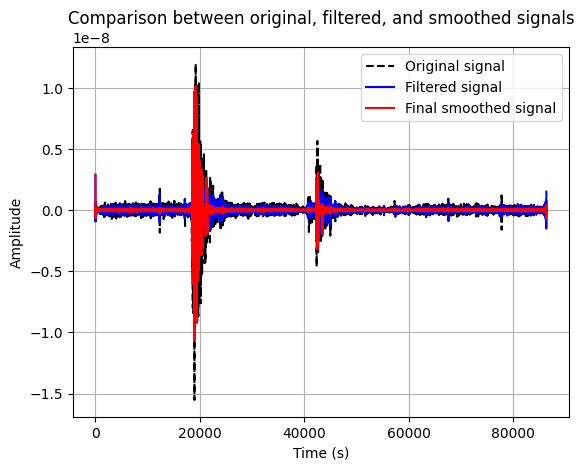

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1970-06-26HR00_evid00009.csv

Segment 1:
  Low cutoff frequency: 0.015190031152647976 Hz
  High cutoff frequency: 0.055256490134994805 Hz
  Total energy: 1.6064206334684175e-18

Segment 2:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.026500000000000003 Hz
  Total energy: 1.2386911043194058e-16

Segment 3:
  Low cutoff frequency: 0.008833333333333334 Hz
  High cutoff frequency: 0.035333333333333335 Hz
  Total energy: 8.864116573174796e-17

Segment 4:
  Low cutoff frequency: 0.017666666666666667 Hz
  High cutoff frequency: 0.044166666666666674 Hz
  Total energy: 2.592856009240543e-16

Segment 5:
  Low cutoff frequency: 0.013250000000000001 Hz
  High cutoff frequency: 0.053000000000000005 Hz
  Total energy: 4.678662570121015e-16

Segment 6:
  Low cutoff frequency: 0.016403335217637083 Hz
  High cutoff frequency: 0.05033352176370831 Hz
  Total energy: 1.4126212858953062e-17


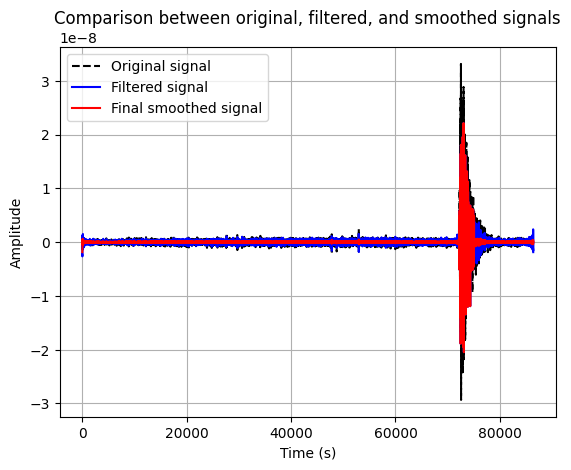

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1970-09-26HR00_evid00013.csv

Segment 1:
  Low cutoff frequency: 0.011428384736016728 Hz
  High cutoff frequency: 0.05243204391008887 Hz
  Total energy: 9.659881007822306e-20

Segment 2:
  Low cutoff frequency: 0.017666666666666667 Hz
  High cutoff frequency: 0.044166666666666674 Hz
  Total energy: 2.951110524751832e-18

Segment 3:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.026500000000000003 Hz
  Total energy: 2.3360892697460094e-18

Segment 4:
  Low cutoff frequency: 0.0212 Hz
  High cutoff frequency: 0.05123333333333334 Hz
  Total energy: 2.5924242844690672e-18

Segment 5:
  Low cutoff frequency: 0.015142857142857144 Hz
  High cutoff frequency: 0.052053571428571435 Hz
  Total energy: 1.7368437699834207e-18

Segment 6:
  Low cutoff frequency: 0.01406155245603396 Hz
  High cutoff frequency: 0.052469678593086724 Hz
  Total energy: 1.4503661373158827e-19
Segment 1 has significantly lower energy. Aver

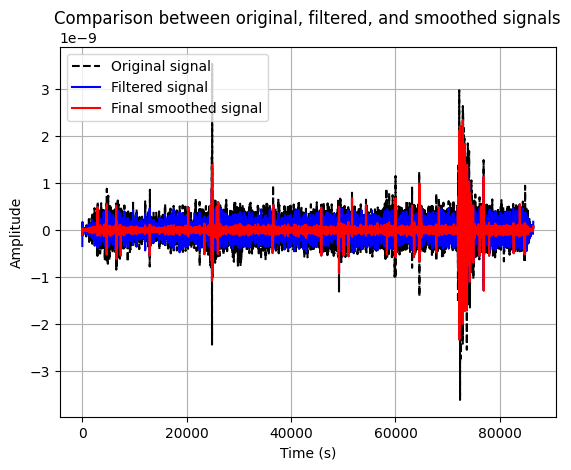

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1970-07-20HR00_evid00011.csv

Segment 1:
  Low cutoff frequency: 0.015073886639676114 Hz
  High cutoff frequency: 0.05101518218623482 Hz
  Total energy: 2.48166431288735e-19

Segment 2:
  Low cutoff frequency: 0.026500000000000003 Hz
  High cutoff frequency: 0.035333333333333335 Hz
  Total energy: 2.853118589901576e-17

Segment 3:
  Low cutoff frequency: 0.003785714285714286 Hz
  High cutoff frequency: 0.04921428571428572 Hz
  Total energy: 3.883429571830203e-17

Segment 4:
  Low cutoff frequency: 0.0212 Hz
  High cutoff frequency: 0.0371 Hz
  Total energy: 4.0238726187945646e-17

Segment 5:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.026500000000000003 Hz
  Total energy: 6.393531060419083e-17

Segment 6:
  Low cutoff frequency: 0.015365771434992697 Hz
  High cutoff frequency: 0.05181481065288235 Hz
  Total energy: 9.226238986875806e-19
Segment 1 has significantly lower energy. Average frequency thre

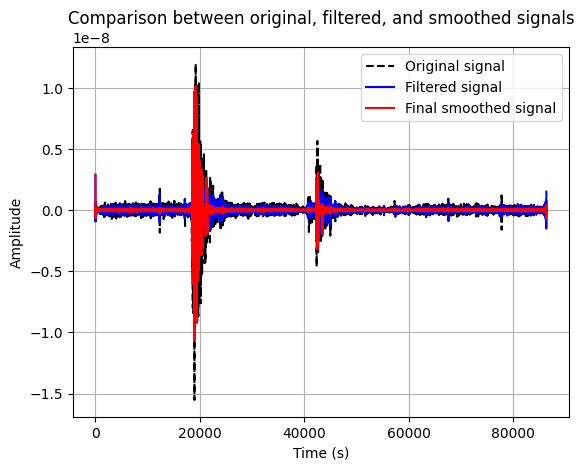

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1970-10-24HR00_evid00014.csv

Segment 1:
  Low cutoff frequency: 0.013346480582524273 Hz
  High cutoff frequency: 0.05208343446601942 Hz
  Total energy: 1.8338693897914775e-19

Segment 2:
  Low cutoff frequency: 0.026500000000000003 Hz
  High cutoff frequency: 0.053000000000000005 Hz
  Total energy: 1.626131758420279e-17

Segment 3:
  Low cutoff frequency: 0.026500000000000003 Hz
  High cutoff frequency: 0.053000000000000005 Hz
  Total energy: 2.561497878743433e-17

Segment 4:
  Low cutoff frequency: 0.017666666666666667 Hz
  High cutoff frequency: 0.053000000000000005 Hz
  Total energy: 2.905573594422386e-17

Segment 5:
  Low cutoff frequency: 0.008833333333333334 Hz
  High cutoff frequency: 0.044166666666666674 Hz
  Total energy: 1.5581063249259276e-17

Segment 6:
  Low cutoff frequency: 0.012646965865992415 Hz
  High cutoff frequency: 0.04979219342604299 Hz
  Total energy: 1.919637896090644e-19
Segment 1 has si

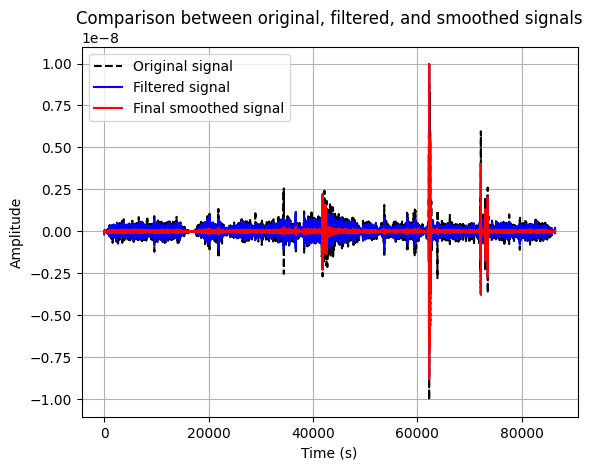

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1970-11-12HR00_evid00015.csv

Segment 1:
  Low cutoff frequency: 0.012670178282009724 Hz
  High cutoff frequency: 0.05188330632090762 Hz
  Total energy: 5.610244455406193e-20

Segment 2:
  Low cutoff frequency: 0.01806818181818182 Hz
  High cutoff frequency: 0.04818181818181819 Hz
  Total energy: 5.30462301631503e-18

Segment 3:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.03975 Hz
  Total energy: 5.441591263944906e-18

Segment 4:
  Low cutoff frequency: 0.026500000000000003 Hz
  High cutoff frequency: 0.053000000000000005 Hz
  Total energy: 1.8326760783677435e-18

Segment 5:
  Low cutoff frequency: 0.01821875 Hz
  High cutoff frequency: 0.05134375 Hz
  Total energy: 2.9837192380844425e-18

Segment 6:
  Low cutoff frequency: 0.014728025226645645 Hz
  High cutoff frequency: 0.05523009459992117 Hz
  Total energy: 1.1954724347695522e-19
Segment 1 has significantly lower energy. Average frequency threshol

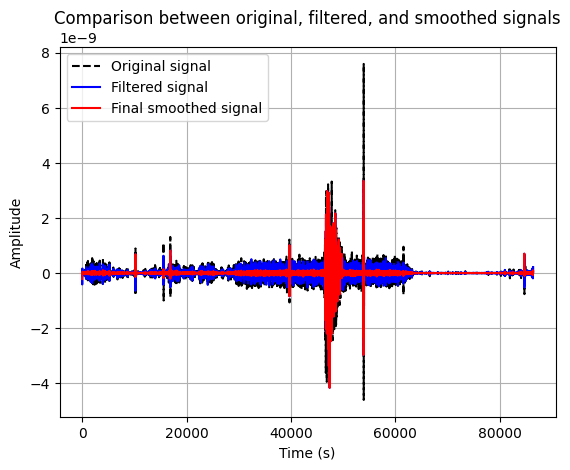

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1970-12-11HR00_evid00017.csv

Segment 1:
  Low cutoff frequency: 0.013300428163653663 Hz
  High cutoff frequency: 0.053542102759276886 Hz
  Total energy: 1.4402092373245484e-19

Segment 2:
  Low cutoff frequency: 0.0231875 Hz
  High cutoff frequency: 0.053000000000000005 Hz
  Total energy: 2.6461747411908835e-19

Segment 3:
  Low cutoff frequency: 0.016194444444444445 Hz
  High cutoff frequency: 0.04563888888888889 Hz
  Total energy: 2.4523534050621237e-19

Segment 4:
  Low cutoff frequency: 0.017666666666666667 Hz
  High cutoff frequency: 0.046375000000000006 Hz
  Total energy: 1.2381742029882759e-19

Segment 5:
  Low cutoff frequency: 0.006115384615384615 Hz
  High cutoff frequency: 0.04892307692307692 Hz
  Total energy: 1.2986186368668186e-19

Segment 6:
  Low cutoff frequency: 0.013947368421052634 Hz
  High cutoff frequency: 0.05327119883040936 Hz
  Total energy: 1.1746907715088804e-19


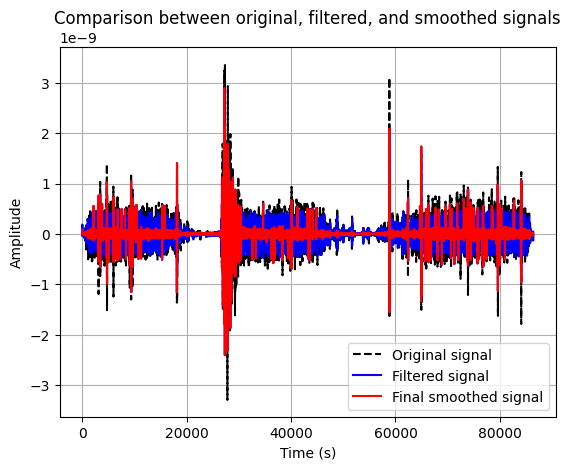

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1970-12-27HR00_evid00019.csv

Segment 1:
  Low cutoff frequency: 0.013822572445348246 Hz
  High cutoff frequency: 0.05112735129639045 Hz
  Total energy: 1.3356591375109687e-19

Segment 2:
  Low cutoff frequency: 0.008833333333333334 Hz
  High cutoff frequency: 0.044166666666666674 Hz
  Total energy: 5.041605117542745e-18

Segment 3:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.053000000000000005 Hz
  Total energy: 4.7087029062354084e-18

Segment 4:
  Low cutoff frequency: 0.022083333333333337 Hz
  High cutoff frequency: 0.053000000000000005 Hz
  Total energy: 7.10617238533251e-18

Segment 5:
  Low cutoff frequency: 0.026500000000000003 Hz
  High cutoff frequency: 0.053000000000000005 Hz
  Total energy: 3.530955620172328e-18

Segment 6:
  Low cutoff frequency: 0.013129857512953369 Hz
  High cutoff frequency: 0.051489637305699484 Hz
  Total energy: 4.154785011507343e-19
Segment 1 has significantly lower

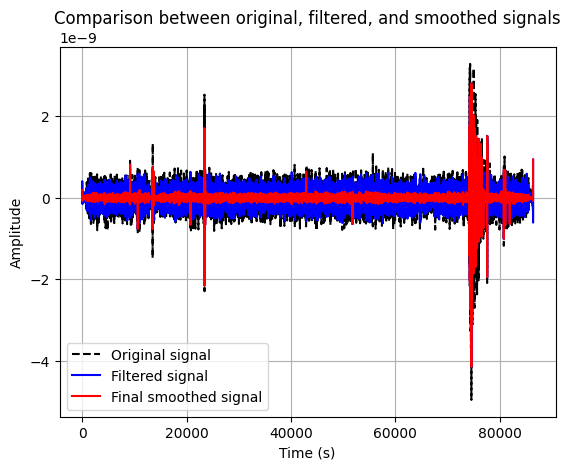

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1971-01-15HR00_evid00022.csv

Segment 1:
  Low cutoff frequency: 0.014914572864321608 Hz
  High cutoff frequency: 0.05280025125628141 Hz
  Total energy: 1.2537970743625238e-19

Segment 2:
  Low cutoff frequency: 0.023555555555555555 Hz
  High cutoff frequency: 0.050055555555555555 Hz
  Total energy: 3.290687747929984e-19

Segment 3:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.026500000000000003 Hz
  Total energy: 1.4322978135744379e-18

Segment 4:
  Low cutoff frequency: 0.026500000000000003 Hz
  High cutoff frequency: 0.026500000000000003 Hz
  Total energy: 1.377293230886667e-18

Segment 5:
  Low cutoff frequency: 0.009464285714285715 Hz
  High cutoff frequency: 0.053 Hz
  Total energy: 6.550794652241727e-20

Segment 6:
  Low cutoff frequency: 0.012861045639597172 Hz
  High cutoff frequency: 0.0525656203128348 Hz
  Total energy: 2.0029187159553684e-19


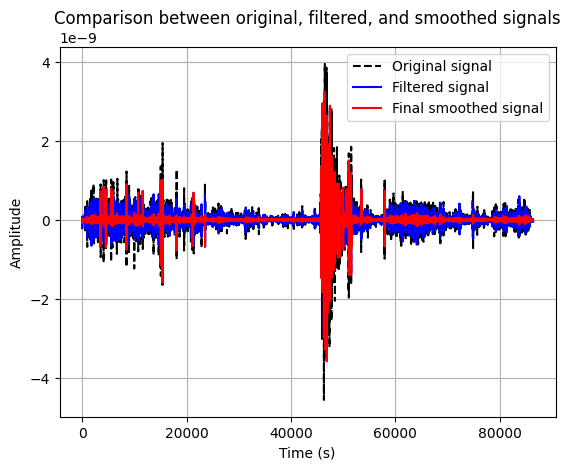

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1970-12-31HR00_evid00021.csv

Segment 1:
  Low cutoff frequency: 0.014153612424037813 Hz
  High cutoff frequency: 0.0502086428089129 Hz
  Total energy: 1.344210668009997e-19

Segment 2:
  Low cutoff frequency: 0.026500000000000003 Hz
  High cutoff frequency: 0.044166666666666674 Hz
  Total energy: 4.4319696533732934e-17

Segment 3:
  Low cutoff frequency: 0.019875000000000004 Hz
  High cutoff frequency: 0.04697727272727273 Hz
  Total energy: 2.0887178628130187e-18

Segment 4:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.03975 Hz
  Total energy: 1.1634382530807764e-18

Segment 5:
  Low cutoff frequency: 0.012552631578947369 Hz
  High cutoff frequency: 0.048815789473684215 Hz
  Total energy: 1.232077839980802e-18

Segment 6:
  Low cutoff frequency: 0.013486096112311016 Hz
  High cutoff frequency: 0.05179805615550756 Hz
  Total energy: 1.491332340337466e-19


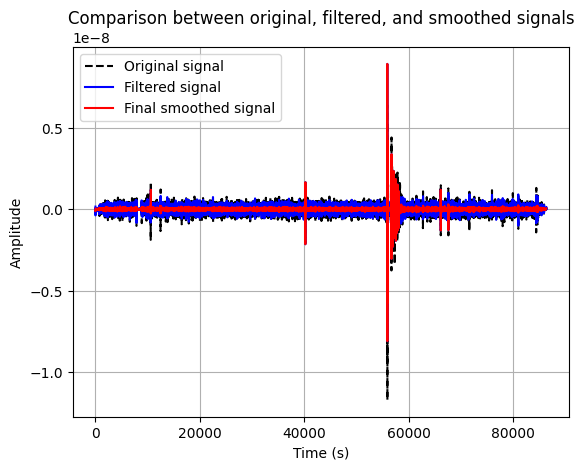

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1971-01-29HR00_evid00024.csv

Segment 1:
  Low cutoff frequency: 0.014977581120943953 Hz
  High cutoff frequency: 0.0464023598820059 Hz
  Total energy: 1.9293204328531941e-19

Segment 2:
  Low cutoff frequency: 0.016069148936170213 Hz
  High cutoff frequency: 0.05581914893617022 Hz
  Total energy: 9.833364521733307e-19

Segment 3:
  Low cutoff frequency: 0.004416666666666667 Hz
  High cutoff frequency: 0.05741666666666667 Hz
  Total energy: 1.0952984338441957e-18

Segment 4:
  Low cutoff frequency: 0.0053 Hz
  High cutoff frequency: 0.0424 Hz
  Total energy: 9.046988109509668e-19

Segment 5:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.026500000000000003 Hz
  Total energy: 8.328462152189904e-19

Segment 6:
  Low cutoff frequency: 0.013824672667757774 Hz
  High cutoff frequency: 0.0515578968903437 Hz
  Total energy: 1.549603820641712e-19
Segment 6 has significantly lower energy. Average frequency thres

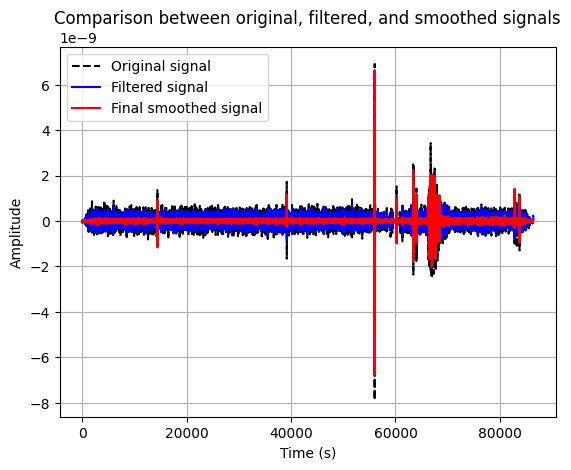

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1971-01-28HR00_evid00023.csv

Segment 1:
  Low cutoff frequency: 0.020319134078212293 Hz
  High cutoff frequency: 0.060217178770949724 Hz
  Total energy: 7.892688522727161e-19

Segment 2:
  Low cutoff frequency: 0.0159 Hz
  High cutoff frequency: 0.047700000000000006 Hz
  Total energy: 4.7544424460556374e-18

Segment 3:
  Low cutoff frequency: 0.026500000000000003 Hz
  High cutoff frequency: 0.06625 Hz
  Total energy: 3.536066097875528e-18

Segment 4:
  Low cutoff frequency: 0.0106 Hz
  High cutoff frequency: 0.047700000000000006 Hz
  Total energy: 1.823275458228098e-18

Segment 5:
  Low cutoff frequency: 0.01834615384615385 Hz
  High cutoff frequency: 0.05198076923076923 Hz
  Total energy: 1.2316401434473718e-18

Segment 6:
  Low cutoff frequency: 0.012994632837277385 Hz
  High cutoff frequency: 0.051364357160283 Hz
  Total energy: 1.3612245269269723e-19
Segment 6 has significantly lower energy. Average frequency

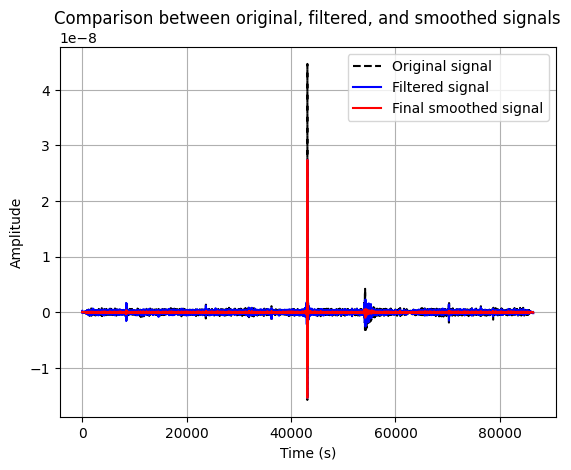

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1971-04-13HR02_evid00029.csv

Segment 1:
  Low cutoff frequency: 0.008669433593750001 Hz
  High cutoff frequency: 0.042104980468750004 Hz
  Total energy: 1.5799507623441373e-18

Segment 2:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.035333333333333335 Hz
  Total energy: 3.52288640882951e-17

Segment 3:
  Low cutoff frequency: 0.0159 Hz
  High cutoff frequency: 0.0371 Hz
  Total energy: 4.385625659492496e-17

Segment 4:
  Low cutoff frequency: 0.026500000000000003 Hz
  High cutoff frequency: 0.053000000000000005 Hz
  Total energy: 2.798637583682067e-17

Segment 5:
  Low cutoff frequency: 0.007571428571428572 Hz
  High cutoff frequency: 0.04542857142857143 Hz
  Total energy: 3.12307450371657e-17

Segment 6:
  Low cutoff frequency: 0.015767931998136937 Hz
  High cutoff frequency: 0.05273462971588263 Hz
  Total energy: 1.2459322896130106e-18
Segment 1 has significantly lower energy. Average frequency thr

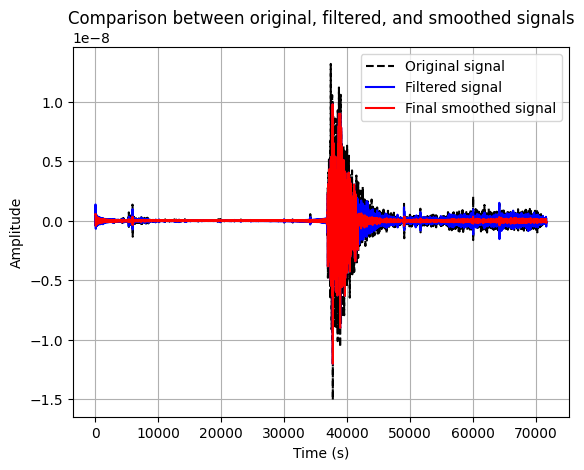

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1971-02-09HR00_evid00026.csv

Segment 1:
  Low cutoff frequency: 0.014599216710182768 Hz
  High cutoff frequency: 0.05113185378590079 Hz
  Total energy: 2.6580073160029113e-19

Segment 2:
  Low cutoff frequency: 0.013250000000000001 Hz
  High cutoff frequency: 0.026500000000000003 Hz
  Total energy: 2.4171058036453695e-18

Segment 3:
  Low cutoff frequency: 0.008833333333333334 Hz
  High cutoff frequency: 0.04858333333333333 Hz
  Total energy: 2.443647224837489e-18

Segment 4:
  Low cutoff frequency: 0.013880952380952381 Hz
  High cutoff frequency: 0.053000000000000005 Hz
  Total energy: 1.852813057043935e-18

Segment 5:
  Low cutoff frequency: 0.015512195121951221 Hz
  High cutoff frequency: 0.054292682926829275 Hz
  Total energy: 4.161933021670445e-19

Segment 6:
  Low cutoff frequency: 0.012883547473867597 Hz
  High cutoff frequency: 0.05081282665505227 Hz
  Total energy: 4.5171805882147425e-20
Segment 6 has si

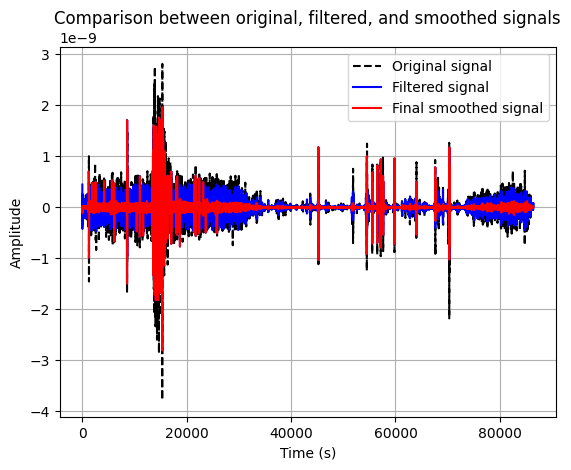

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1971-03-25HR00_evid00028.csv

Segment 1:
  Low cutoff frequency: 0.01430572963294539 Hz
  High cutoff frequency: 0.050746195165622204 Hz
  Total energy: 9.247891536921587e-20

Segment 2:
  Low cutoff frequency: 0.014785714285714287 Hz
  High cutoff frequency: 0.05014285714285714 Hz
  Total energy: 2.516866169269183e-19

Segment 3:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.03975 Hz
  Total energy: 2.4344880827050556e-18

Segment 4:
  Low cutoff frequency: 0.013250000000000001 Hz
  High cutoff frequency: 0.03975 Hz
  Total energy: 4.469010568584523e-18

Segment 5:
  Low cutoff frequency: 0.010410714285714285 Hz
  High cutoff frequency: 0.05110714285714286 Hz
  Total energy: 1.5890084312899475e-18

Segment 6:
  Low cutoff frequency: 0.01542218758118992 Hz
  High cutoff frequency: 0.049295921018446355 Hz
  Total energy: 1.3921816656514237e-19


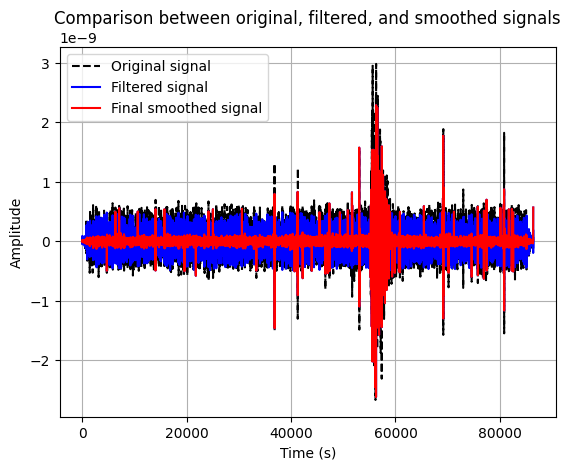

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1971-04-17HR00_evid00030.csv

Segment 1:
  Low cutoff frequency: 0.020529796511627906 Hz
  High cutoff frequency: 0.055965843023255815 Hz
  Total energy: 1.6401214720226254e-18

Segment 2:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.026500000000000003 Hz
  Total energy: 1.3940767799761815e-16

Segment 3:
  Low cutoff frequency: 0.013250000000000001 Hz
  High cutoff frequency: 0.053000000000000005 Hz
  Total energy: 4.8877964179943635e-17

Segment 4:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.044166666666666674 Hz
  Total energy: 4.4659905274744815e-17

Segment 5:
  Low cutoff frequency: 0.008833333333333334 Hz
  High cutoff frequency: 0.044166666666666674 Hz
  Total energy: 6.351596656196373e-17

Segment 6:
  Low cutoff frequency: 0.014442733215991954 Hz
  High cutoff frequency: 0.05355638672366105 Hz
  Total energy: 7.298025253618757e-19
Segment 1 has significantly lower energy. Avera

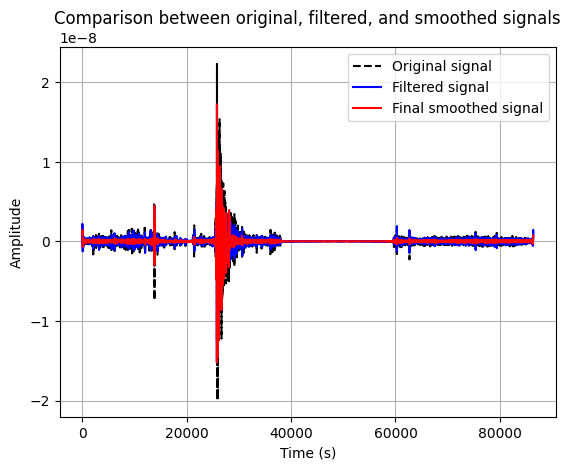

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1971-05-12HR00_evid00031.csv

Segment 1:
  Low cutoff frequency: 0.011587638376383765 Hz
  High cutoff frequency: 0.0516309963099631 Hz
  Total energy: 6.126860701342361e-19

Segment 2:
  Low cutoff frequency: 0.008833333333333334 Hz
  High cutoff frequency: 0.049466666666666666 Hz
  Total energy: 1.2300675591522125e-19

Segment 3:
  Low cutoff frequency: 0.021531250000000002 Hz
  High cutoff frequency: 0.0563125 Hz
  Total energy: 1.2948431683082592e-19

Segment 4:
  Low cutoff frequency: 0.01343661971830986 Hz
  High cutoff frequency: 0.053000000000000005 Hz
  Total energy: 1.196323663559462e-19

Segment 5:
  Low cutoff frequency: 0.010460526315789474 Hz
  High cutoff frequency: 0.05369736842105263 Hz
  Total energy: 1.215101754202522e-19

Segment 6:
  Low cutoff frequency: 0.012892873458200092 Hz
  High cutoff frequency: 0.05145043398812243 Hz
  Total energy: 1.3211740664419937e-19


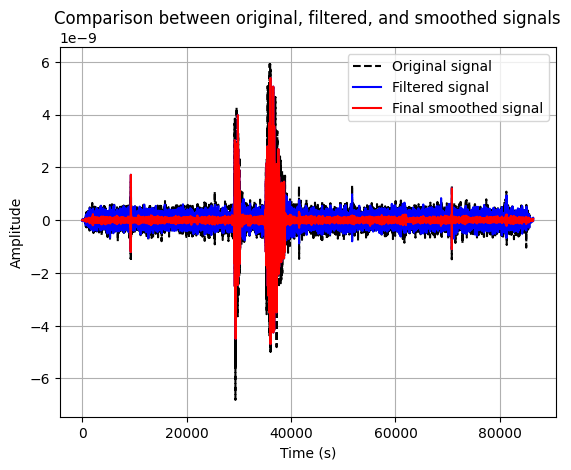

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1971-05-12HR00_evid00032.csv

Segment 1:
  Low cutoff frequency: 0.011587638376383765 Hz
  High cutoff frequency: 0.0516309963099631 Hz
  Total energy: 6.126860701342361e-19

Segment 2:
  Low cutoff frequency: 0.008833333333333334 Hz
  High cutoff frequency: 0.049466666666666666 Hz
  Total energy: 1.2300675591522125e-19

Segment 3:
  Low cutoff frequency: 0.021531250000000002 Hz
  High cutoff frequency: 0.0563125 Hz
  Total energy: 1.2948431683082592e-19

Segment 4:
  Low cutoff frequency: 0.01343661971830986 Hz
  High cutoff frequency: 0.053000000000000005 Hz
  Total energy: 1.196323663559462e-19

Segment 5:
  Low cutoff frequency: 0.010460526315789474 Hz
  High cutoff frequency: 0.05369736842105263 Hz
  Total energy: 1.215101754202522e-19

Segment 6:
  Low cutoff frequency: 0.012892873458200092 Hz
  High cutoff frequency: 0.05145043398812243 Hz
  Total energy: 1.3211740664419937e-19


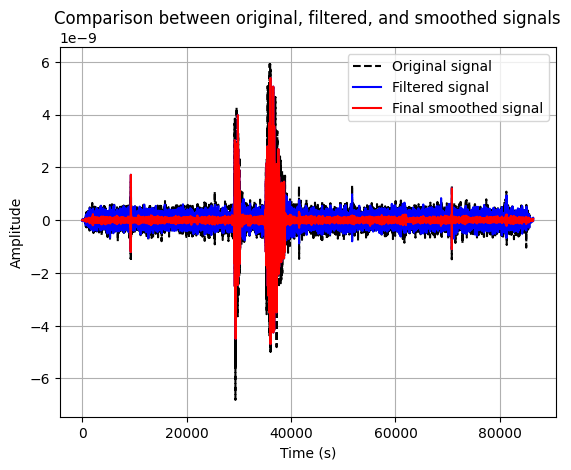

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1971-05-13HR00_evid00033.csv

Segment 1:
  Low cutoff frequency: 0.010918144611186903 Hz
  High cutoff frequency: 0.05162619372442019 Hz
  Total energy: 2.0733178397930546e-19

Segment 2:
  Low cutoff frequency: 0.013250000000000001 Hz
  High cutoff frequency: 0.044166666666666674 Hz
  Total energy: 4.531738001666655e-19

Segment 3:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.026500000000000003 Hz
  Total energy: 2.0507875769365628e-19

Segment 4:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.026500000000000003 Hz
  Total energy: 2.090825206104993e-19

Segment 5:
  Low cutoff frequency: 0.009275 Hz
  High cutoff frequency: 0.05035 Hz
  Total energy: 2.459394872205323e-19

Segment 6:
  Low cutoff frequency: 0.016457006369426753 Hz
  High cutoff frequency: 0.05232484076433121 Hz
  Total energy: 1.6660107441918364e-19


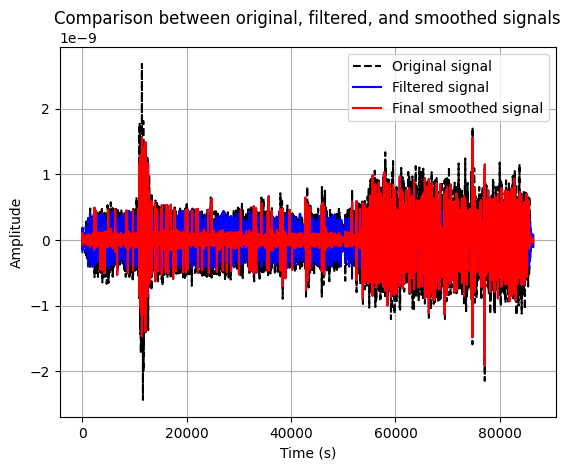

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1971-05-23HR00_evid00034.csv

Segment 1:
  Low cutoff frequency: 0.011937383177570093 Hz
  High cutoff frequency: 0.05261612149532711 Hz
  Total energy: 9.043919048881134e-18

Segment 2:
  Low cutoff frequency: 0.008833333333333334 Hz
  High cutoff frequency: 0.044166666666666674 Hz
  Total energy: 2.667031554187209e-15

Segment 3:
  Low cutoff frequency: 0.013250000000000001 Hz
  High cutoff frequency: 0.03975 Hz
  Total energy: 2.67677259517158e-15

Segment 4:
  Low cutoff frequency: 0.013250000000000001 Hz
  High cutoff frequency: 0.03975 Hz
  Total energy: 2.671386375369288e-15

Segment 5:
  Low cutoff frequency: 0.014906250000000001 Hz
  High cutoff frequency: 0.05465625 Hz
  Total energy: 2.4886799932883758e-15

Segment 6:
  Low cutoff frequency: 0.02165865384615385 Hz
  High cutoff frequency: 0.05181089743589743 Hz
  Total energy: 1.7126855058396783e-16
Segment 1 has significantly lower energy. Average freq

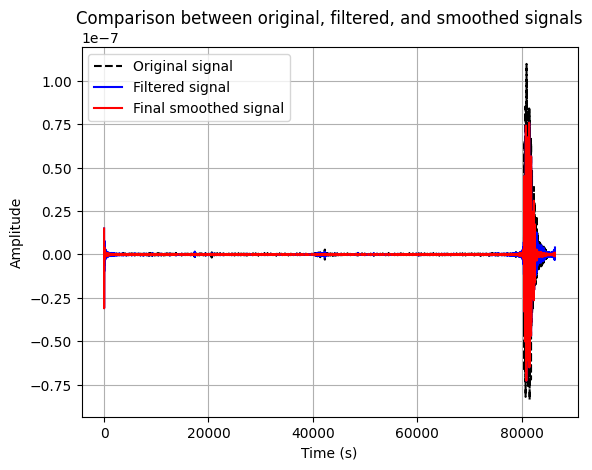

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1971-06-12HR00_evid00035.csv

Segment 1:
  Low cutoff frequency: 0.018126300851466413 Hz
  High cutoff frequency: 0.05350141911069063 Hz
  Total energy: 4.9899939306654256e-17

Segment 2:
  Low cutoff frequency: 0.019875 Hz
  High cutoff frequency: 0.03975 Hz
  Total energy: 3.7808526146432426e-15

Segment 3:
  Low cutoff frequency: 0.007227272727272728 Hz
  High cutoff frequency: 0.053 Hz
  Total energy: 2.7653838157940308e-15

Segment 4:
  Low cutoff frequency: 0.015142857142857144 Hz
  High cutoff frequency: 0.04542857142857143 Hz
  Total energy: 1.4873027748111595e-15

Segment 5:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.044166666666666674 Hz
  Total energy: 1.940066312531931e-15

Segment 6:
  Low cutoff frequency: 0.01432728928630568 Hz
  High cutoff frequency: 0.049059446928299395 Hz
  Total energy: 2.4734912568647755e-17
Segment 1 has significantly lower energy. Average frequency threshold w

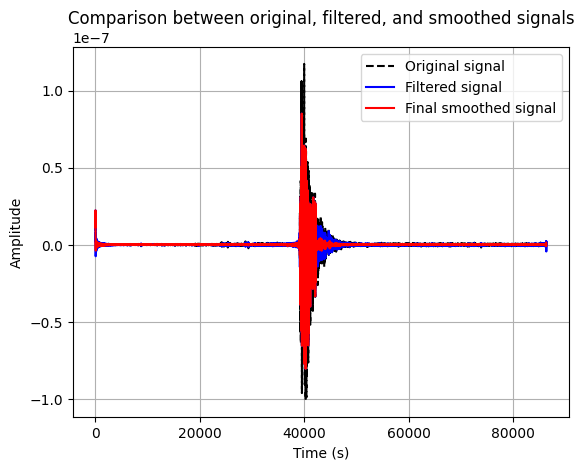

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1971-09-25HR00_evid00042.csv

Segment 1:
  Low cutoff frequency: 0.012630841121495328 Hz
  High cutoff frequency: 0.05159222823413675 Hz
  Total energy: 7.505590923186588e-20

Segment 2:
  Low cutoff frequency: 0.0053 Hz
  High cutoff frequency: 0.0371 Hz
  Total energy: 1.0034529404884292e-19

Segment 3:
  Low cutoff frequency: 0.0159 Hz
  High cutoff frequency: 0.047700000000000006 Hz
  Total energy: 6.66813905238156e-20

Segment 4:
  Low cutoff frequency: 0.013585443037974683 Hz
  High cutoff frequency: 0.05182594936708861 Hz
  Total energy: 1.1173718252797424e-19

Segment 5:
  Low cutoff frequency: 0.012793103448275863 Hz
  High cutoff frequency: 0.04843103448275862 Hz
  Total energy: 1.0668145204789265e-19

Segment 6:
  Low cutoff frequency: 0.01467281879194631 Hz
  High cutoff frequency: 0.053355704697986575 Hz
  Total energy: 4.801079372701612e-20


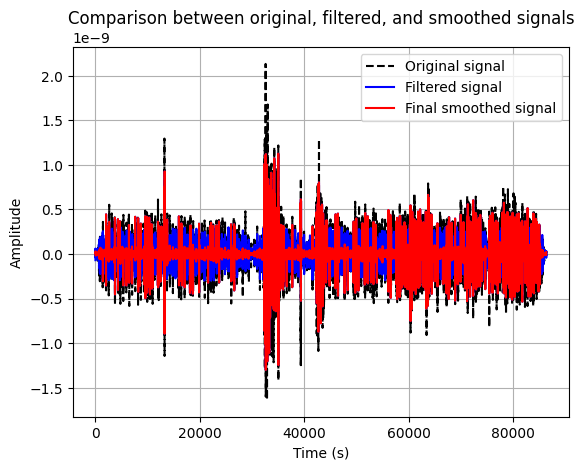

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1971-10-18HR00_evid00043.csv

Segment 1:
  Low cutoff frequency: 0.010902402402402402 Hz
  High cutoff frequency: 0.05132882882882883 Hz
  Total energy: 2.2867386856177155e-19

Segment 2:
  Low cutoff frequency: 0.013573170731707319 Hz
  High cutoff frequency: 0.05016071428571429 Hz
  Total energy: 3.3213582303620767e-19

Segment 3:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.026500000000000003 Hz
  Total energy: 1.792536981700633e-16

Segment 4:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.053000000000000005 Hz
  Total energy: 3.7234132361623356e-17

Segment 5:
  Low cutoff frequency: 0.026500000000000003 Hz
  High cutoff frequency: 0.053000000000000005 Hz
  Total energy: 4.3944041098764e-17

Segment 6:
  Low cutoff frequency: 0.014638157894736844 Hz
  High cutoff frequency: 0.05266447368421053 Hz
  Total energy: 8.169091793969634e-20


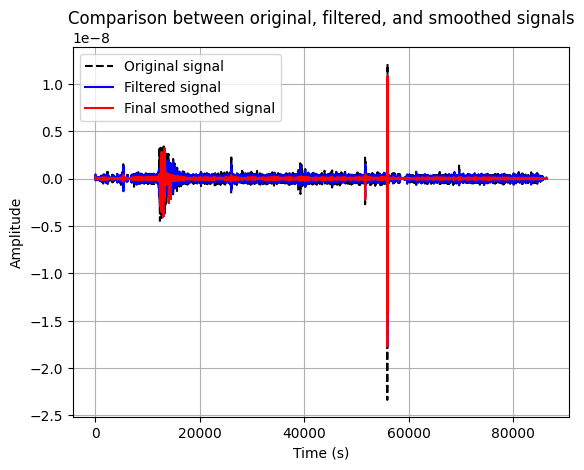

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1971-10-20HR00_evid00044.csv

Segment 1:
  Low cutoff frequency: 0.013310919540229886 Hz
  High cutoff frequency: 0.04310057471264368 Hz
  Total energy: 6.734963365233415e-19

Segment 2:
  Low cutoff frequency: 0.013250000000000001 Hz
  High cutoff frequency: 0.06625 Hz
  Total energy: 2.608567978305473e-16

Segment 3:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.026500000000000003 Hz
  Total energy: 1.5583499002651048e-16

Segment 4:
  Low cutoff frequency: 0.009636363636363637 Hz
  High cutoff frequency: 0.053 Hz
  Total energy: 3.284728993804667e-16

Segment 5:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.053000000000000005 Hz
  Total energy: 1.647390326767917e-16

Segment 6:
  Low cutoff frequency: 0.013259932533733134 Hz
  High cutoff frequency: 0.05135119940029985 Hz
  Total energy: 1.2693306160489084e-17
Segment 1 has significantly lower energy. Average frequency threshold will be 

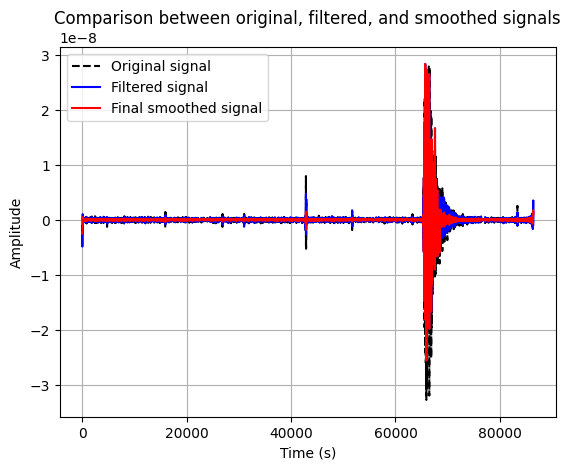

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1971-10-31HR00_evid00045.csv

Segment 1:
  Low cutoff frequency: 0.011116104868913857 Hz
  High cutoff frequency: 0.04893071161048689 Hz
  Total energy: 1.0653323525683074e-19

Segment 2:
  Low cutoff frequency: 0.014722222222222223 Hz
  High cutoff frequency: 0.053000000000000005 Hz
  Total energy: 3.9913444851439946e-18

Segment 3:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.026500000000000003 Hz
  Total energy: 5.8116055512852476e-18

Segment 4:
  Low cutoff frequency: 0.017225 Hz
  High cutoff frequency: 0.055650000000000005 Hz
  Total energy: 7.420231746613708e-18

Segment 5:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.03975 Hz
  Total energy: 3.915284757179267e-18

Segment 6:
  Low cutoff frequency: 0.013282283327532196 Hz
  High cutoff frequency: 0.05106914955331245 Hz
  Total energy: 1.5694845924325483e-19
Segment 1 has significantly lower energy. Average frequency threshold wil

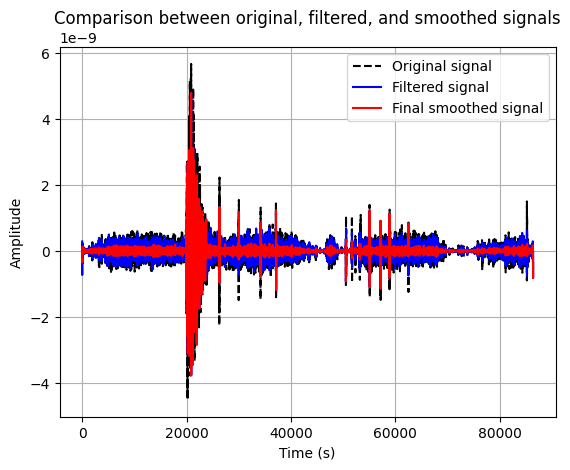

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1971-11-14HR00_evid00046.csv

Segment 1:
  Low cutoff frequency: 0.01275925925925926 Hz
  High cutoff frequency: 0.05416550925925926 Hz
  Total energy: 1.362300757148101e-19

Segment 2:
  Low cutoff frequency: 0.013250000000000001 Hz
  High cutoff frequency: 0.053000000000000005 Hz
  Total energy: 1.168720822849027e-18

Segment 3:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.0371 Hz
  Total energy: 1.4467634078885982e-18

Segment 4:
  Low cutoff frequency: 0.030916666666666665 Hz
  High cutoff frequency: 0.06183333333333333 Hz
  Total energy: 1.5519514426155692e-18

Segment 5:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.0371 Hz
  Total energy: 8.174929433527645e-19

Segment 6:
  Low cutoff frequency: 0.015125570776255707 Hz
  High cutoff frequency: 0.05203196347031964 Hz
  Total energy: 9.704080022709717e-20
Segment 1 has significantly lower energy. Average frequency threshold will be us

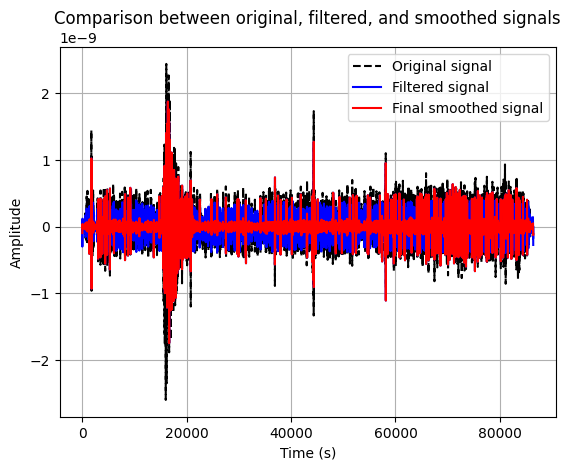

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1972-01-04HR00_evid00049.csv

Segment 1:
  Low cutoff frequency: 0.010980662983425414 Hz
  High cutoff frequency: 0.048479627071823204 Hz
  Total energy: 1.9494956295196255e-19

Segment 2:
  Low cutoff frequency: 0.017085526315789475 Hz
  High cutoff frequency: 0.05439473684210527 Hz
  Total energy: 7.929268338570386e-19

Segment 3:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.053000000000000005 Hz
  Total energy: 1.783735904421491e-17

Segment 4:
  Low cutoff frequency: 0.026500000000000003 Hz
  High cutoff frequency: 0.053000000000000005 Hz
  Total energy: 7.580169263932047e-19

Segment 5:
  Low cutoff frequency: 0.012848484848484849 Hz
  High cutoff frequency: 0.051320936639118464 Hz
  Total energy: 1.0664432267418115e-19

Segment 6:
  Low cutoff frequency: 0.013057778889444724 Hz
  High cutoff frequency: 0.052827663831915964 Hz
  Total energy: 1.0151488379853032e-19


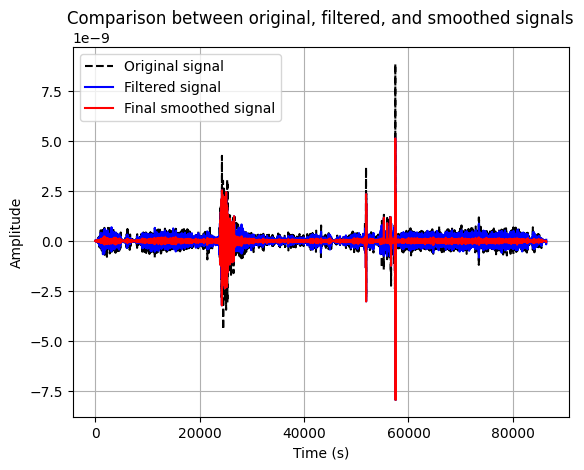

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1972-03-12HR00_evid00052.csv

Segment 1:
  Low cutoff frequency: 0.016122040072859747 Hz
  High cutoff frequency: 0.052050698239222835 Hz
  Total energy: 1.2933932389520014e-19

Segment 2:
  Low cutoff frequency: 0.011777777777777778 Hz
  High cutoff frequency: 0.053000000000000005 Hz
  Total energy: 8.649175337993333e-20

Segment 3:
  Low cutoff frequency: 0.021265432098765434 Hz
  High cutoff frequency: 0.05529012345679013 Hz
  Total energy: 5.001400480163188e-19

Segment 4:
  Low cutoff frequency: 0.007227272727272728 Hz
  High cutoff frequency: 0.050590909090909096 Hz
  Total energy: 1.1068161276742564e-18

Segment 5:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.0 Hz
  Total energy: 7.752830011090989e-19

Segment 6:
  Low cutoff frequency: 0.014207110609480813 Hz
  High cutoff frequency: 0.05114559819413092 Hz
  Total energy: 8.432889166777501e-20


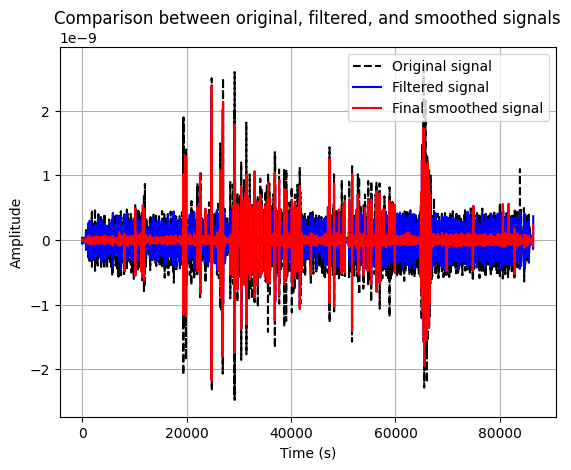

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1972-05-11HR00_evid00055.csv

Segment 1:
  Low cutoff frequency: 0.02425114678899083 Hz
  High cutoff frequency: 0.05223012232415903 Hz
  Total energy: 5.669543459616008e-20

Segment 2:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.026500000000000003 Hz
  Total energy: 1.6884614194605825e-17

Segment 3:
  Low cutoff frequency: 0.019875 Hz
  High cutoff frequency: 0.059625000000000004 Hz
  Total energy: 1.5801183415430065e-17

Segment 4:
  Low cutoff frequency: 0.013250000000000001 Hz
  High cutoff frequency: 0.051675000000000006 Hz
  Total energy: 9.001900993363123e-18

Segment 5:
  Low cutoff frequency: 0.014722222222222223 Hz
  High cutoff frequency: 0.053000000000000005 Hz
  Total energy: 7.848392799796183e-18

Segment 6:
  Low cutoff frequency: 0.015669614319198808 Hz
  High cutoff frequency: 0.04926752610270616 Hz
  Total energy: 2.8042810329225076e-19
Segment 1 has significantly lower energy. Ave

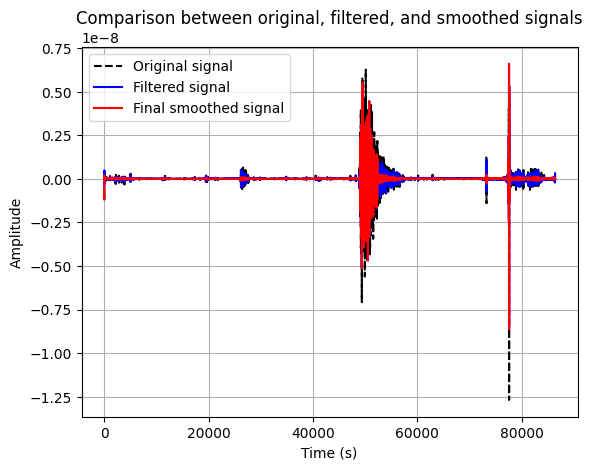

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1972-06-16HR00_evid00060.csv

Segment 1:
  Low cutoff frequency: 0.01511937984496124 Hz
  High cutoff frequency: 0.05336976744186047 Hz
  Total energy: 1.5607397305240323e-19

Segment 2:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.026500000000000003 Hz
  Total energy: 6.559900177482873e-19

Segment 3:
  Low cutoff frequency: 0.014722222222222223 Hz
  High cutoff frequency: 0.053 Hz
  Total energy: 7.040209499005231e-19

Segment 4:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.026500000000000003 Hz
  Total energy: 5.662896453070079e-19

Segment 5:
  Low cutoff frequency: 0.013802083333333333 Hz
  High cutoff frequency: 0.047755208333333334 Hz
  Total energy: 5.354141363154805e-19

Segment 6:
  Low cutoff frequency: 0.015350609756097562 Hz
  High cutoff frequency: 0.052630662020905924 Hz
  Total energy: 1.0346602885192687e-19
Segment 6 has significantly lower energy. Average frequency thres

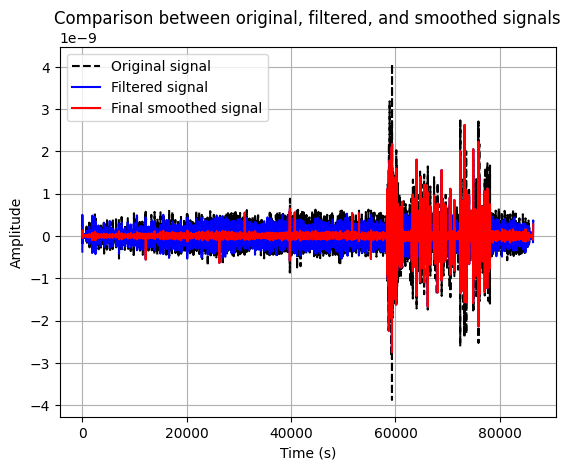

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1972-07-17HR00_evid00067.csv

Segment 1:
  Low cutoff frequency: 0.014216470588235296 Hz
  High cutoff frequency: 0.052600941176470586 Hz
  Total energy: 1.561143677555112e-18

Segment 2:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.026500000000000003 Hz
  Total energy: 9.1191627355567e-17

Segment 3:
  Low cutoff frequency: 0.015142857142857144 Hz
  High cutoff frequency: 0.04921428571428572 Hz
  Total energy: 1.6323725120080428e-16

Segment 4:
  Low cutoff frequency: 0.01892857142857143 Hz
  High cutoff frequency: 0.053 Hz
  Total energy: 1.5736178705164714e-16

Segment 5:
  Low cutoff frequency: 0.007227272727272728 Hz
  High cutoff frequency: 0.04095454545454545 Hz
  Total energy: 1.137435552702629e-16

Segment 6:
  Low cutoff frequency: 0.011477963525835867 Hz
  High cutoff frequency: 0.05195288753799392 Hz
  Total energy: 2.5102406522276483e-17
Segment 1 has significantly lower energy. Average f

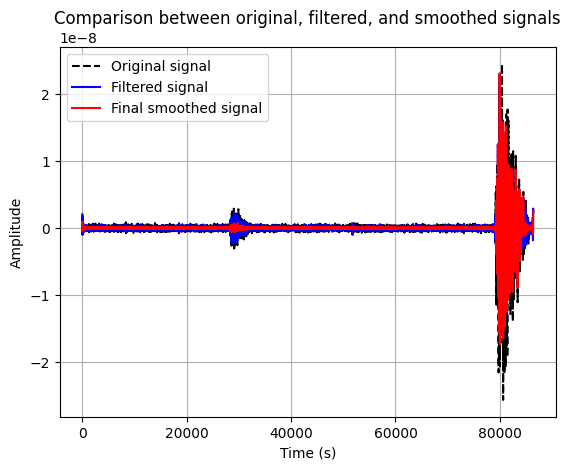

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1972-07-17HR00_evid00068.csv

Segment 1:
  Low cutoff frequency: 0.014216470588235296 Hz
  High cutoff frequency: 0.052600941176470586 Hz
  Total energy: 1.561143677555112e-18

Segment 2:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.026500000000000003 Hz
  Total energy: 9.1191627355567e-17

Segment 3:
  Low cutoff frequency: 0.015142857142857144 Hz
  High cutoff frequency: 0.04921428571428572 Hz
  Total energy: 1.6323725120080428e-16

Segment 4:
  Low cutoff frequency: 0.01892857142857143 Hz
  High cutoff frequency: 0.053 Hz
  Total energy: 1.5736178705164714e-16

Segment 5:
  Low cutoff frequency: 0.007227272727272728 Hz
  High cutoff frequency: 0.04095454545454545 Hz
  Total energy: 1.137435552702629e-16

Segment 6:
  Low cutoff frequency: 0.011477963525835867 Hz
  High cutoff frequency: 0.05195288753799392 Hz
  Total energy: 2.5102406522276483e-17
Segment 1 has significantly lower energy. Average f

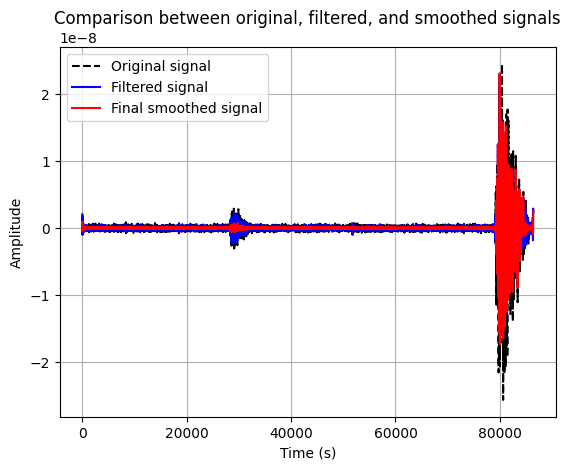

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1972-07-28HR00_evid00070.csv

Segment 1:
  Low cutoff frequency: 0.015561702127659574 Hz
  High cutoff frequency: 0.051195744680851064 Hz
  Total energy: 1.1881355792128382e-19

Segment 2:
  Low cutoff frequency: 0.03407142857142857 Hz
  High cutoff frequency: 0.05678571428571429 Hz
  Total energy: 1.5604442170487588e-18

Segment 3:
  Low cutoff frequency: 0.013947368421052634 Hz
  High cutoff frequency: 0.05160526315789474 Hz
  Total energy: 1.8791478268989172e-18

Segment 4:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.053000000000000005 Hz
  Total energy: 8.209336110803058e-19

Segment 5:
  Low cutoff frequency: 0.026500000000000003 Hz
  High cutoff frequency: 0.026500000000000003 Hz
  Total energy: 2.0853065927945294e-18

Segment 6:
  Low cutoff frequency: 0.012983010667720268 Hz
  High cutoff frequency: 0.05232467404188068 Hz
  Total energy: 8.575841974370209e-20
Segment 1 has significantly lower

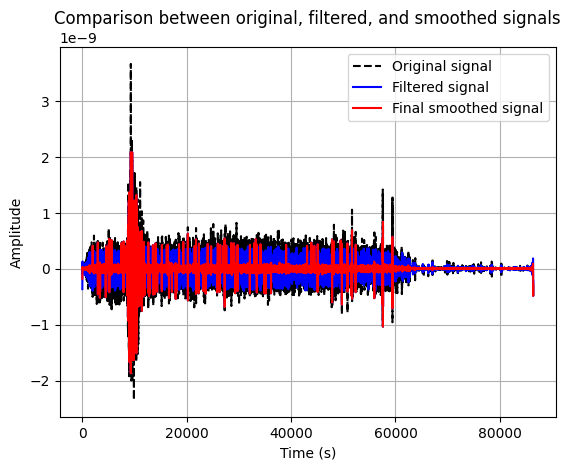

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1972-07-31HR00_evid00071.csv

Segment 1:
  Low cutoff frequency: 0.015954859114433586 Hz
  High cutoff frequency: 0.054173375503162736 Hz
  Total energy: 1.6535606968907697e-19

Segment 2:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.026500000000000003 Hz
  Total energy: 4.922866658723815e-18

Segment 3:
  Low cutoff frequency: 0.008833333333333334 Hz
  High cutoff frequency: 0.05594444444444445 Hz
  Total energy: 1.903284787974833e-17

Segment 4:
  Low cutoff frequency: 0.011357142857142857 Hz
  High cutoff frequency: 0.04921428571428572 Hz
  Total energy: 1.1811190706848696e-17

Segment 5:
  Low cutoff frequency: 0.012740384615384615 Hz
  High cutoff frequency: 0.04892307692307692 Hz
  Total energy: 8.511864602755986e-18

Segment 6:
  Low cutoff frequency: 0.0129804898298049 Hz
  High cutoff frequency: 0.05208696554586966 Hz
  Total energy: 2.0102932480257458e-19
Segment 1 has significantly lower en

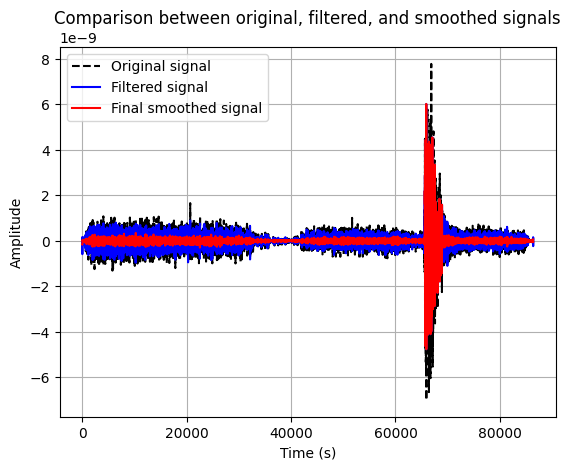

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1972-12-02HR00_evid00083.csv

Segment 1:
  Low cutoff frequency: 0.015438247965533747 Hz
  High cutoff frequency: 0.05032336045955003 Hz
  Total energy: 1.414001373900282e-19

Segment 2:
  Low cutoff frequency: 0.008833333333333334 Hz
  High cutoff frequency: 0.04858333333333333 Hz
  Total energy: 9.349524729455712e-19

Segment 3:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.026500000000000003 Hz
  Total energy: 1.6694351969840737e-18

Segment 4:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.026500000000000003 Hz
  Total energy: 9.982196880852375e-19

Segment 5:
  Low cutoff frequency: 0.012891891891891893 Hz
  High cutoff frequency: 0.053 Hz
  Total energy: 8.683147821720434e-19

Segment 6:
  Low cutoff frequency: 0.012773136246786632 Hz
  High cutoff frequency: 0.049219151670951165 Hz
  Total energy: 1.4611752243581745e-19


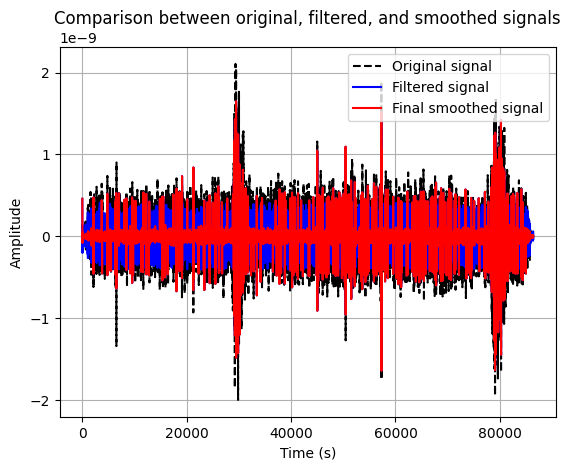

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1972-12-03HR00_evid00084.csv

Segment 1:
  Low cutoff frequency: 0.013431055900621118 Hz
  High cutoff frequency: 0.05062981366459627 Hz
  Total energy: 1.8752476432561872e-19

Segment 2:
  Low cutoff frequency: 0.014095744680851063 Hz
  High cutoff frequency: 0.053 Hz
  Total energy: 1.2391259497063725e-19

Segment 3:
  Low cutoff frequency: 0.018131578947368422 Hz
  High cutoff frequency: 0.048815789473684215 Hz
  Total energy: 1.0738098618790233e-19

Segment 4:
  Low cutoff frequency: 0.008833333333333334 Hz
  High cutoff frequency: 0.04711111111111111 Hz
  Total energy: 1.5638562619813118e-19

Segment 5:
  Low cutoff frequency: 0.017858695652173913 Hz
  High cutoff frequency: 0.04896739130434783 Hz
  Total energy: 1.2362451447490518e-19

Segment 6:
  Low cutoff frequency: 0.014225579348782635 Hz
  High cutoff frequency: 0.05190781754180112 Hz
  Total energy: 8.183089957101604e-20


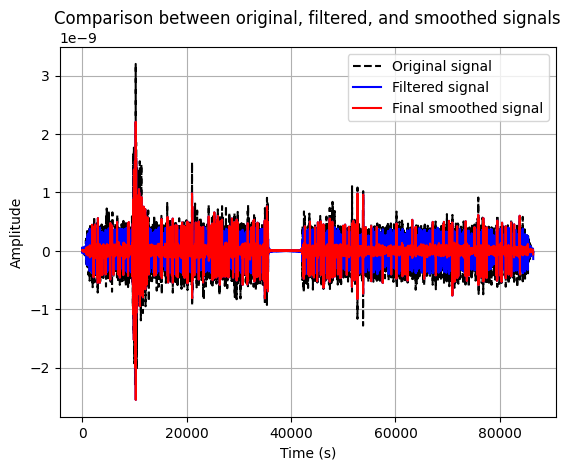

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1973-01-18HR00_evid00088.csv

Segment 1:
  Low cutoff frequency: 0.013135620172648797 Hz
  High cutoff frequency: 0.05263880054520673 Hz
  Total energy: 4.0428871182105515e-20

Segment 2:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.0 Hz
  Total energy: 1.6240204956482804e-19

Segment 3:
  Low cutoff frequency: 0.013250000000000001 Hz
  High cutoff frequency: 0.044166666666666674 Hz
  Total energy: 6.493856936993165e-19

Segment 4:
  Low cutoff frequency: 0.013250000000000001 Hz
  High cutoff frequency: 0.046375 Hz
  Total energy: 1.029708073045291e-18

Segment 5:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.026500000000000003 Hz
  Total energy: 7.447366266530669e-19

Segment 6:
  Low cutoff frequency: 0.01759765625 Hz
  High cutoff frequency: 0.05244791666666667 Hz
  Total energy: 3.1319727767404323e-19
Segment 1 has significantly lower energy. Average frequency threshold will be used.


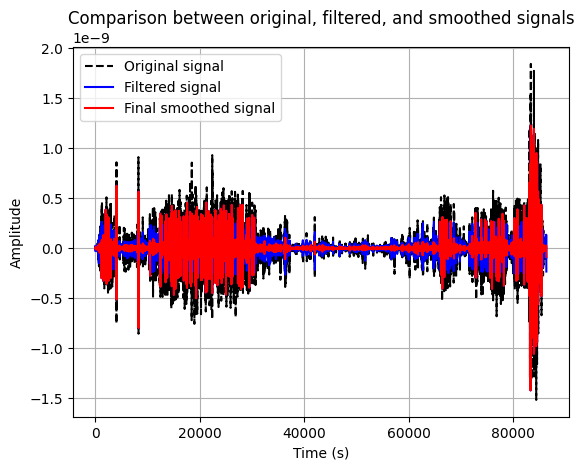

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1973-01-31HR00_evid00091.csv

Segment 1:
  Low cutoff frequency: 0.012385869565217393 Hz
  High cutoff frequency: 0.04752717391304348 Hz
  Total energy: 1.6125681056143952e-19

Segment 2:
  Low cutoff frequency: 0.013250000000000001 Hz
  High cutoff frequency: 0.03975 Hz
  Total energy: 1.5325393707873837e-18

Segment 3:
  Low cutoff frequency: 0.0106 Hz
  High cutoff frequency: 0.047700000000000006 Hz
  Total energy: 9.258163274019786e-19

Segment 4:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.026500000000000003 Hz
  Total energy: 1.1436167596130304e-18

Segment 5:
  Low cutoff frequency: 0.007571428571428572 Hz
  High cutoff frequency: 0.03785714285714286 Hz
  Total energy: 4.481352858119854e-19

Segment 6:
  Low cutoff frequency: 0.013574177586364887 Hz
  High cutoff frequency: 0.05124919820397691 Hz
  Total energy: 3.9130500719531446e-20
Segment 6 has significantly lower energy. Average frequency

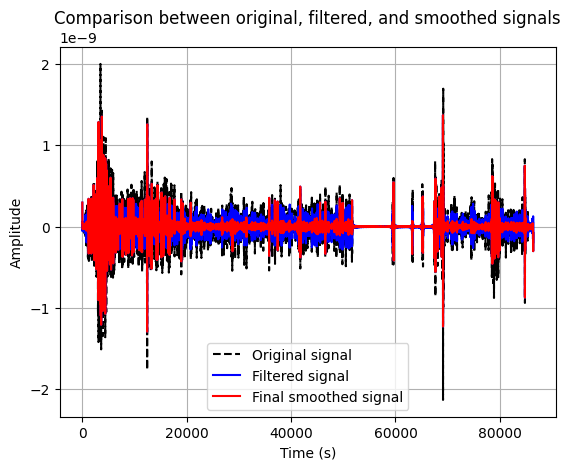

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1973-03-01HR00_evid00093.csv

Segment 1:
  Low cutoff frequency: 0.013095481049562683 Hz
  High cutoff frequency: 0.05157069970845481 Hz
  Total energy: 1.018273483593922e-19

Segment 2:
  Low cutoff frequency: 0.01164018691588785 Hz
  High cutoff frequency: 0.05027570093457944 Hz
  Total energy: 2.3071791676140326e-19

Segment 3:
  Low cutoff frequency: 0.008833333333333334 Hz
  High cutoff frequency: 0.053000000000000005 Hz
  Total energy: 5.493947286908167e-20

Segment 4:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.053000000000000005 Hz
  Total energy: 1.5175710051923568e-19

Segment 5:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.044166666666666674 Hz
  Total energy: 8.906656348219856e-20

Segment 6:
  Low cutoff frequency: 0.014383984952304179 Hz
  High cutoff frequency: 0.05226655918312509 Hz
  Total energy: 3.3373719278709406e-20


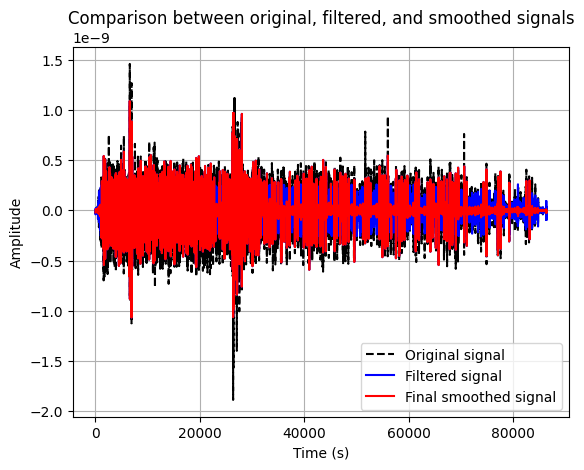

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1973-03-13HR00_evid00094.csv

Segment 1:
  Low cutoff frequency: 0.009783031088082903 Hz
  High cutoff frequency: 0.04555116580310881 Hz
  Total energy: 3.1450103636304353e-19

Segment 2:
  Low cutoff frequency: 0.0212 Hz
  High cutoff frequency: 0.053000000000000005 Hz
  Total energy: 2.542617192421594e-15

Segment 3:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.026500000000000003 Hz
  Total energy: 1.0481179931168081e-15

Segment 4:
  Low cutoff frequency: 0.029444444444444447 Hz
  High cutoff frequency: 0.04711111111111111 Hz
  Total energy: 7.199811068996522e-16

Segment 5:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.026500000000000003 Hz
  Total energy: 2.536625907325601e-16

Segment 6:
  Low cutoff frequency: 0.01672197386519945 Hz
  High cutoff frequency: 0.04934577028885832 Hz
  Total energy: 4.5683498339163674e-18


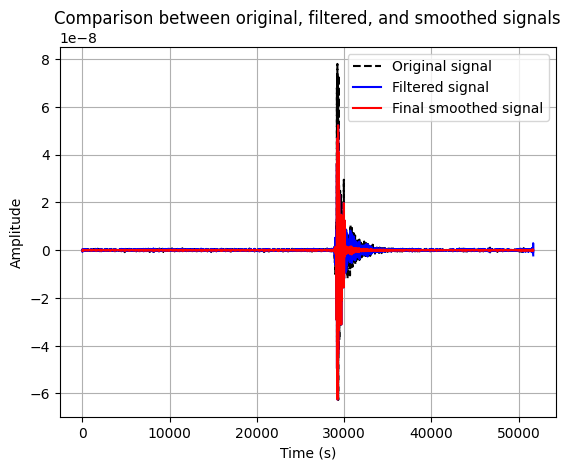

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1973-03-24HR00_evid00097.csv

Segment 1:
  Low cutoff frequency: 0.013705848623853212 Hz
  High cutoff frequency: 0.05307597477064221 Hz
  Total energy: 1.3869940119170053e-19

Segment 2:
  Low cutoff frequency: 0.01395982142857143 Hz
  High cutoff frequency: 0.05158035714285714 Hz
  Total energy: 2.3579210352952153e-19

Segment 3:
  Low cutoff frequency: 0.013250000000000001 Hz
  High cutoff frequency: 0.059625000000000004 Hz
  Total energy: 4.462507908712132e-18

Segment 4:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.0 Hz
  Total energy: 5.836452742336786e-18

Segment 5:
  Low cutoff frequency: 0.019272727272727275 Hz
  High cutoff frequency: 0.05420454545454545 Hz
  Total energy: 2.3074203523207047e-18

Segment 6:
  Low cutoff frequency: 0.013681667586968526 Hz
  High cutoff frequency: 0.05150745444505798 Hz
  Total energy: 1.3284496708823812e-19


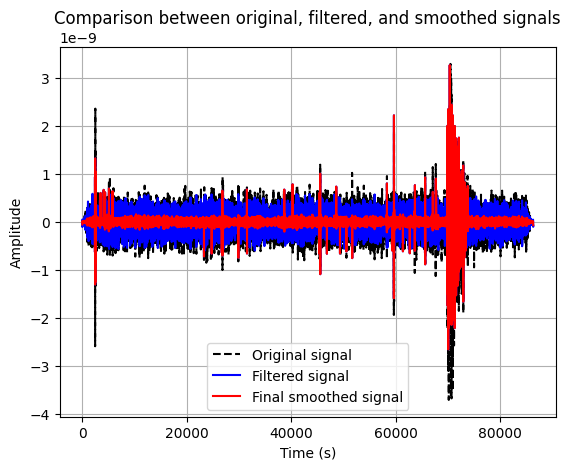

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1973-05-14HR00_evid00104.csv

Segment 1:
  Low cutoff frequency: 0.02061111111111111 Hz
  High cutoff frequency: 0.05594444444444445 Hz
  Total energy: 3.0677637364013463e-21

Segment 2:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.053000000000000005 Hz
  Total energy: 1.1605534445287681e-17

Segment 3:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.053000000000000005 Hz
  Total energy: 3.2811062937575455e-19

Segment 4:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.026500000000000003 Hz
  Total energy: 3.3902867081637744e-18

Segment 5:
  Low cutoff frequency: 0.013250000000000001 Hz
  High cutoff frequency: 0.03975 Hz
  Total energy: 2.3889951864618707e-18

Segment 6:
  Low cutoff frequency: 0.013862238900443078 Hz
  High cutoff frequency: 0.051375350393344794 Hz
  Total energy: 7.188404851251479e-20


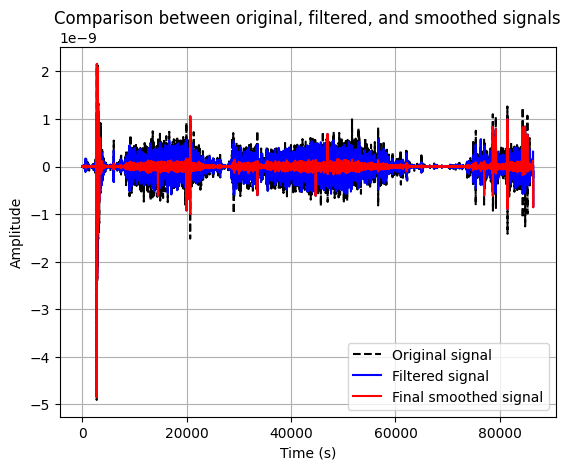

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1973-06-05HR00_evid00107.csv

Segment 1:
  Low cutoff frequency: 0.019547528517110266 Hz
  High cutoff frequency: 0.05289923954372624 Hz
  Total energy: 1.3688746747372528e-20

Segment 2:
  Low cutoff frequency: 0.0159 Hz
  High cutoff frequency: 0.0583 Hz
  Total energy: 9.828290183224352e-19

Segment 3:
  Low cutoff frequency: 0.020384615384615386 Hz
  High cutoff frequency: 0.05503846153846154 Hz
  Total energy: 1.6139647395260641e-18

Segment 4:
  Low cutoff frequency: 0.02296666666666667 Hz
  High cutoff frequency: 0.054766666666666665 Hz
  Total energy: 8.91534370790245e-19

Segment 5:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.026500000000000003 Hz
  Total energy: 7.788139968935255e-19

Segment 6:
  Low cutoff frequency: 0.01521429288366958 Hz
  High cutoff frequency: 0.054074575930944495 Hz
  Total energy: 5.1294512011535125e-20
Segment 1 has significantly lower energy. Average frequency thr

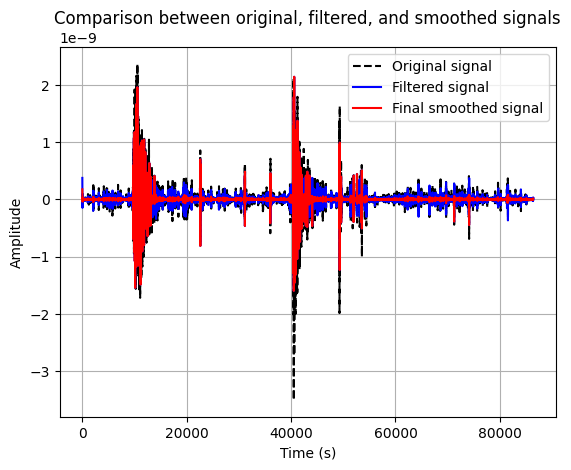

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1973-06-05HR00_evid00108.csv

Segment 1:
  Low cutoff frequency: 0.019547528517110266 Hz
  High cutoff frequency: 0.05289923954372624 Hz
  Total energy: 1.3688746747372528e-20

Segment 2:
  Low cutoff frequency: 0.0159 Hz
  High cutoff frequency: 0.0583 Hz
  Total energy: 9.828290183224352e-19

Segment 3:
  Low cutoff frequency: 0.020384615384615386 Hz
  High cutoff frequency: 0.05503846153846154 Hz
  Total energy: 1.6139647395260641e-18

Segment 4:
  Low cutoff frequency: 0.02296666666666667 Hz
  High cutoff frequency: 0.054766666666666665 Hz
  Total energy: 8.91534370790245e-19

Segment 5:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.026500000000000003 Hz
  Total energy: 7.788139968935255e-19

Segment 6:
  Low cutoff frequency: 0.01521429288366958 Hz
  High cutoff frequency: 0.054074575930944495 Hz
  Total energy: 5.1294512011535125e-20
Segment 1 has significantly lower energy. Average frequency thr

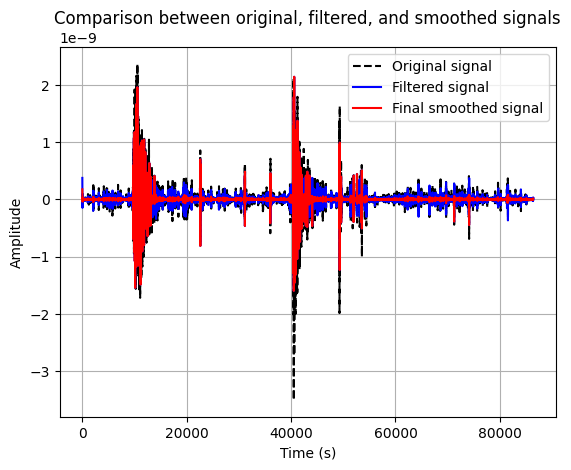

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1973-06-18HR00_evid00109.csv

Segment 1:
  Low cutoff frequency: 0.013573170731707319 Hz
  High cutoff frequency: 0.05283841463414634 Hz
  Total energy: 8.16034212614719e-20

Segment 2:
  Low cutoff frequency: 0.015142857142857144 Hz
  High cutoff frequency: 0.03785714285714286 Hz
  Total energy: 3.331958263120913e-19

Segment 3:
  Low cutoff frequency: 0.026500000000000003 Hz
  High cutoff frequency: 0.026500000000000003 Hz
  Total energy: 4.17102051245028e-18

Segment 4:
  Low cutoff frequency: 0.01892857142857143 Hz
  High cutoff frequency: 0.04353571428571429 Hz
  Total energy: 1.418838996470805e-18

Segment 5:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.026500000000000003 Hz
  Total energy: 8.361057552359631e-19

Segment 6:
  Low cutoff frequency: 0.01524871599771733 Hz
  High cutoff frequency: 0.05058540992961765 Hz
  Total energy: 9.255945035878297e-20


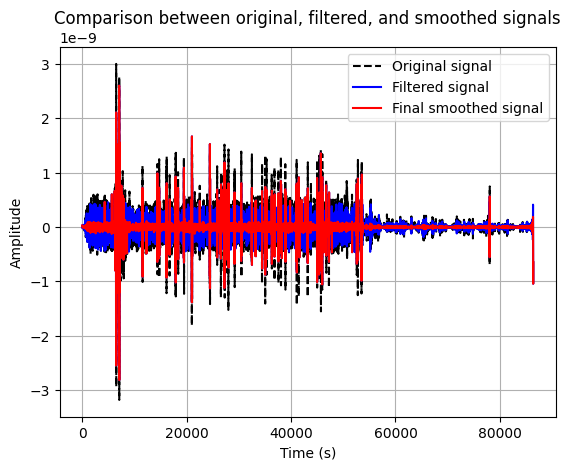

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1973-06-27HR00_evid00112.csv

Segment 1:
  Low cutoff frequency: 0.014796954314720813 Hz
  High cutoff frequency: 0.05286548223350254 Hz
  Total energy: 9.3964132673559e-20

Segment 2:
  Low cutoff frequency: 0.017666666666666667 Hz
  High cutoff frequency: 0.026500000000000003 Hz
  Total energy: 1.9939210930793505e-19

Segment 3:
  Low cutoff frequency: 0.012336206896551724 Hz
  High cutoff frequency: 0.050715517241379314 Hz
  Total energy: 1.045220398705044e-19

Segment 4:
  Low cutoff frequency: 0.013250000000000001 Hz
  High cutoff frequency: 0.053000000000000005 Hz
  Total energy: 1.5052032900957653e-19

Segment 5:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.0 Hz
  Total energy: 1.1325024116435465e-19

Segment 6:
  Low cutoff frequency: 0.014421768707482994 Hz
  High cutoff frequency: 0.05162575174997535 Hz
  Total energy: 1.1636101763842942e-19


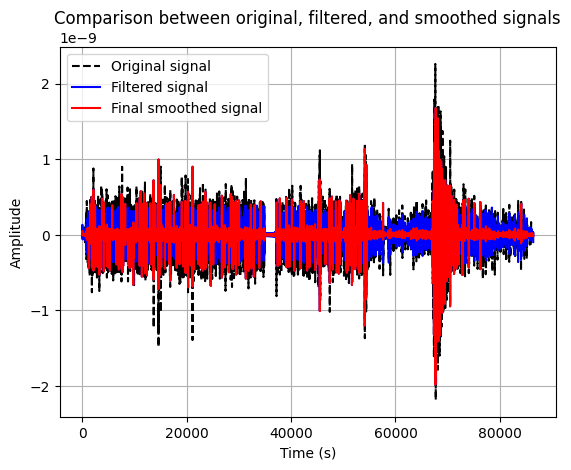

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1973-07-03HR00_evid00113.csv

Segment 1:
  Low cutoff frequency: 0.015643304843304843 Hz
  High cutoff frequency: 0.05432877492877493 Hz
  Total energy: 4.7688958546140945e-20

Segment 2:
  Low cutoff frequency: 0.007227272727272728 Hz
  High cutoff frequency: 0.04577272727272728 Hz
  Total energy: 2.8647276997909834e-18

Segment 3:
  Low cutoff frequency: 0.022083333333333337 Hz
  High cutoff frequency: 0.053000000000000005 Hz
  Total energy: 2.756896258590446e-18

Segment 4:
  Low cutoff frequency: 0.023850000000000003 Hz
  High cutoff frequency: 0.05035 Hz
  Total energy: 2.5929848368138627e-18

Segment 5:
  Low cutoff frequency: 0.014454545454545456 Hz
  High cutoff frequency: 0.053 Hz
  Total energy: 1.408823203134378e-18

Segment 6:
  Low cutoff frequency: 0.014247885622231175 Hz
  High cutoff frequency: 0.04893374949657673 Hz
  Total energy: 8.618539318903105e-20
Segment 1 has significantly lower energy. Av

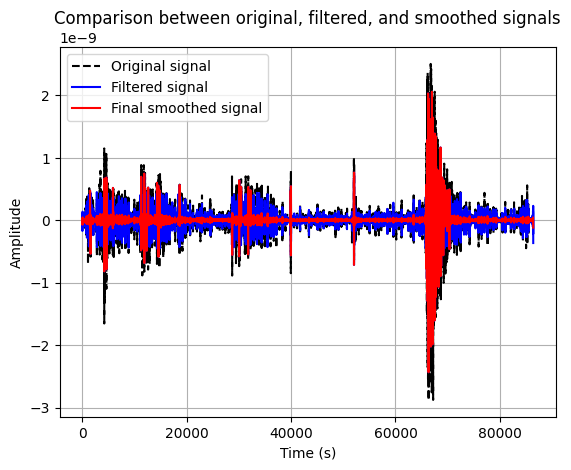

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1973-07-04HR00_evid00114.csv

Segment 1:
  Low cutoff frequency: 0.015495016611295681 Hz
  High cutoff frequency: 0.05088704318936878 Hz
  Total energy: 8.669505019103098e-20

Segment 2:
  Low cutoff frequency: 0.026500000000000003 Hz
  High cutoff frequency: 0.06625 Hz
  Total energy: 1.0760587593148483e-18

Segment 3:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.026500000000000003 Hz
  Total energy: 1.4614012096384727e-18

Segment 4:
  Low cutoff frequency: 0.011777777777777778 Hz
  High cutoff frequency: 0.050055555555555555 Hz
  Total energy: 1.1163927647422378e-18

Segment 5:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.0 Hz
  Total energy: 6.183315847478083e-19

Segment 6:
  Low cutoff frequency: 0.014808665721806034 Hz
  High cutoff frequency: 0.05140109333873254 Hz
  Total energy: 3.158601563339258e-20
Segment 1 has significantly lower energy. Average frequency threshold will be u

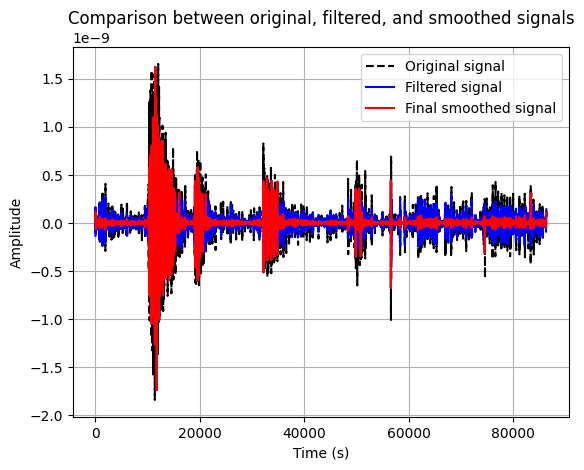

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1973-07-20HR00_evid00117.csv

Segment 1:
  Low cutoff frequency: 0.014717379385964912 Hz
  High cutoff frequency: 0.051503563596491234 Hz
  Total energy: 7.18917689199883e-20

Segment 2:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.026500000000000003 Hz
  Total energy: 8.449356193822551e-19

Segment 3:
  Low cutoff frequency: 0.026500000000000003 Hz
  High cutoff frequency: 0.059625000000000004 Hz
  Total energy: 8.573571893694687e-19

Segment 4:
  Low cutoff frequency: 0.013250000000000001 Hz
  High cutoff frequency: 0.053000000000000005 Hz
  Total energy: 9.250939141710376e-19

Segment 5:
  Low cutoff frequency: 0.012207865168539327 Hz
  High cutoff frequency: 0.0521811797752809 Hz
  Total energy: 7.266645210508162e-20

Segment 6:
  Low cutoff frequency: 0.011342412451361868 Hz
  High cutoff frequency: 0.05516536964980545 Hz
  Total energy: 2.1422449449273147e-20
Segment 6 has significantly lower en

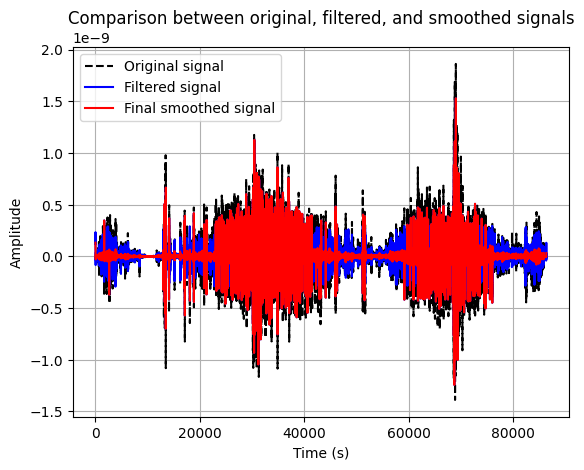

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1973-07-28HR00_evid00120.csv

Segment 1:
  Low cutoff frequency: 0.017666666666666667 Hz
  High cutoff frequency: 0.028708333333333336 Hz
  Total energy: 2.9677515950043167e-19

Segment 2:
  Low cutoff frequency: 0.013250000000000001 Hz
  High cutoff frequency: 0.046375 Hz
  Total energy: 4.95155314043511e-17

Segment 3:
  Low cutoff frequency: 0.013250000000000001 Hz
  High cutoff frequency: 0.03975 Hz
  Total energy: 4.497630716932449e-17

Segment 4:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.026500000000000003 Hz
  Total energy: 1.1218897441384974e-16

Segment 5:
  Low cutoff frequency: 0.013250000000000001 Hz
  High cutoff frequency: 0.03975 Hz
  Total energy: 3.555767251662517e-17

Segment 6:
  Low cutoff frequency: 0.016518727786384763 Hz
  High cutoff frequency: 0.05087236854096419 Hz
  Total energy: 2.2725625013962416e-19
Segment 1 has significantly lower energy. Average frequency threshold 

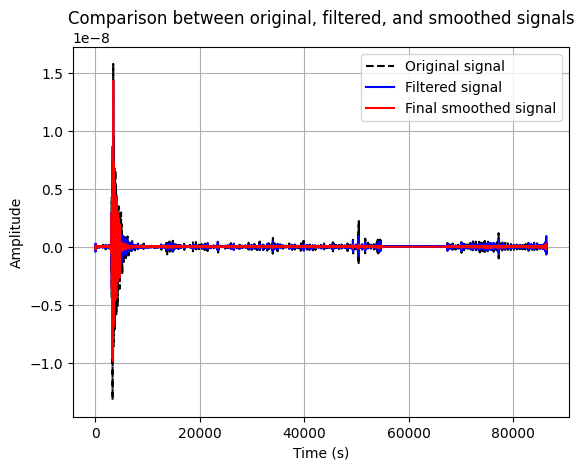

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1973-07-29HR00_evid00121.csv

Segment 1:
  Low cutoff frequency: 0.015704140694568124 Hz
  High cutoff frequency: 0.052799421193232415 Hz
  Total energy: 1.5376471920143375e-20

Segment 2:
  Low cutoff frequency: 0.022083333333333337 Hz
  High cutoff frequency: 0.05741666666666667 Hz
  Total energy: 5.53988738044533e-19

Segment 3:
  Low cutoff frequency: 0.009636363636363637 Hz
  High cutoff frequency: 0.04577272727272728 Hz
  Total energy: 4.620861175592843e-19

Segment 4:
  Low cutoff frequency: 0.026500000000000003 Hz
  High cutoff frequency: 0.026500000000000003 Hz
  Total energy: 2.1449525950976487e-19

Segment 5:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.0 Hz
  Total energy: 1.8527384191813045e-19

Segment 6:
  Low cutoff frequency: 0.021370967741935483 Hz
  High cutoff frequency: 0.04844086021505376 Hz
  Total energy: 3.8265293156660665e-20
Segment 1 has significantly lower energy. Average 

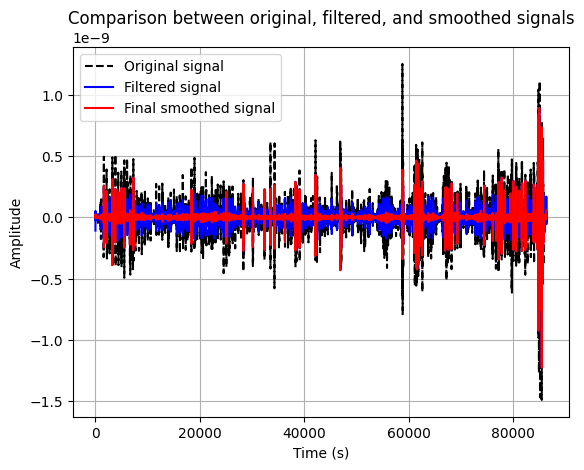

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1973-08-21HR00_evid00127.csv

Segment 1:
  Low cutoff frequency: 0.012293360995850624 Hz
  High cutoff frequency: 0.053747717842323656 Hz
  Total energy: 1.8165496071592377e-19

Segment 2:
  Low cutoff frequency: 0.017666666666666667 Hz
  High cutoff frequency: 0.053000000000000005 Hz
  Total energy: 5.630209129084384e-18

Segment 3:
  Low cutoff frequency: 0.006625000000000001 Hz
  High cutoff frequency: 0.033125 Hz
  Total energy: 4.3370316680159614e-18

Segment 4:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.026500000000000003 Hz
  Total energy: 2.9293516481641982e-18

Segment 5:
  Low cutoff frequency: 0.0106 Hz
  High cutoff frequency: 0.047700000000000006 Hz
  Total energy: 3.594669126361052e-18

Segment 6:
  Low cutoff frequency: 0.013365348221044664 Hz
  High cutoff frequency: 0.05022662755488267 Hz
  Total energy: 1.7309773691135695e-19
Segment 1 has significantly lower energy. Average freque

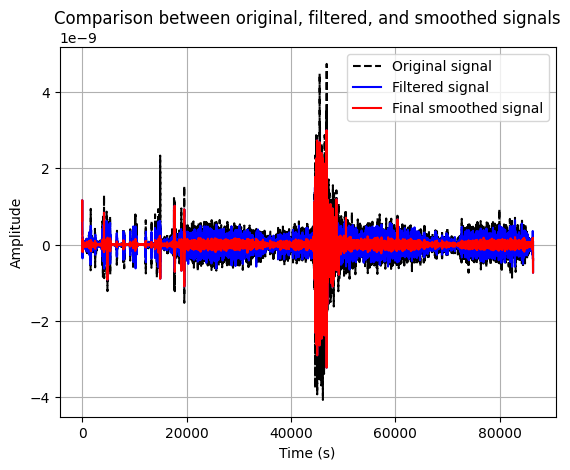

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1974-01-10HR00_evid00136.csv

Segment 1:
  Low cutoff frequency: 0.013369154676258994 Hz
  High cutoff frequency: 0.051653552158273386 Hz
  Total energy: 7.906433344971661e-20

Segment 2:
  Low cutoff frequency: 0.0165625 Hz
  High cutoff frequency: 0.059625000000000004 Hz
  Total energy: 5.42273486329723e-19

Segment 3:
  Low cutoff frequency: 0.017666666666666667 Hz
  High cutoff frequency: 0.035333333333333335 Hz
  Total energy: 2.03778190700543e-18

Segment 4:
  Low cutoff frequency: 0.0106 Hz
  High cutoff frequency: 0.0424 Hz
  Total energy: 1.6923006320007913e-18

Segment 5:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.03975 Hz
  Total energy: 8.121515423853423e-19

Segment 6:
  Low cutoff frequency: 0.017311557788944724 Hz
  High cutoff frequency: 0.051934673366834175 Hz
  Total energy: 5.437312874092356e-19
Segment 1 has significantly lower energy. Average frequency threshold will be used.


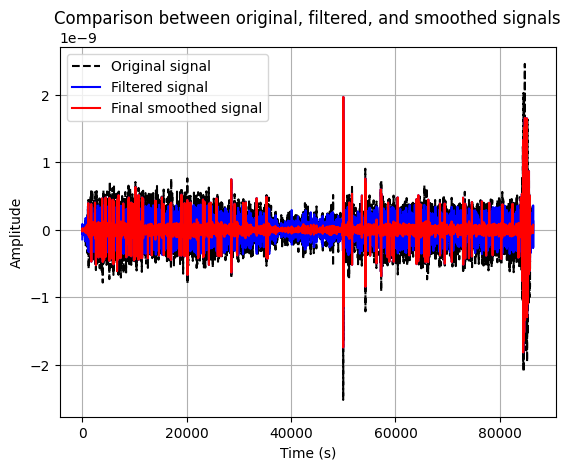

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1974-02-07HR00_evid00137.csv

Segment 1:
  Low cutoff frequency: 0.018339546191247974 Hz
  High cutoff frequency: 0.052957050243111835 Hz
  Total energy: 9.30275269656105e-20

Segment 2:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.0 Hz
  Total energy: 1.0425126988562929e-17

Segment 3:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.03975 Hz
  Total energy: 1.3986268784903136e-17

Segment 4:
  Low cutoff frequency: 0.0212 Hz
  High cutoff frequency: 0.0583 Hz
  Total energy: 1.3185357402133763e-17

Segment 5:
  Low cutoff frequency: 0.022083333333333337 Hz
  High cutoff frequency: 0.05520833333333333 Hz
  Total energy: 7.607367717419658e-18

Segment 6:
  Low cutoff frequency: 0.014814859632139401 Hz
  High cutoff frequency: 0.054433385769603104 Hz
  Total energy: 1.8615162578360092e-19
Segment 1 has significantly lower energy. Average frequency threshold will be used.
Segment 6 has signific

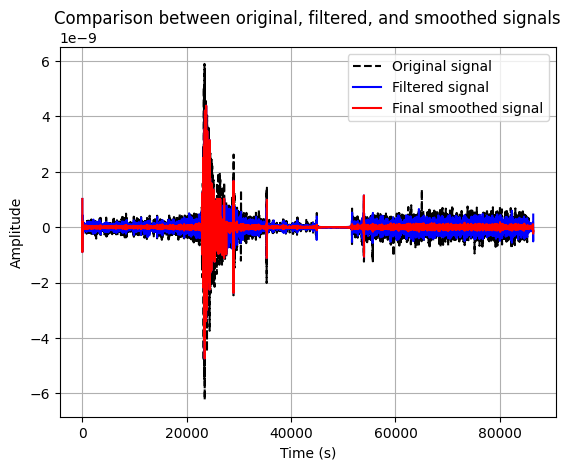

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1974-02-12HR00_evid00138.csv

Segment 1:
  Low cutoff frequency: 0.01425406787540679 Hz
  High cutoff frequency: 0.050240353324035335 Hz
  Total energy: 1.4625091618643564e-19

Segment 2:
  Low cutoff frequency: 0.026500000000000003 Hz
  High cutoff frequency: 0.03975 Hz
  Total energy: 1.5760929143021462e-16

Segment 3:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.026500000000000003 Hz
  Total energy: 6.371466986935395e-17

Segment 4:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.053000000000000005 Hz
  Total energy: 6.516161815279686e-17

Segment 5:
  Low cutoff frequency: 0.019875 Hz
  High cutoff frequency: 0.053000000000000005 Hz
  Total energy: 1.3308744867834912e-16

Segment 6:
  Low cutoff frequency: 0.01316896024464832 Hz
  High cutoff frequency: 0.049029051987767594 Hz
  Total energy: 1.6362347939064817e-18
Segment 1 has significantly lower energy. Average frequency threshold wil

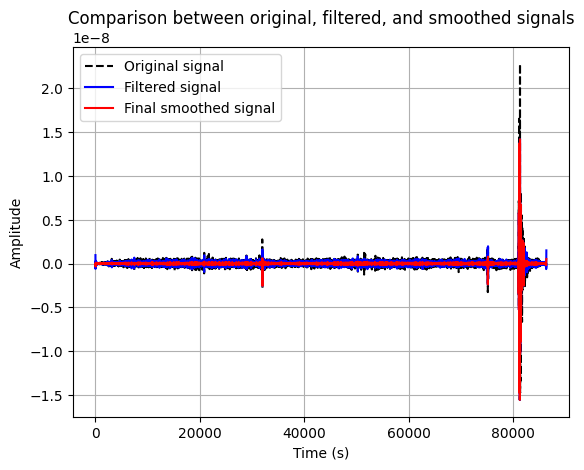

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1974-03-25HR00_evid00140.csv

Segment 1:
  Low cutoff frequency: 0.013136335784313728 Hz
  High cutoff frequency: 0.05082414215686275 Hz
  Total energy: 2.3147393256428996e-20

Segment 2:
  Low cutoff frequency: 0.0165625 Hz
  High cutoff frequency: 0.046375 Hz
  Total energy: 7.161178043881242e-19

Segment 3:
  Low cutoff frequency: 0.014133333333333335 Hz
  High cutoff frequency: 0.0424 Hz
  Total energy: 1.948675741749333e-18

Segment 4:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.026500000000000003 Hz
  Total energy: 1.3041066703989157e-18

Segment 5:
  Low cutoff frequency: 0.026500000000000003 Hz
  High cutoff frequency: 0.053000000000000005 Hz
  Total energy: 1.503402955539809e-18

Segment 6:
  Low cutoff frequency: 0.01413948701709943 Hz
  High cutoff frequency: 0.05181681443951869 Hz
  Total energy: 6.707626822532492e-20
Segment 1 has significantly lower energy. Average frequency threshold w

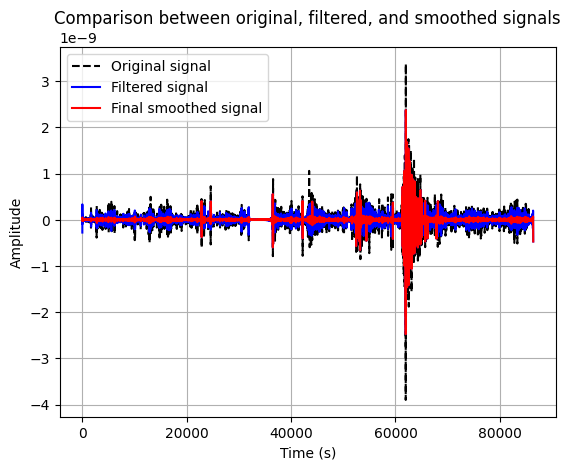

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1974-04-19HR00_evid00142.csv

Segment 1:
  Low cutoff frequency: 0.014198028169014085 Hz
  High cutoff frequency: 0.049192957746478874 Hz
  Total energy: 8.157712649792704e-20

Segment 2:
  Low cutoff frequency: 0.022714285714285715 Hz
  High cutoff frequency: 0.04921428571428572 Hz
  Total energy: 1.4231560924033064e-17

Segment 3:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.053000000000000005 Hz
  Total energy: 1.3768838673509561e-17

Segment 4:
  Low cutoff frequency: 0.021681818181818184 Hz
  High cutoff frequency: 0.04818181818181819 Hz
  Total energy: 1.421336595539265e-17

Segment 5:
  Low cutoff frequency: 0.013250000000000001 Hz
  High cutoff frequency: 0.051527777777777777 Hz
  Total energy: 6.6218071994837585e-18

Segment 6:
  Low cutoff frequency: 0.013066512798992867 Hz
  High cutoff frequency: 0.05393411665967268 Hz
  Total energy: 3.3705186958128105e-19
Segment 1 has significantly lowe

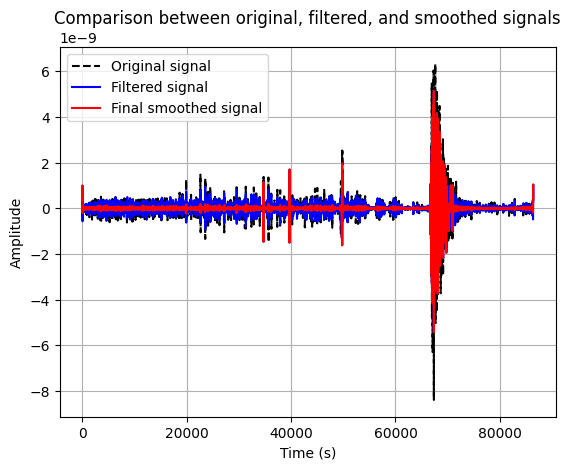

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1974-04-08HR00_evid00141.csv

Segment 1:
  Low cutoff frequency: 0.01221653084982538 Hz
  High cutoff frequency: 0.0535244470314319 Hz
  Total energy: 9.655130121337824e-20

Segment 2:
  Low cutoff frequency: 0.011357142857142857 Hz
  High cutoff frequency: 0.03785714285714286 Hz
  Total energy: 3.937930119403745e-19

Segment 3:
  Low cutoff frequency: 0.0182887323943662 Hz
  High cutoff frequency: 0.05150704225352113 Hz
  Total energy: 9.414395893257421e-20

Segment 4:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.026500000000000003 Hz
  Total energy: 1.1436302906894709e-19

Segment 5:
  Low cutoff frequency: 0.015142857142857144 Hz
  High cutoff frequency: 0.052053571428571435 Hz
  Total energy: 1.274432536493674e-19

Segment 6:
  Low cutoff frequency: 0.012657520325203253 Hz
  High cutoff frequency: 0.05231326219512195 Hz
  Total energy: 1.259011367785959e-19


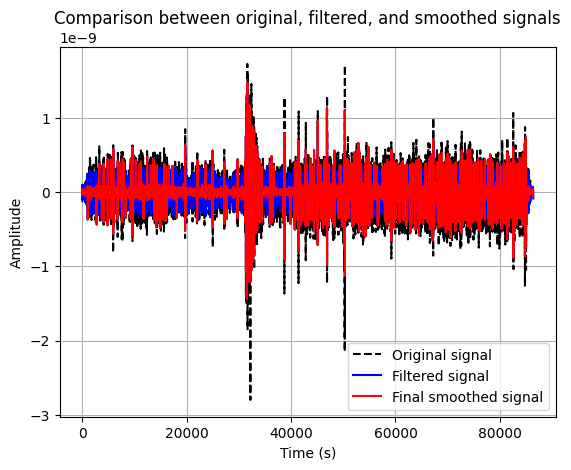

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1974-04-26HR00_evid00144.csv

Segment 1:
  Low cutoff frequency: 0.011211538461538462 Hz
  High cutoff frequency: 0.05096153846153846 Hz
  Total energy: 7.334715877362489e-20

Segment 2:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.053000000000000005 Hz
  Total energy: 1.7226803037271661e-19

Segment 3:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.026500000000000003 Hz
  Total energy: 6.560072405904582e-19

Segment 4:
  Low cutoff frequency: 0.03975 Hz
  High cutoff frequency: 0.053000000000000005 Hz
  Total energy: 2.630903213362964e-19

Segment 5:
  Low cutoff frequency: 0.01855 Hz
  High cutoff frequency: 0.053000000000000005 Hz
  Total energy: 3.2737437860721708e-19

Segment 6:
  Low cutoff frequency: 0.013918215778706753 Hz
  High cutoff frequency: 0.04995708440807614 Hz
  Total energy: 1.4035836747489987e-19


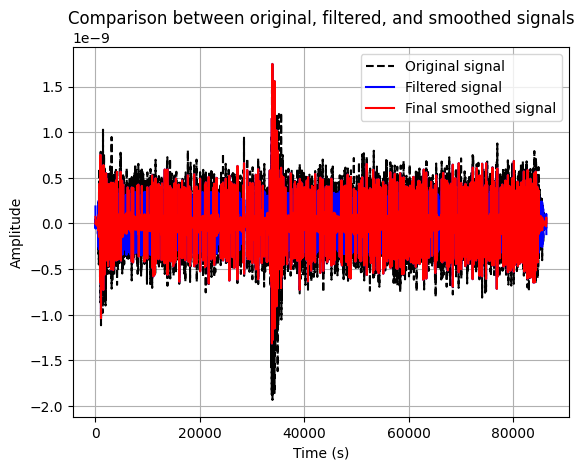

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1974-04-27HR00_evid00145.csv

Segment 1:
  Low cutoff frequency: 0.012728498542274053 Hz
  High cutoff frequency: 0.05054701166180758 Hz
  Total energy: 1.3040433448187087e-19

Segment 2:
  Low cutoff frequency: 0.015142857142857144 Hz
  High cutoff frequency: 0.053 Hz
  Total energy: 7.211239590333798e-19

Segment 3:
  Low cutoff frequency: 0.012366666666666666 Hz
  High cutoff frequency: 0.04593333333333334 Hz
  Total energy: 1.0701563178401391e-18

Segment 4:
  Low cutoff frequency: 0.016367647058823532 Hz
  High cutoff frequency: 0.05222058823529412 Hz
  Total energy: 5.125066322563389e-19

Segment 5:
  Low cutoff frequency: 0.014454545454545456 Hz
  High cutoff frequency: 0.04990259740259741 Hz
  Total energy: 1.6074088332930238e-19

Segment 6:
  Low cutoff frequency: 0.0175293143002804 Hz
  High cutoff frequency: 0.04958195258730564 Hz
  Total energy: 1.460291281055996e-19


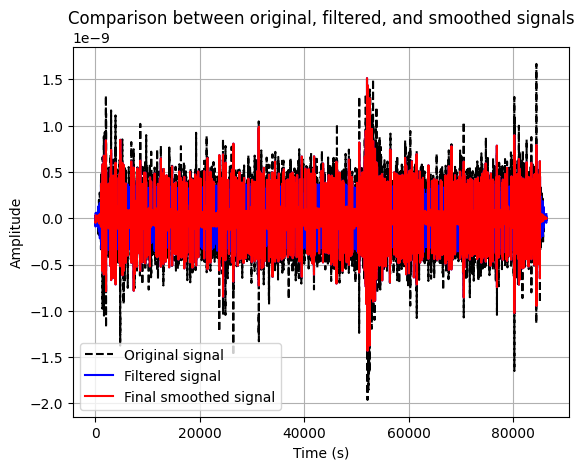

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1974-06-25HR00_evid00149.csv

Segment 1:
  Low cutoff frequency: 0.013706896551724138 Hz
  High cutoff frequency: 0.04736494252873564 Hz
  Total energy: 2.8936423195517195e-19

Segment 2:
  Low cutoff frequency: 0.016500446030330063 Hz
  High cutoff frequency: 0.0480593220338983 Hz
  Total energy: 1.5696011851370807e-19

Segment 3:
  Low cutoff frequency: 0.0106 Hz
  High cutoff frequency: 0.047700000000000006 Hz
  Total energy: 1.1655072694326317e-19

Segment 4:
  Low cutoff frequency: 0.018150684931506848 Hz
  High cutoff frequency: 0.04573972602739726 Hz
  Total energy: 1.4321833926109568e-19

Segment 5:
  Low cutoff frequency: 0.016685185185185185 Hz
  High cutoff frequency: 0.04612962962962963 Hz
  Total energy: 1.4657452556113176e-19

Segment 6:
  Low cutoff frequency: 0.01741481223922114 Hz
  High cutoff frequency: 0.05218300880853037 Hz
  Total energy: 1.5012849570691823e-19


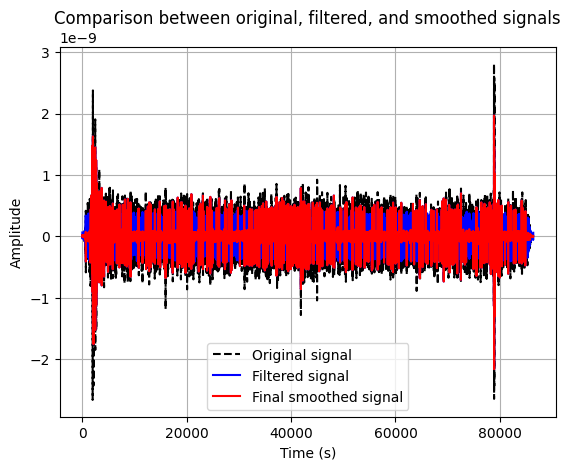

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1974-07-06HR00_evid00150.csv

Segment 1:
  Low cutoff frequency: 0.011933774834437087 Hz
  High cutoff frequency: 0.050543046357615896 Hz
  Total energy: 1.803400816618085e-19

Segment 2:
  Low cutoff frequency: 0.03975 Hz
  High cutoff frequency: 0.03975 Hz
  Total energy: 4.541992803891549e-18

Segment 3:
  Low cutoff frequency: 0.008833333333333334 Hz
  High cutoff frequency: 0.053000000000000005 Hz
  Total energy: 4.8116008183827395e-18

Segment 4:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.0 Hz
  Total energy: 3.1326363019491236e-18

Segment 5:
  Low cutoff frequency: 0.017390625 Hz
  High cutoff frequency: 0.046375 Hz
  Total energy: 2.316891981514979e-18

Segment 6:
  Low cutoff frequency: 0.013332905939070676 Hz
  High cutoff frequency: 0.05255692891578624 Hz
  Total energy: 1.4596802934505912e-19
Segment 1 has significantly lower energy. Average frequency threshold will be used.
Segment 6 h

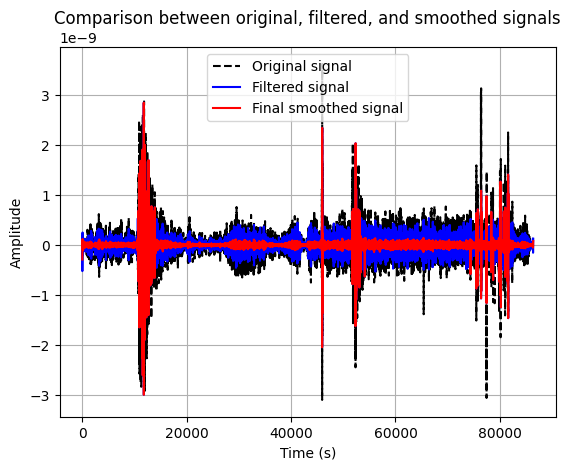

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1974-07-06HR00_evid00151.csv

Segment 1:
  Low cutoff frequency: 0.011933774834437087 Hz
  High cutoff frequency: 0.050543046357615896 Hz
  Total energy: 1.803400816618085e-19

Segment 2:
  Low cutoff frequency: 0.03975 Hz
  High cutoff frequency: 0.03975 Hz
  Total energy: 4.541992803891549e-18

Segment 3:
  Low cutoff frequency: 0.008833333333333334 Hz
  High cutoff frequency: 0.053000000000000005 Hz
  Total energy: 4.8116008183827395e-18

Segment 4:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.0 Hz
  Total energy: 3.1326363019491236e-18

Segment 5:
  Low cutoff frequency: 0.017390625 Hz
  High cutoff frequency: 0.046375 Hz
  Total energy: 2.316891981514979e-18

Segment 6:
  Low cutoff frequency: 0.013332905939070676 Hz
  High cutoff frequency: 0.05255692891578624 Hz
  Total energy: 1.4596802934505912e-19
Segment 1 has significantly lower energy. Average frequency threshold will be used.
Segment 6 h

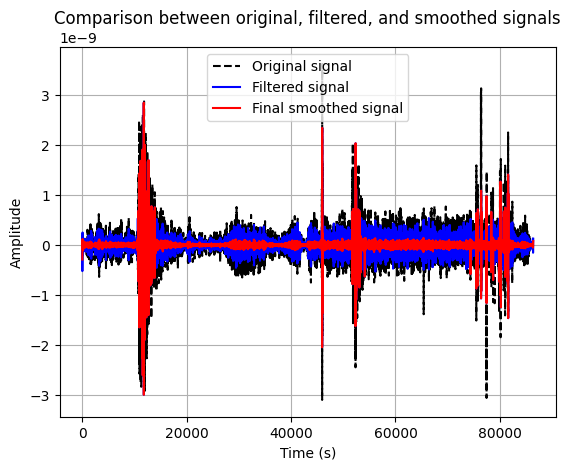

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1974-07-11HR00_evid00152.csv

Segment 1:
  Low cutoff frequency: 0.01475257731958763 Hz
  High cutoff frequency: 0.05491237113402062 Hz
  Total energy: 4.60374985424305e-19

Segment 2:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.03975 Hz
  Total energy: 3.608579678691426e-18

Segment 3:
  Low cutoff frequency: 0.013250000000000001 Hz
  High cutoff frequency: 0.026500000000000003 Hz
  Total energy: 7.96622838032732e-18

Segment 4:
  Low cutoff frequency: 0.009636363636363637 Hz
  High cutoff frequency: 0.04336363636363637 Hz
  Total energy: 7.447954906364008e-18

Segment 5:
  Low cutoff frequency: 0.010341463414634147 Hz
  High cutoff frequency: 0.04976829268292683 Hz
  Total energy: 2.607156081559633e-18

Segment 6:
  Low cutoff frequency: 0.014534818420067392 Hz
  High cutoff frequency: 0.05281893485585923 Hz
  Total energy: 1.569716467231797e-19
Segment 6 has significantly lower energy. Average fre

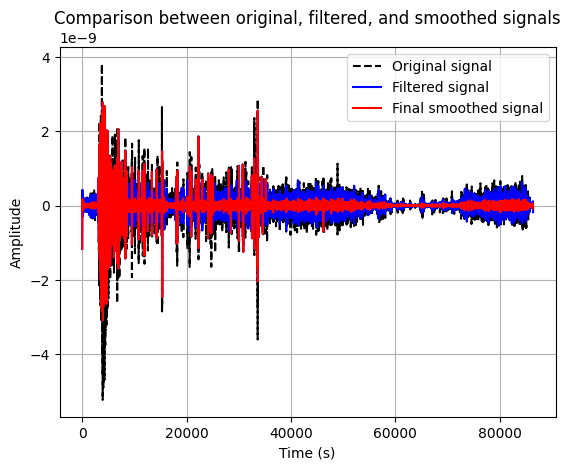

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1974-07-17HR00_evid00153.csv

Segment 1:
  Low cutoff frequency: 0.012155963302752294 Hz
  High cutoff frequency: 0.05105504587155964 Hz
  Total energy: 1.0791986321826421e-19

Segment 2:
  Low cutoff frequency: 0.015311669829222014 Hz
  High cutoff frequency: 0.05164231499051234 Hz
  Total energy: 1.3140591785066721e-19

Segment 3:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.026500000000000003 Hz
  Total energy: 1.0301137510665404e-18

Segment 4:
  Low cutoff frequency: 0.018770833333333334 Hz
  High cutoff frequency: 0.05741666666666667 Hz
  Total energy: 3.895448492285751e-18

Segment 5:
  Low cutoff frequency: 0.01892857142857143 Hz
  High cutoff frequency: 0.053 Hz
  Total energy: 1.1199528523218343e-18

Segment 6:
  Low cutoff frequency: 0.01308673469387755 Hz
  High cutoff frequency: 0.051887755102040814 Hz
  Total energy: 1.51922253597632e-19


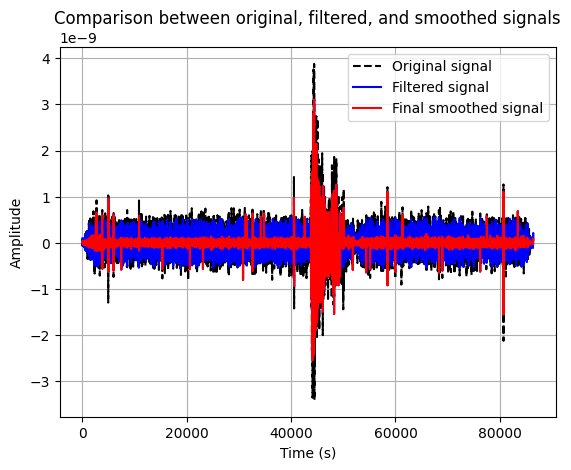

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1974-10-14HR00_evid00156.csv

Segment 1:
  Low cutoff frequency: 0.016589811542991755 Hz
  High cutoff frequency: 0.052438162544169616 Hz
  Total energy: 4.358837497598626e-20

Segment 2:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.053000000000000005 Hz
  Total energy: 6.965553850810541e-18

Segment 3:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.053000000000000005 Hz
  Total energy: 5.570908216976254e-18

Segment 4:
  Low cutoff frequency: 0.017666666666666667 Hz
  High cutoff frequency: 0.044166666666666674 Hz
  Total energy: 8.774287978032118e-18

Segment 5:
  Low cutoff frequency: 0.022083333333333337 Hz
  High cutoff frequency: 0.05741666666666667 Hz
  Total energy: 6.6974120258062416e-18

Segment 6:
  Low cutoff frequency: 0.013826883206634416 Hz
  High cutoff frequency: 0.04811938493434692 Hz
  Total energy: 2.7660794567088587e-19
Segment 1 has significantly lower energy. Average 

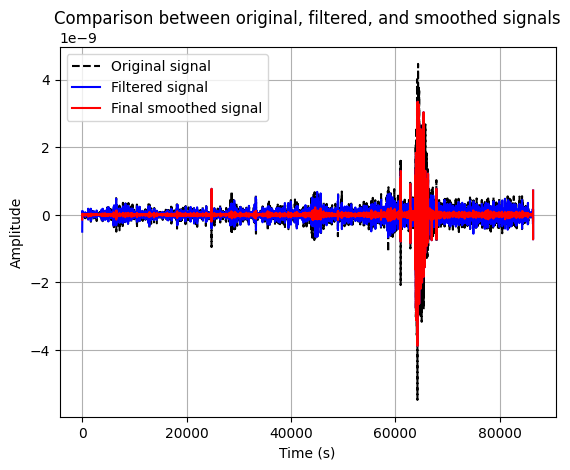

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1975-04-12HR00_evid00191.csv

Segment 1:
  Low cutoff frequency: 0.013680832857957787 Hz
  High cutoff frequency: 0.04241814033086138 Hz
  Total energy: 5.203912923111457e-19

Segment 2:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.026500000000000003 Hz
  Total energy: 4.319025360157454e-16

Segment 3:
  Low cutoff frequency: 0.026500000000000003 Hz
  High cutoff frequency: 0.044166666666666674 Hz
  Total energy: 1.108302887683547e-15

Segment 4:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.053000000000000005 Hz
  Total energy: 6.764317983347729e-16

Segment 5:
  Low cutoff frequency: 0.017666666666666667 Hz
  High cutoff frequency: 0.053000000000000005 Hz
  Total energy: 3.499460547931182e-16

Segment 6:
  Low cutoff frequency: 0.013103841764929632 Hz
  High cutoff frequency: 0.05140737923164702 Hz
  Total energy: 2.5375089647378e-17
Segment 1 has significantly lower energy. Average freq

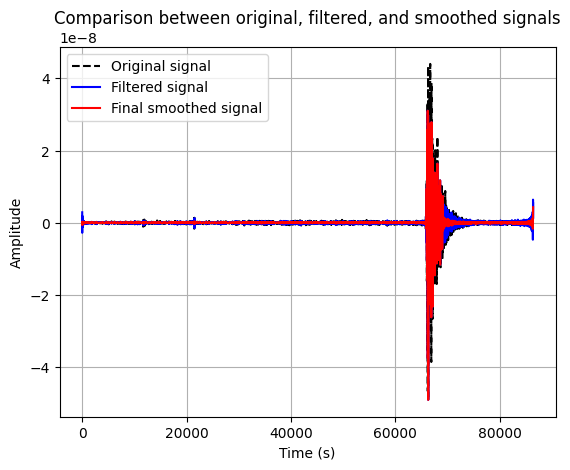

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1975-05-04HR00_evid00192.csv

Segment 1:
  Low cutoff frequency: 0.010749747729566096 Hz
  High cutoff frequency: 0.05083400605449042 Hz
  Total energy: 2.6659591872643664e-17

Segment 2:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.053000000000000005 Hz
  Total energy: 2.883683755529489e-15

Segment 3:
  Low cutoff frequency: 0.026500000000000003 Hz
  High cutoff frequency: 0.053000000000000005 Hz
  Total energy: 1.0429680879401505e-15

Segment 4:
  Low cutoff frequency: 0.017666666666666667 Hz
  High cutoff frequency: 0.05079166666666667 Hz
  Total energy: 1.9133834064493474e-15

Segment 5:
  Low cutoff frequency: 0.00795 Hz
  High cutoff frequency: 0.04505 Hz
  Total energy: 1.4601450122997228e-15

Segment 6:
  Low cutoff frequency: 0.011287652965171008 Hz
  High cutoff frequency: 0.05296673988076561 Hz
  Total energy: 1.9247463577618564e-17
Segment 1 has significantly lower energy. Average frequen

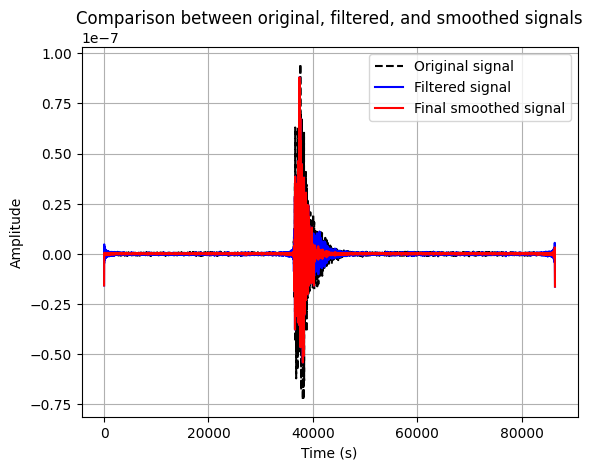

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1975-06-24HR00_evid00196.csv

Segment 1:
  Low cutoff frequency: 0.010684126984126985 Hz
  High cutoff frequency: 0.04677460317460318 Hz
  Total energy: 2.609973147869642e-19

Segment 2:
  Low cutoff frequency: 0.0 Hz
  High cutoff frequency: 0.026500000000000003 Hz
  Total energy: 8.893411612284027e-19

Segment 3:
  Low cutoff frequency: 0.013250000000000001 Hz
  High cutoff frequency: 0.059625000000000004 Hz
  Total energy: 6.849991562247423e-20

Segment 4:
  Low cutoff frequency: 0.013538043478260871 Hz
  High cutoff frequency: 0.05207826086956522 Hz
  Total energy: 1.1922305223827333e-19

Segment 5:
  Low cutoff frequency: 0.016863636363636362 Hz
  High cutoff frequency: 0.055409090909090915 Hz
  Total energy: 1.8636785875619928e-19

Segment 6:
  Low cutoff frequency: 0.014861797302710644 Hz
  High cutoff frequency: 0.050140873280811855 Hz
  Total energy: 1.5302928547033042e-19


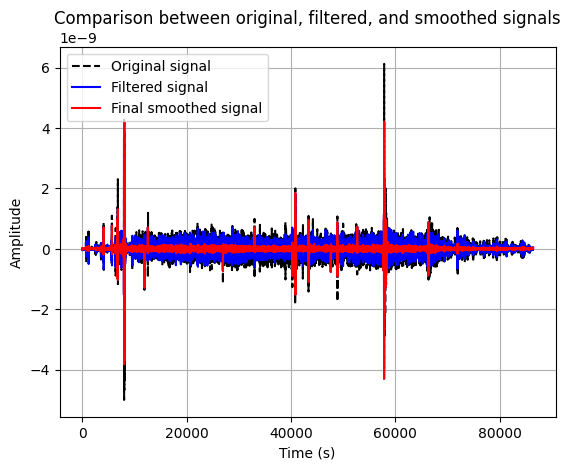

/content/drive/MyDrive/data/lunar/training/data/S12_GradeA/xa.s12.00.mhz.1975-06-26HR00_evid00198.csv

Segment 1:
  Low cutoff frequency: 0.014403965785381027 Hz
  High cutoff frequency: 0.05312363919129083 Hz
  Total energy: 1.4092504306122517e-19

Segment 2:
  Low cutoff frequency: 0.012045454545454547 Hz
  High cutoff frequency: 0.050590909090909096 Hz
  Total energy: 2.648736445741283e-19

Segment 3:
  Low cutoff frequency: 0.006625000000000001 Hz
  High cutoff frequency: 0.03975 Hz
  Total energy: 4.383383009444301e-19

Segment 4:
  Low cutoff frequency: 0.026500000000000003 Hz
  High cutoff frequency: 0.026500000000000003 Hz
  Total energy: 8.604282791339577e-19

Segment 5:
  Low cutoff frequency: 0.0106 Hz
  High cutoff frequency: 0.0318 Hz
  Total energy: 2.310515587863122e-19

Segment 6:
  Low cutoff frequency: 0.012403337403337404 Hz
  High cutoff frequency: 0.04861568986568987 Hz
  Total energy: 7.698241991732583e-20


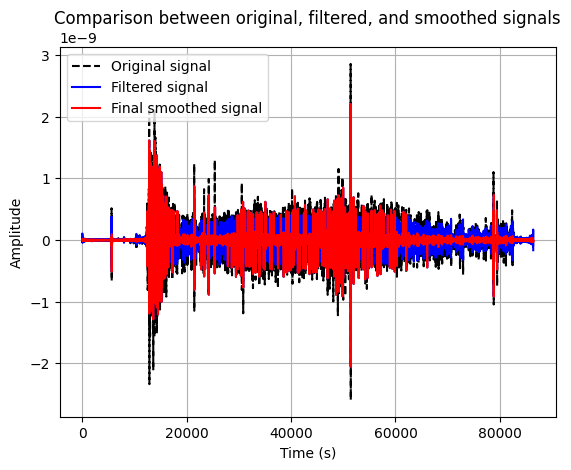

In [54]:
# Access to data lunar

bigDFmoon = []
df_names = []

data_dir = r'/content/drive/MyDrive/data/lunar/training/data'

files = os.listdir(data_dir)
for fold in files:
  print(fold)
  subf = os.listdir(os.path.join(data_dir,fold))
  for sub in subf:
    if sub.endswith('.csv'):
      print(os.path.join(data_dir,fold,sub))

      df = procesar_senal(os.path.join(data_dir,fold,sub),5,50)

      bigDFmoon.append(df)
      df_names.append(sub)


In [50]:
#Nans Delete mars

bigDFmars_aux = []
i = 0
df_names_aux = []

for df in bigDFmars:
  if df is not None:
    bigDFmars_aux.append(df)
    df_names_aux.append(df_names[i])
  i += 1

bigDFmars = bigDFmars_aux
df_names = df_names_aux


In [55]:
#Nans Delete moon

bigDFmoon_aux = []
i = 0
df_names_aux = []
for df in bigDFmoon:
  if df is not None:
    bigDFmoon_aux.append(df)
    df_names_aux.append(df_names[i])
  i += 1

bigDFmoon = bigDFmoon_aux
df_names = df_names_aux

Total signal energy: 5.815163059319707e-16


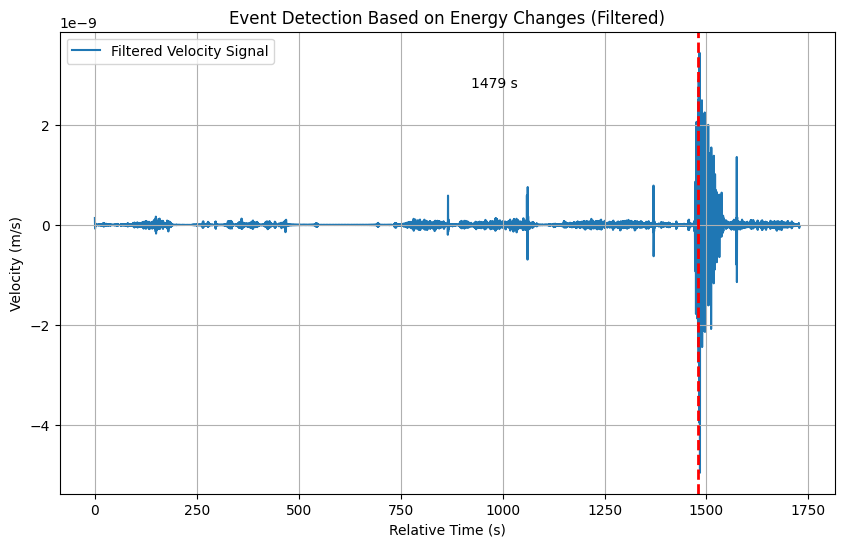

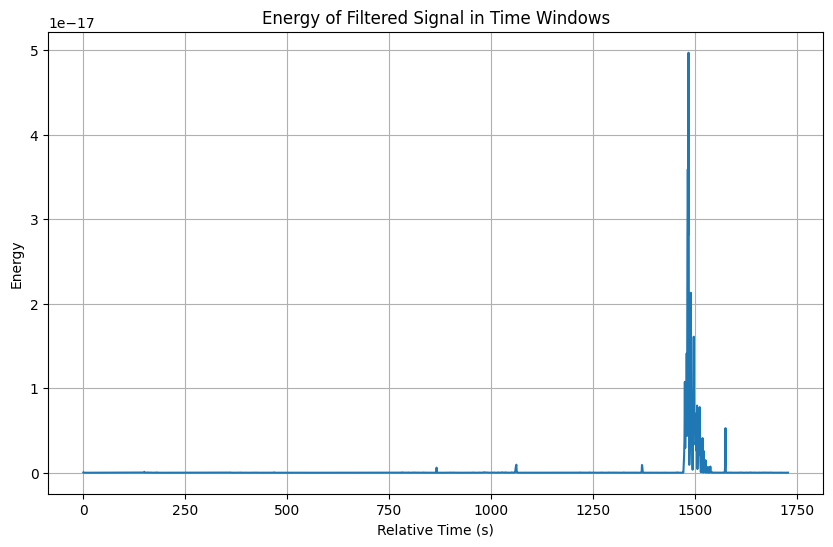

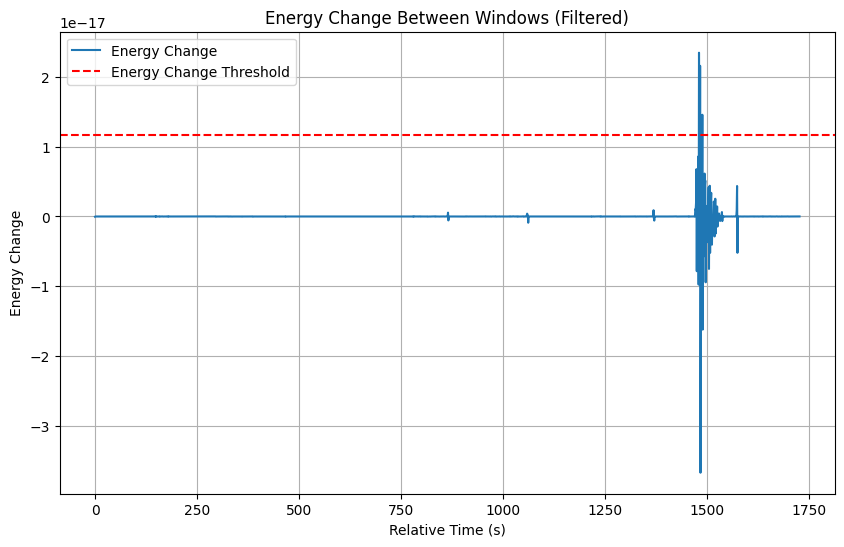

Total signal energy: 5.097252640681366e-16


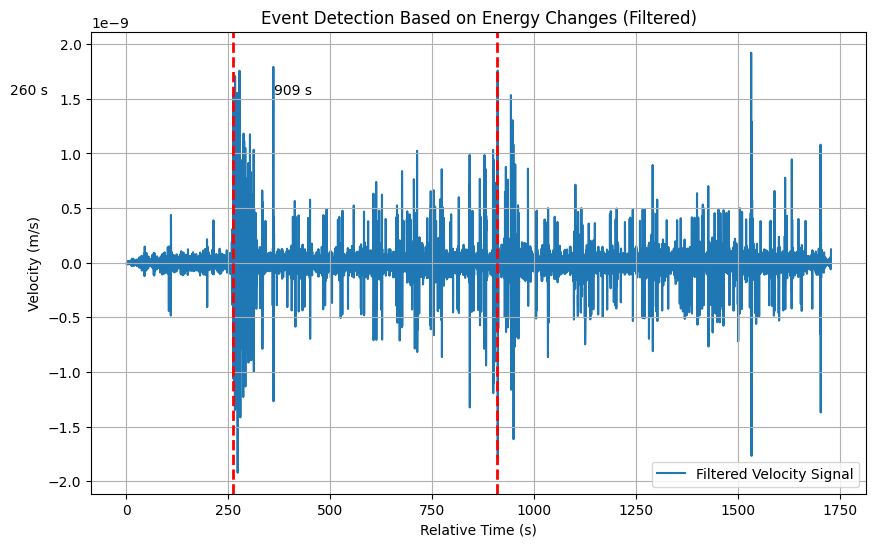

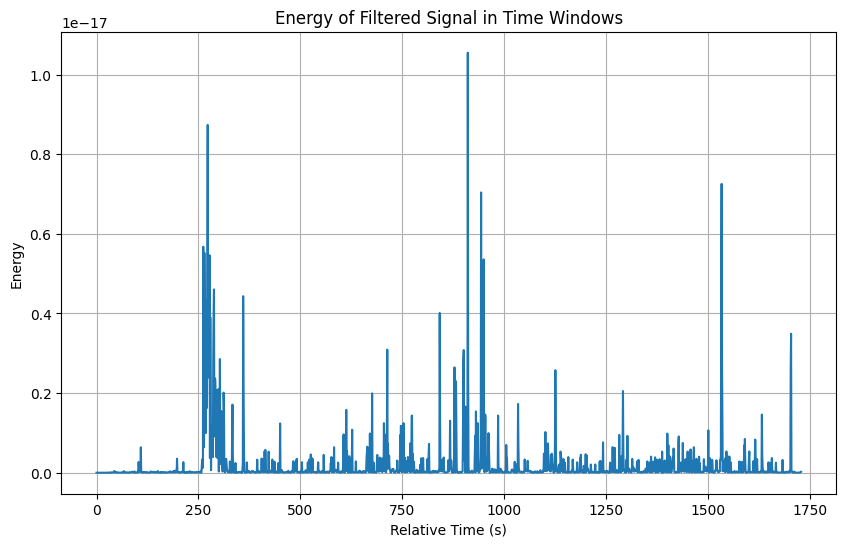

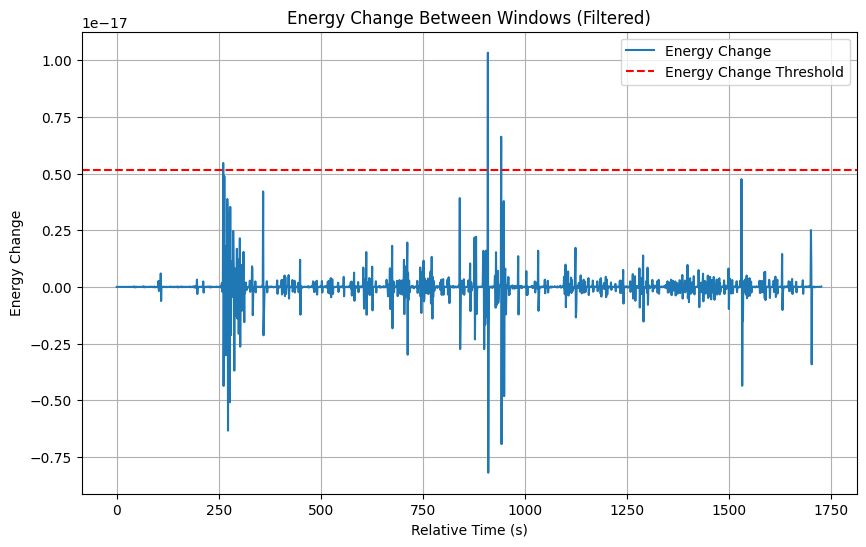

Total signal energy: 4.2192950988022387e-16


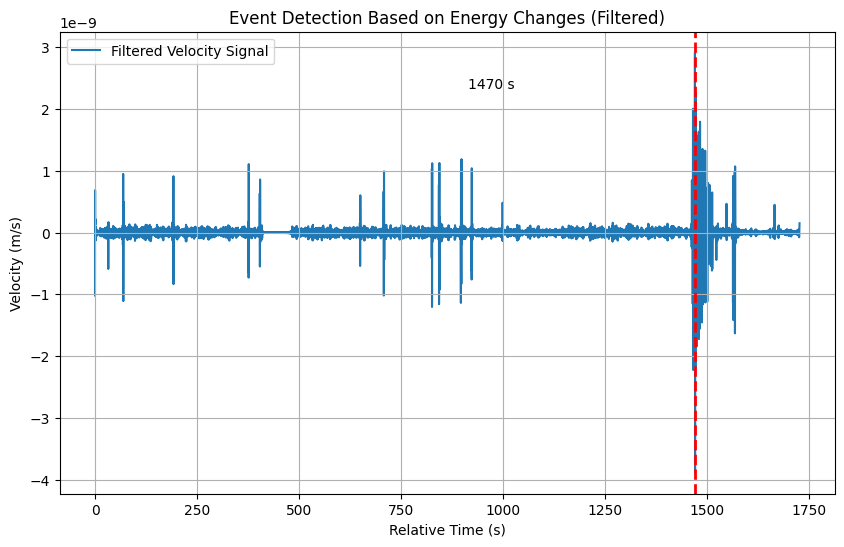

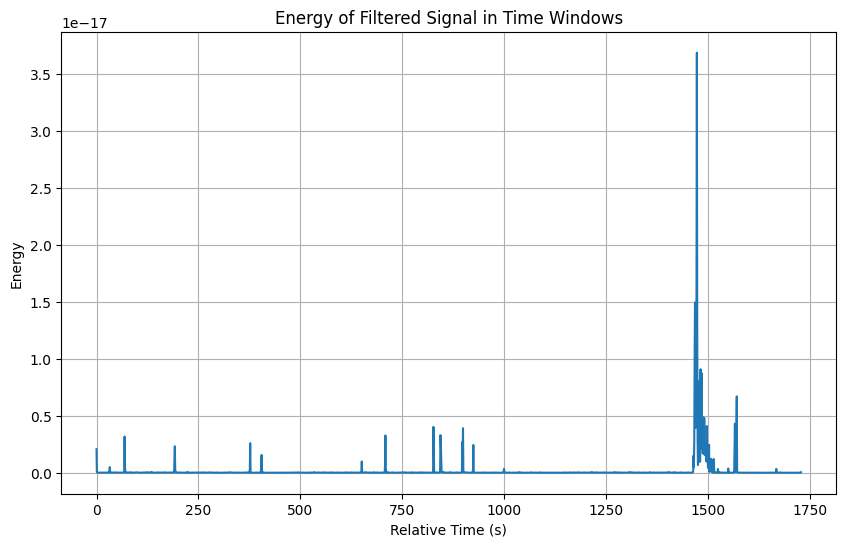

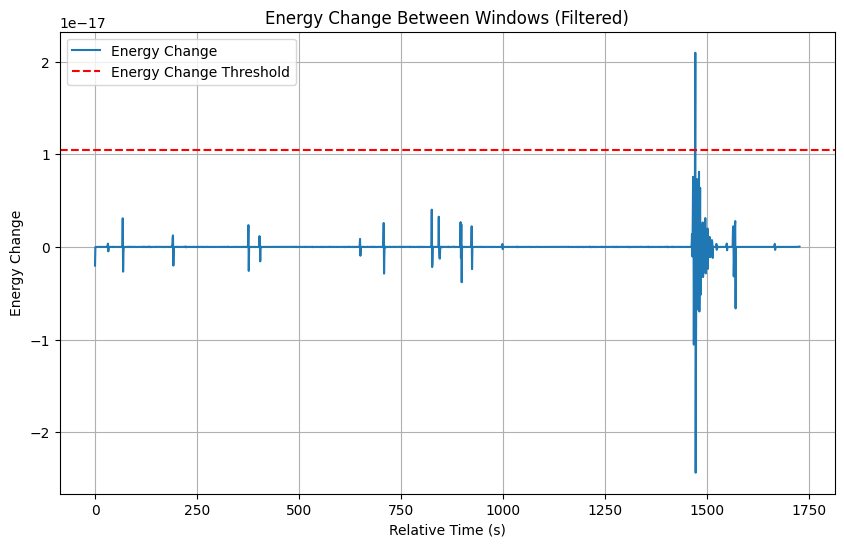

Total signal energy: 2.3818491443664496e-15


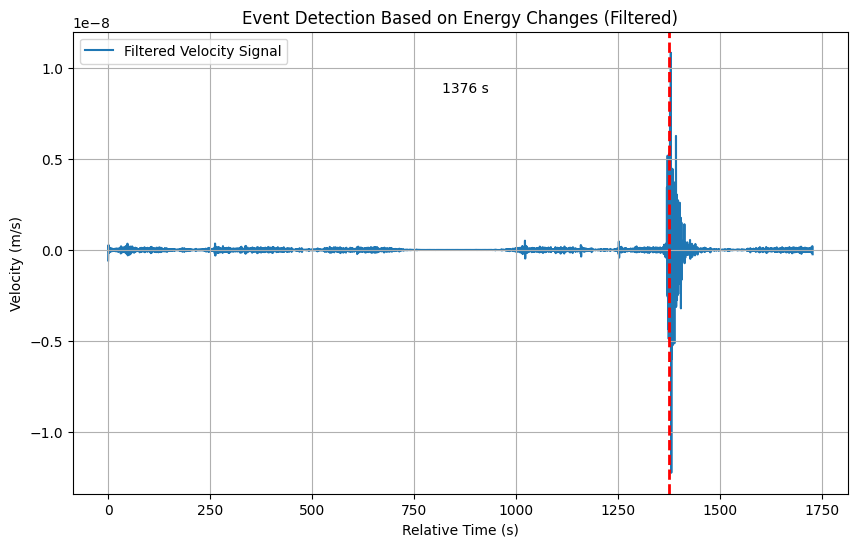

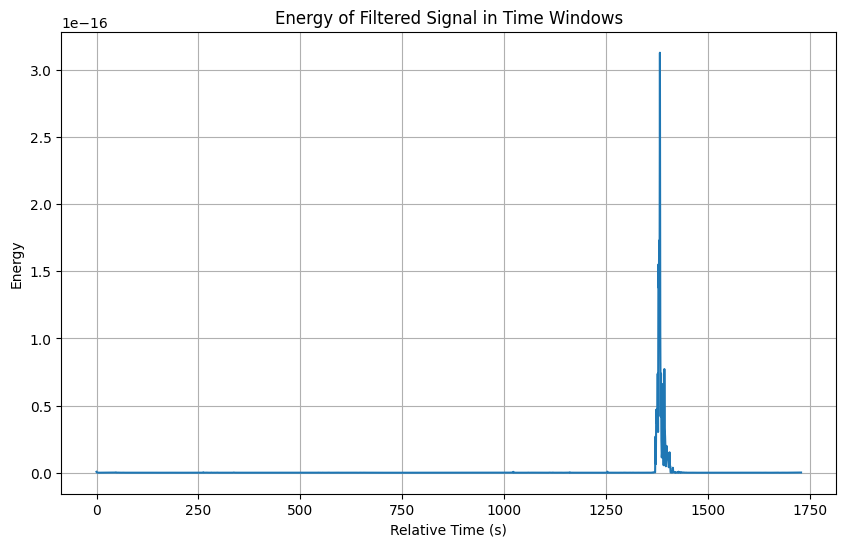

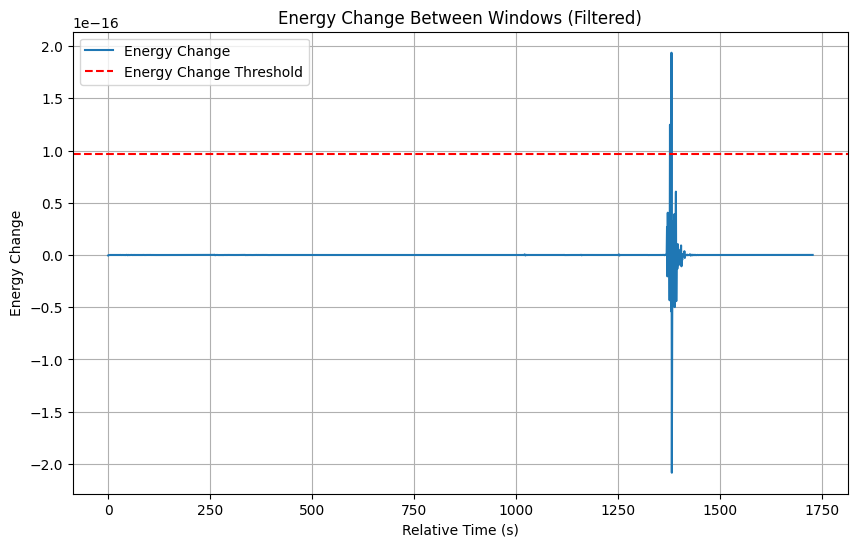

Total signal energy: 2.7026230526283747e-16


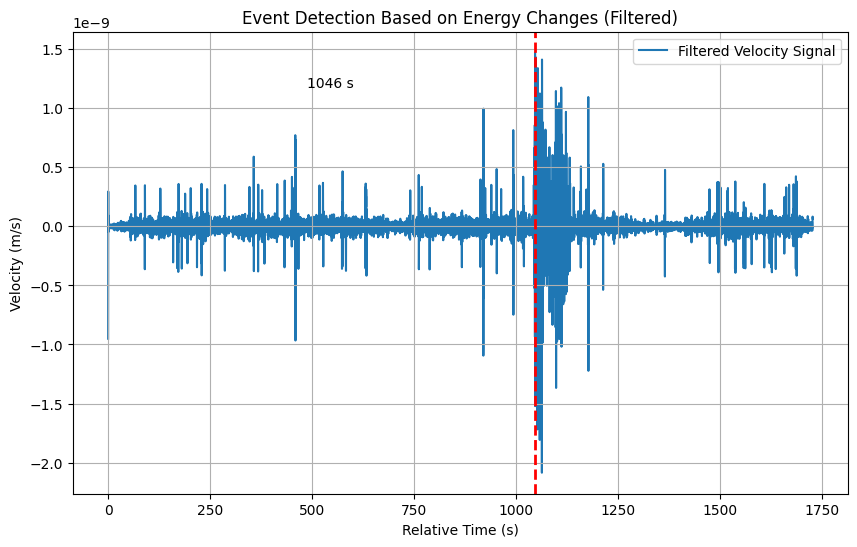

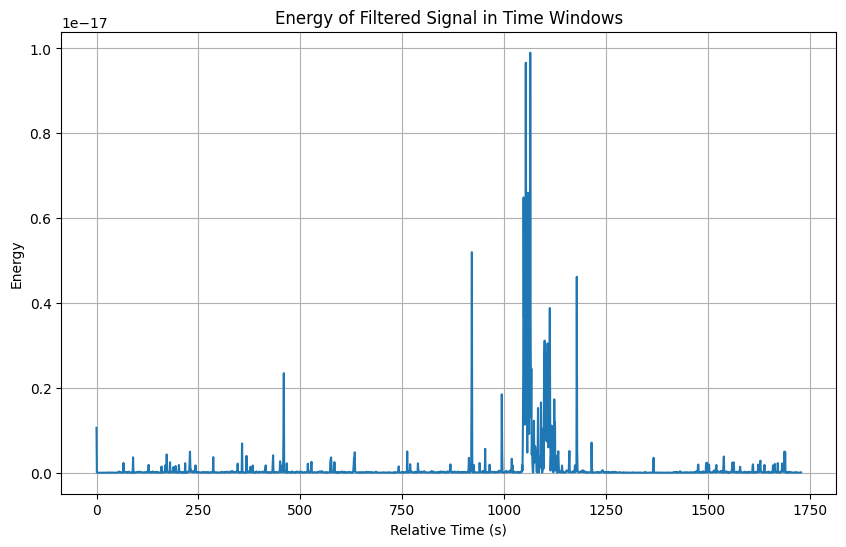

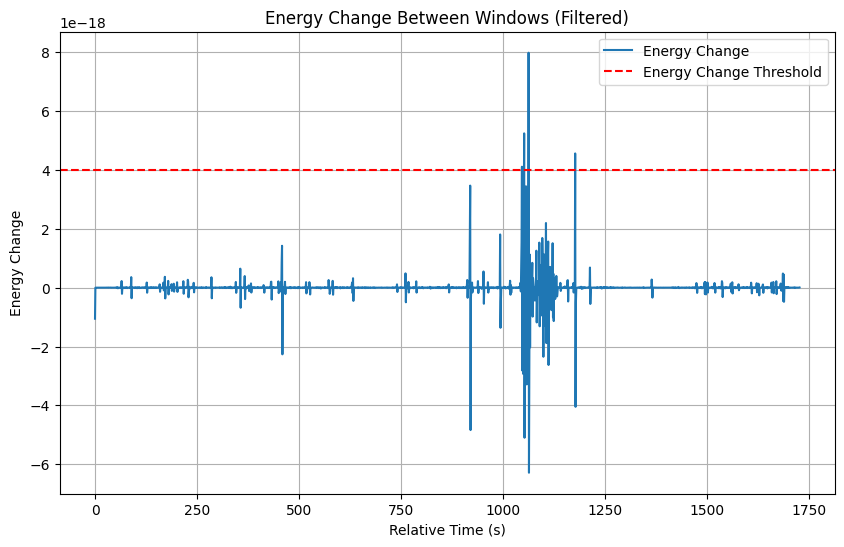

Total signal energy: 4.82617812196688e-16


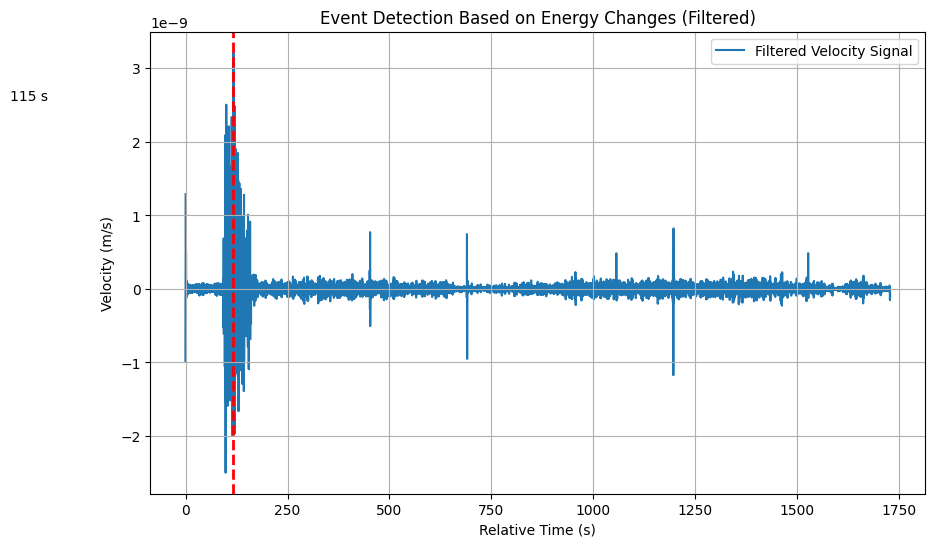

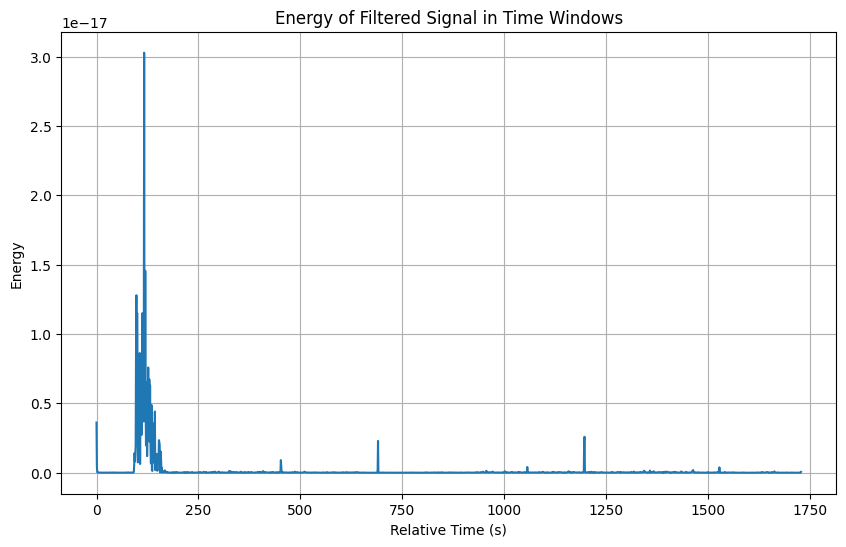

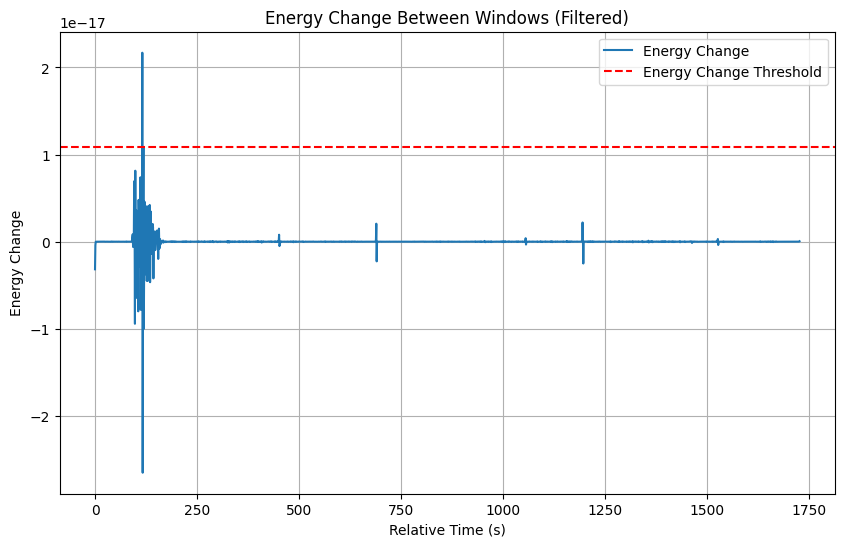

Total signal energy: 2.709602695217796e-15


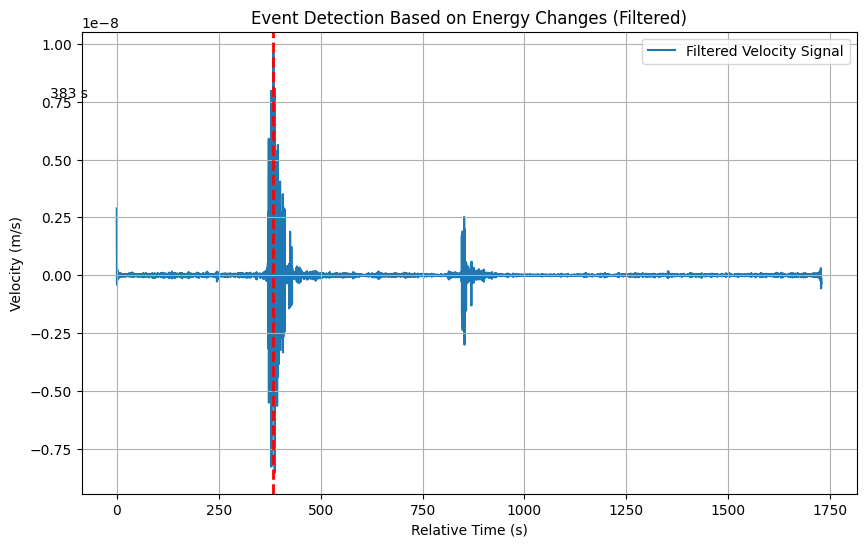

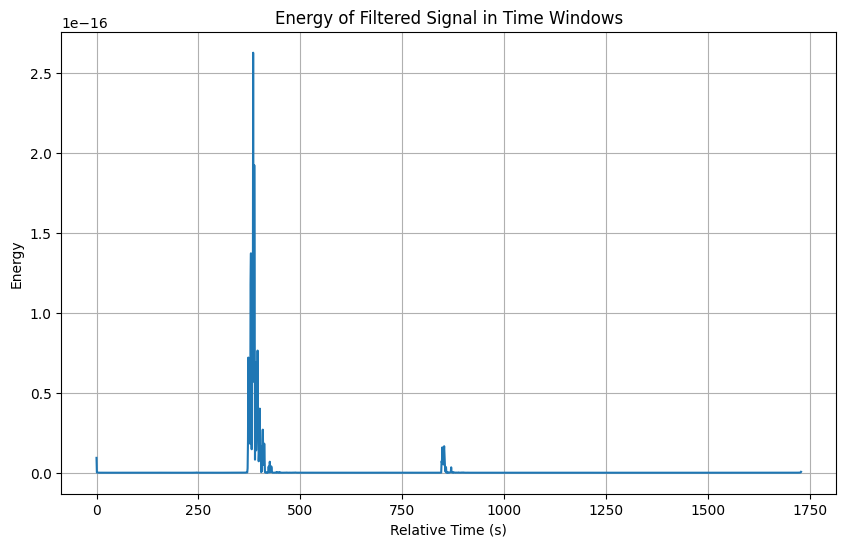

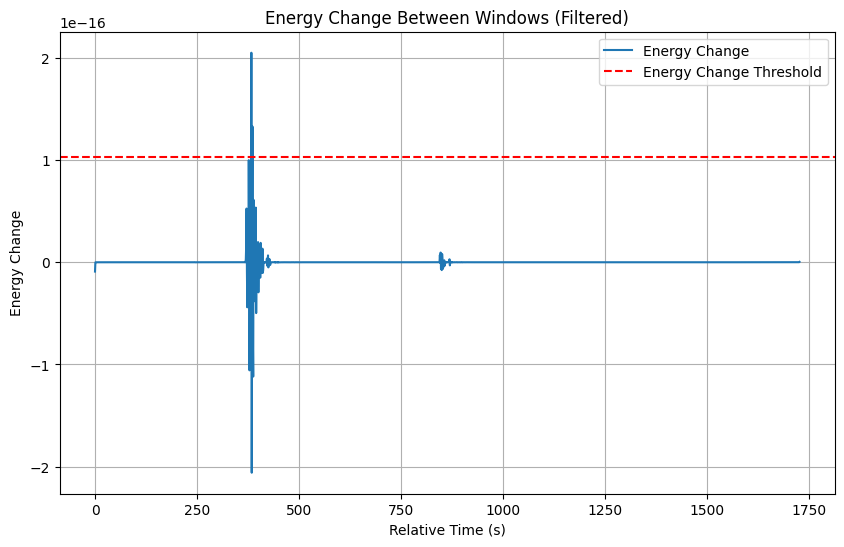

Total signal energy: 1.4923080072863717e-14


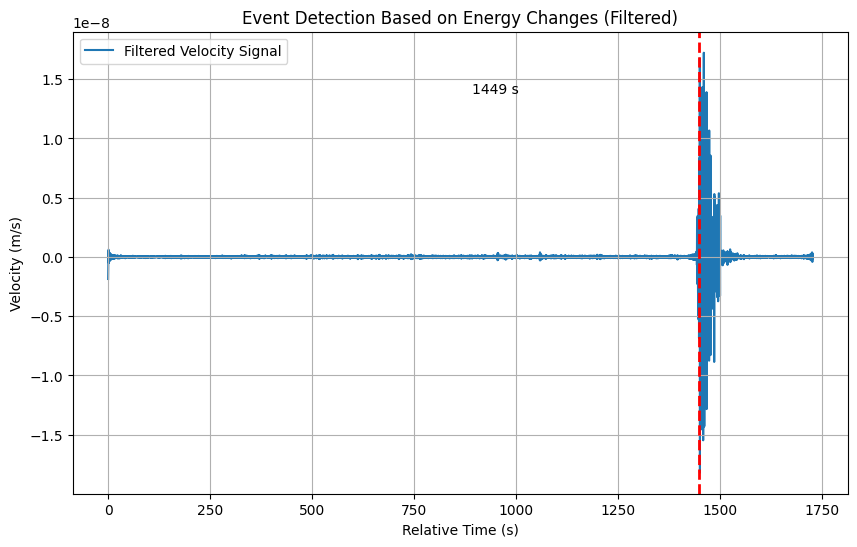

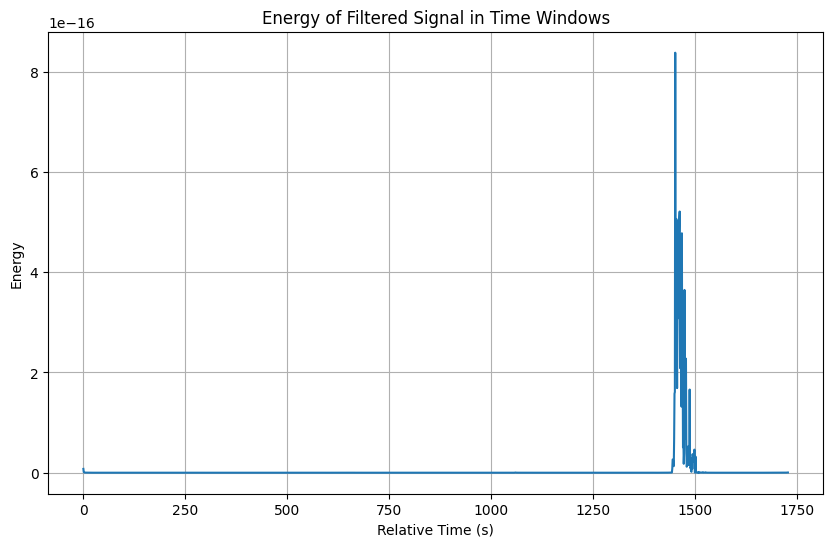

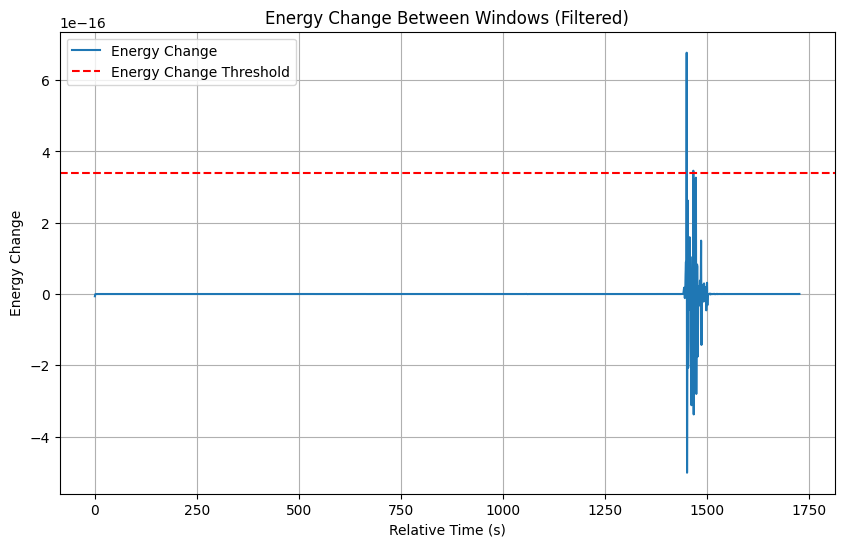

Total signal energy: 2.297557066601654e-16


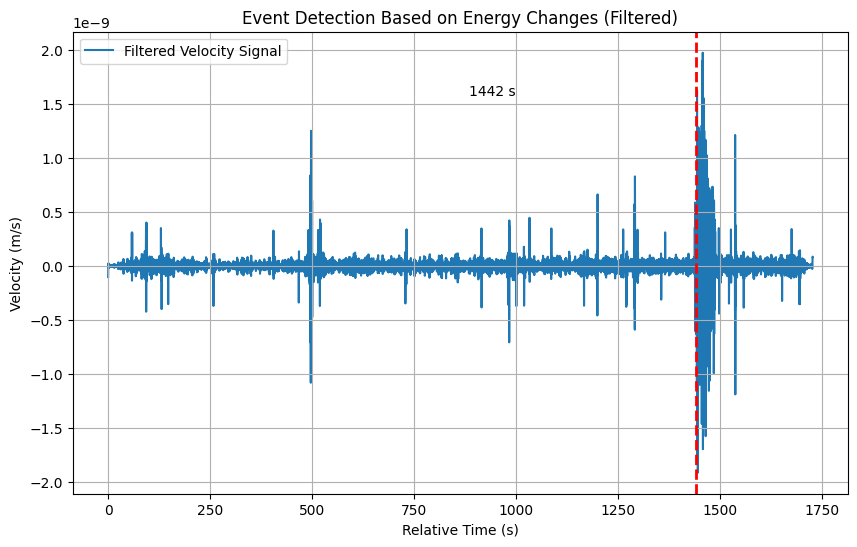

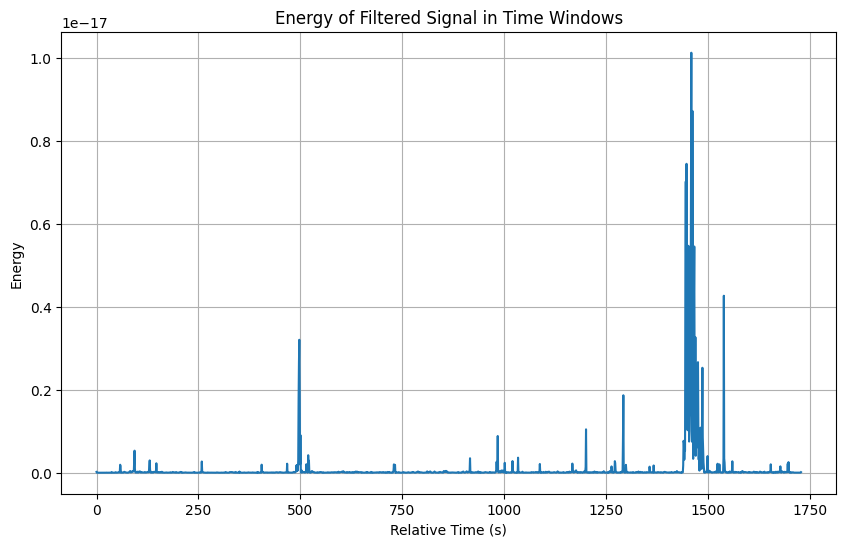

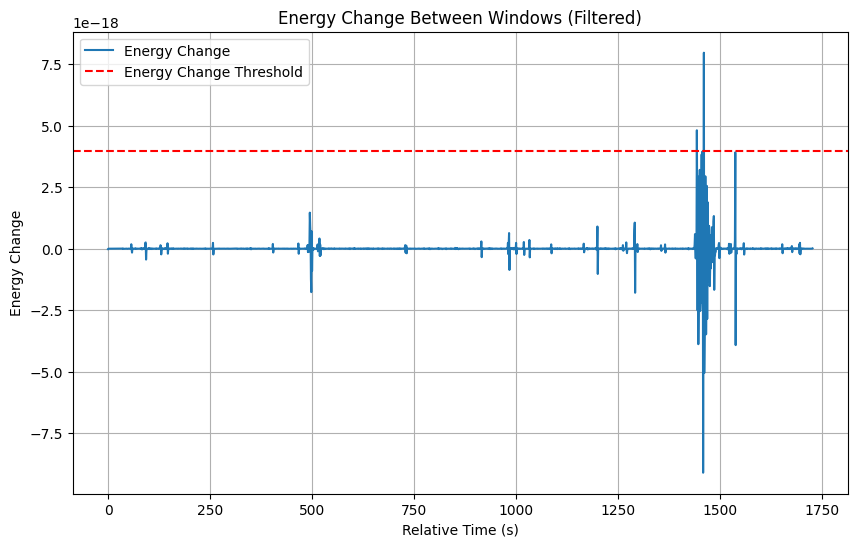

Total signal energy: 2.709602695217796e-15


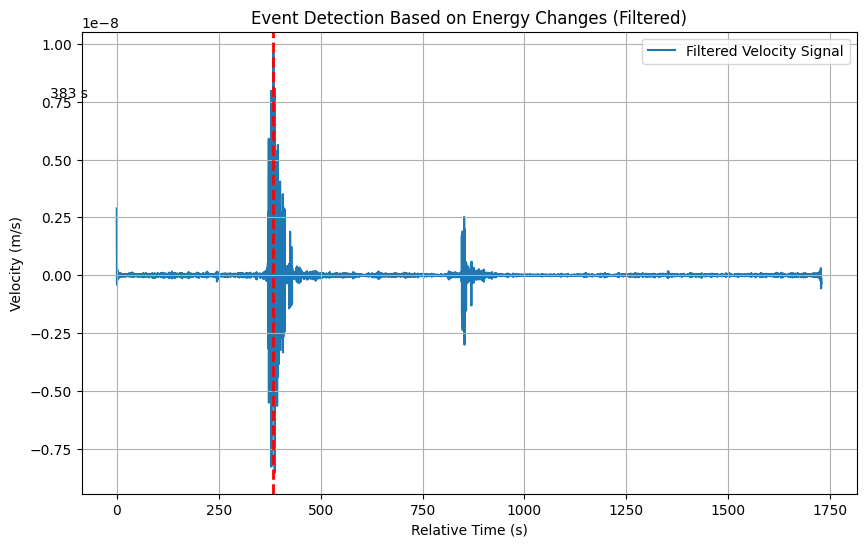

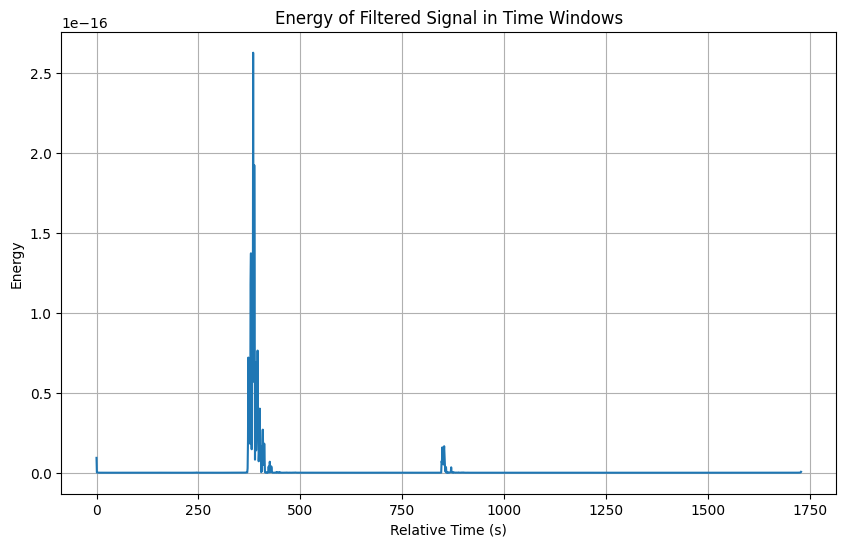

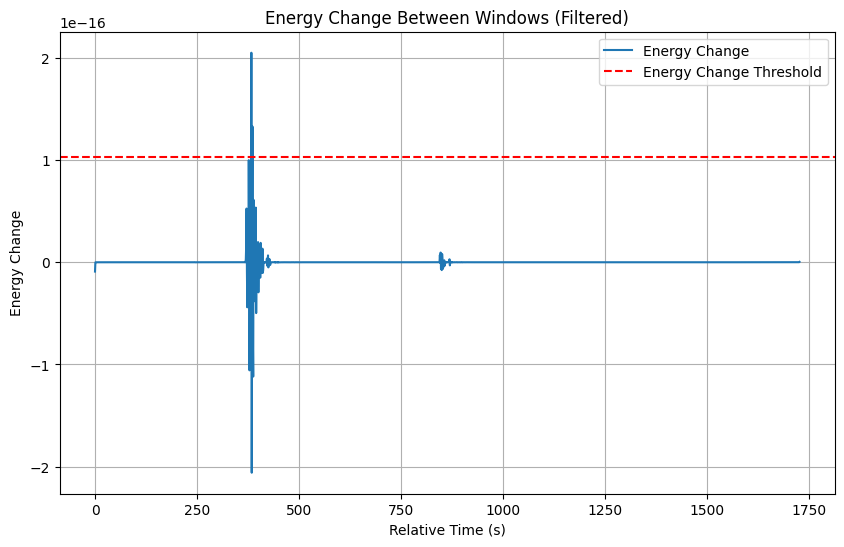

Total signal energy: 6.910253133928523e-16


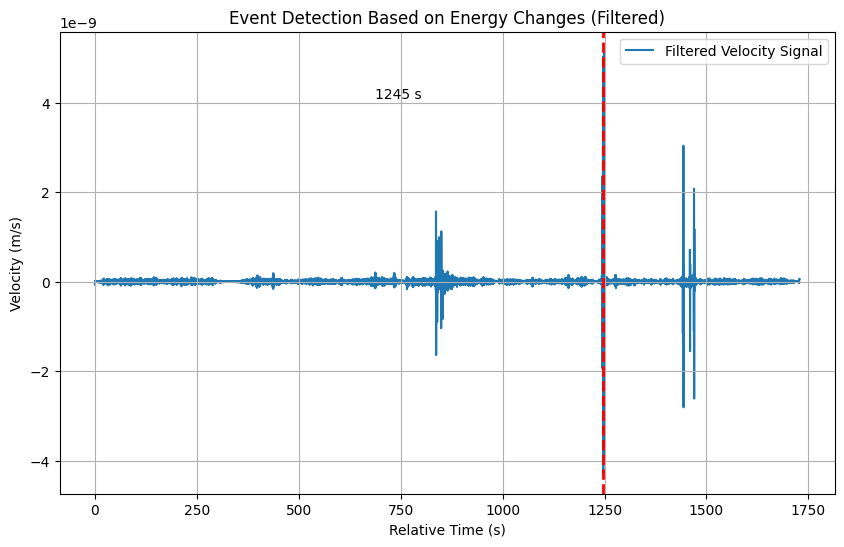

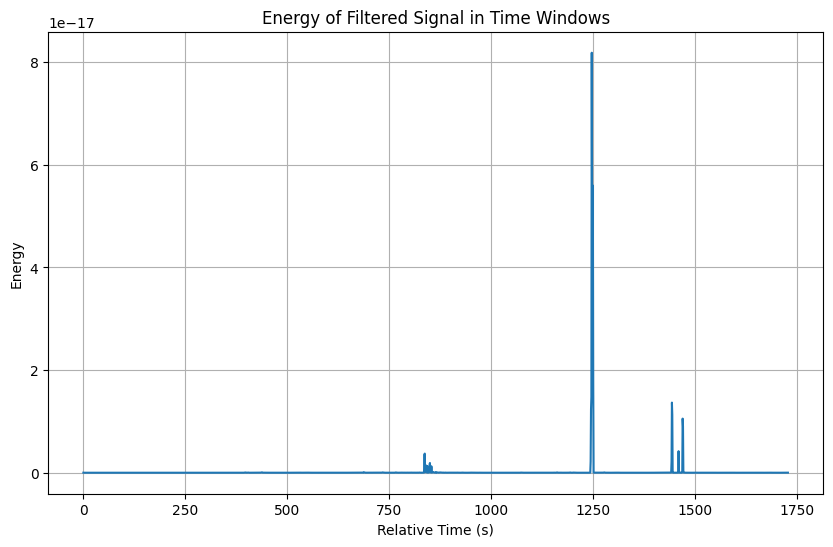

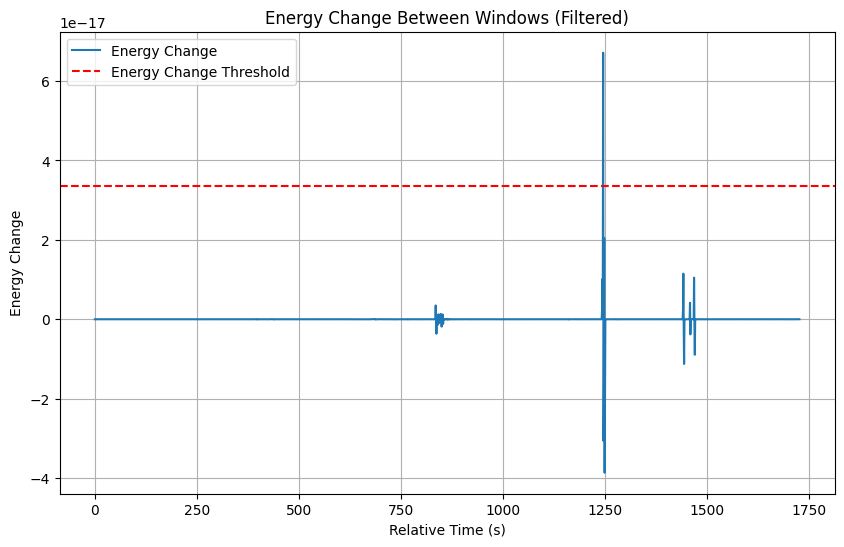

Total signal energy: 4.016344026307839e-16


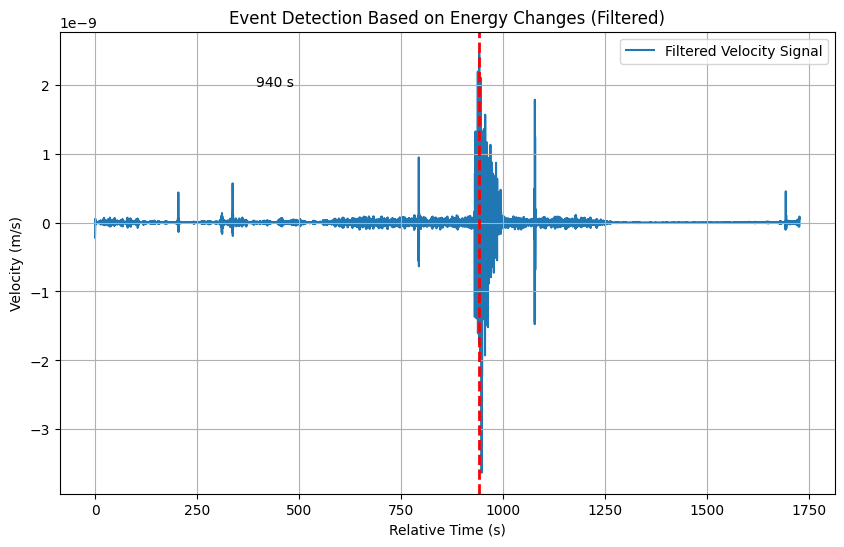

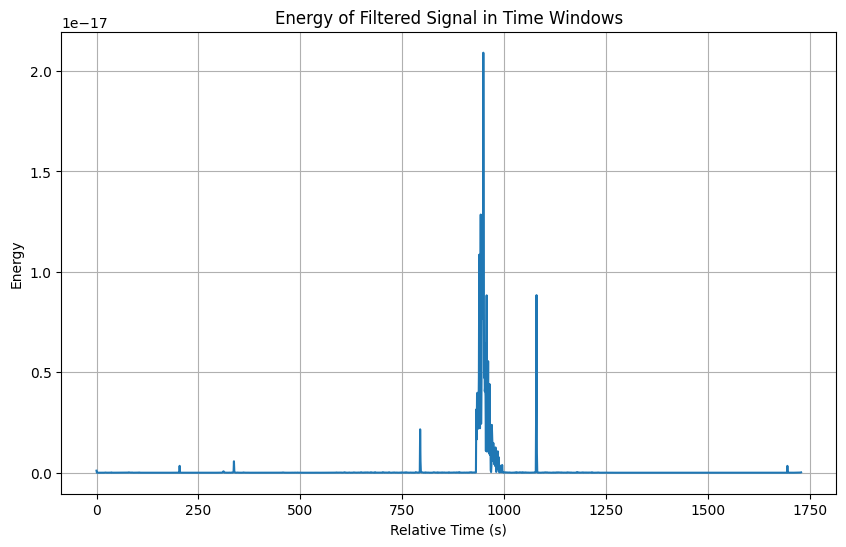

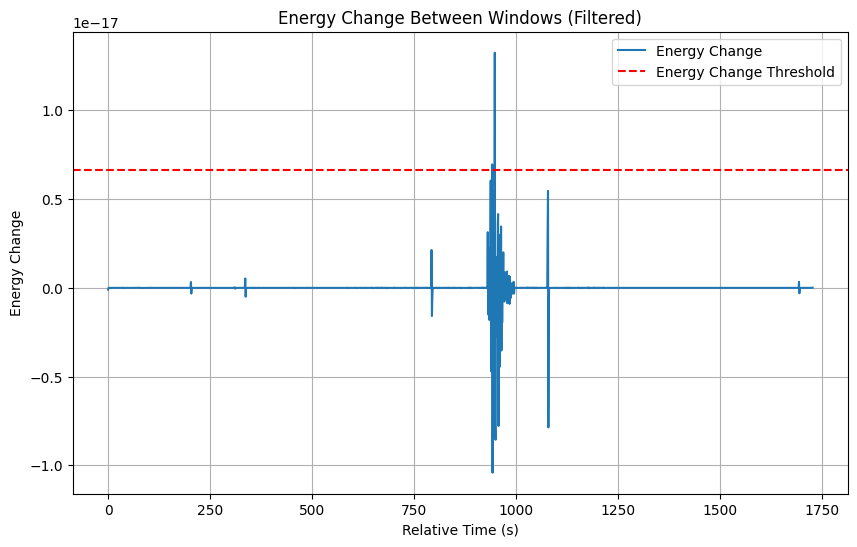

Total signal energy: 2.50720002328219e-16


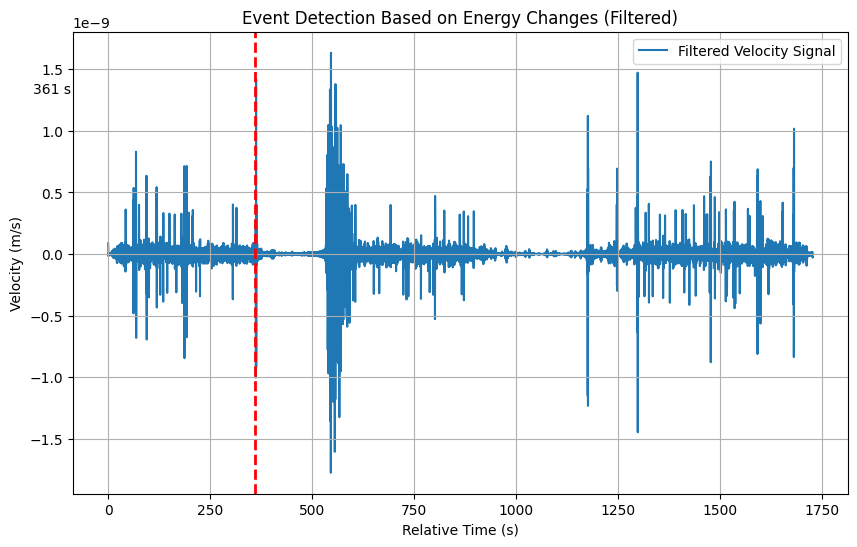

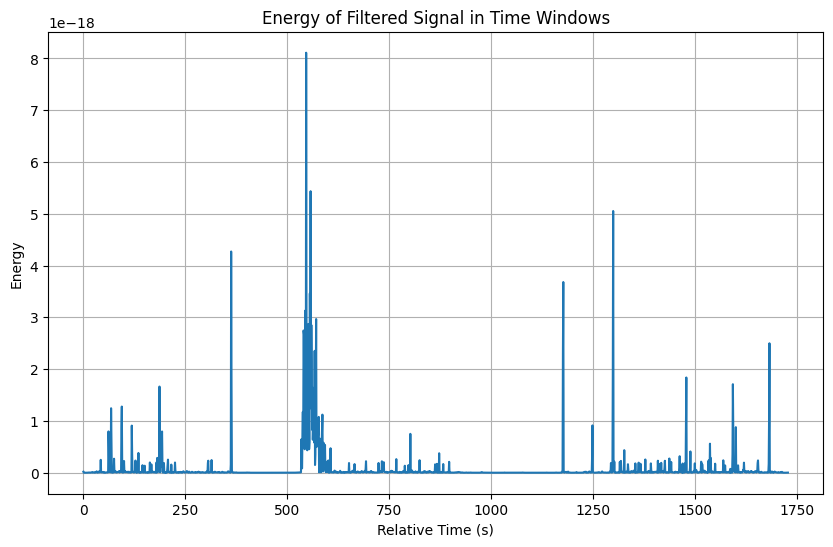

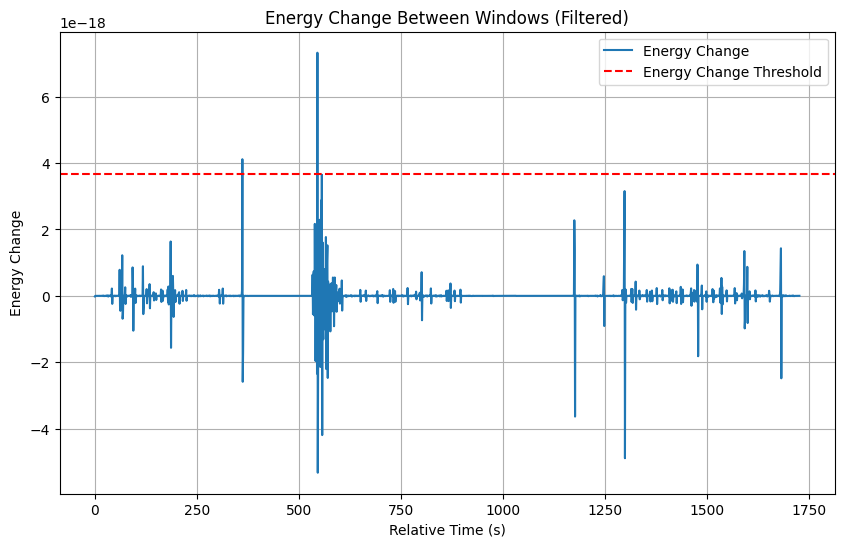

Total signal energy: 3.4083706186710313e-16


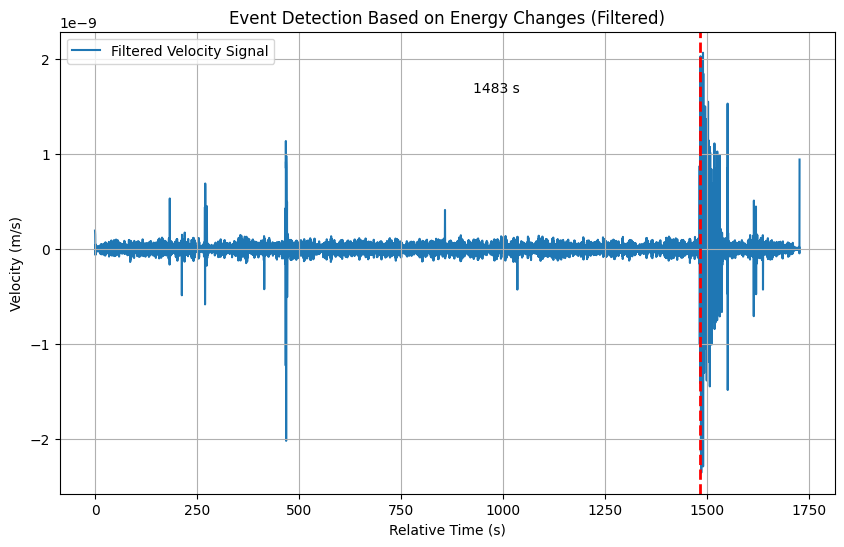

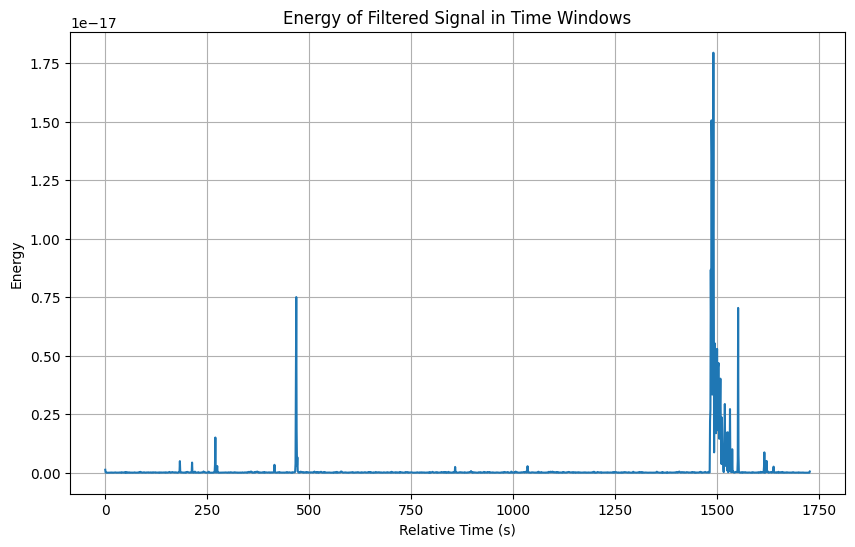

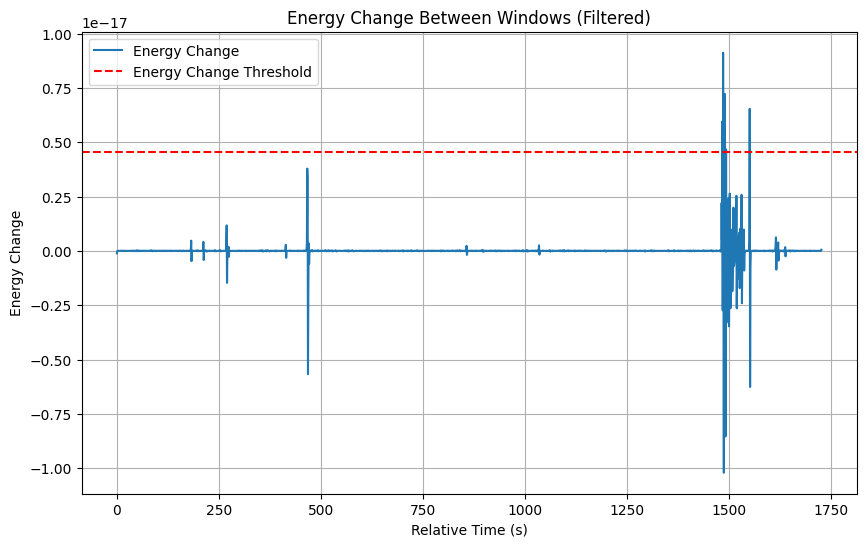

Total signal energy: 4.613995248391029e-16


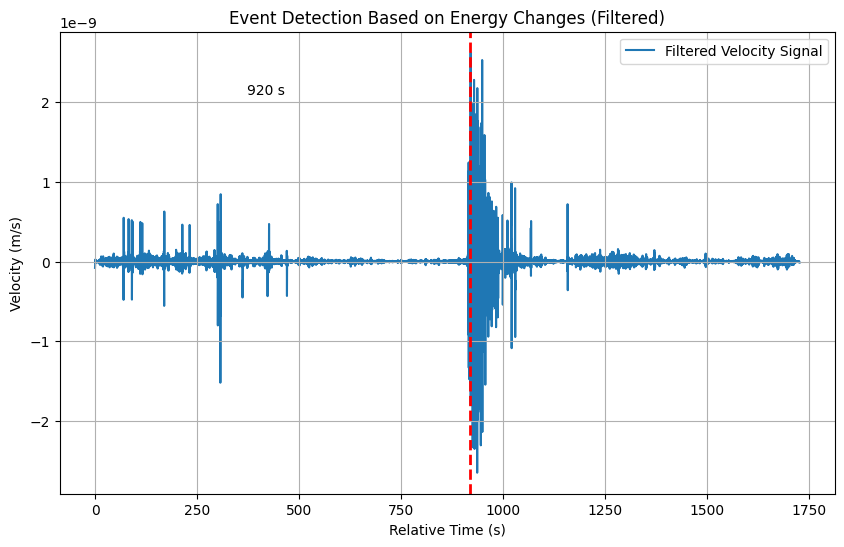

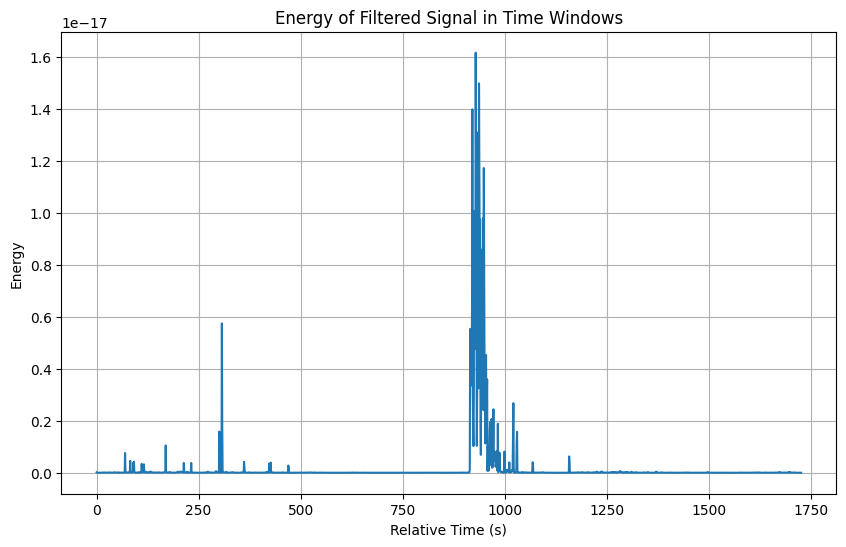

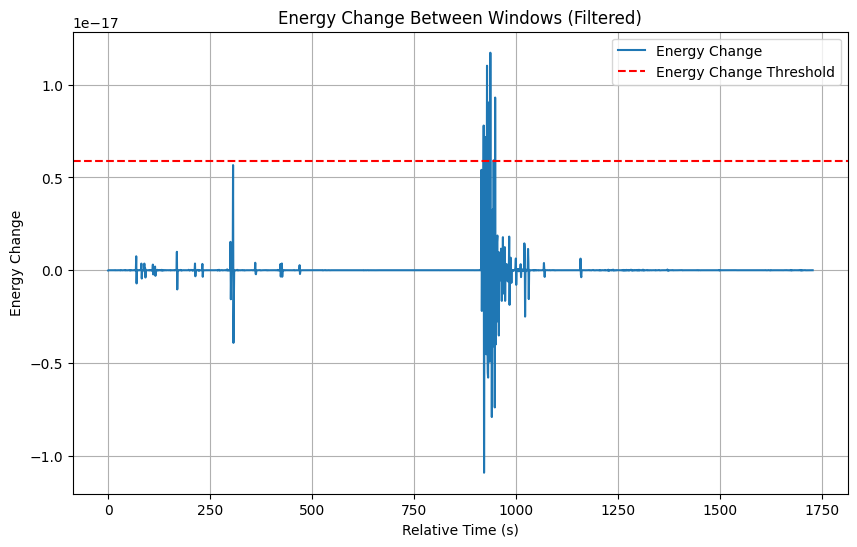

Total signal energy: 4.453128938595992e-16


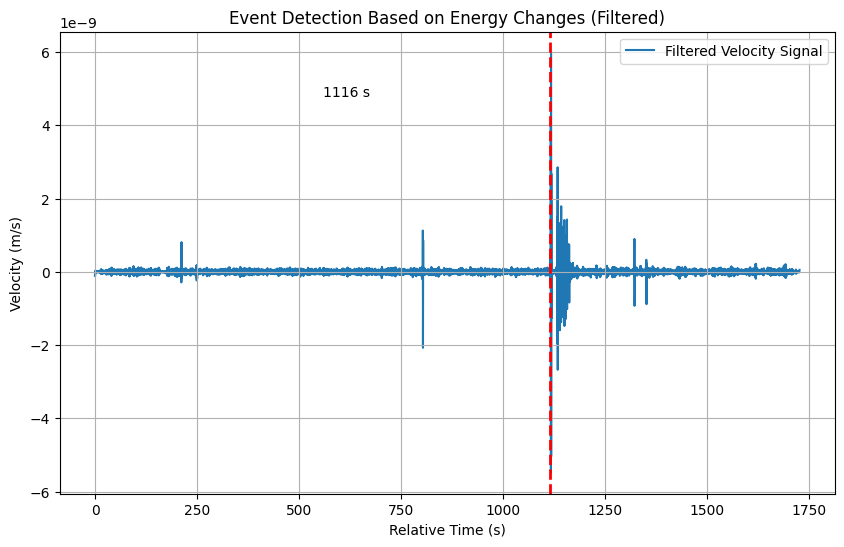

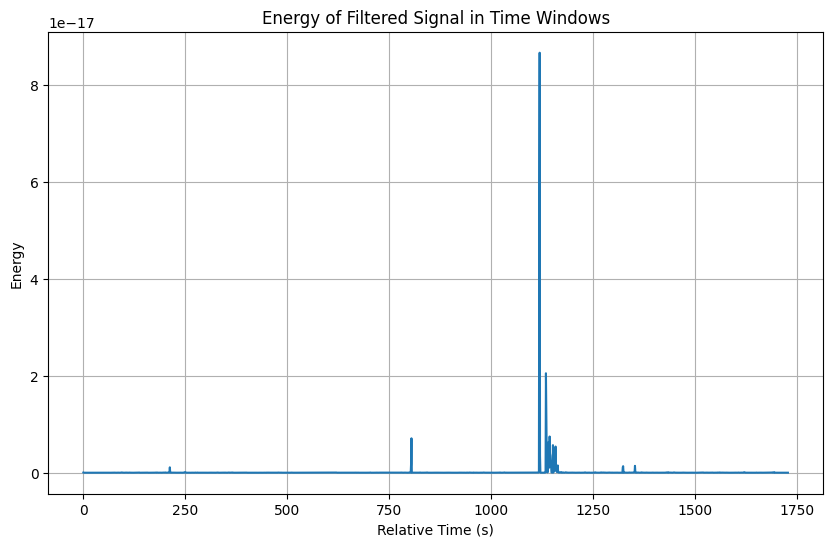

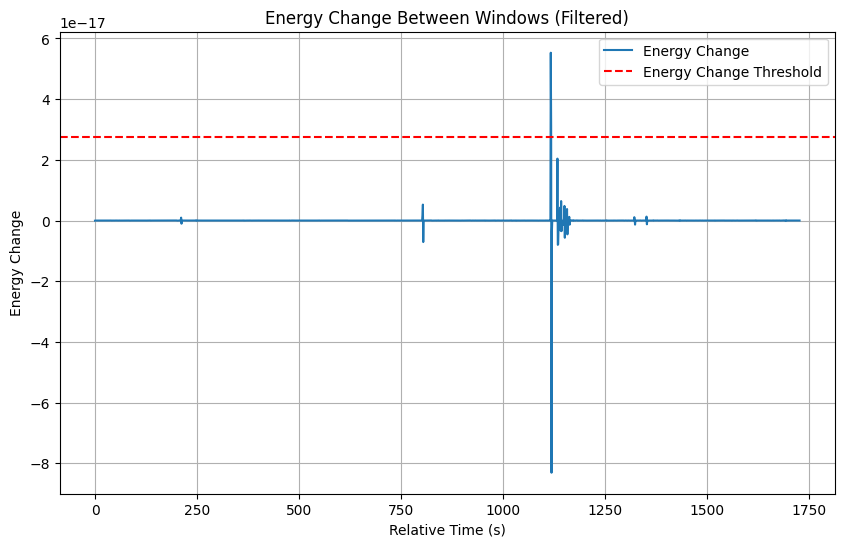

Total signal energy: 3.601805994806489e-16


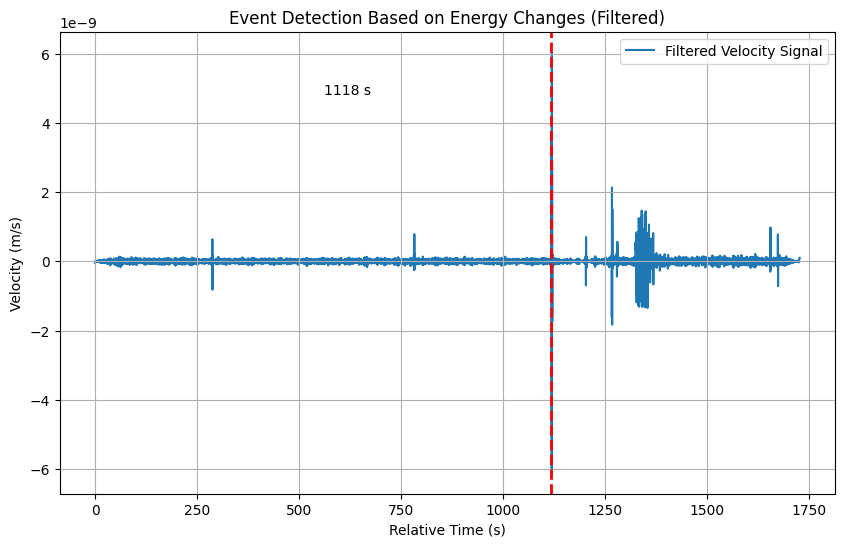

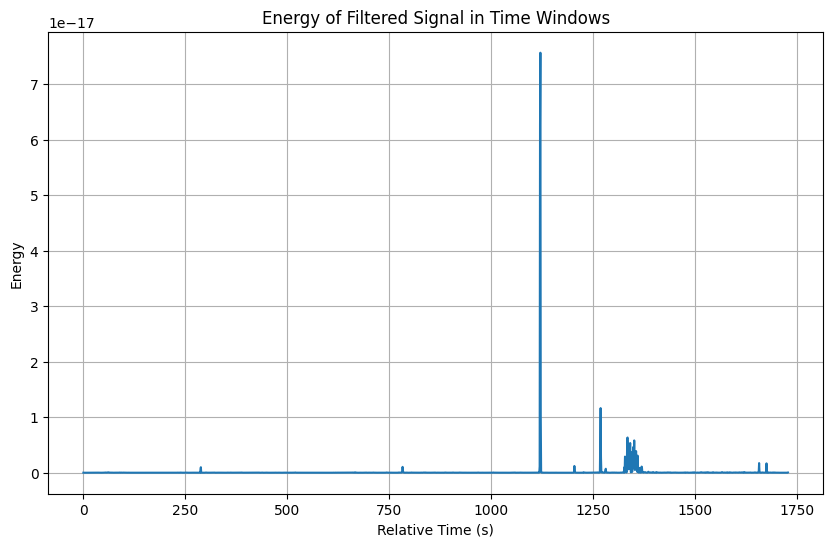

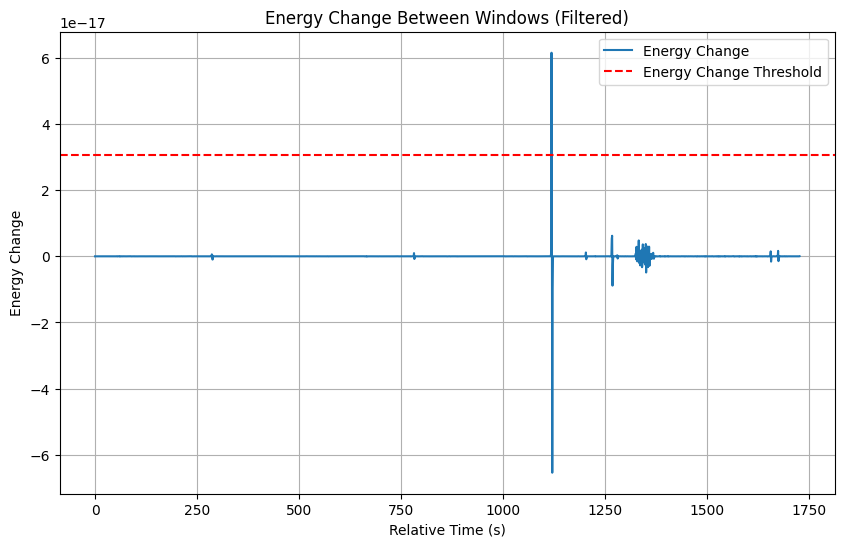

Total signal energy: 1.352811813522505e-15


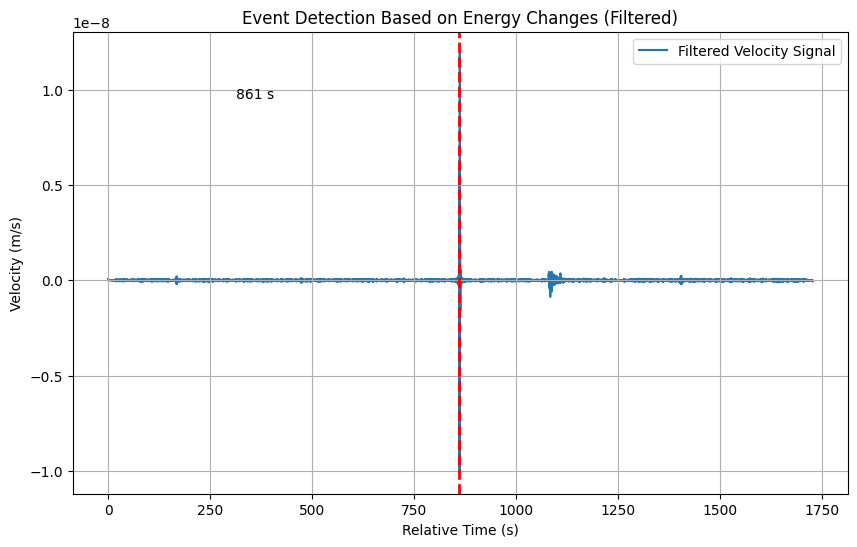

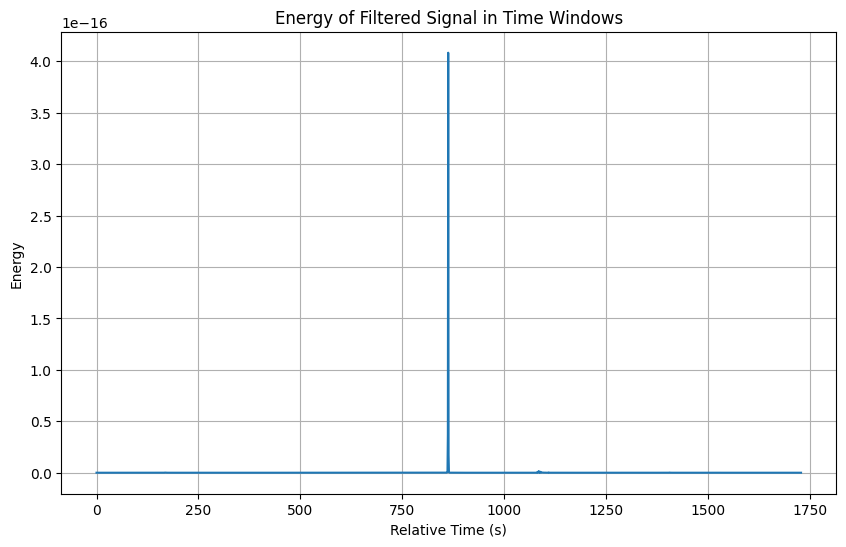

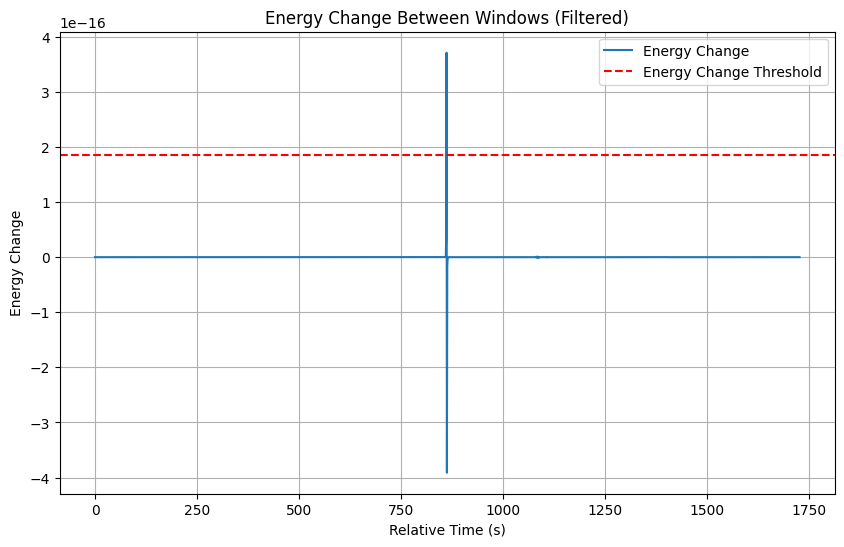

Total signal energy: 4.361631633775849e-15


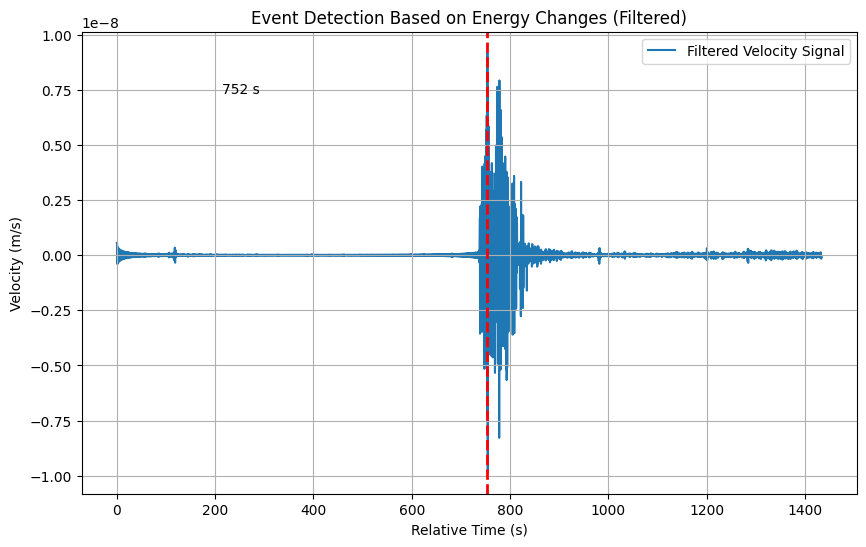

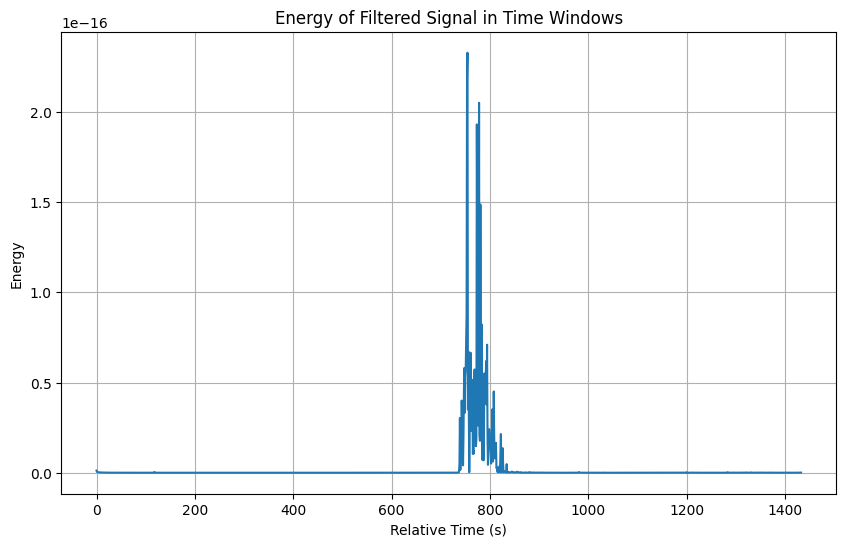

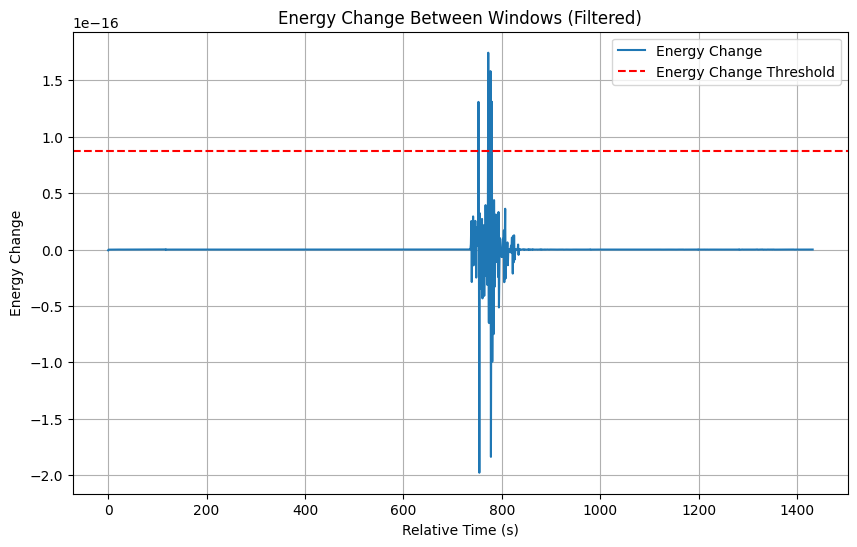

Total signal energy: 2.4768078331493337e-16


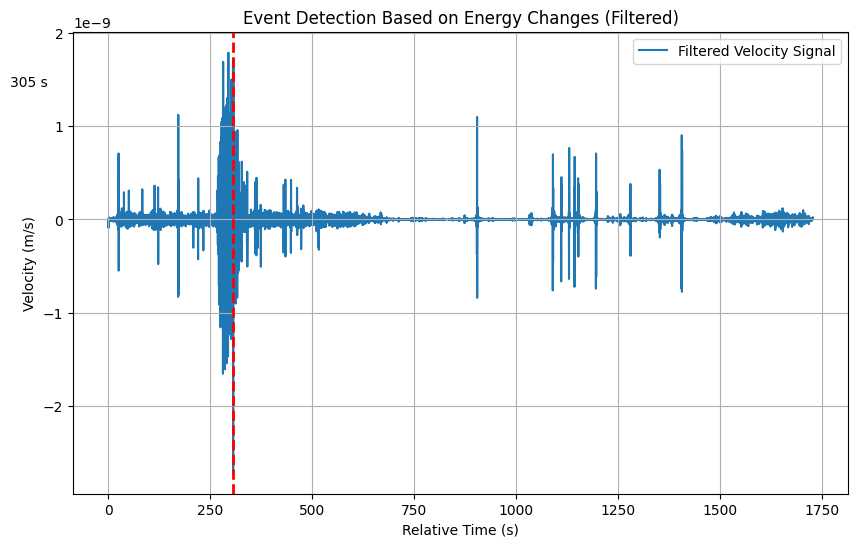

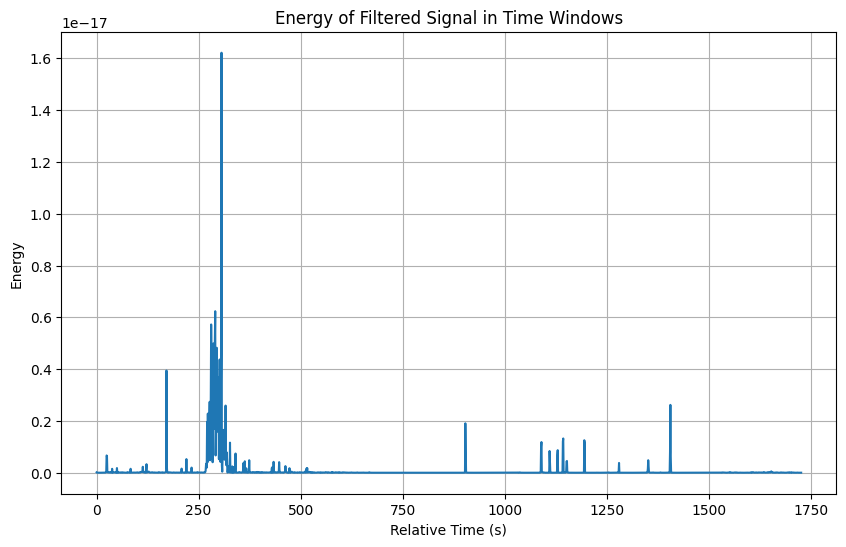

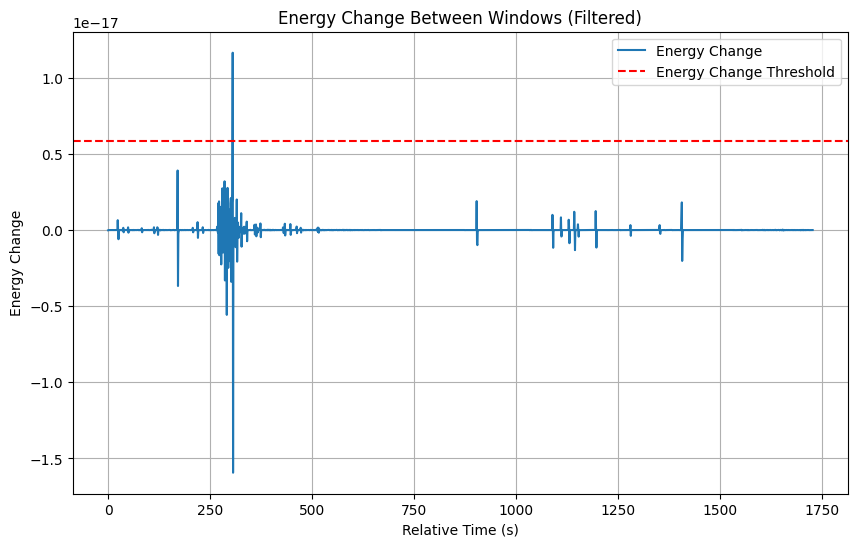

Total signal energy: 2.558557900511252e-16


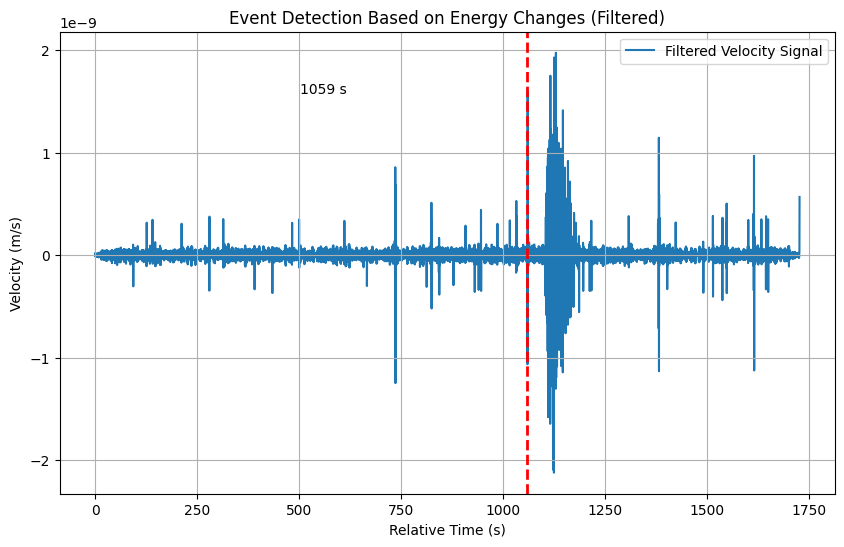

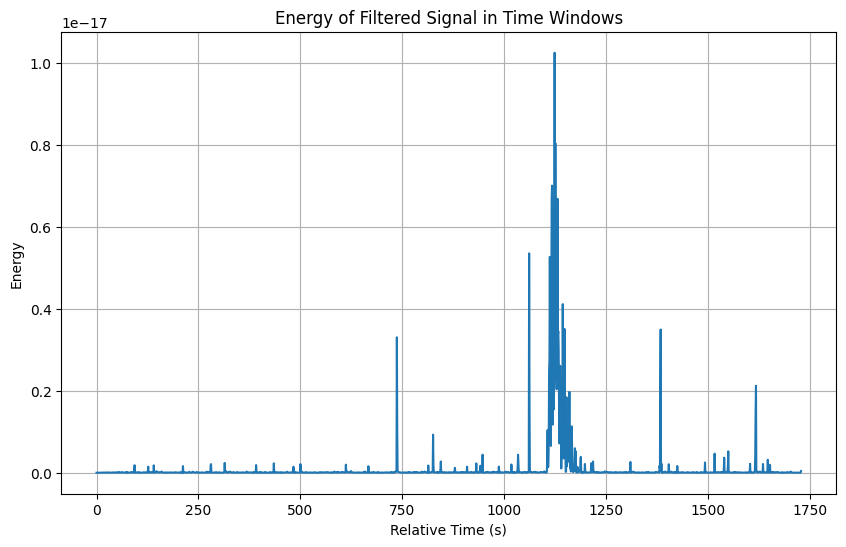

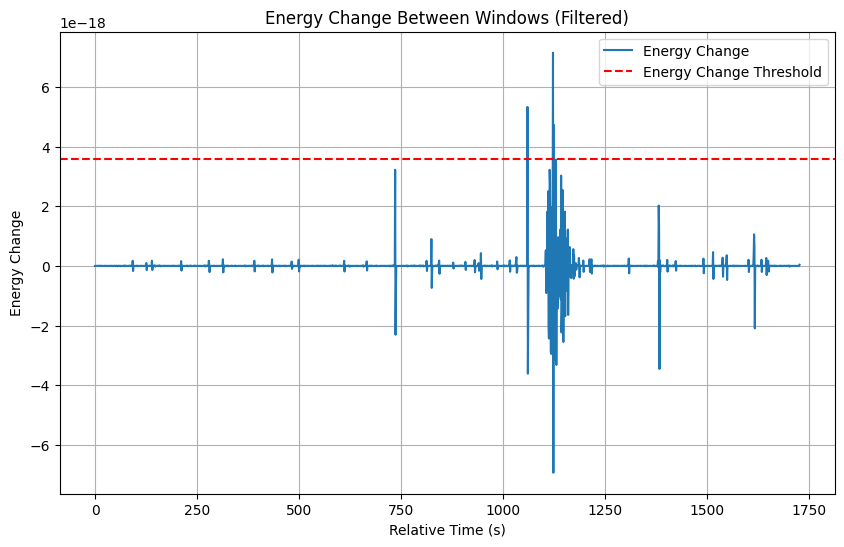

Total signal energy: 4.323562152054928e-15


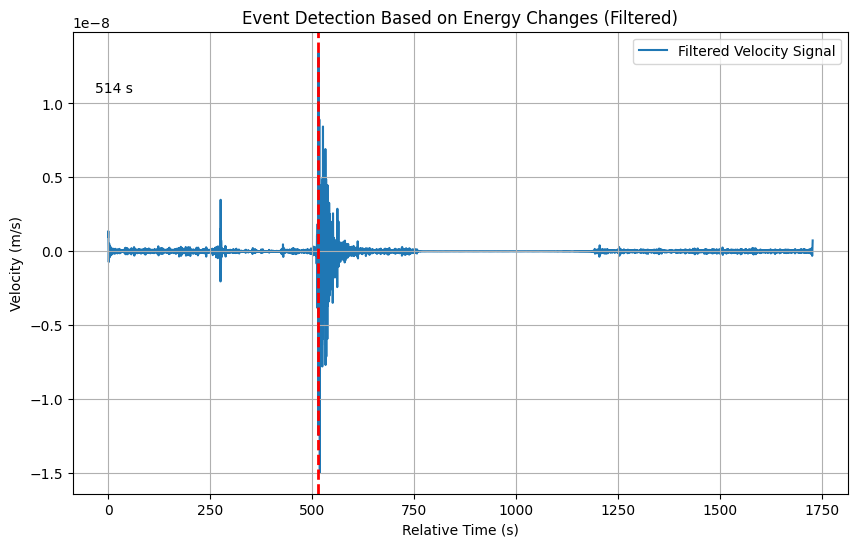

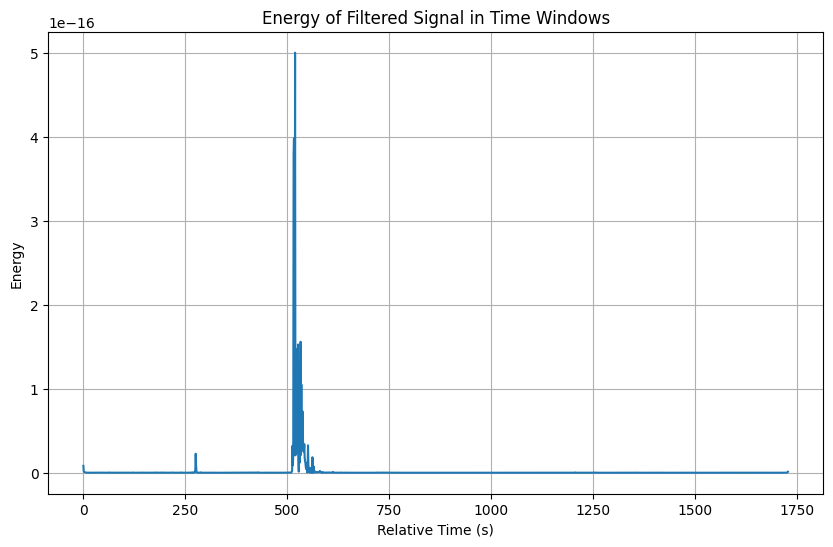

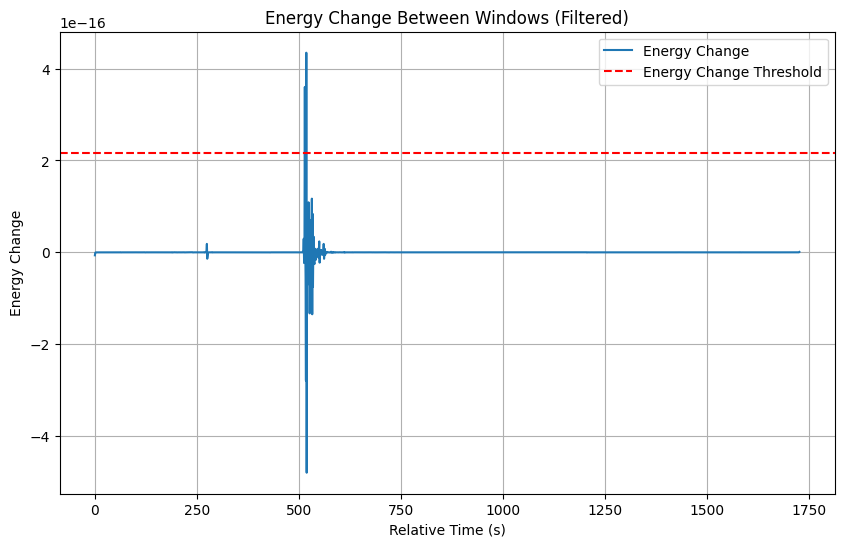

Total signal energy: 1.1672612780936166e-15


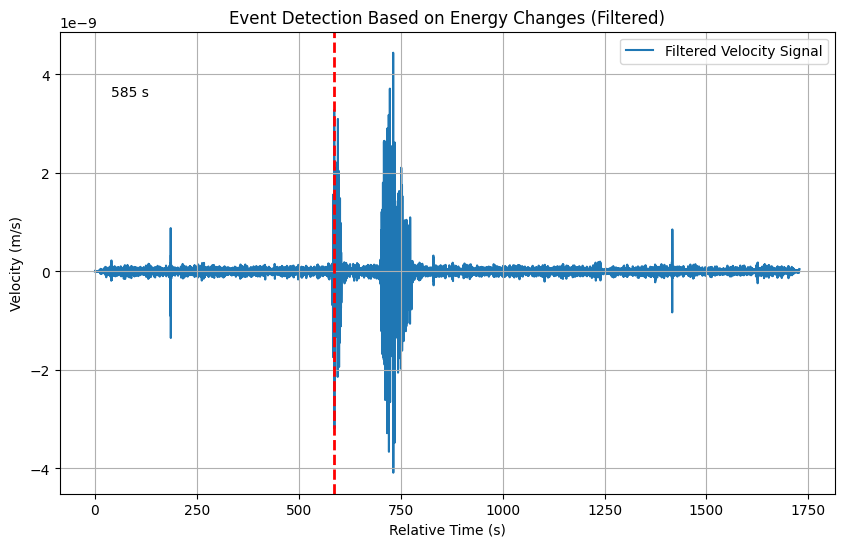

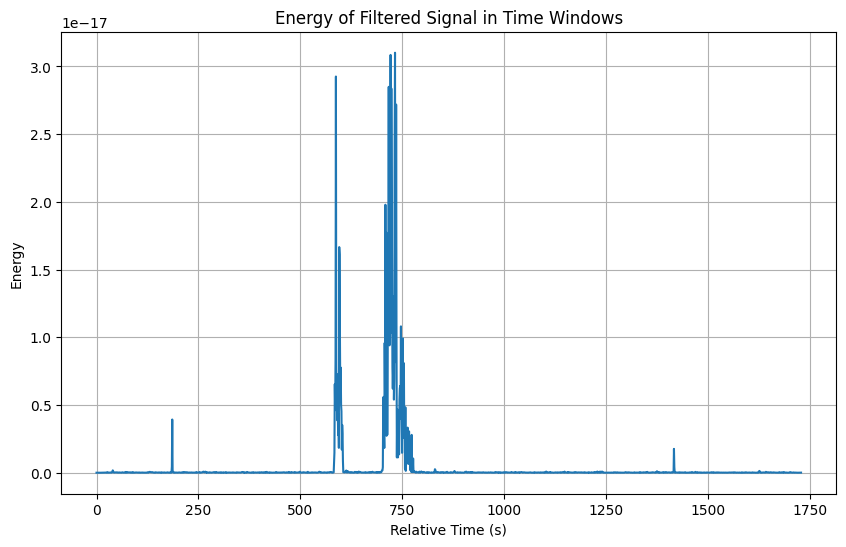

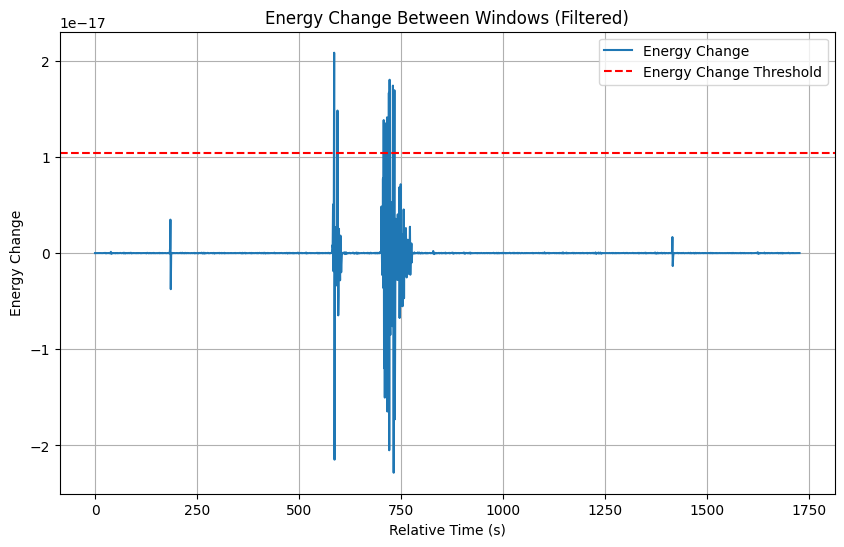

Total signal energy: 1.1672612780936166e-15


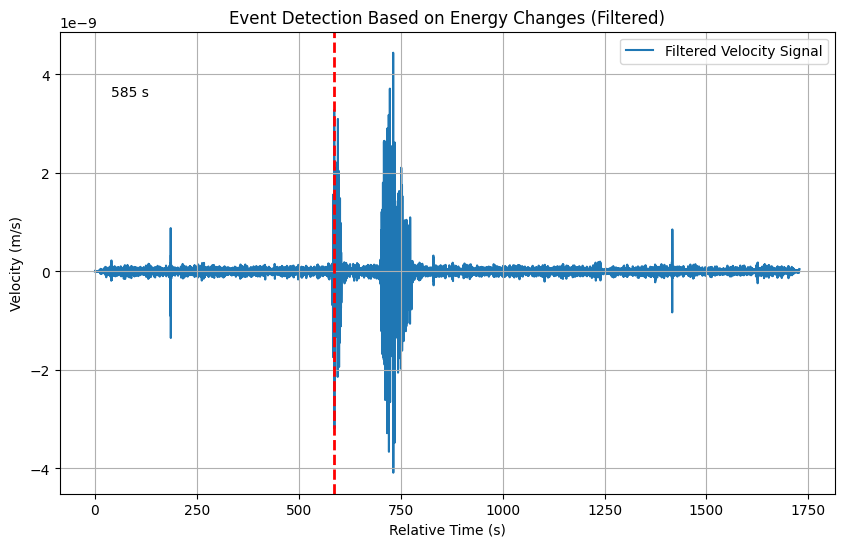

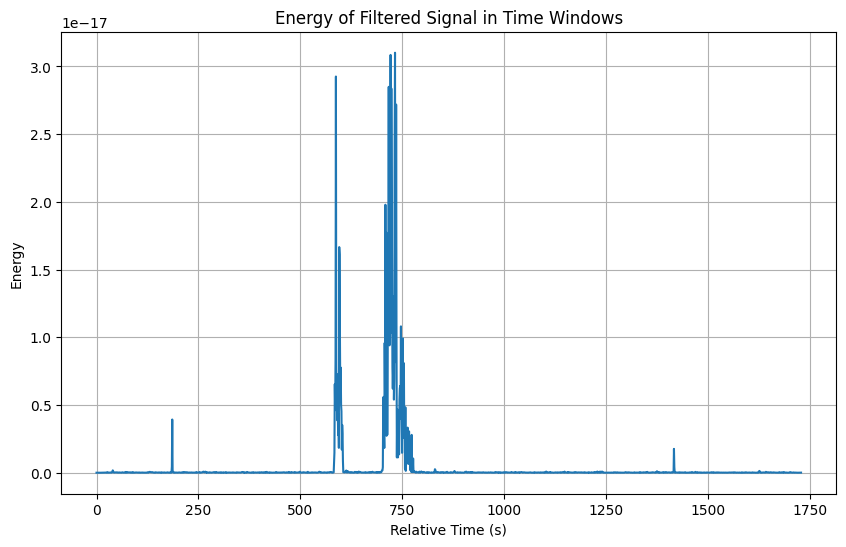

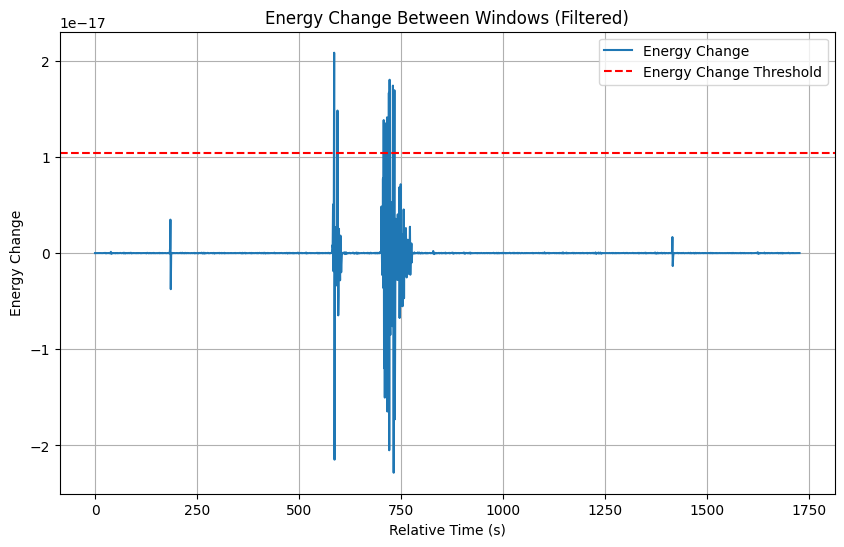

Total signal energy: 4.006953638847294e-16


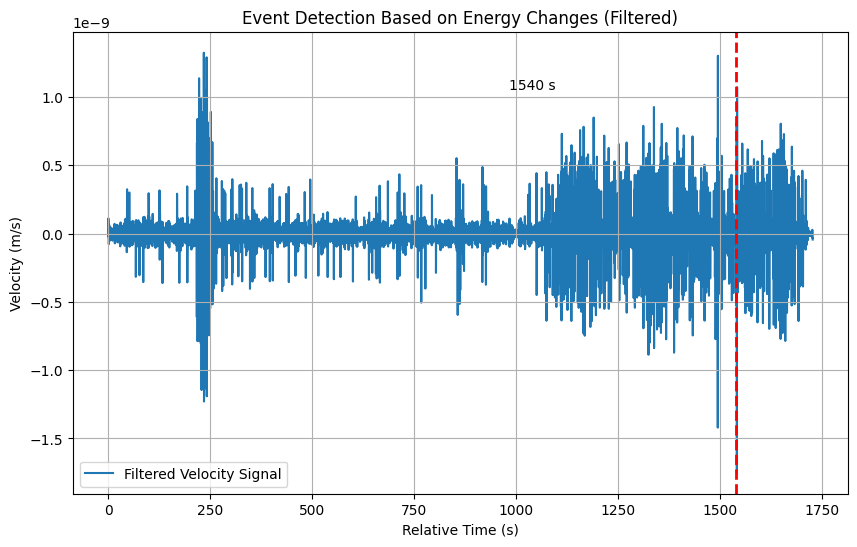

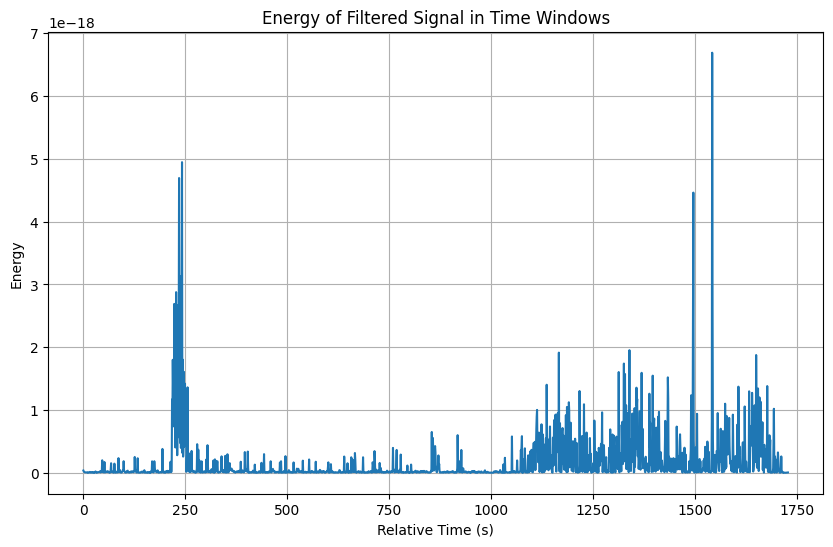

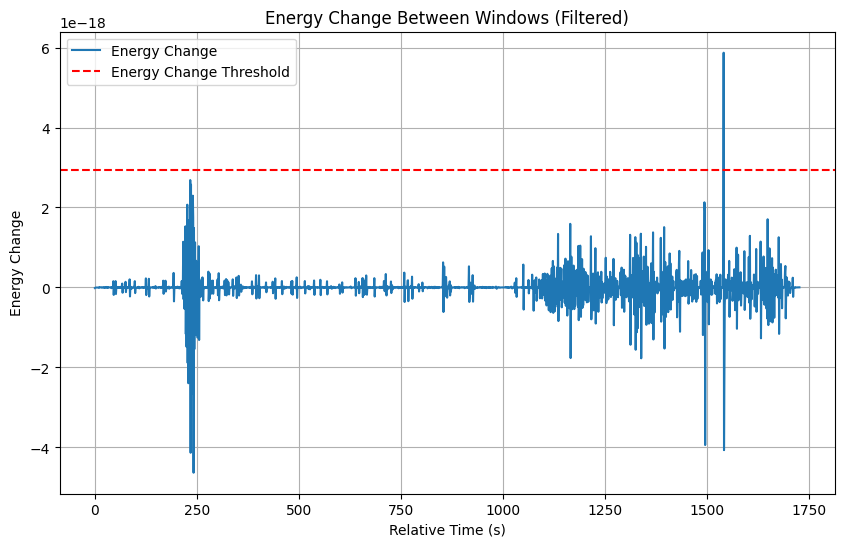

Total signal energy: 1.5651600558786024e-13


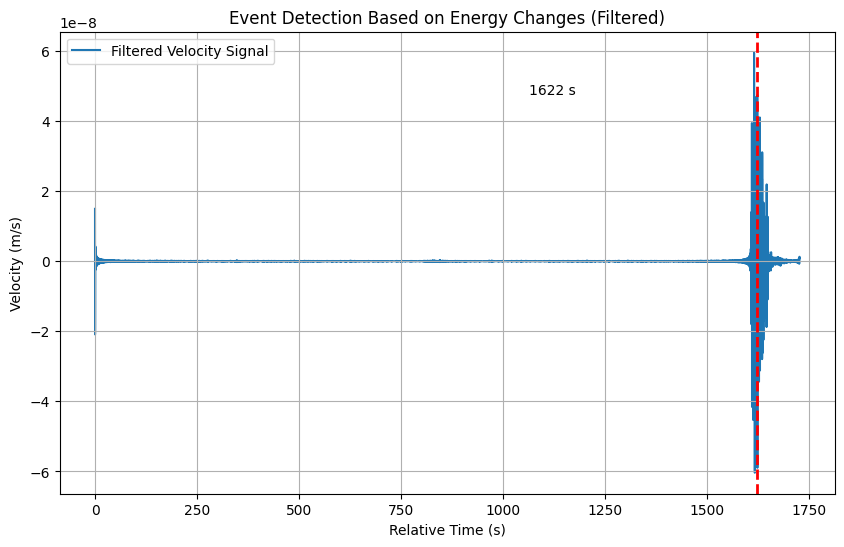

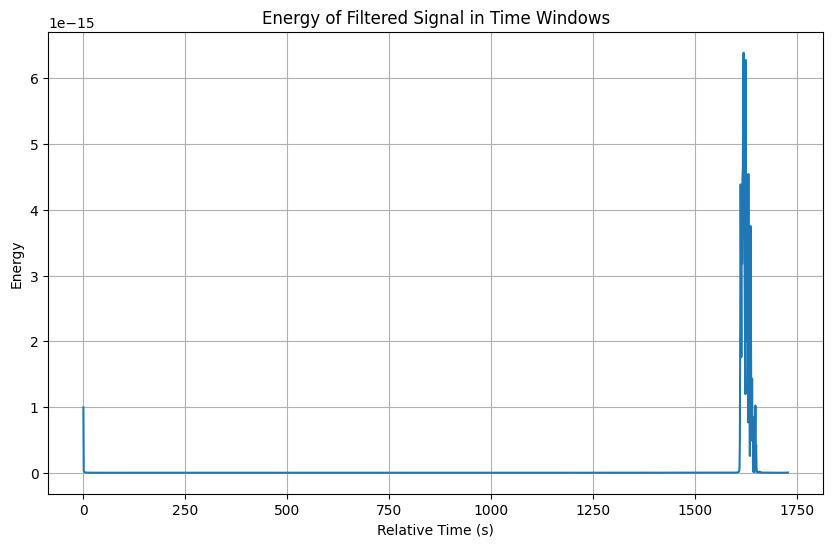

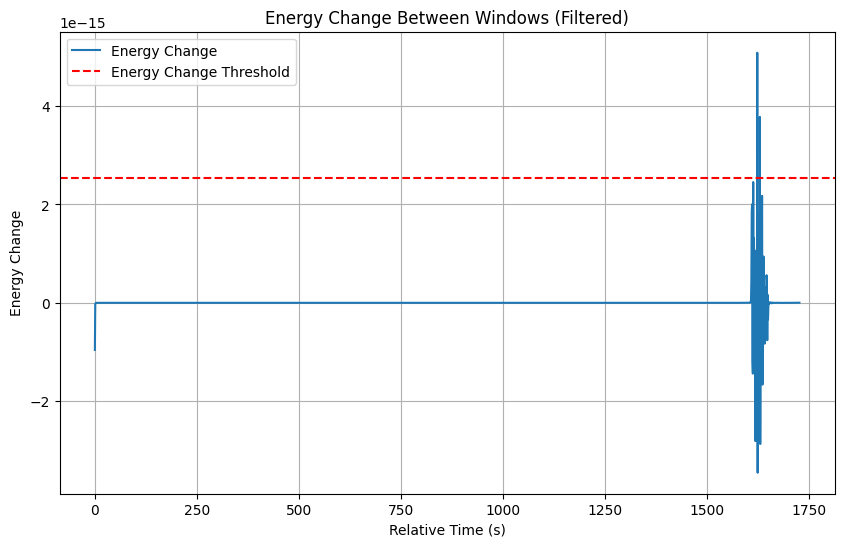

Total signal energy: 2.1869368886923691e-13


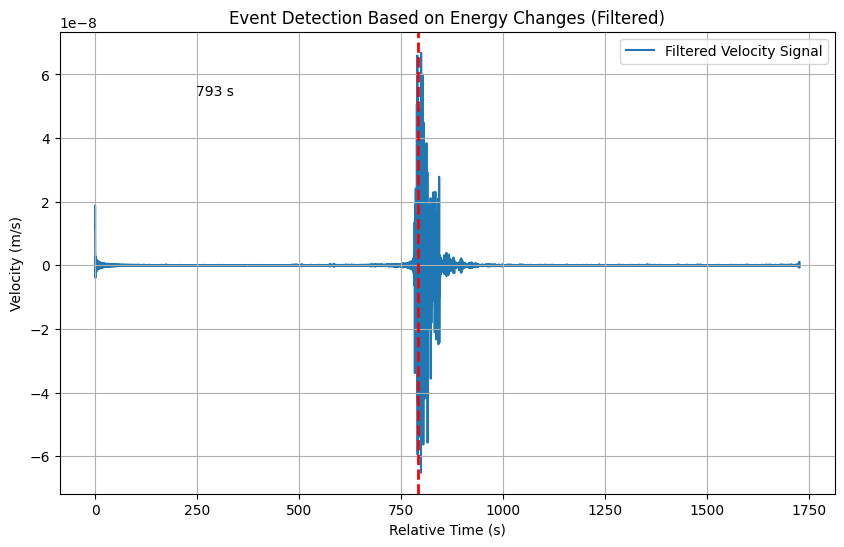

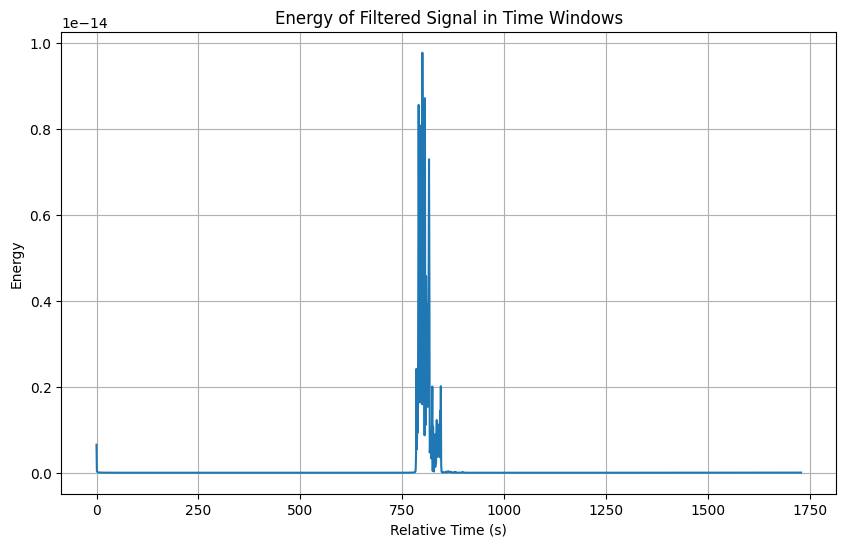

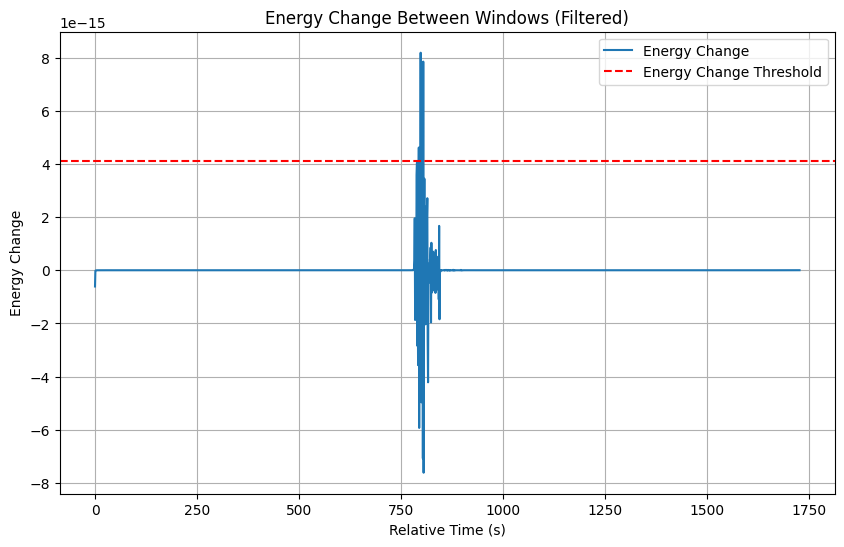

Total signal energy: 1.549561616573211e-16


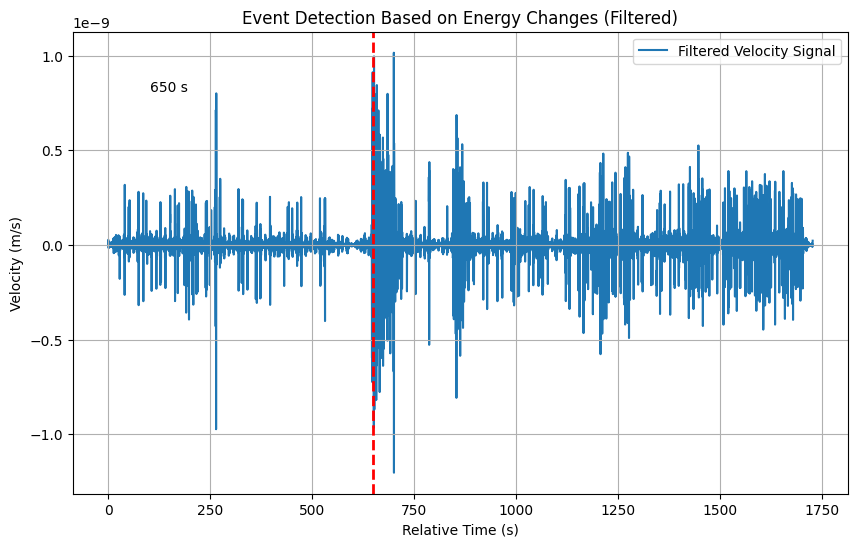

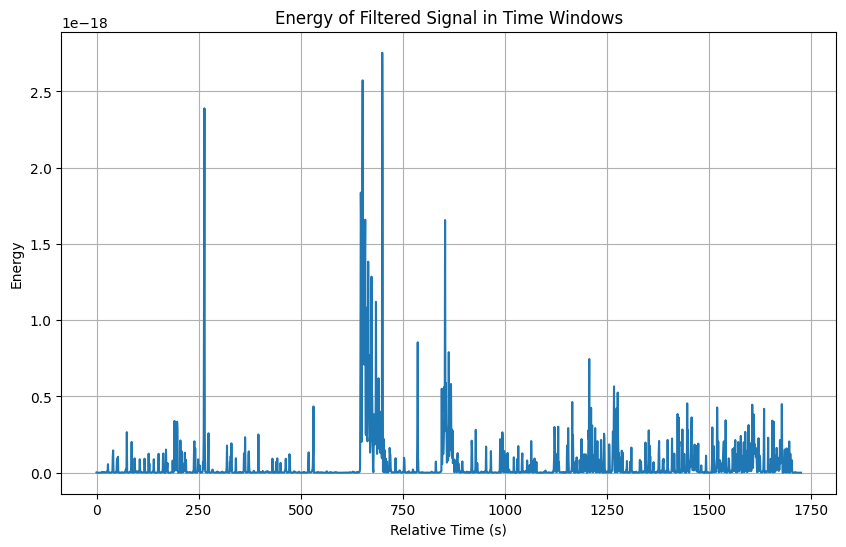

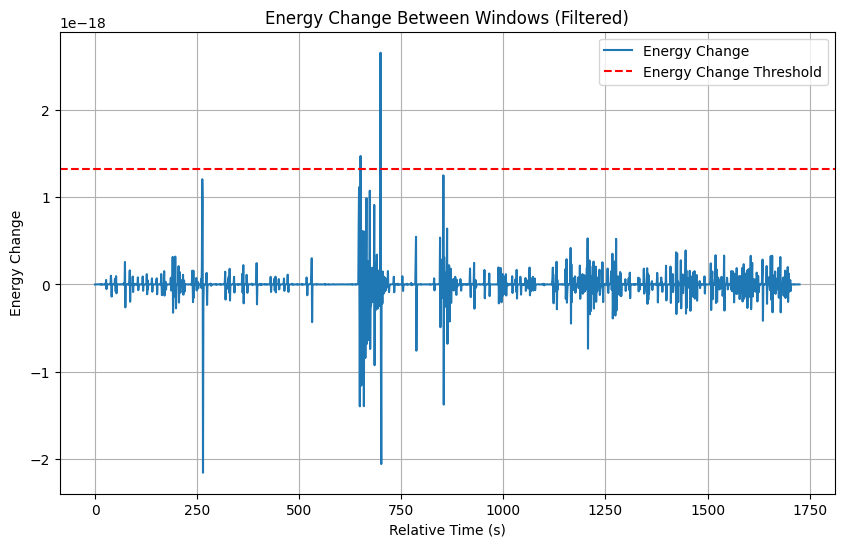

Total signal energy: 1.3509012409408143e-15


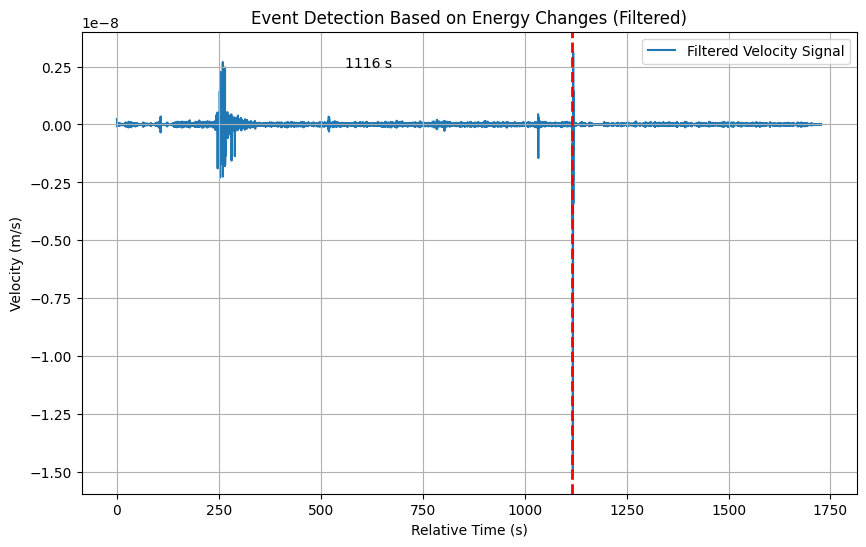

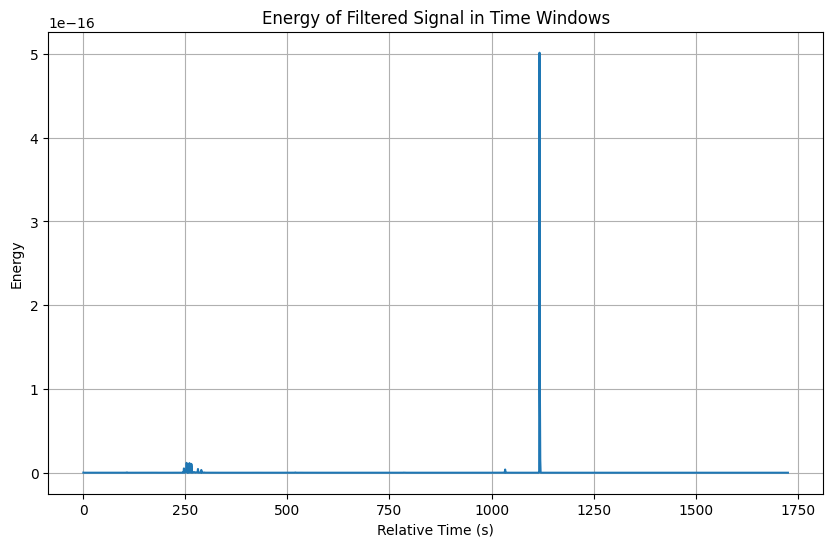

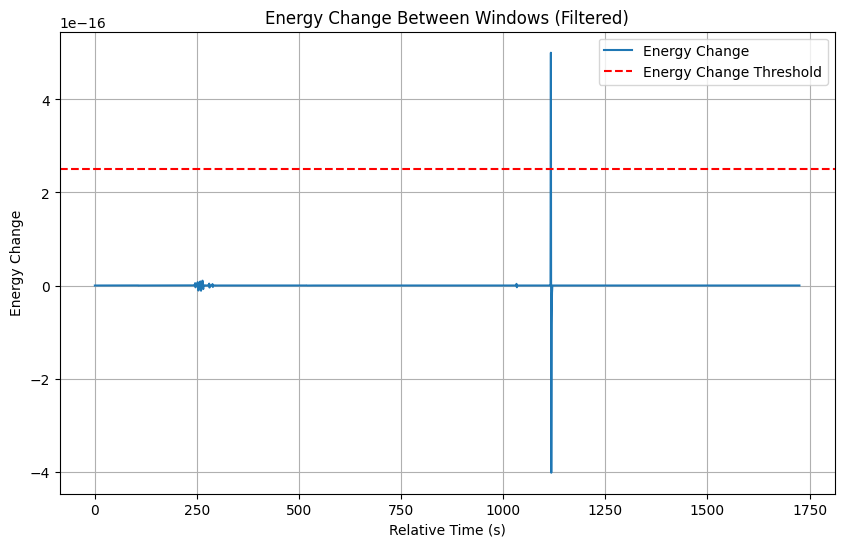

Total signal energy: 2.1538006931507314e-14


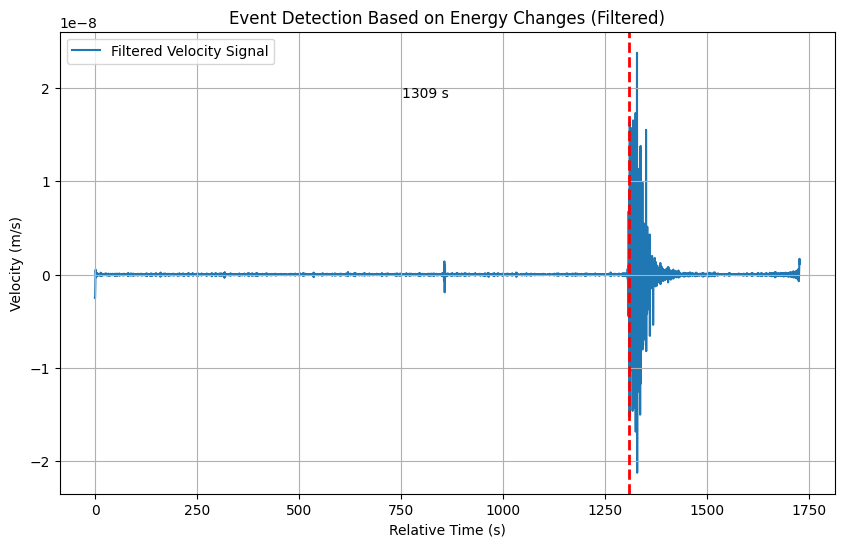

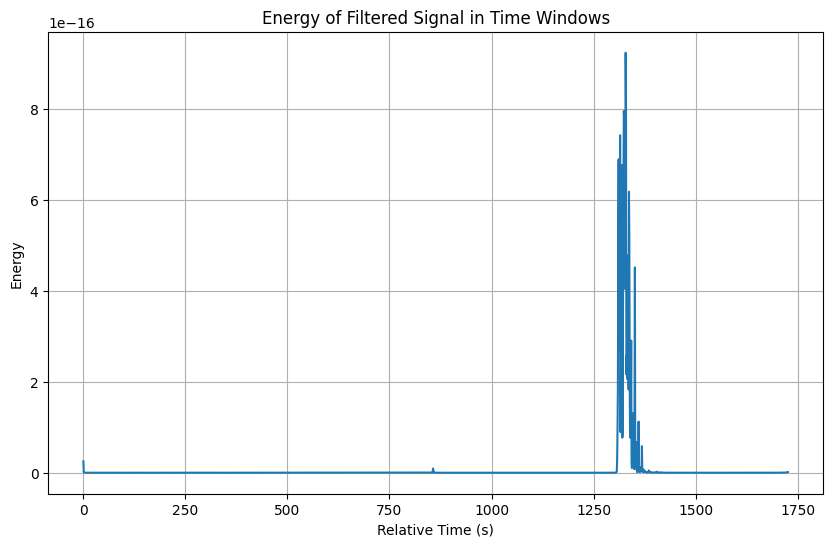

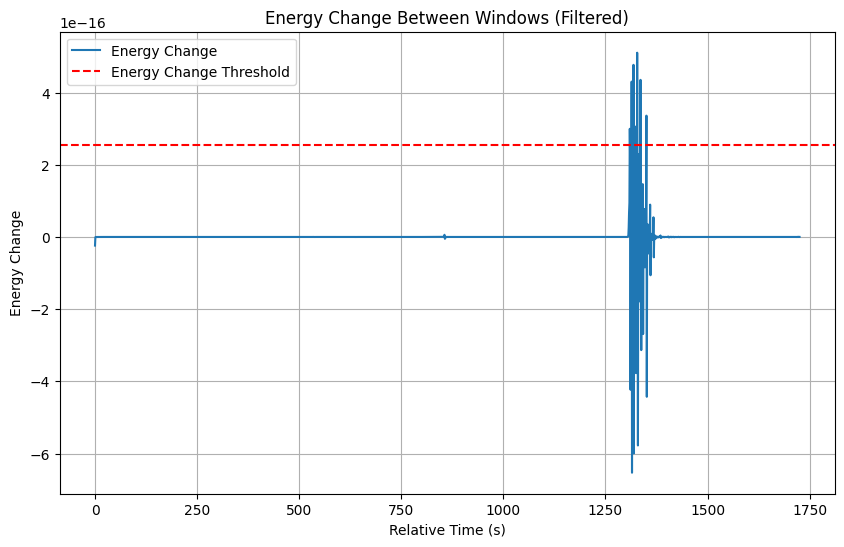

Total signal energy: 5.70094799479277e-16


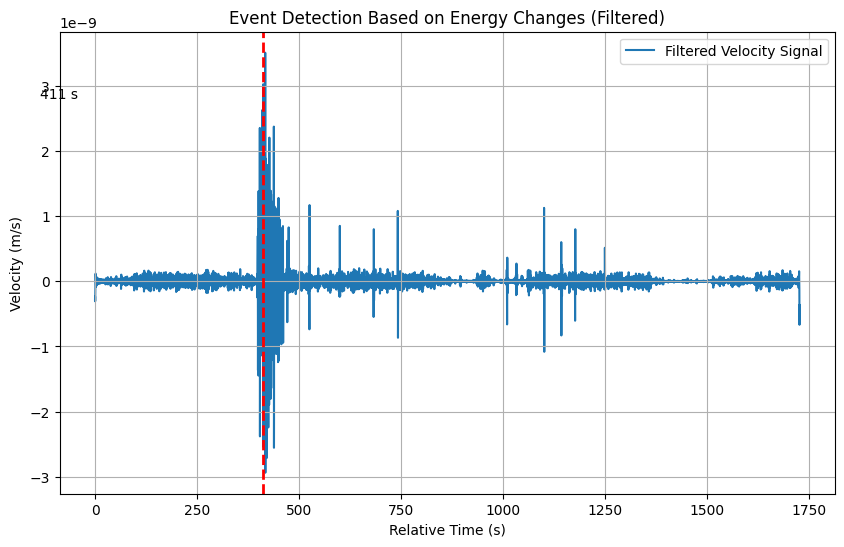

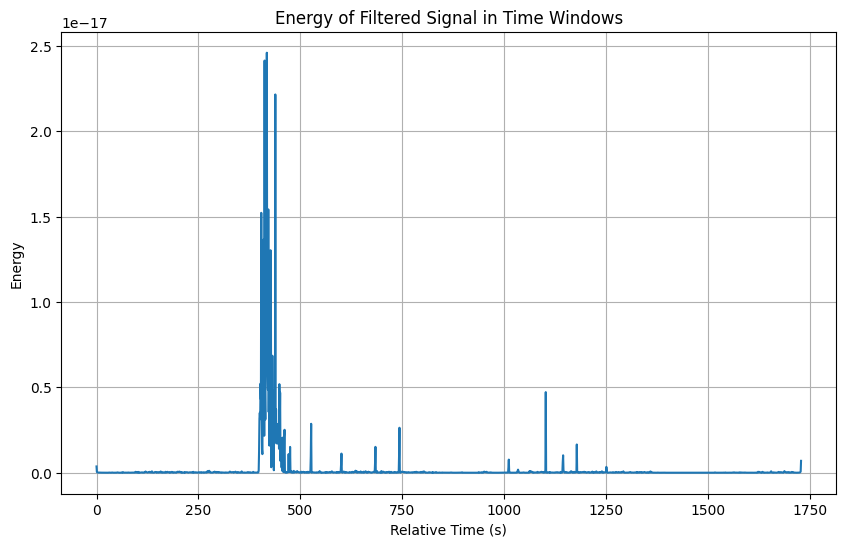

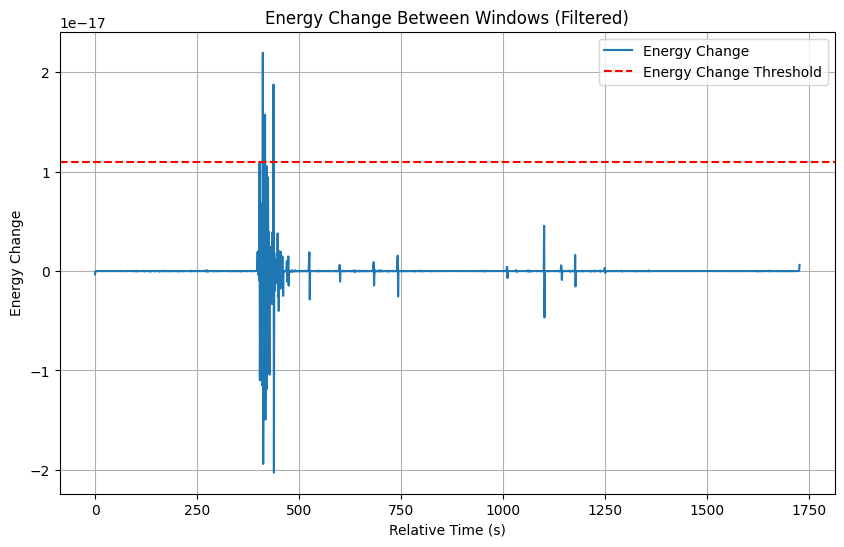

Total signal energy: 2.1074434539415702e-16


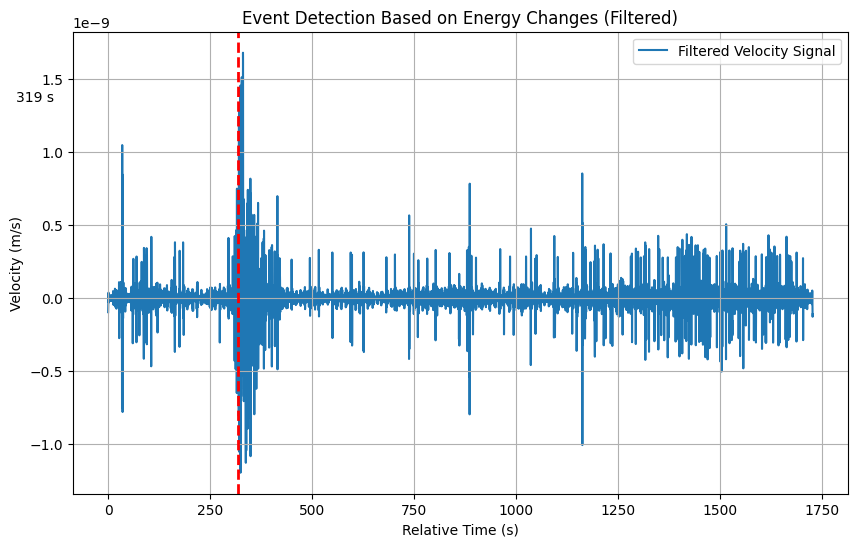

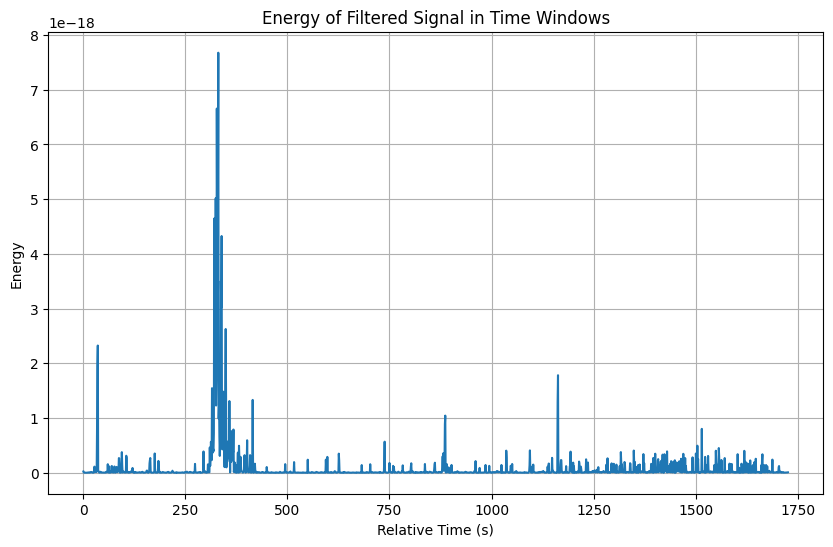

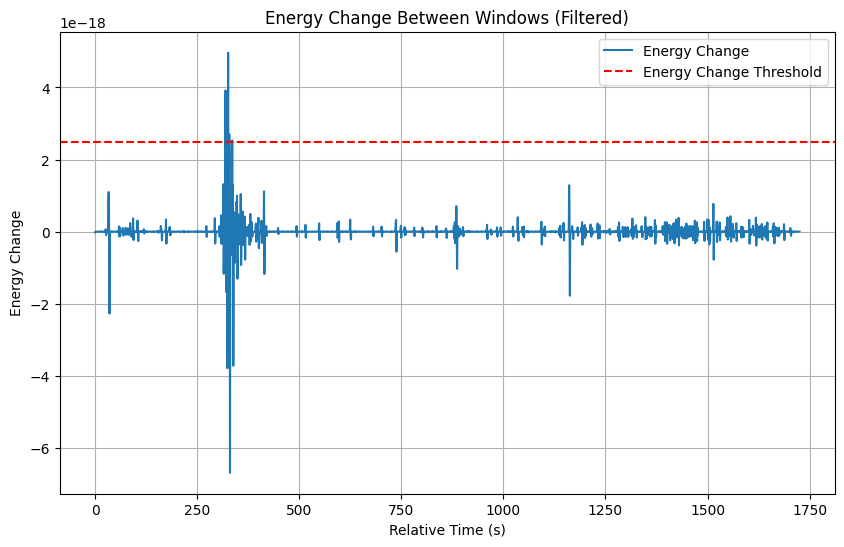

Total signal energy: 4.385734514894944e-16


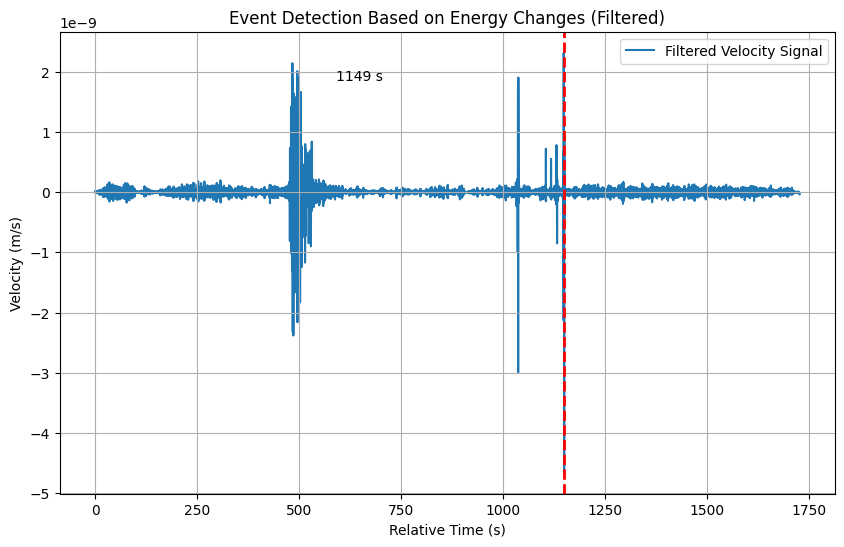

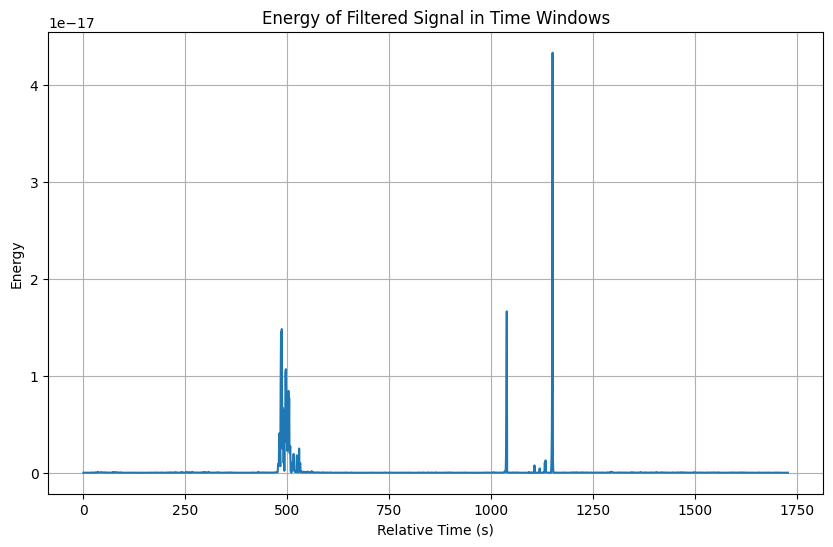

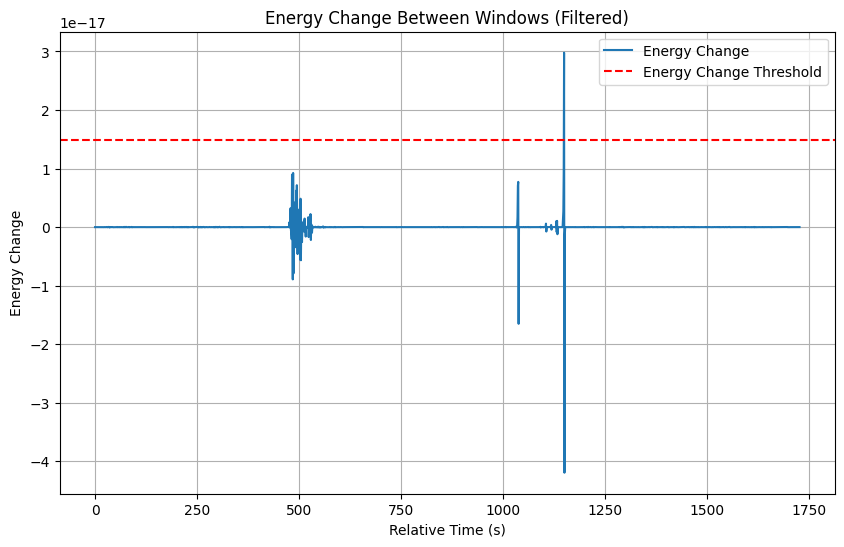

Total signal energy: 2.6408034733748576e-16


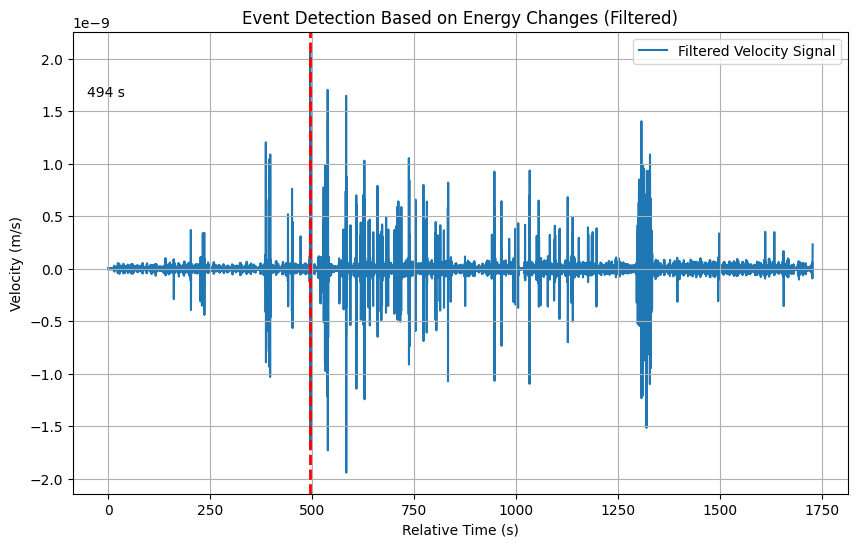

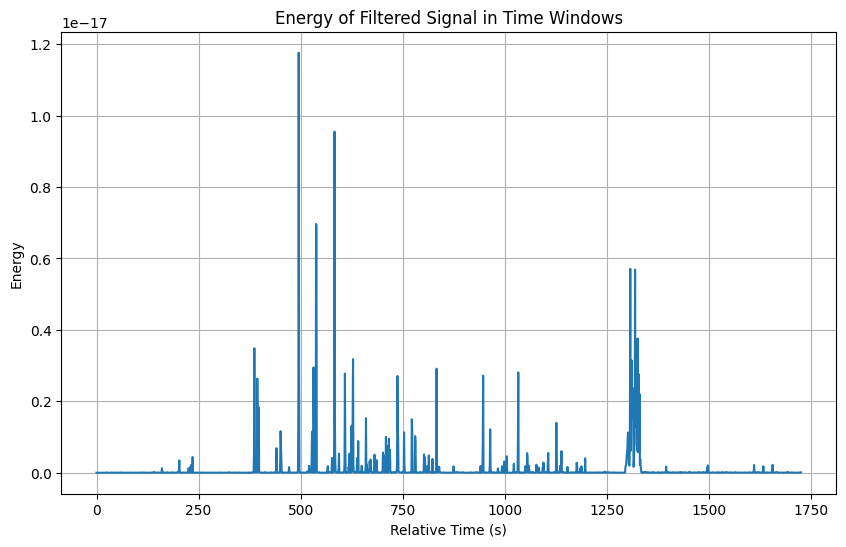

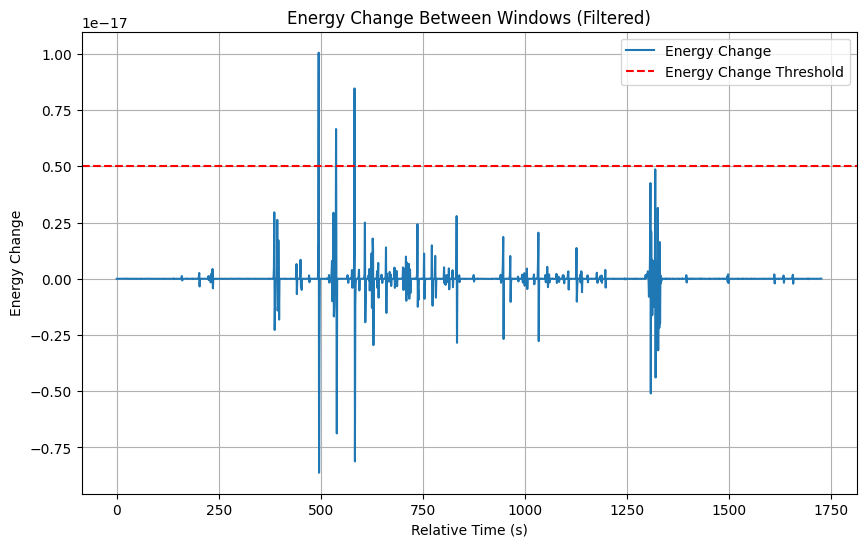

Total signal energy: 1.1036707944362519e-15


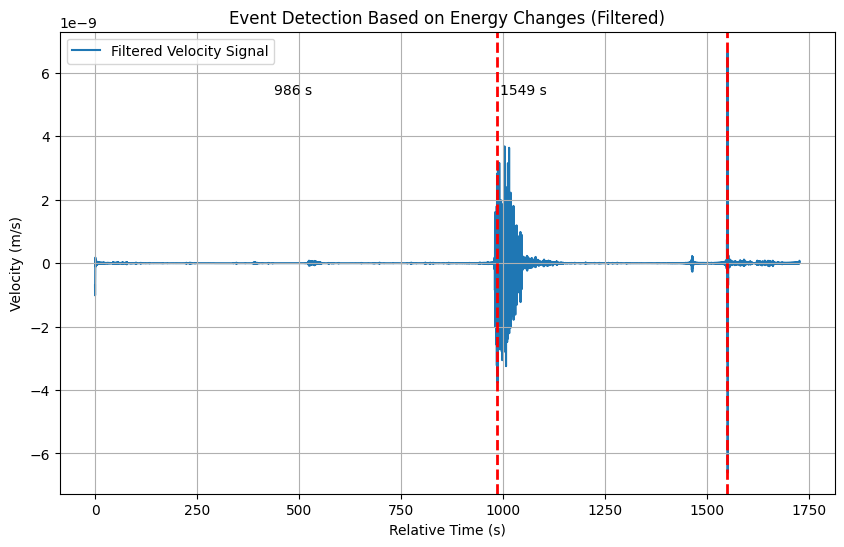

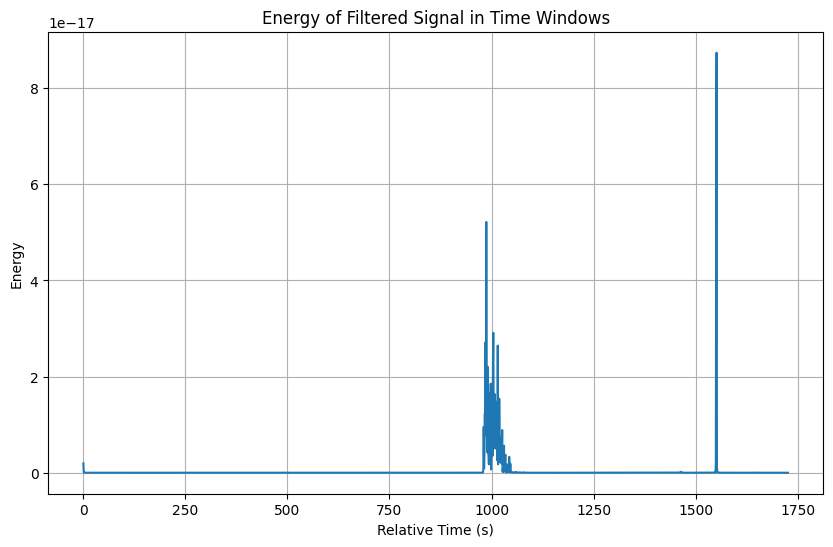

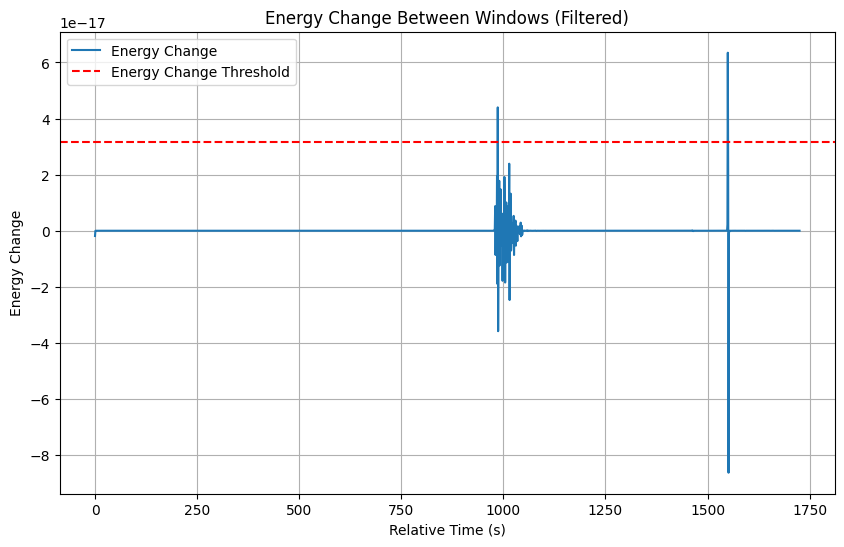

Total signal energy: 3.615799990409701e-16


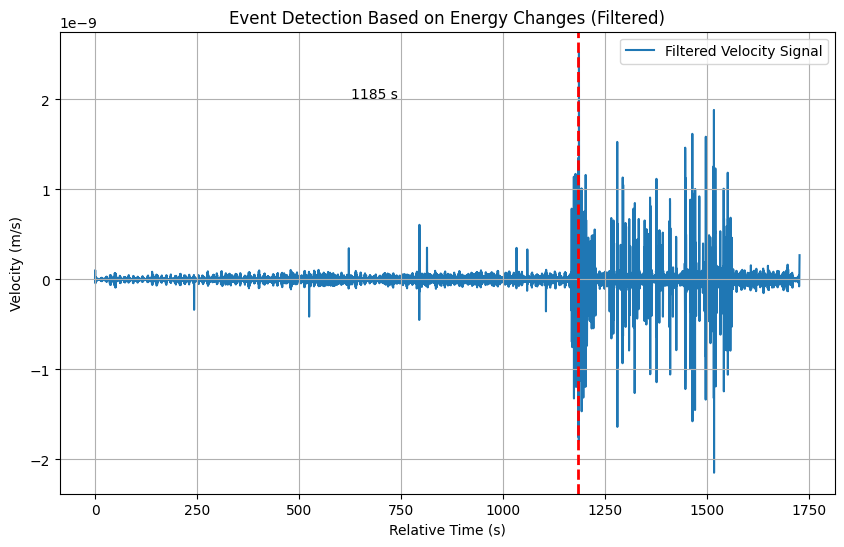

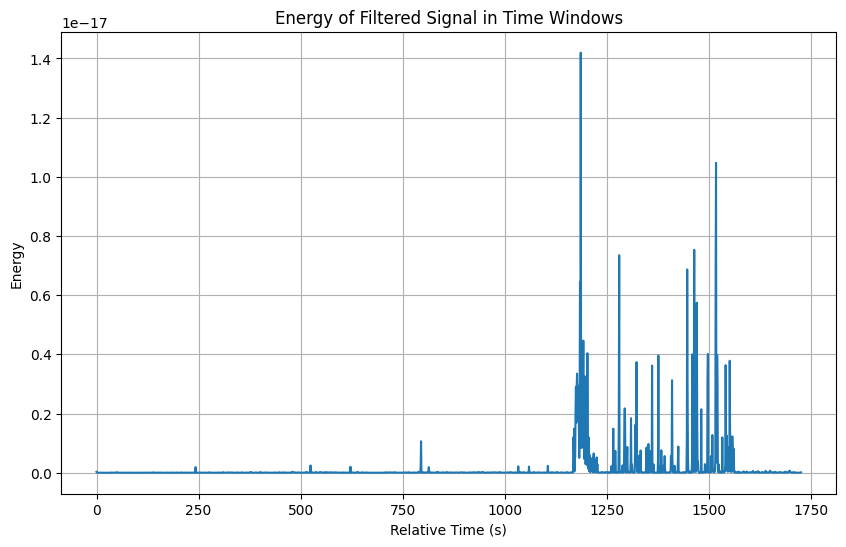

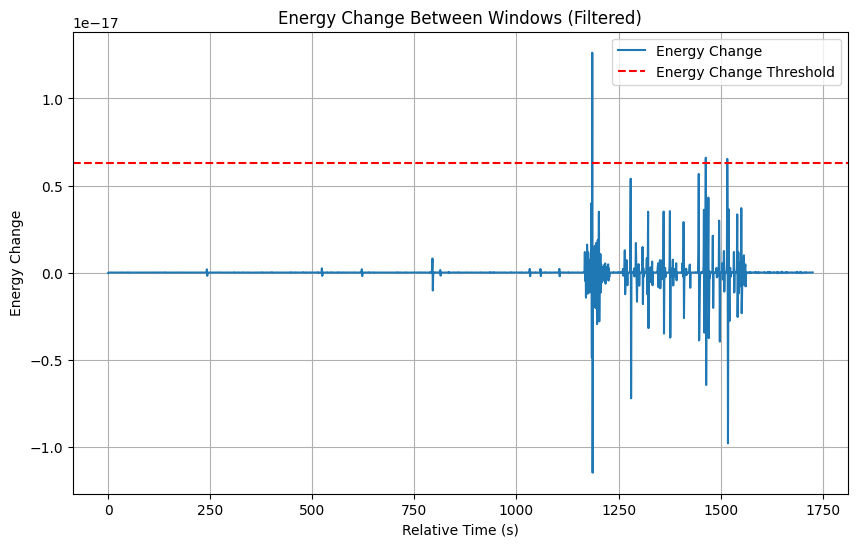

Total signal energy: 1.644266803465816e-14


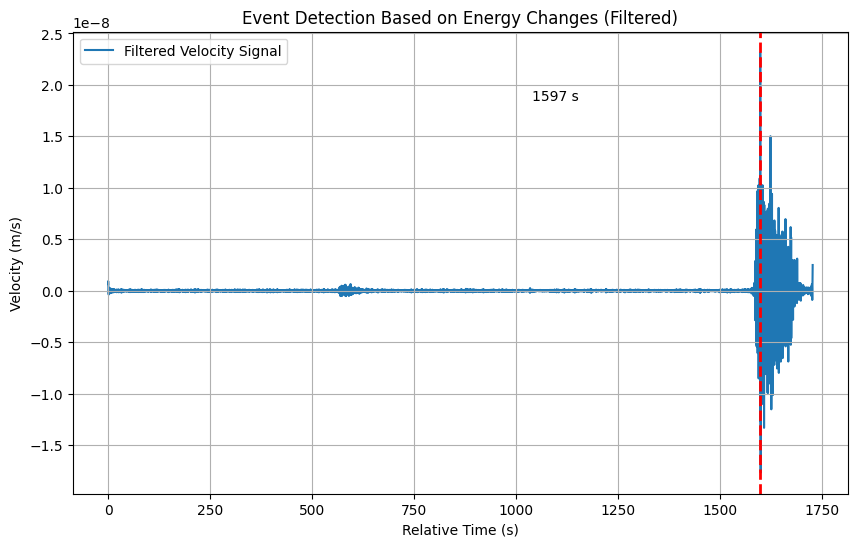

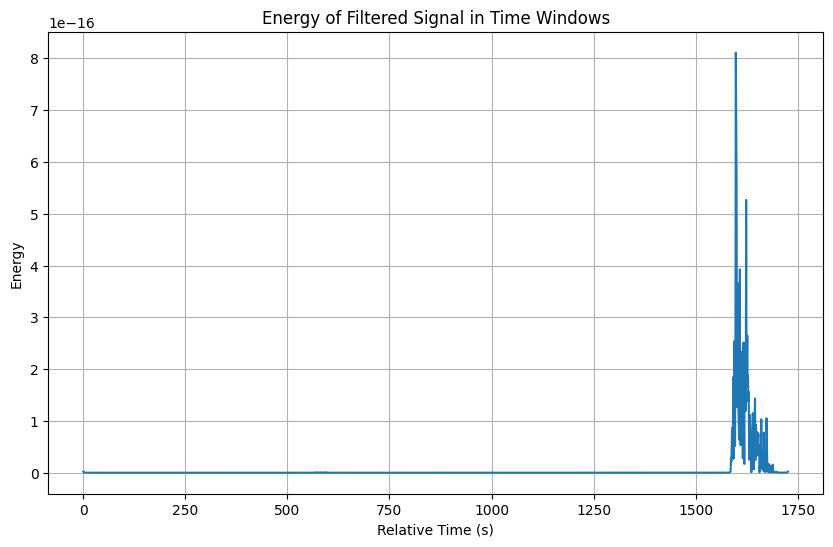

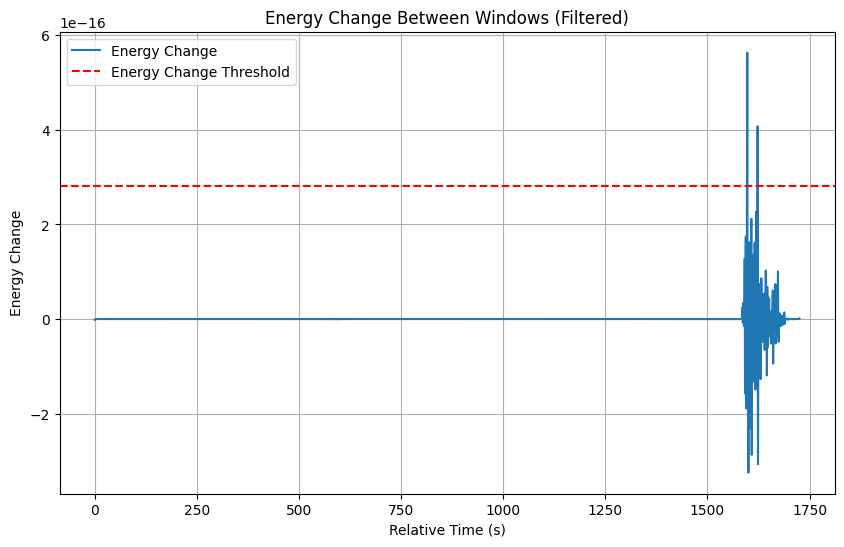

Total signal energy: 1.644266803465816e-14


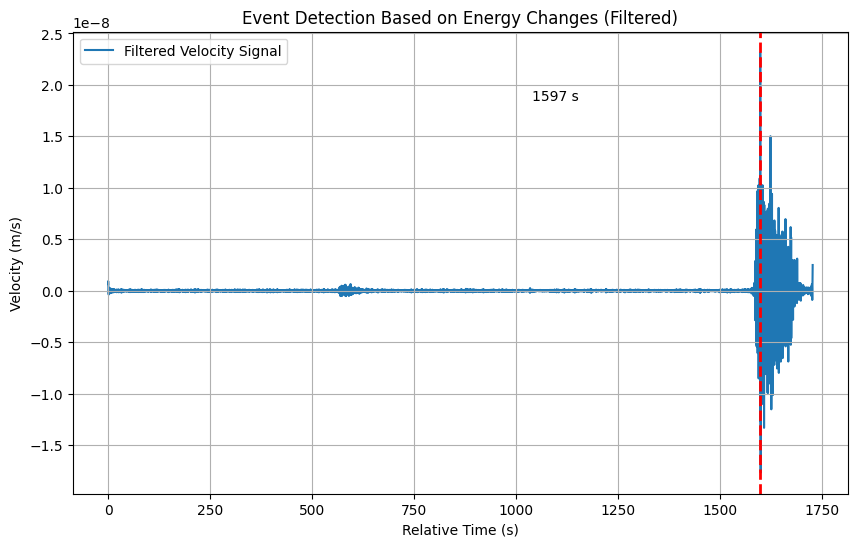

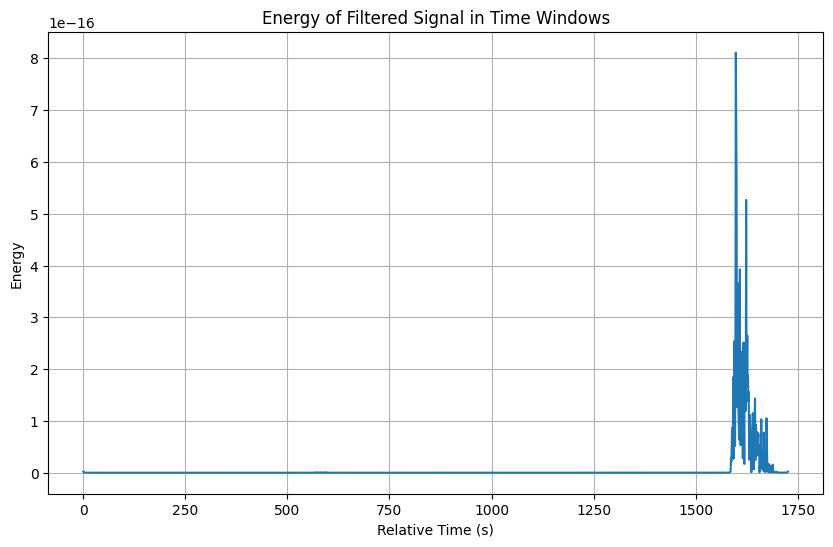

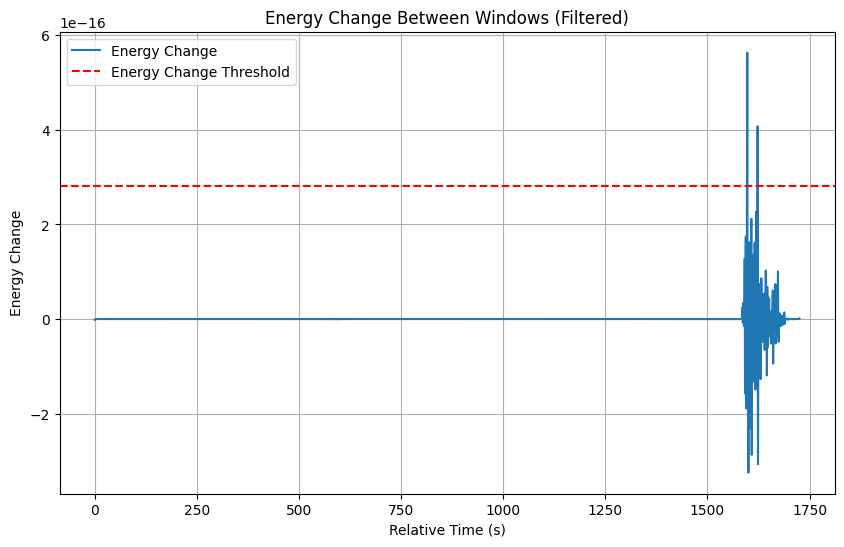

Total signal energy: 1.6640773692464784e-16


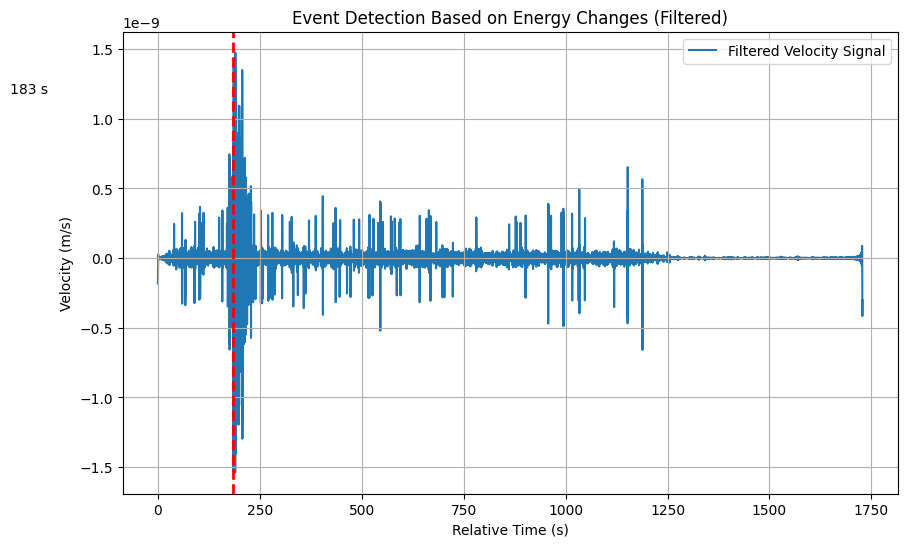

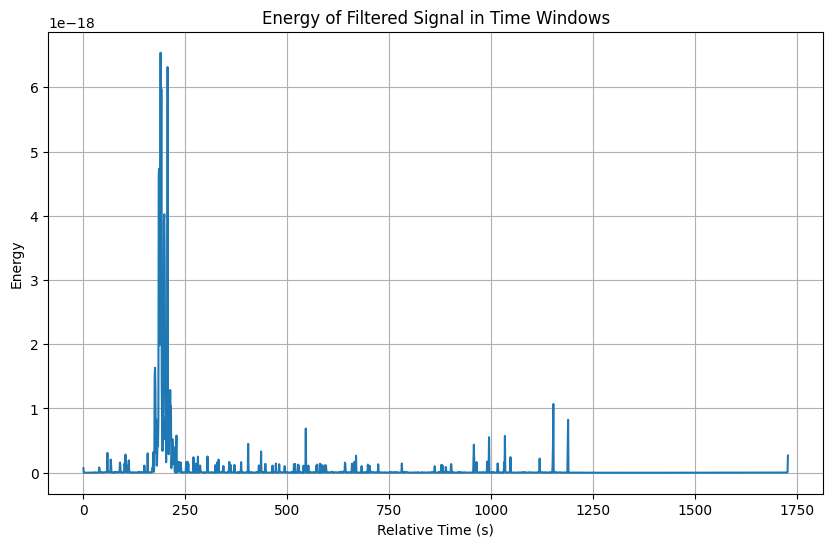

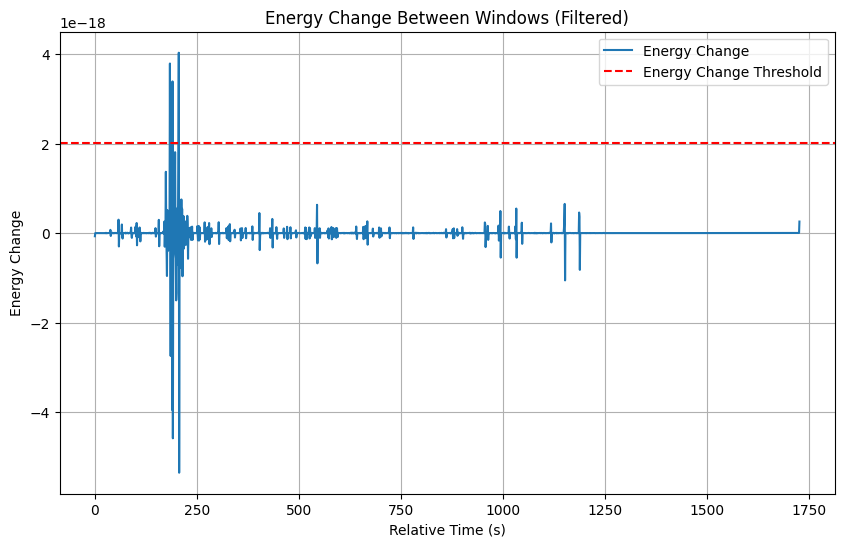

Total signal energy: 1.2551250012656432e-15


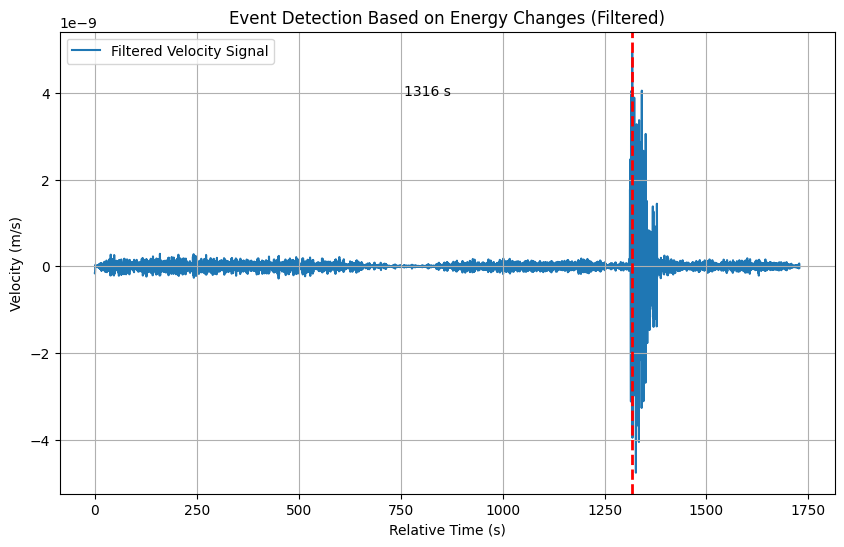

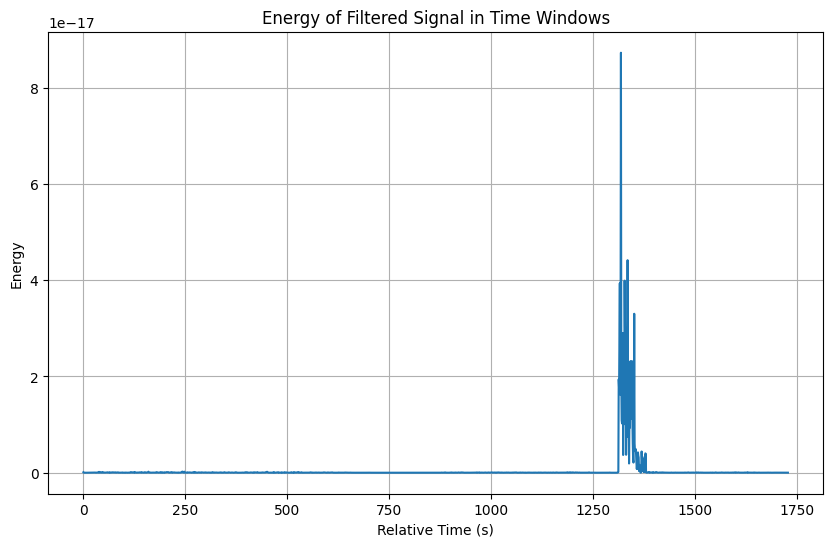

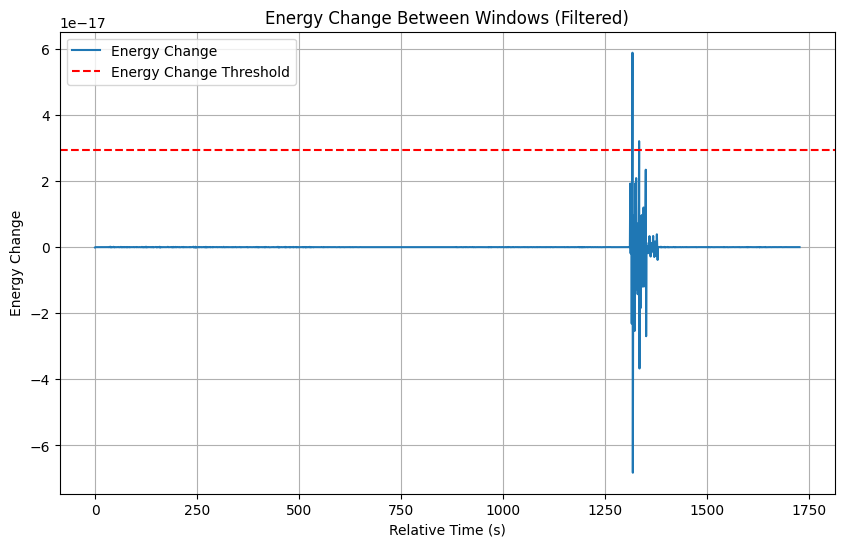

Total signal energy: 2.60477232721723e-16


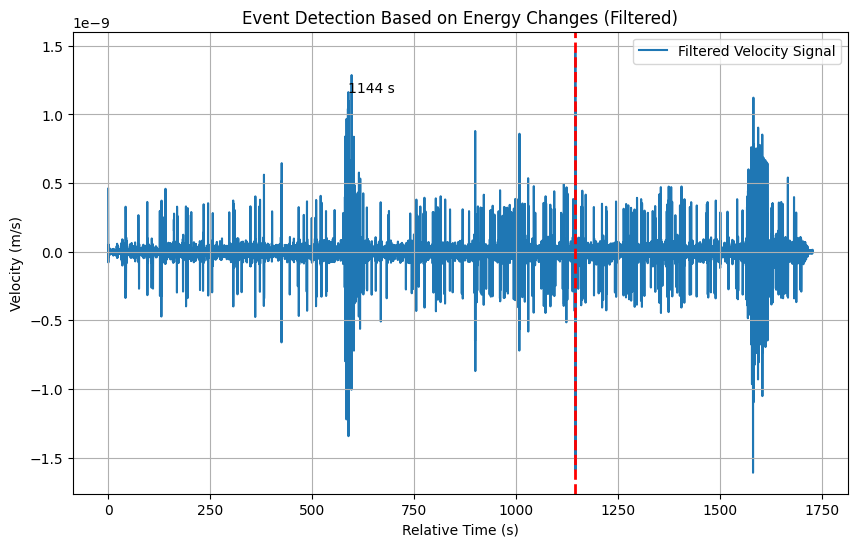

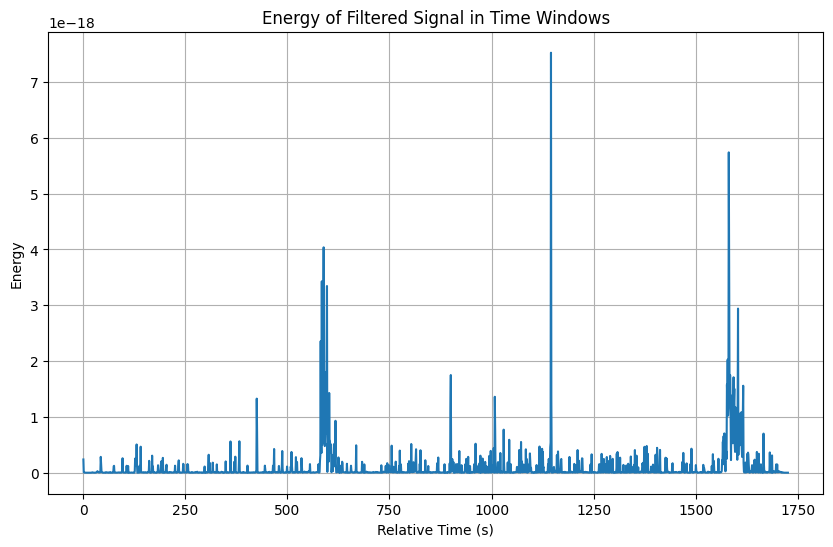

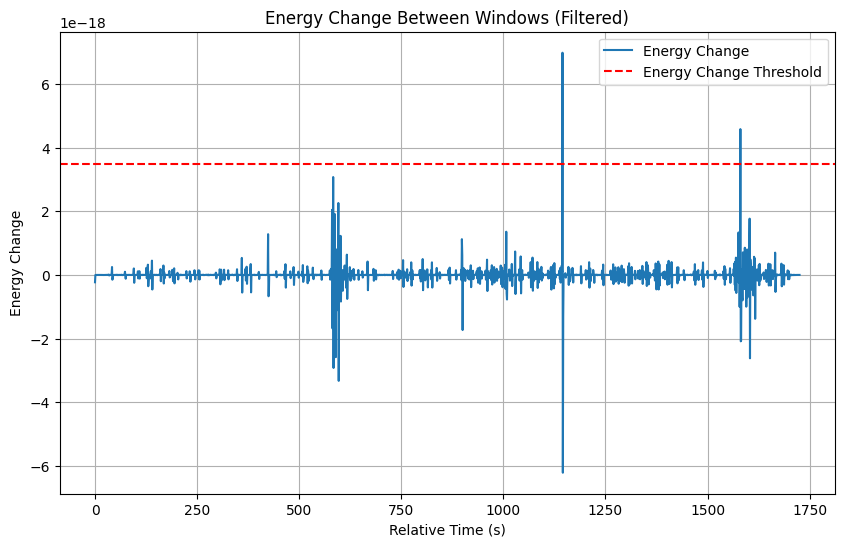

Total signal energy: 1.8148542014043913e-16


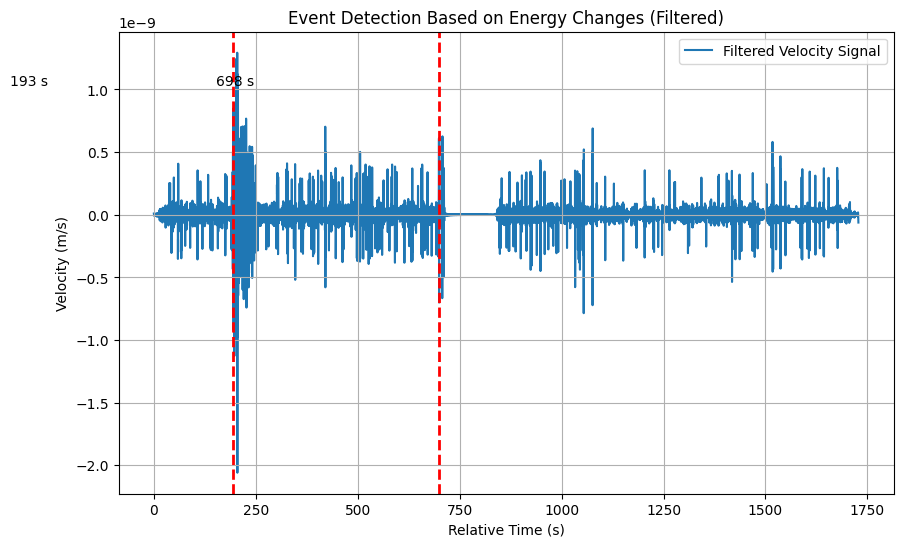

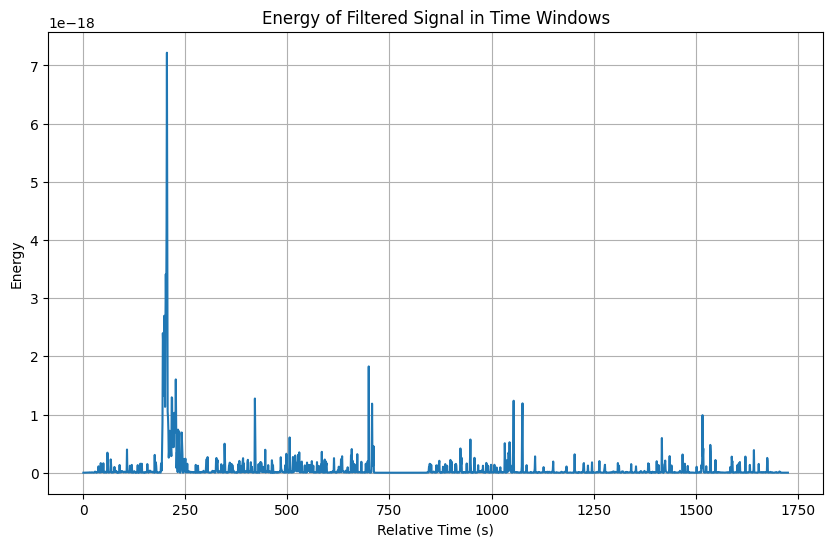

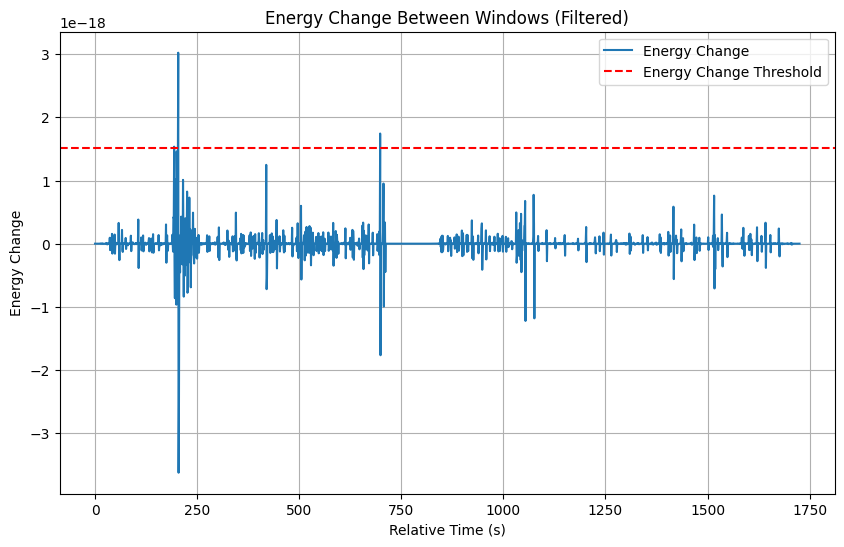

Total signal energy: 9.279512592760526e-17


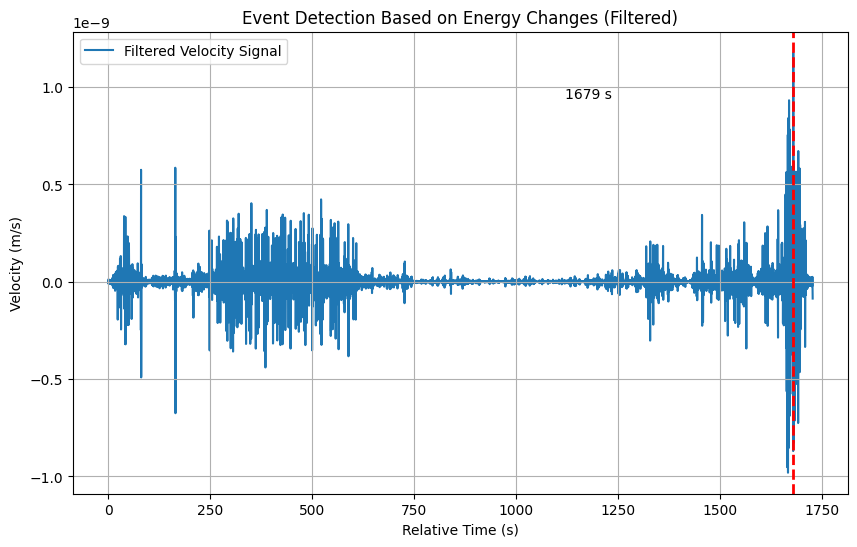

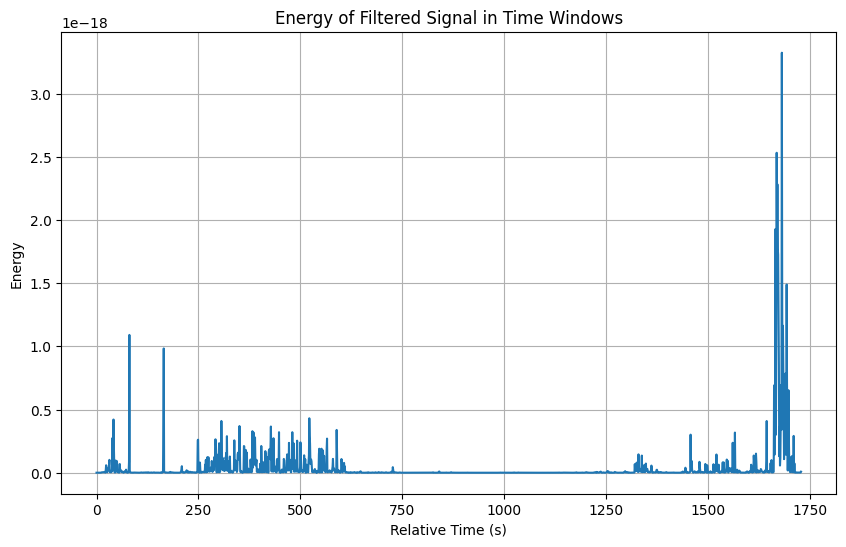

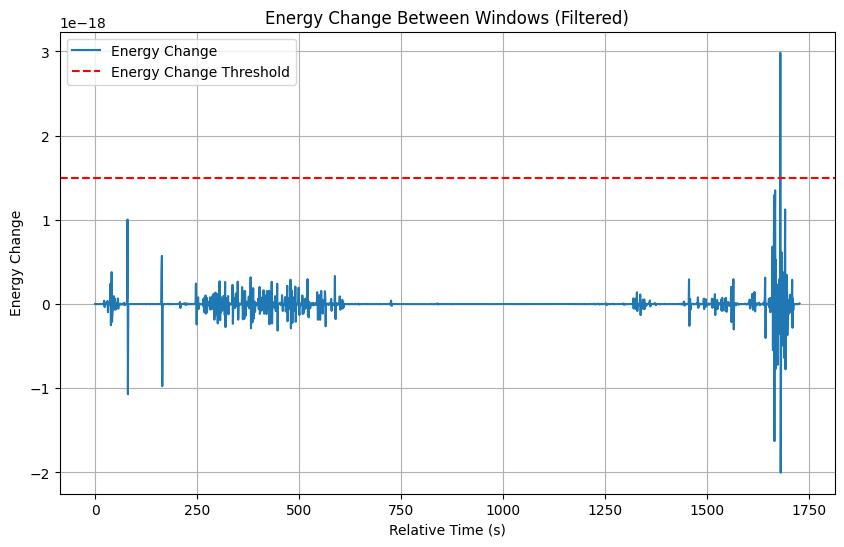

Total signal energy: 1.0278915668296933e-16


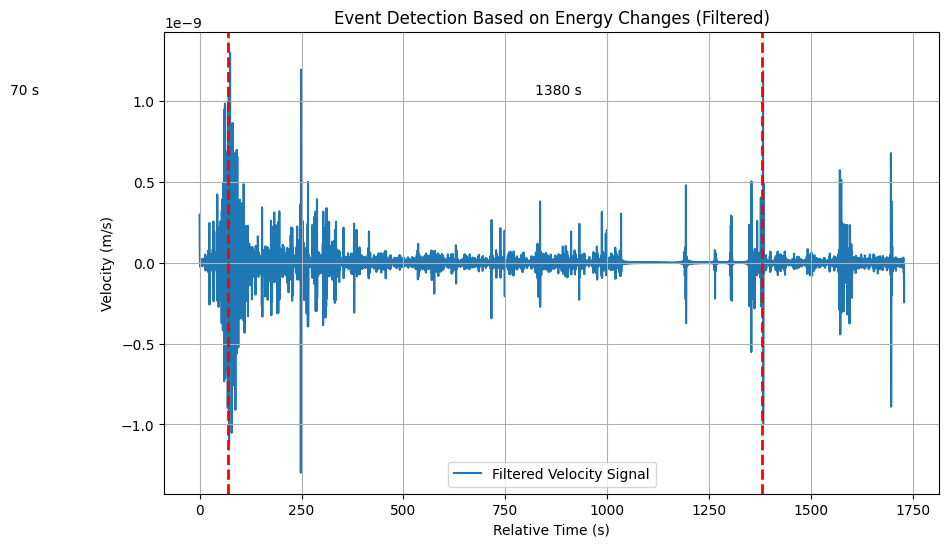

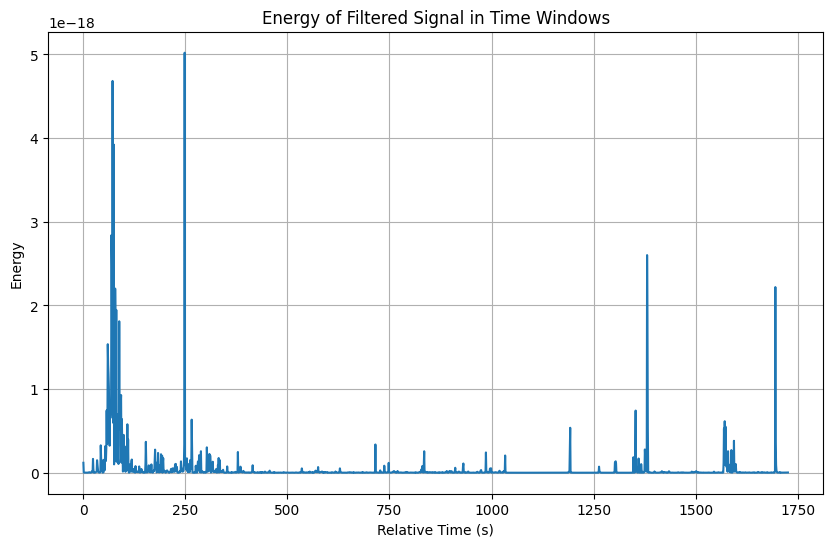

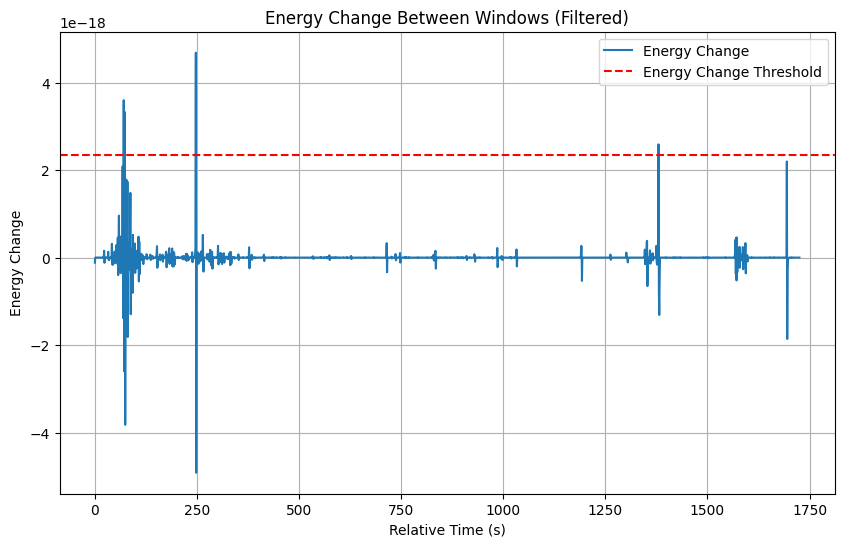

Total signal energy: 1.3471774276482912e-16


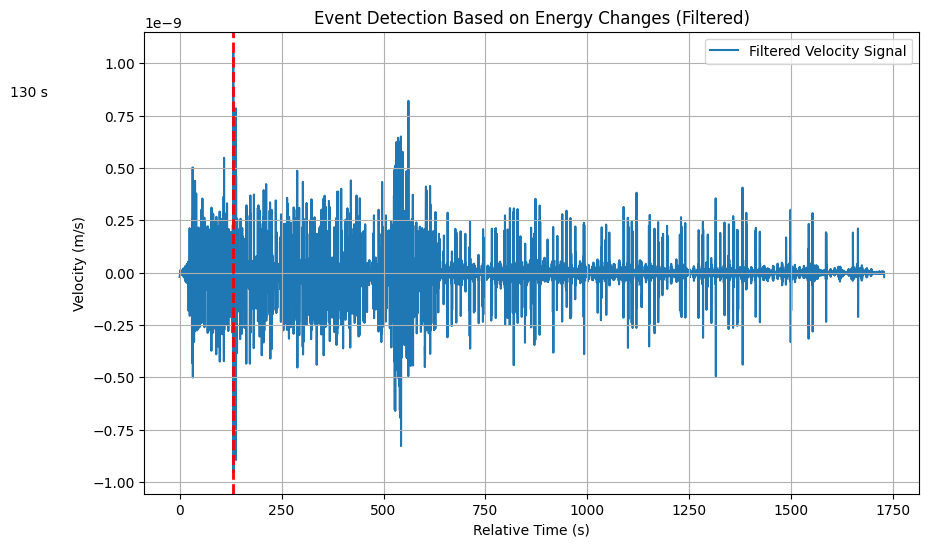

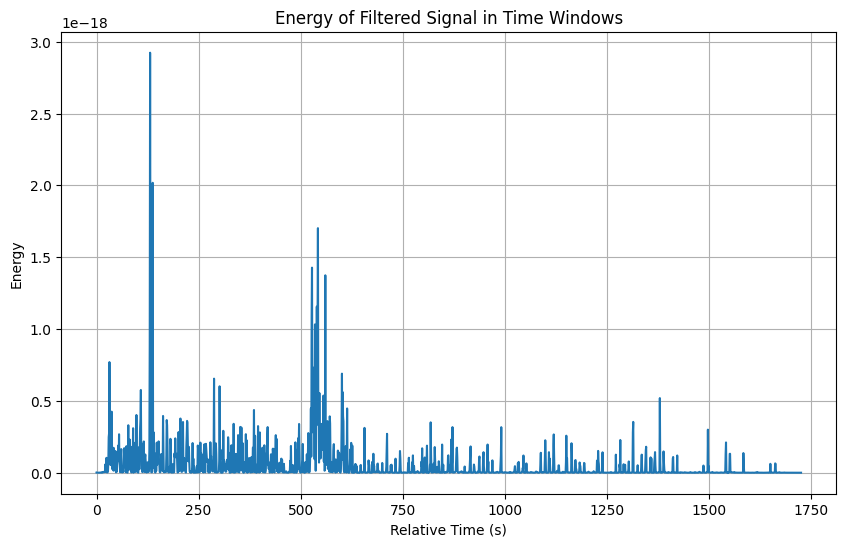

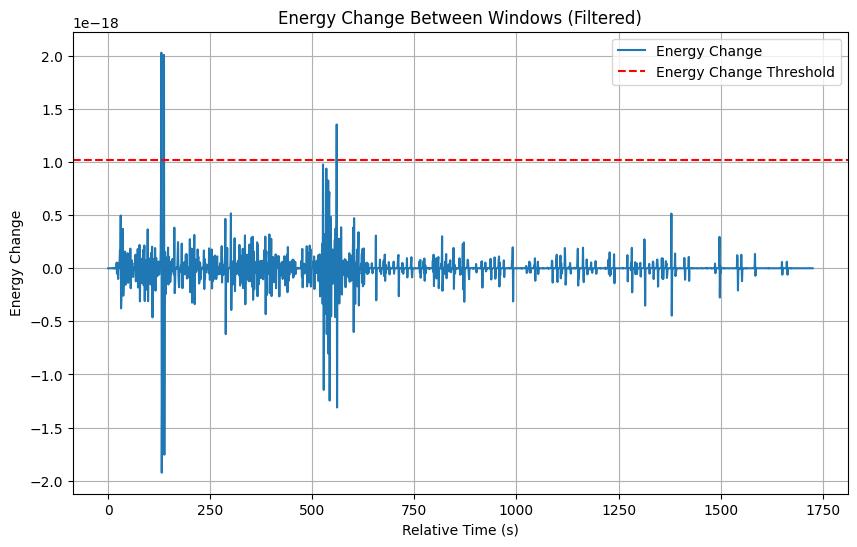

Total signal energy: 3.893398091206629e-14


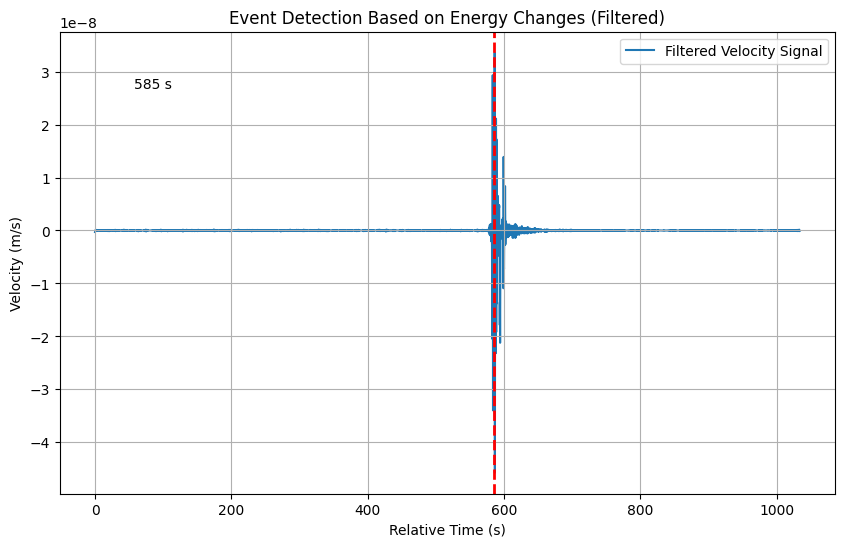

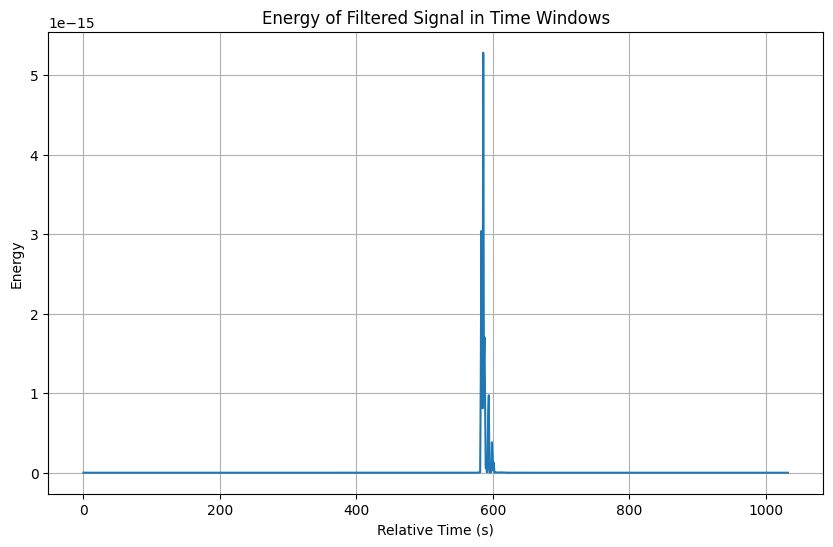

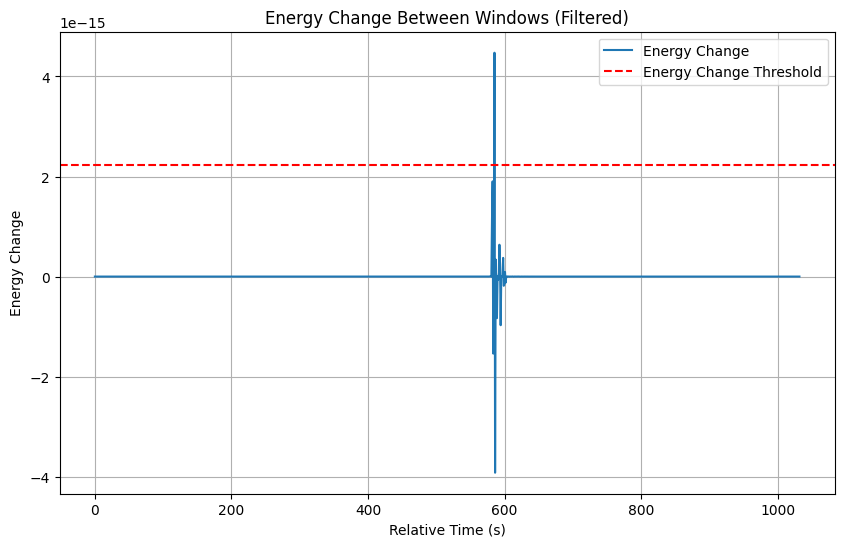

Total signal energy: 3.794962602333368e-16


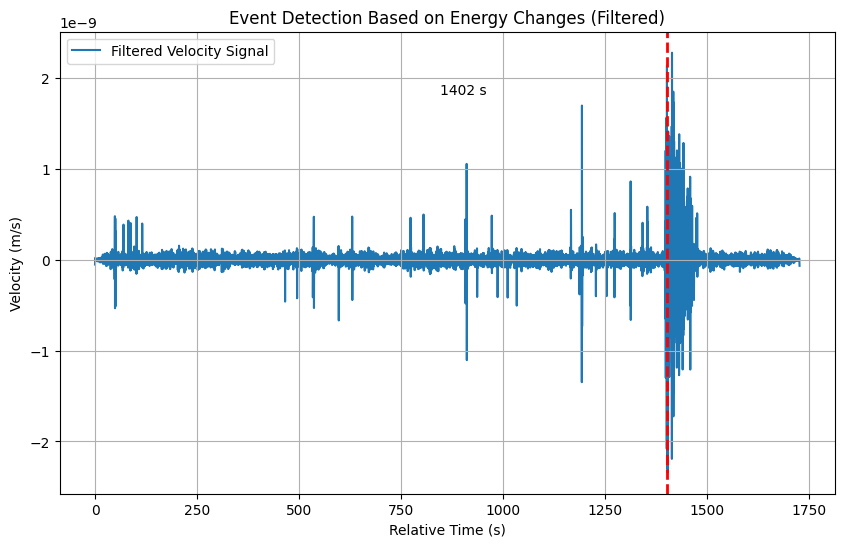

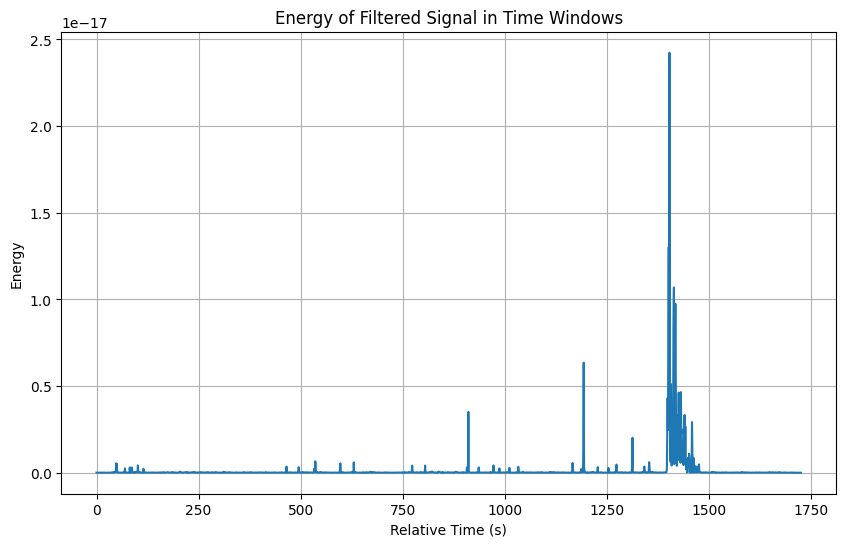

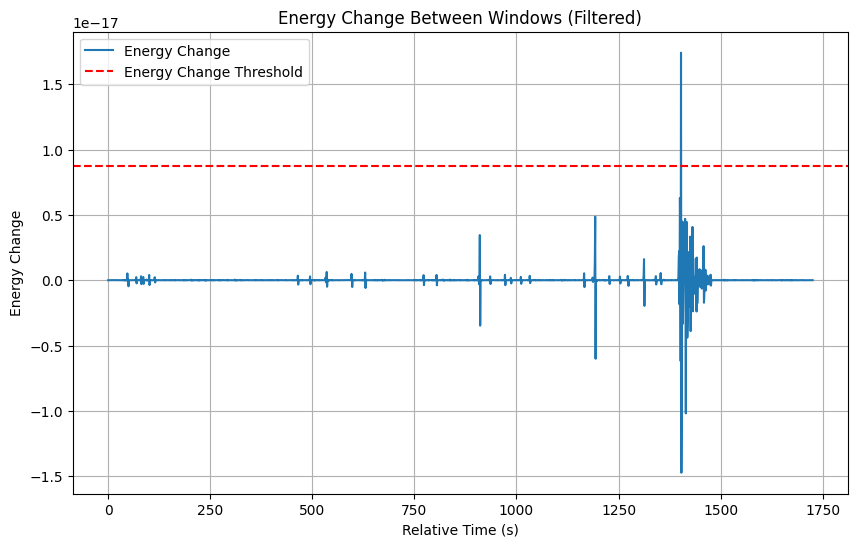

Total signal energy: 1.4107748421018827e-16


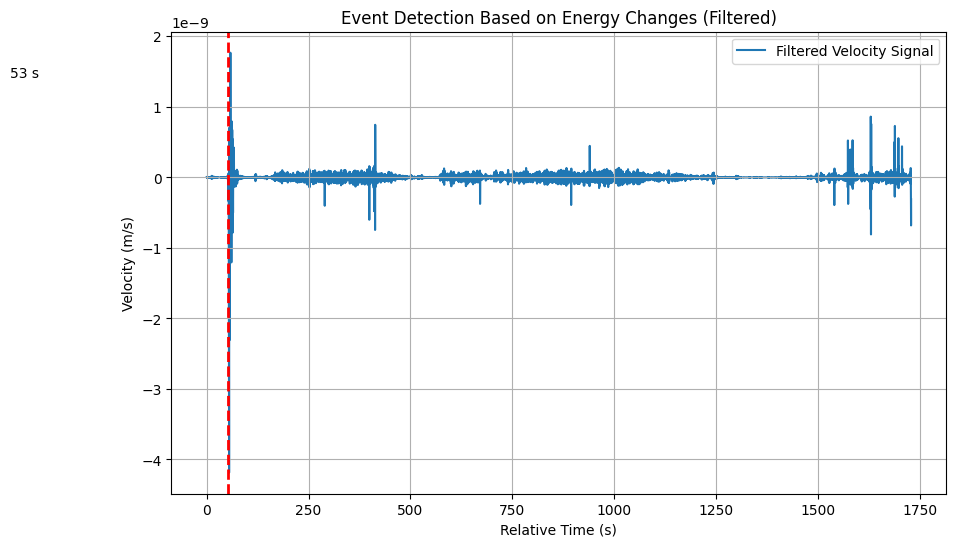

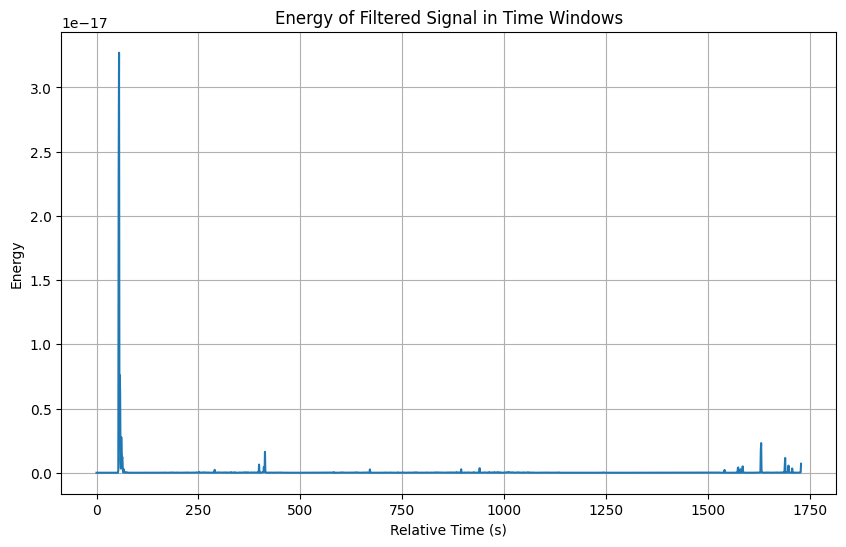

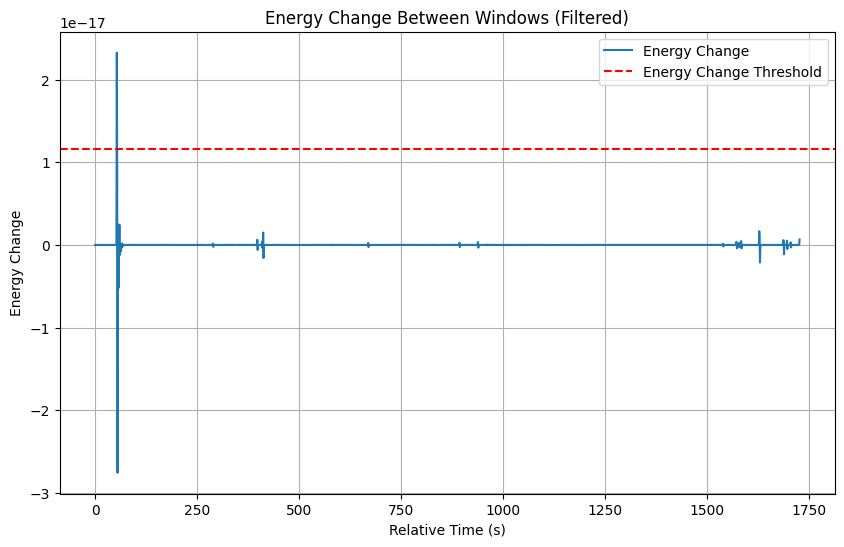

Total signal energy: 1.710553951677852e-16


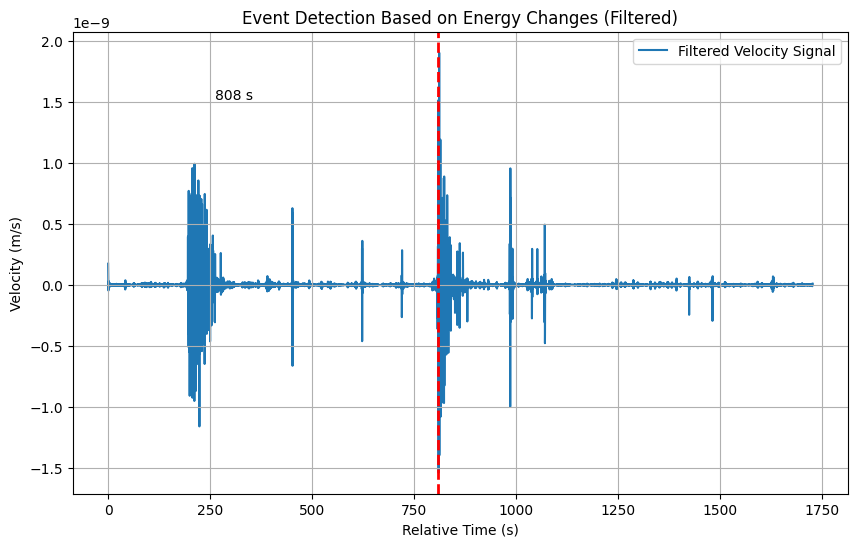

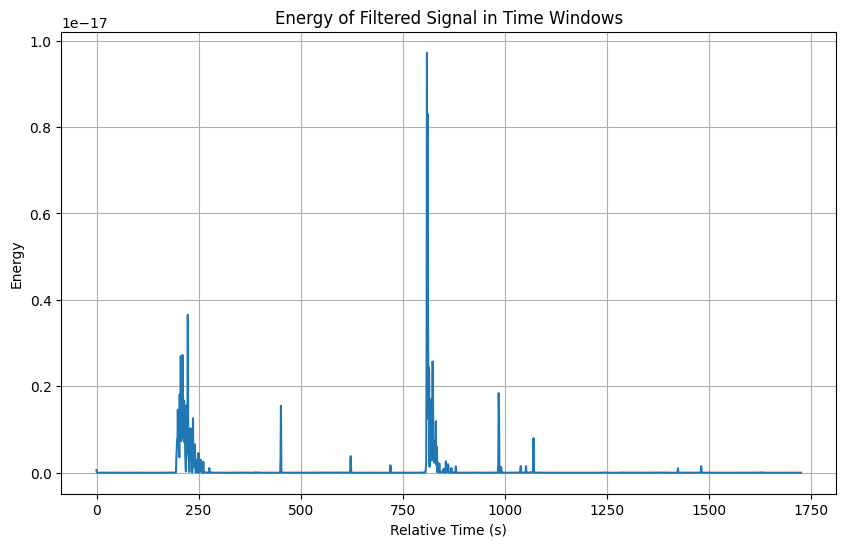

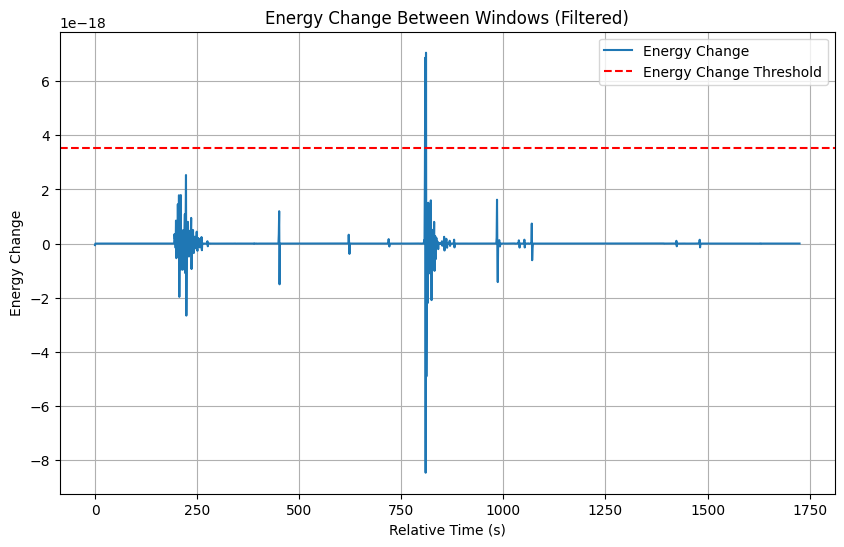

Total signal energy: 1.710553951677852e-16


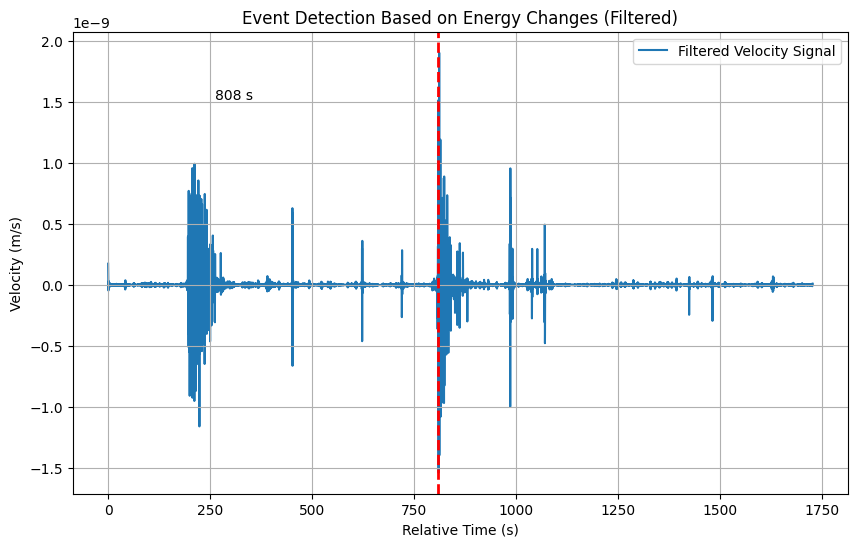

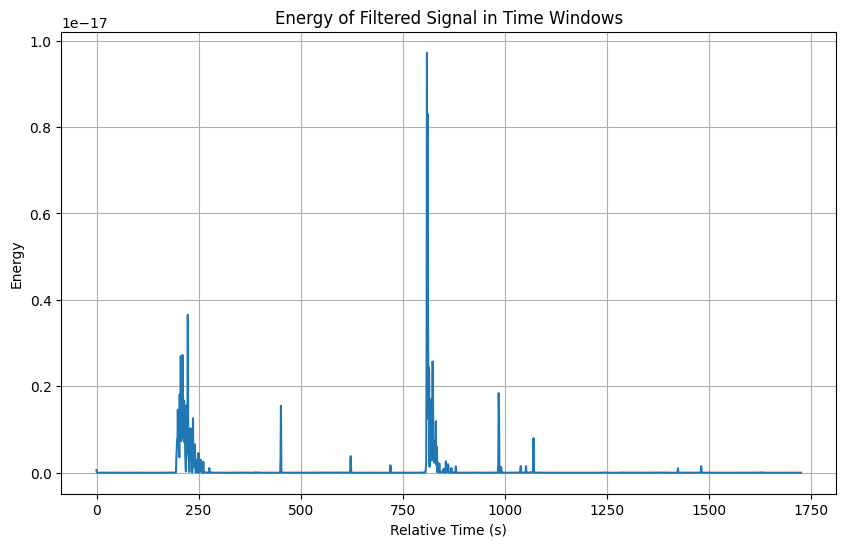

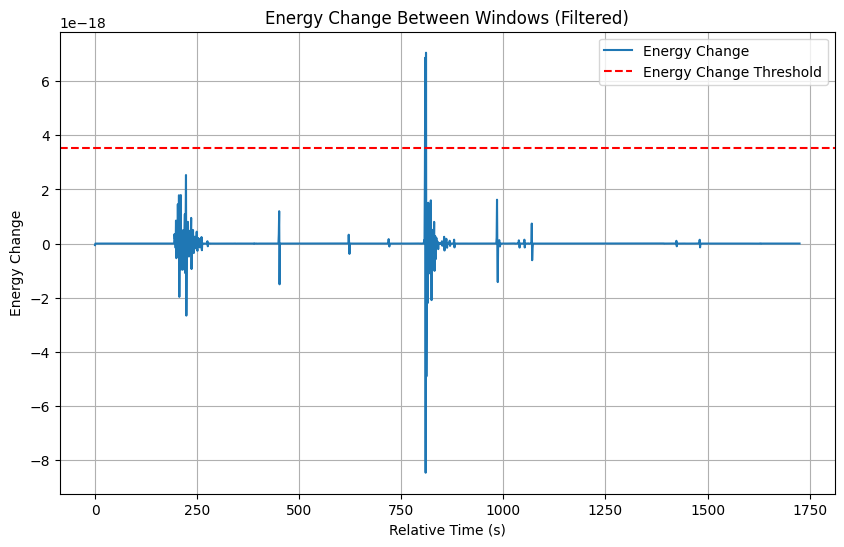

Total signal energy: 1.9965781583482586e-16


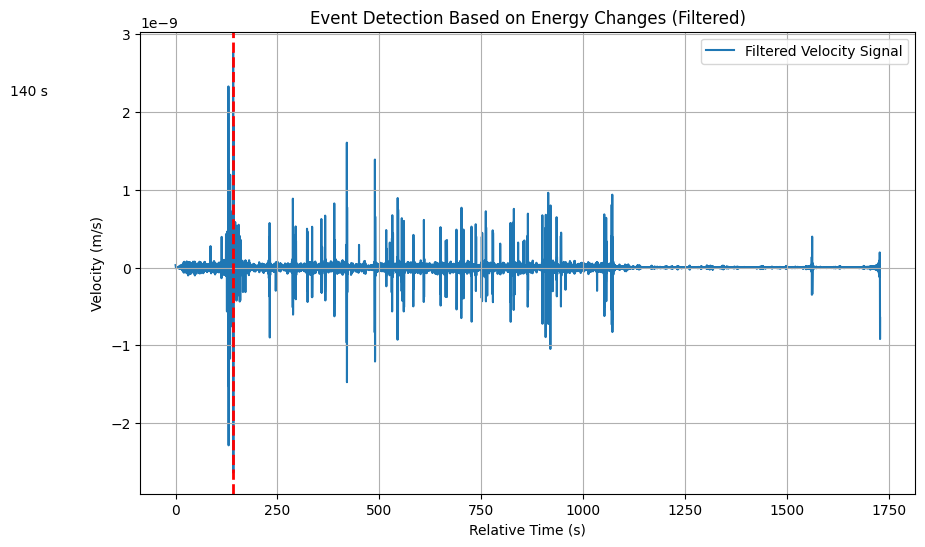

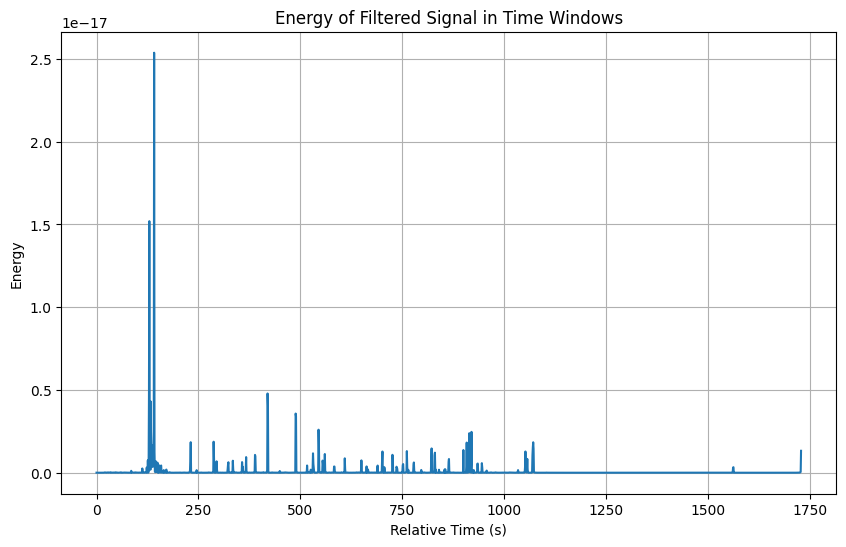

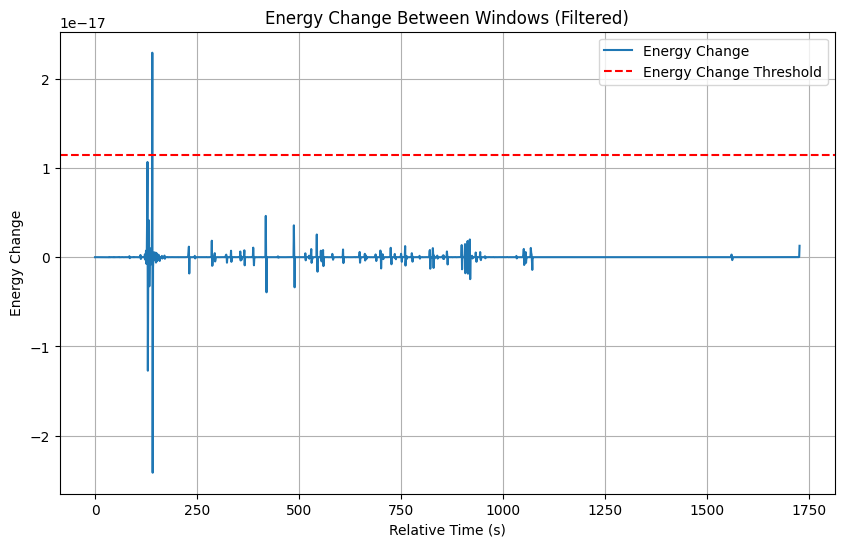

Total signal energy: 1.9866118765423347e-16


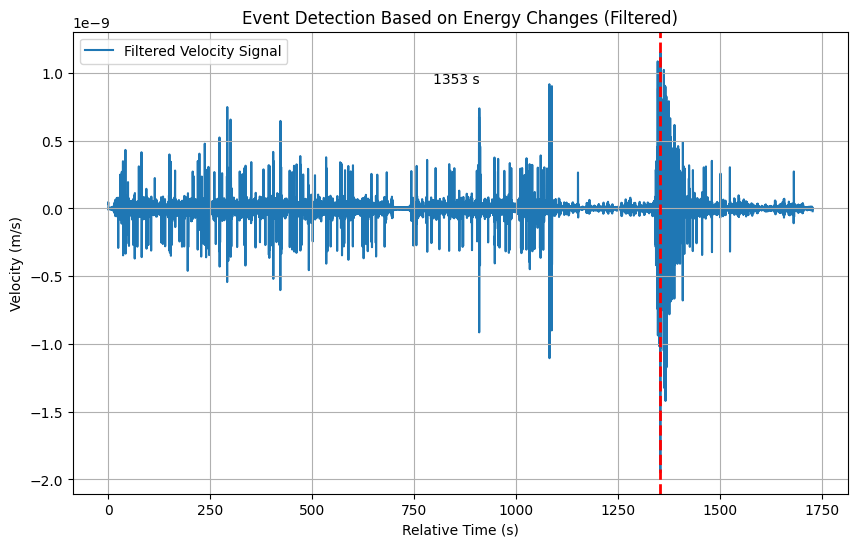

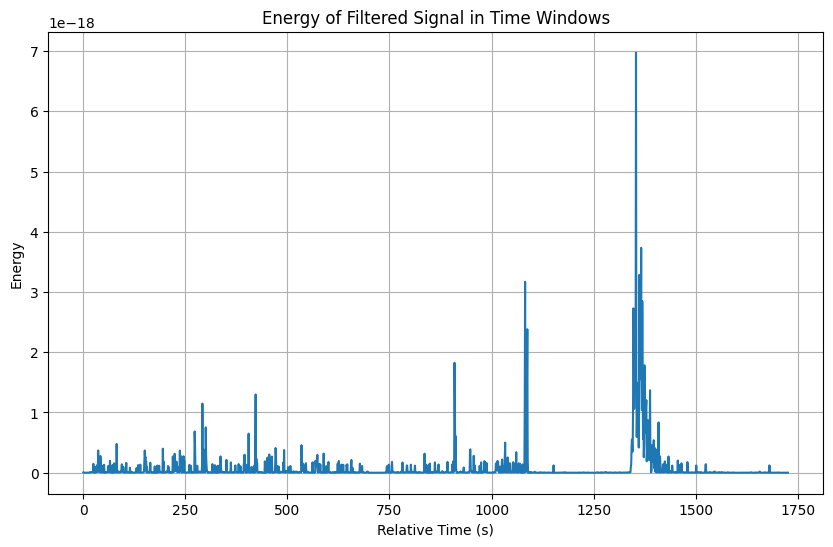

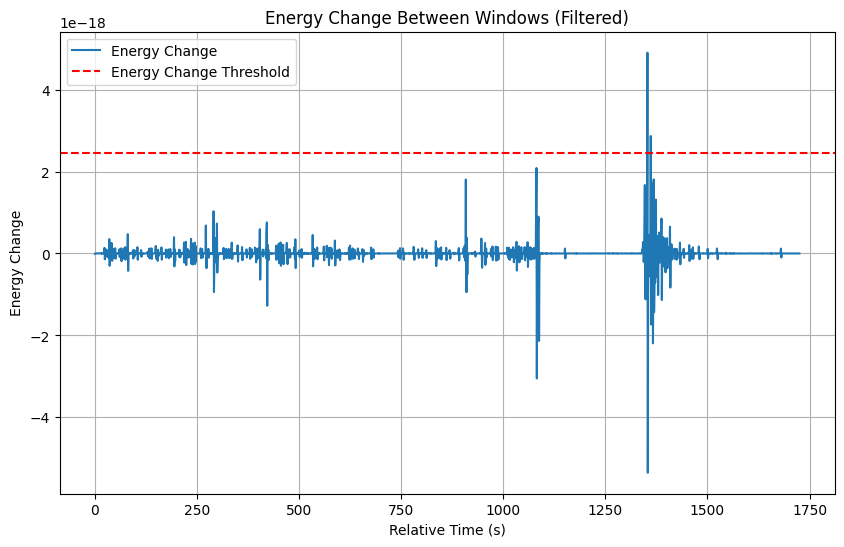

Total signal energy: 2.1977171367812164e-16


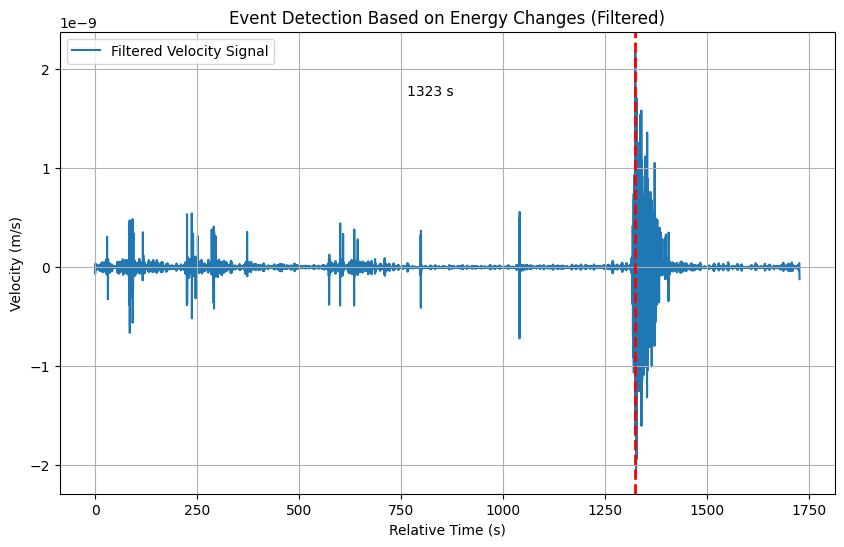

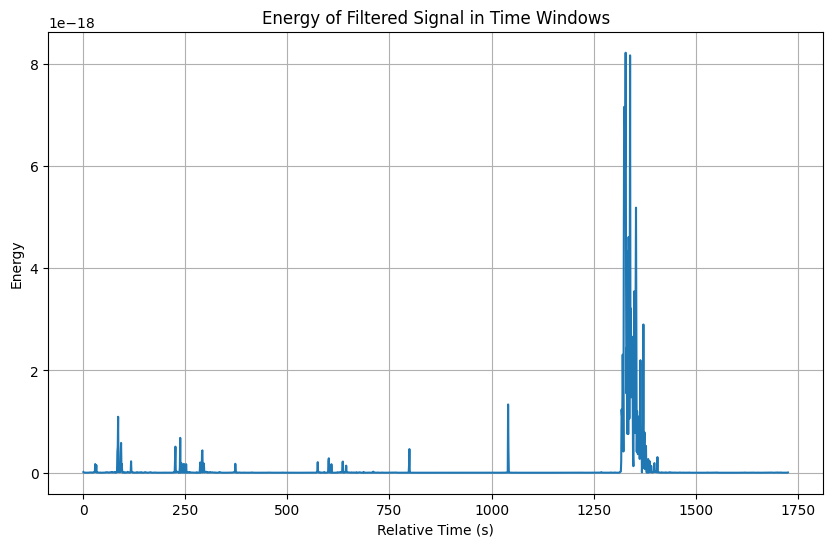

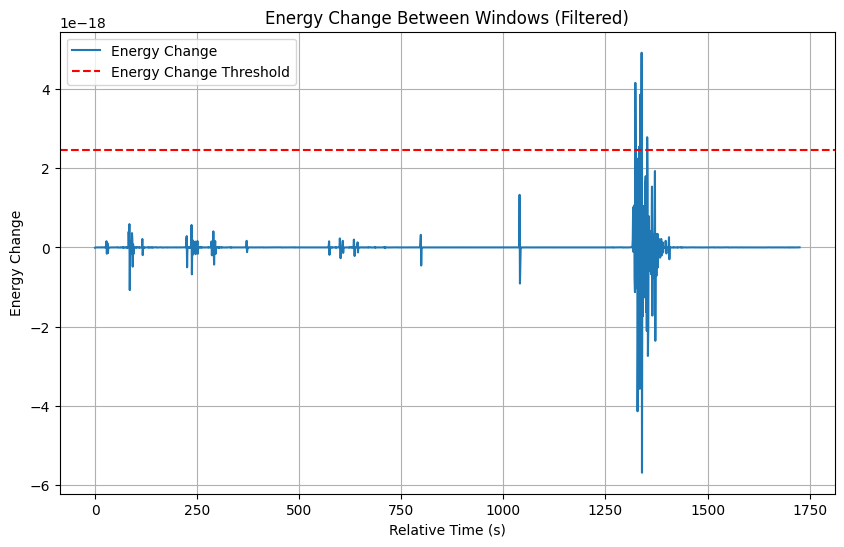

Total signal energy: 1.0834415317451773e-16


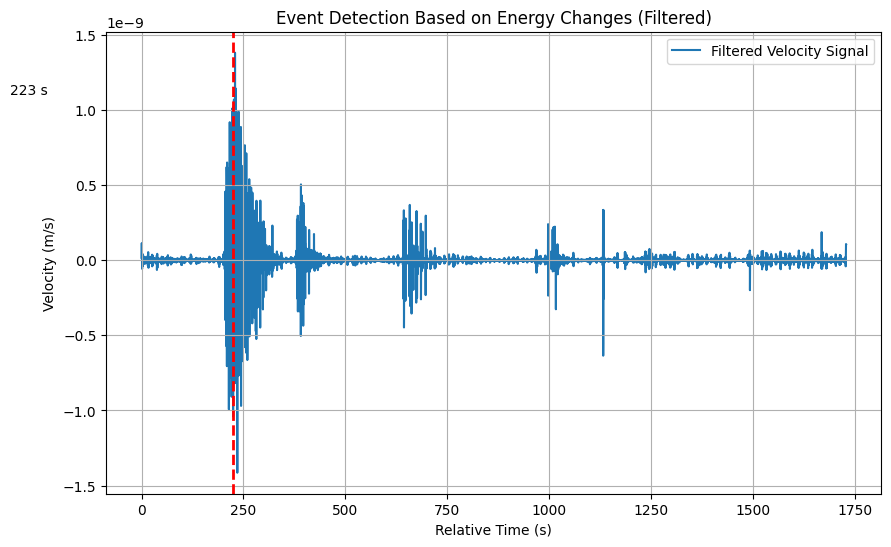

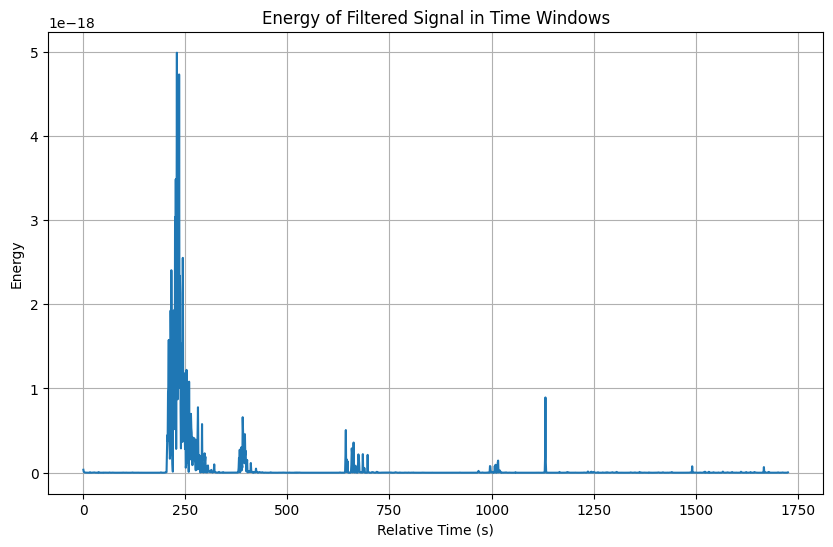

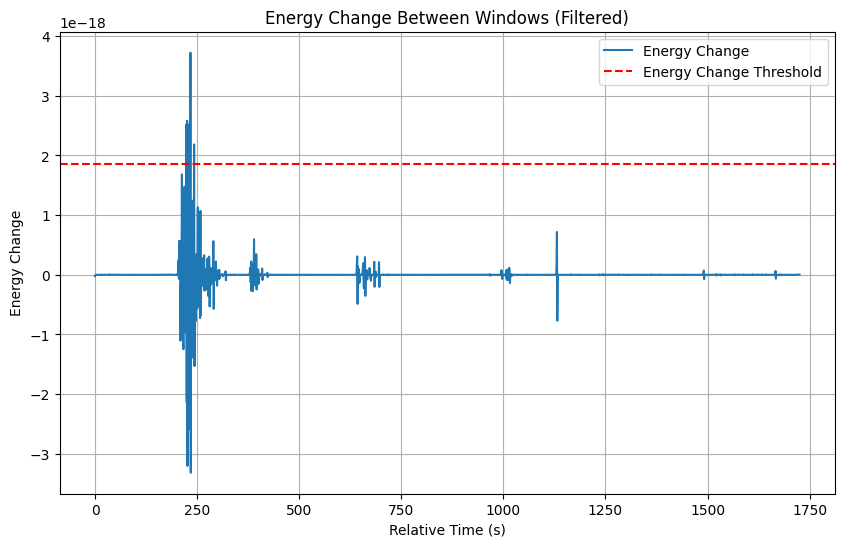

Total signal energy: 1.5272121531933146e-16


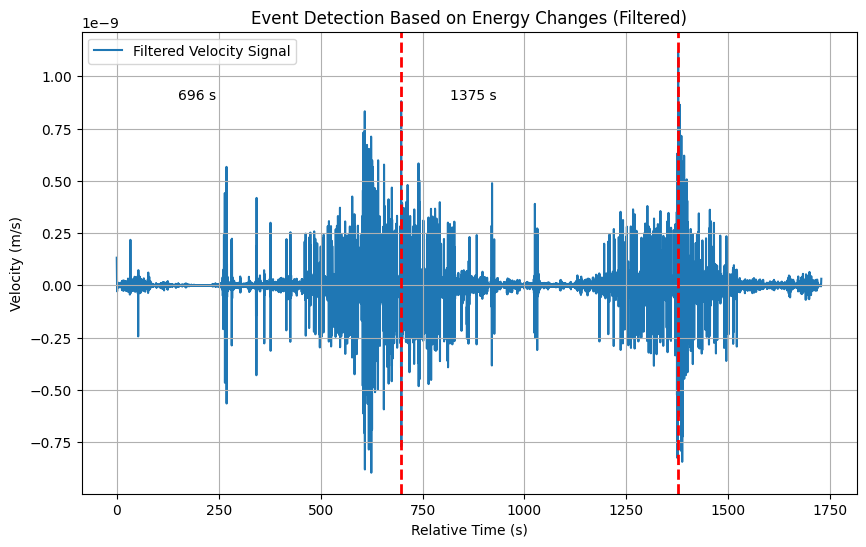

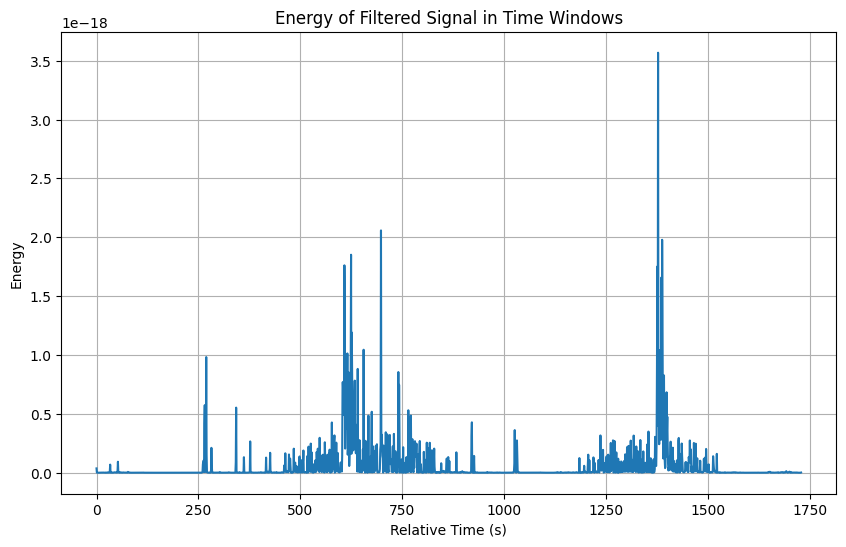

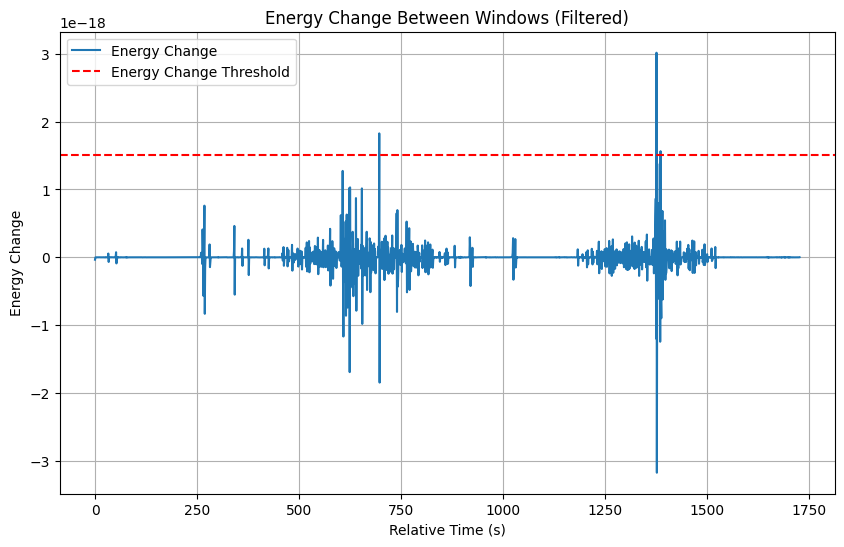

Total signal energy: 1.780368638131543e-15


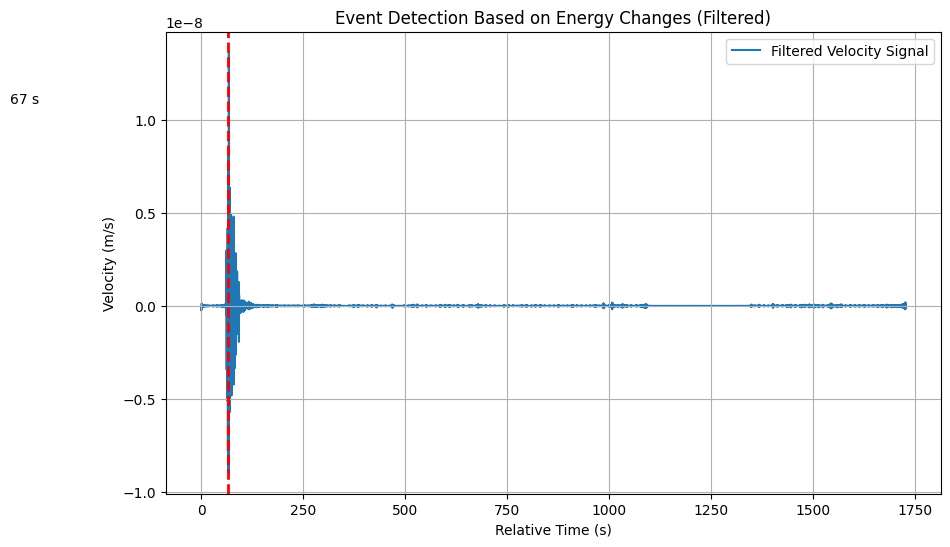

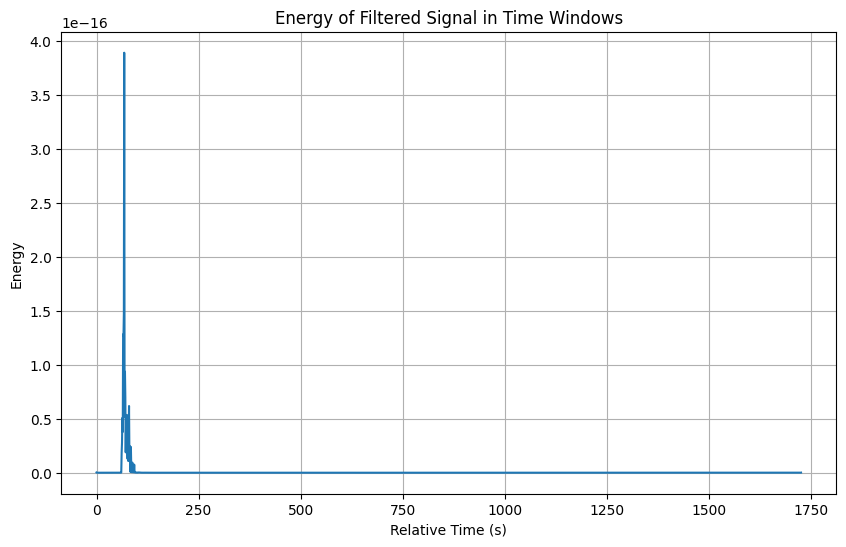

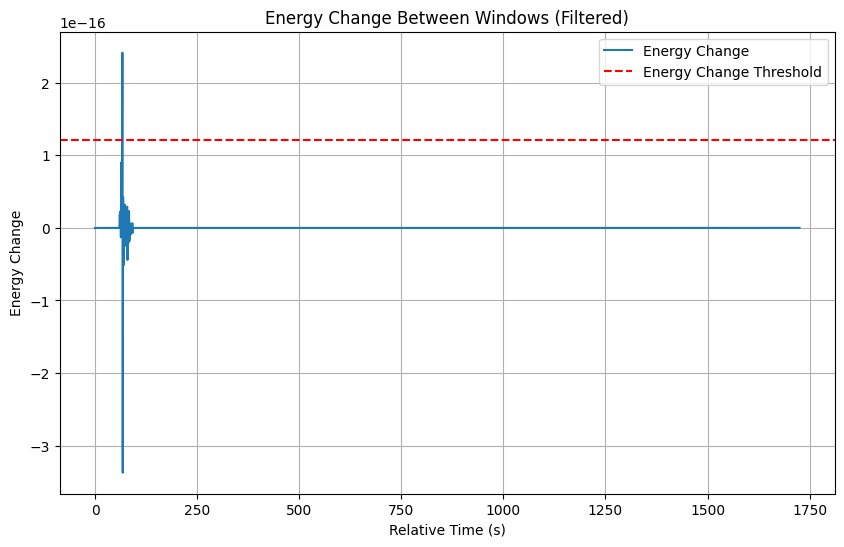

Total signal energy: 3.723366381605086e-17


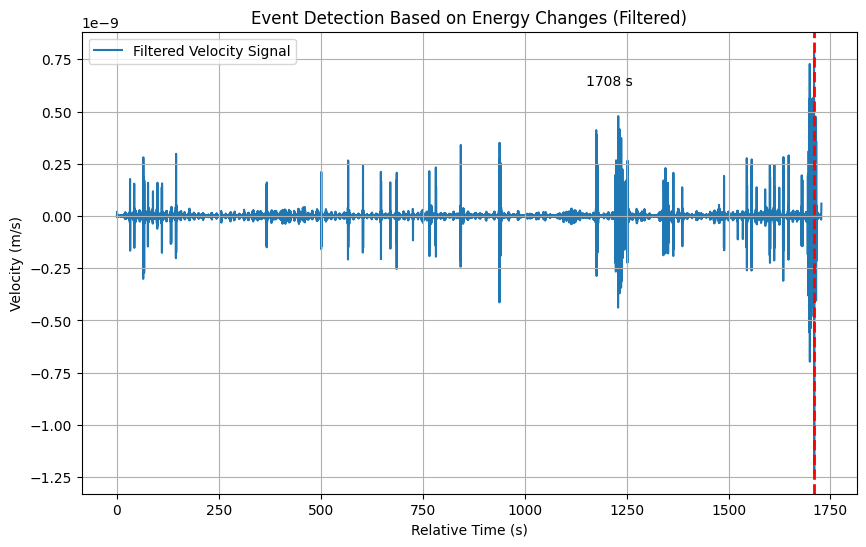

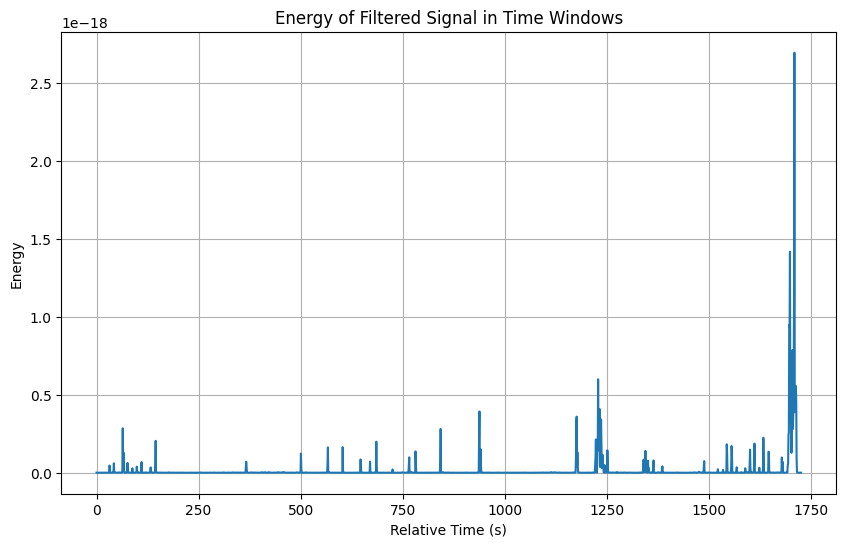

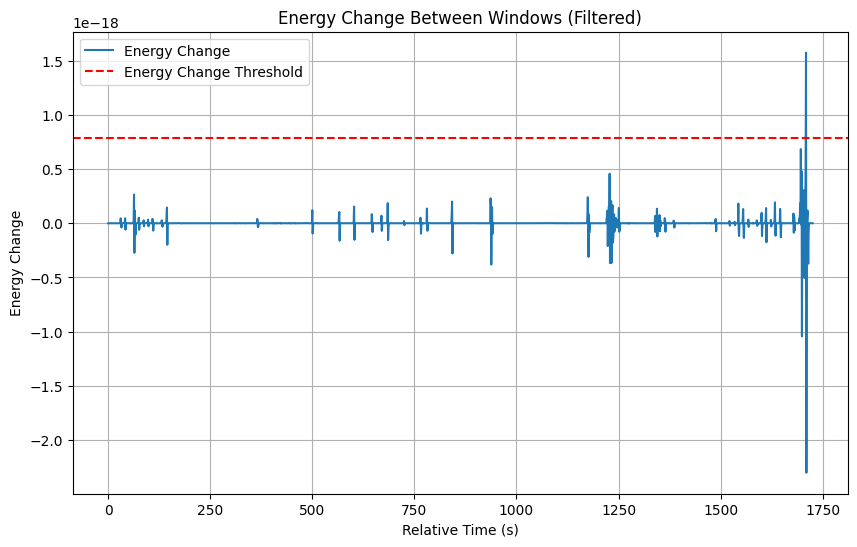

Total signal energy: 4.911159884813486e-16


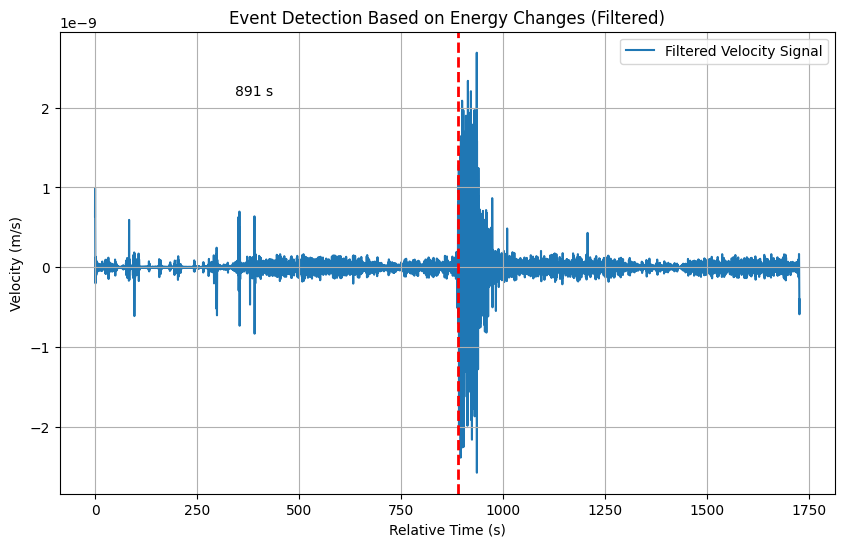

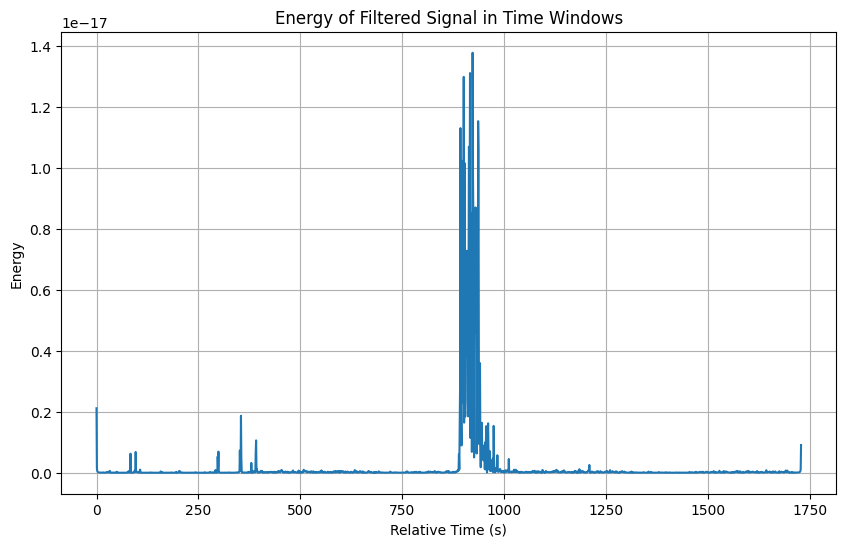

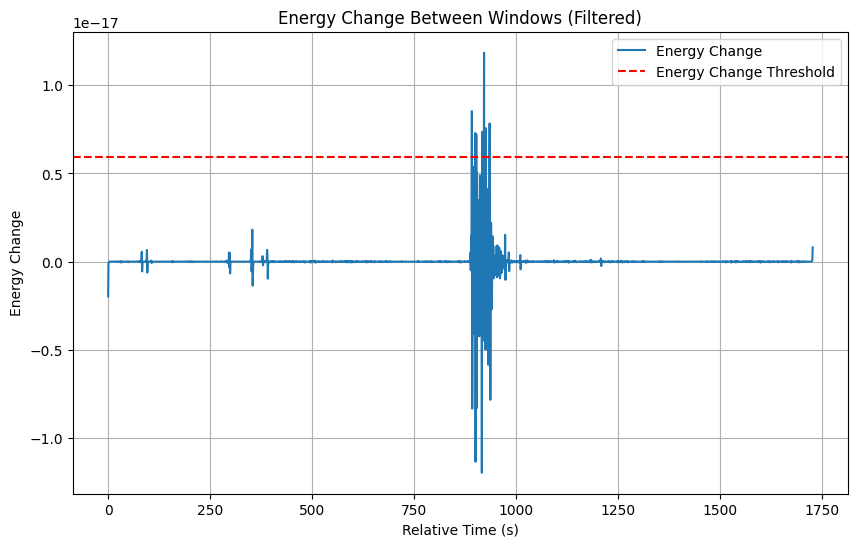

Total signal energy: 1.4970880388859896e-16


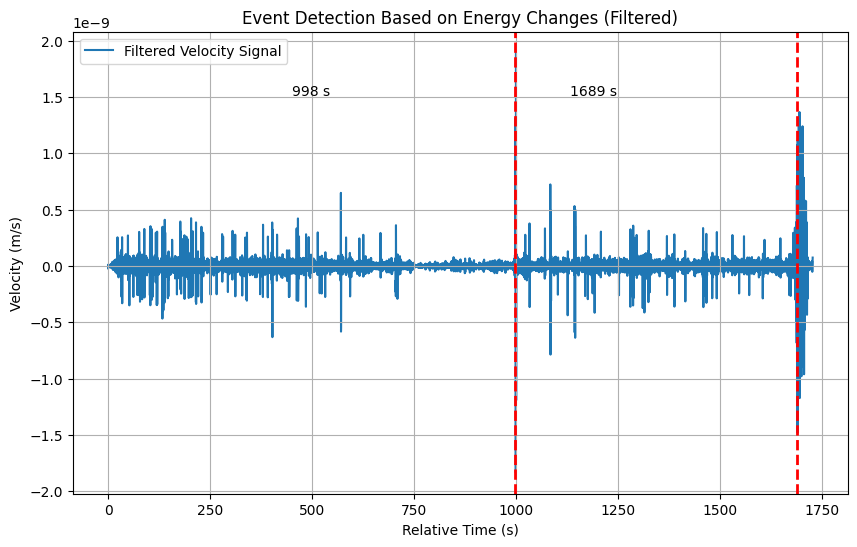

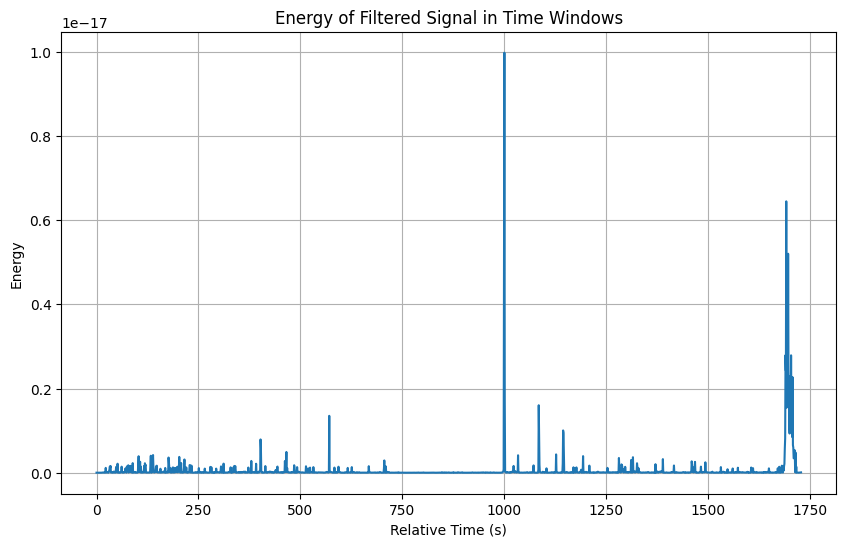

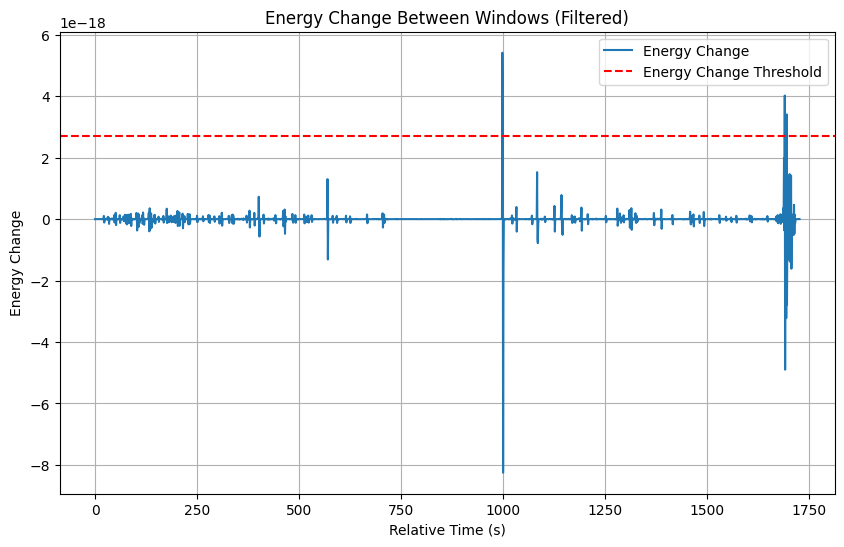

Total signal energy: 6.284046410127376e-16


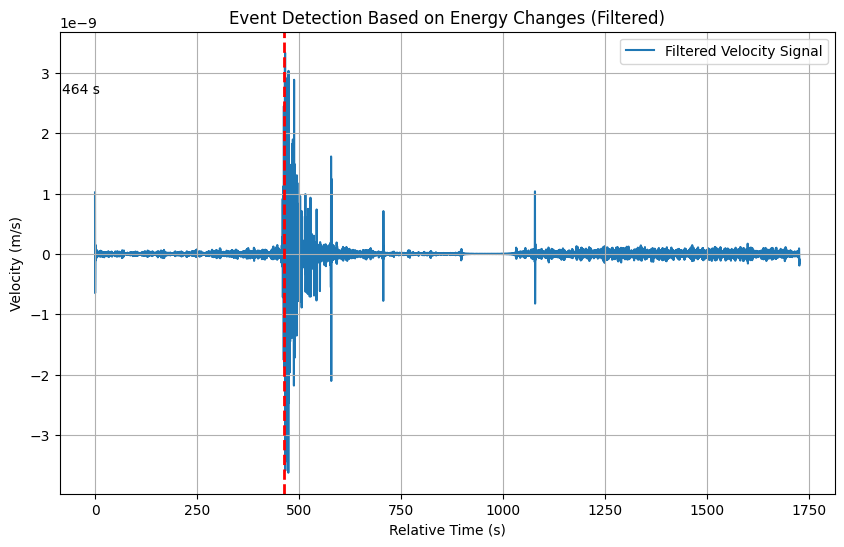

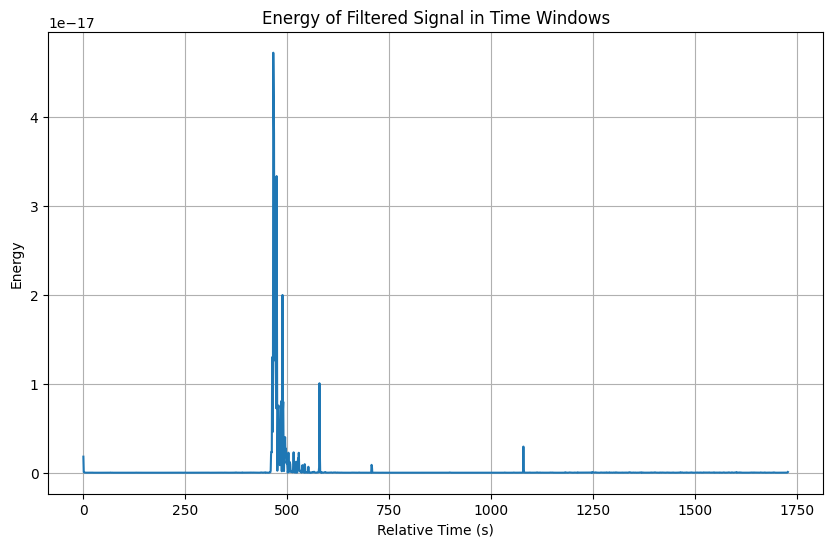

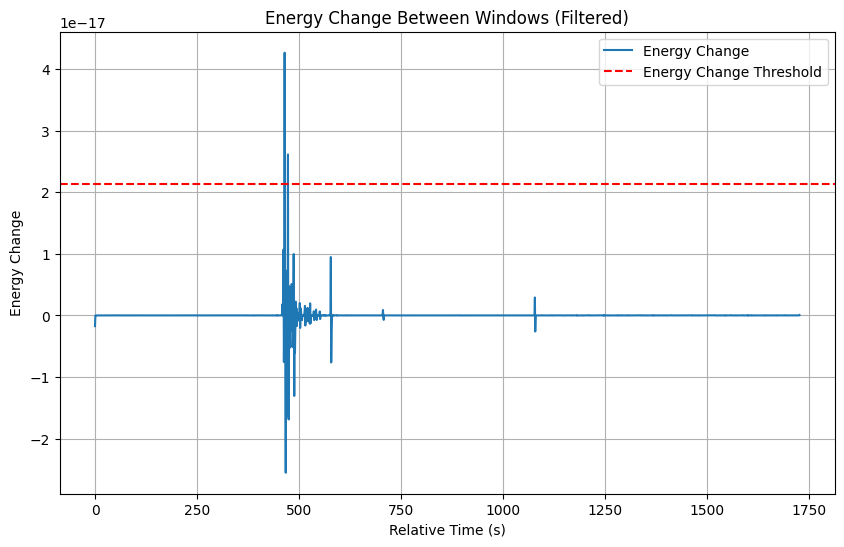

Total signal energy: 2.5753688136266055e-15


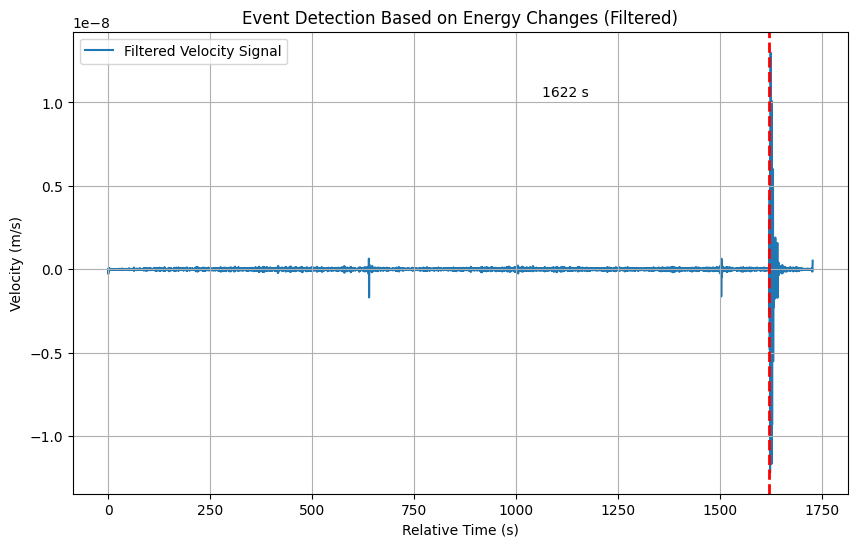

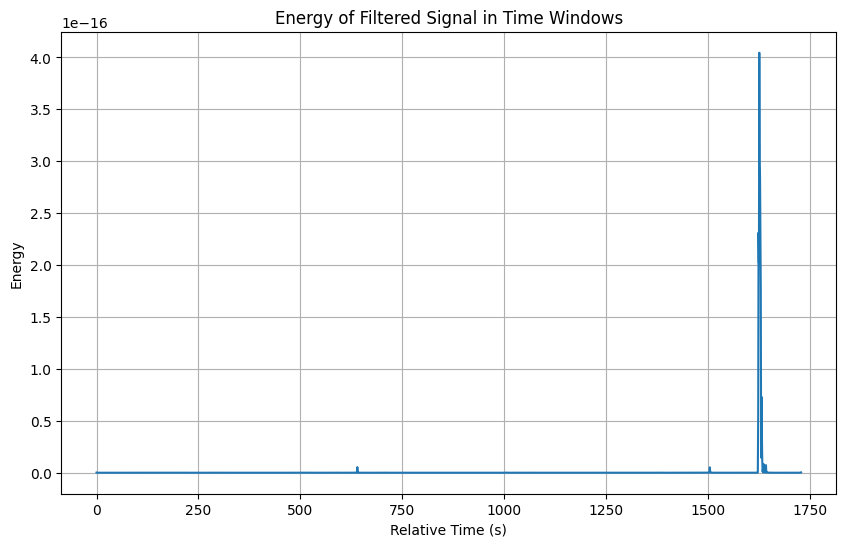

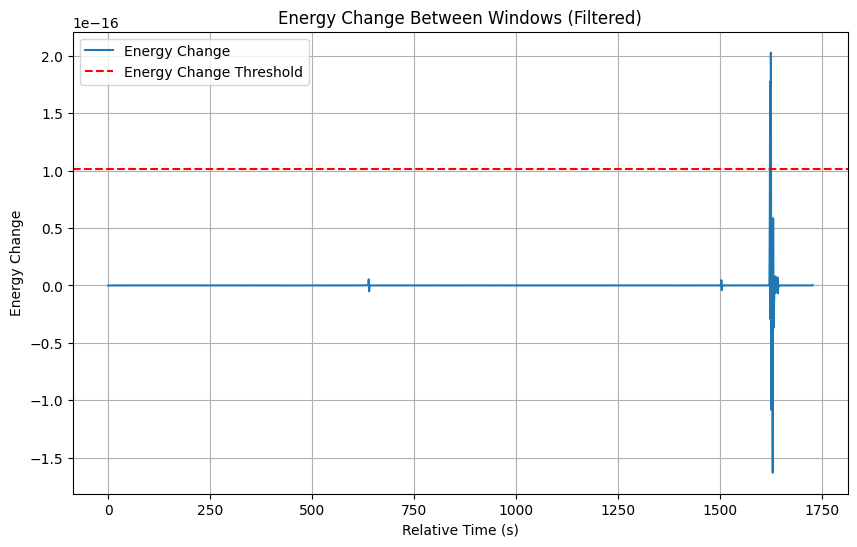

Total signal energy: 1.1231107823534197e-16


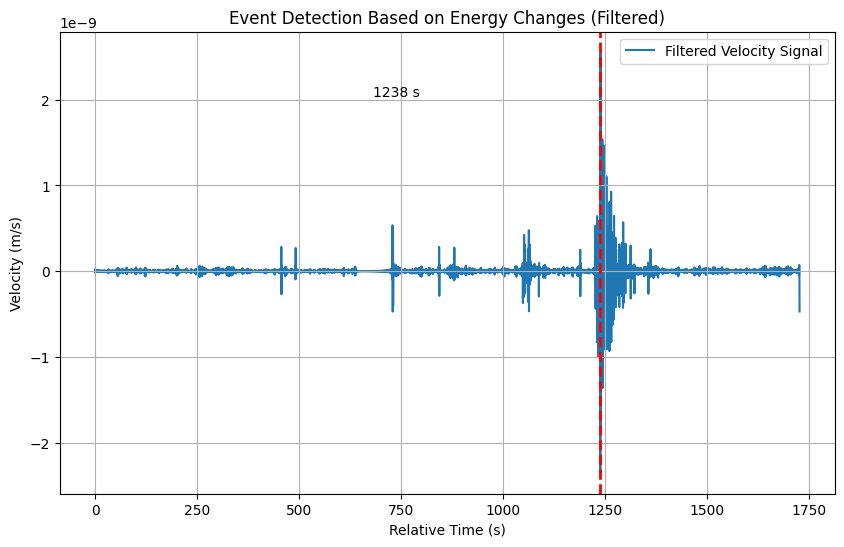

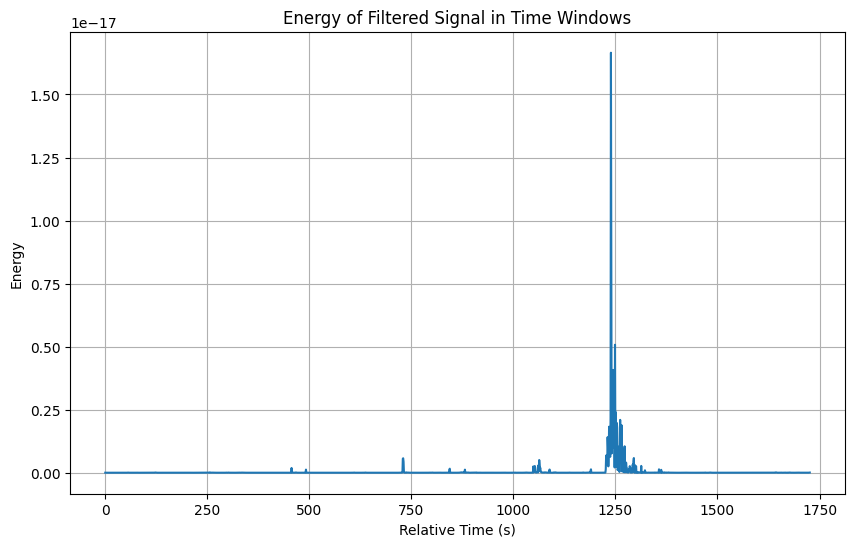

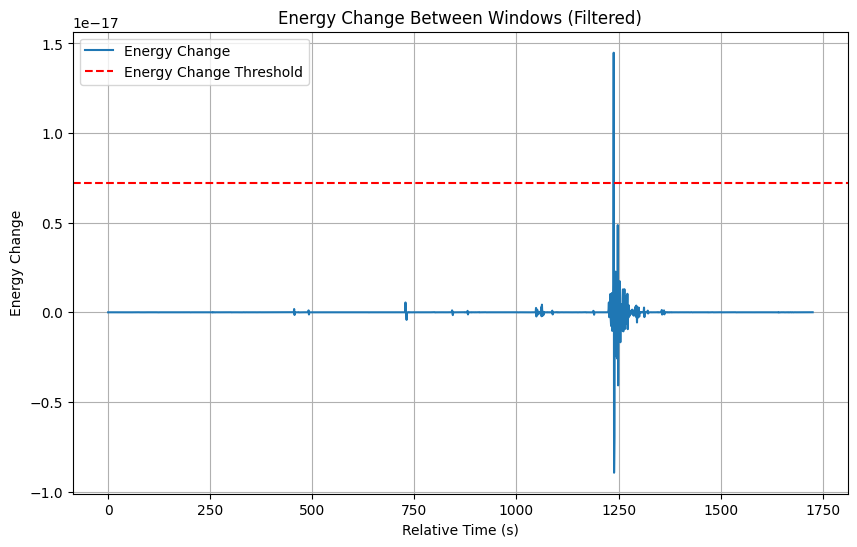

Total signal energy: 8.712107010285116e-16


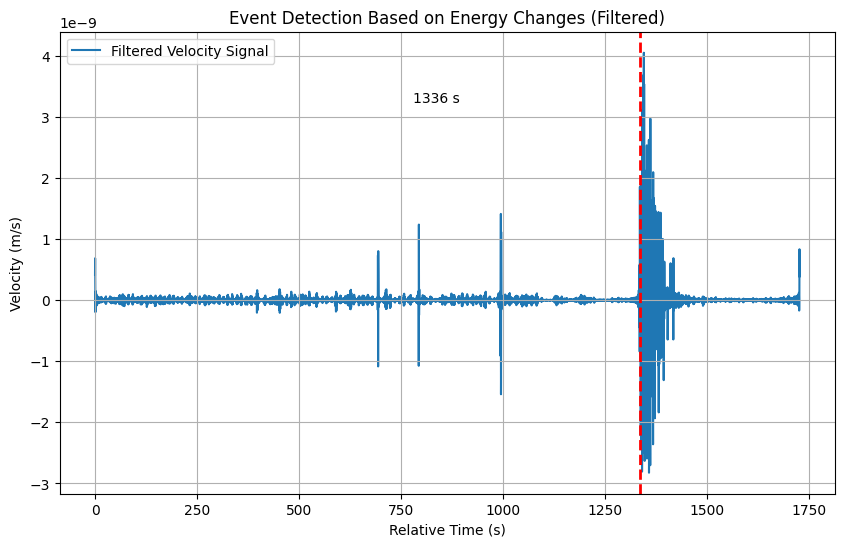

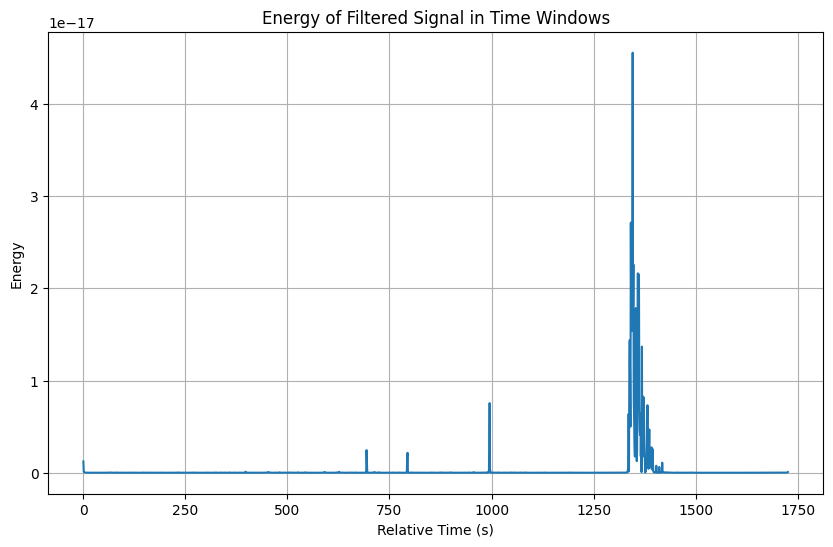

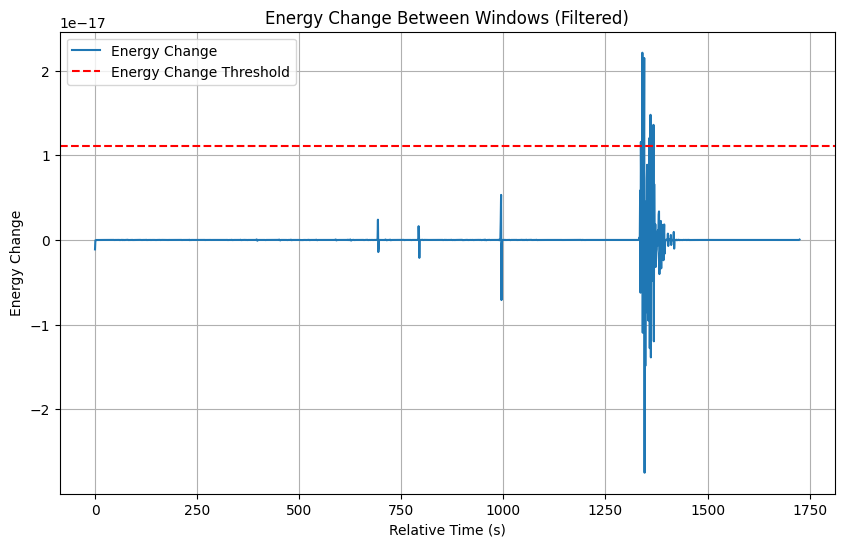

Total signal energy: 1.9614678720837494e-16


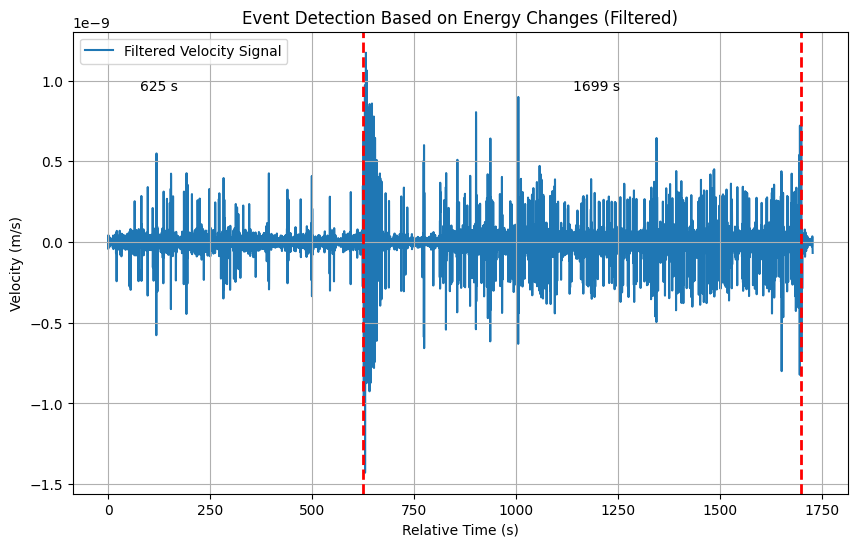

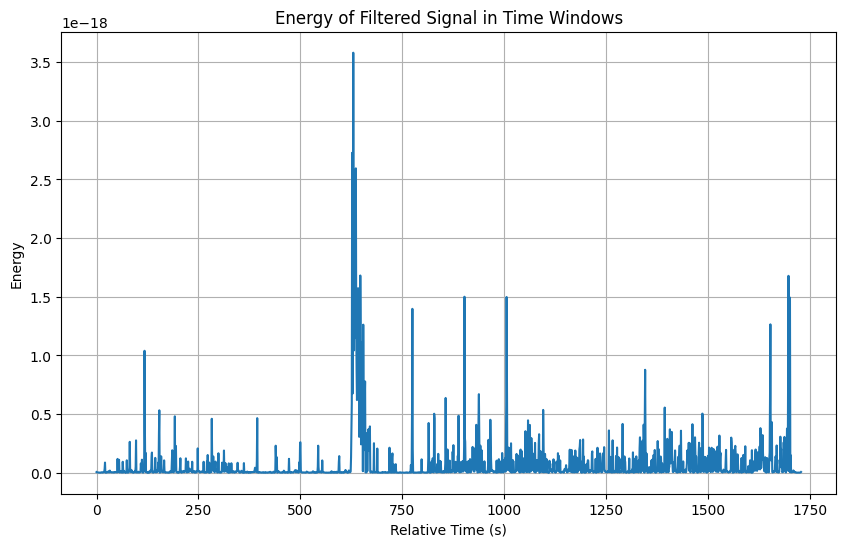

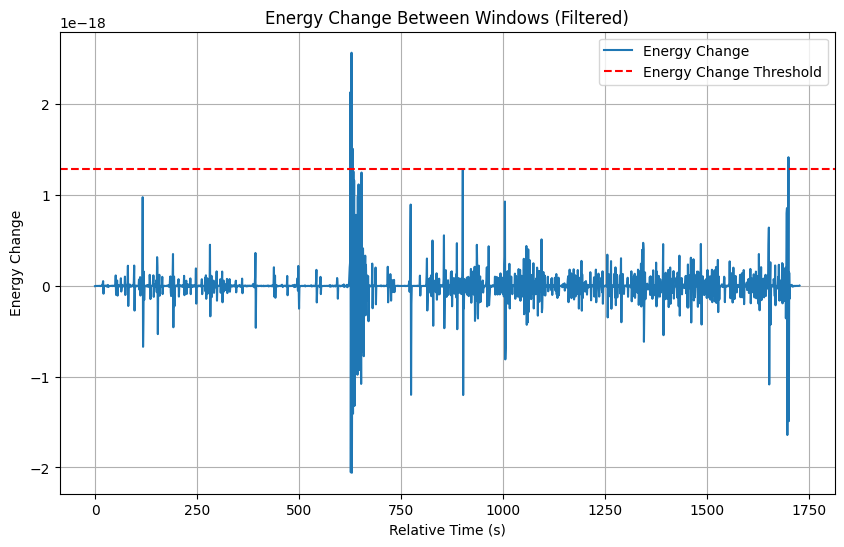

Total signal energy: 2.33157435073449e-16


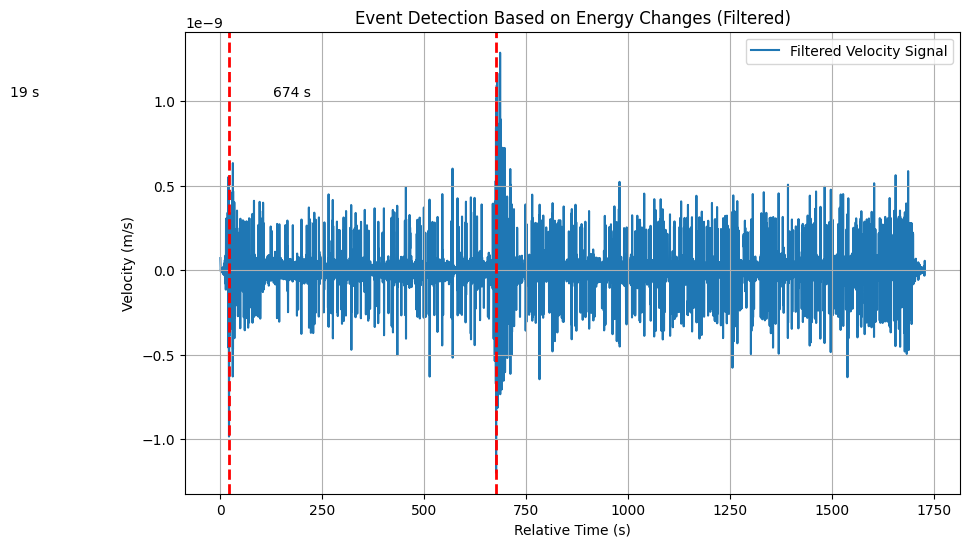

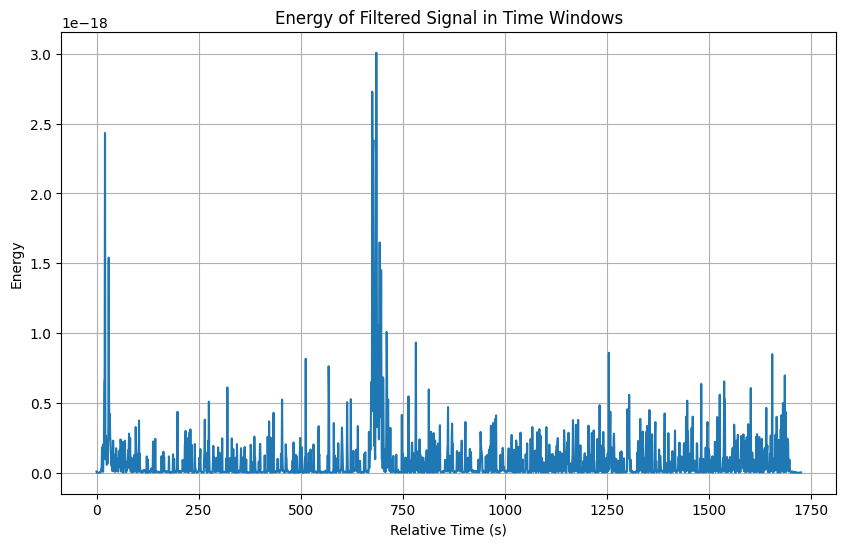

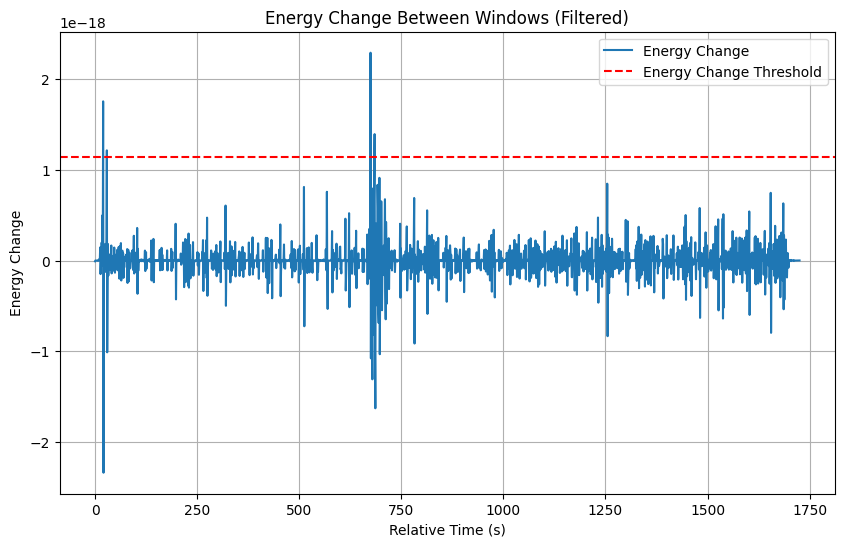

Total signal energy: 2.6647911720243797e-16


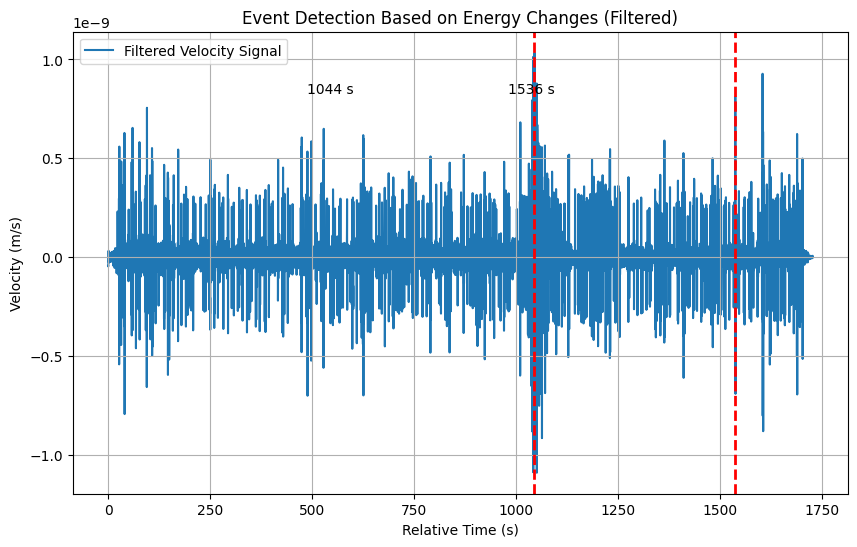

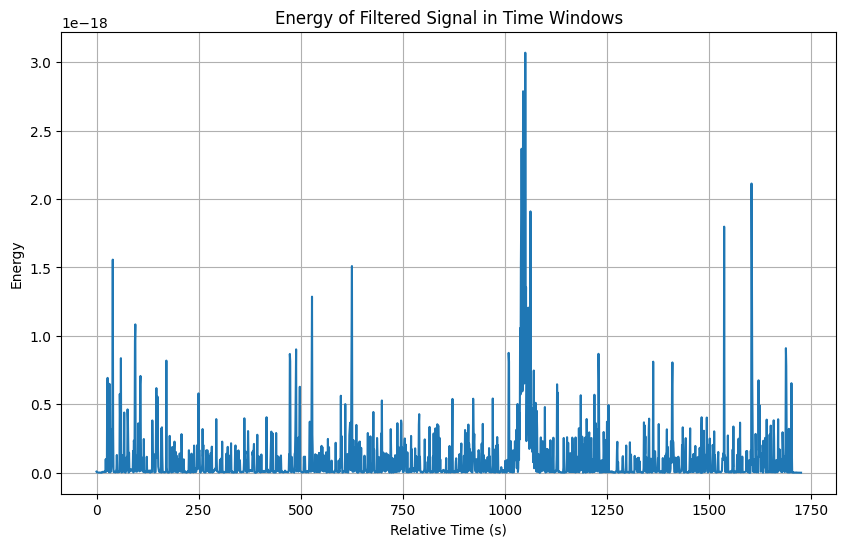

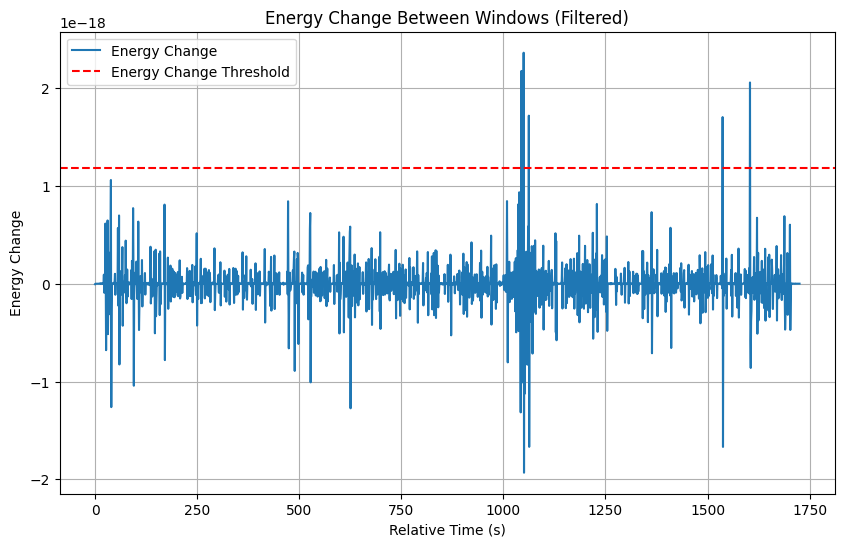

Total signal energy: 2.154382369054111e-16


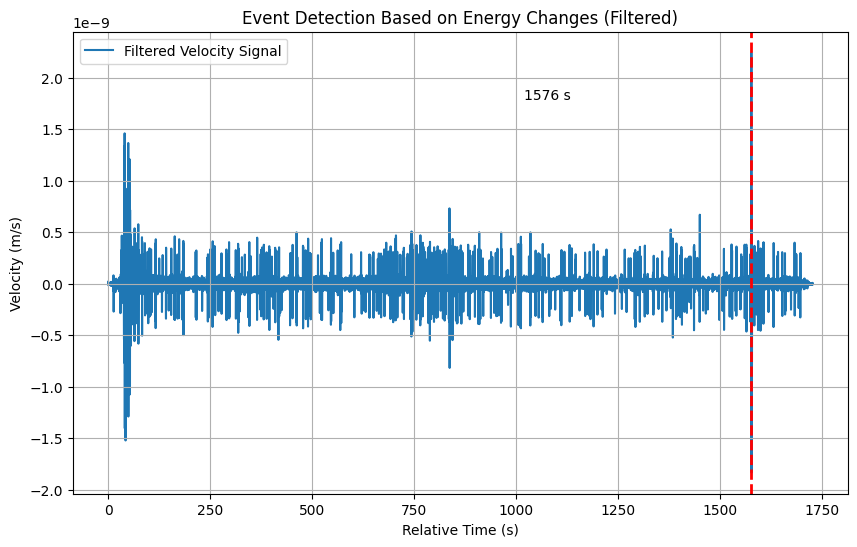

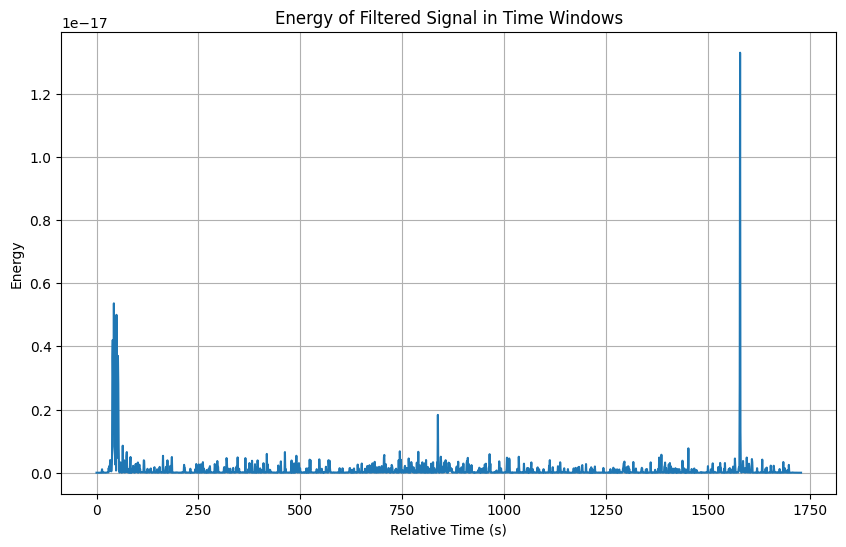

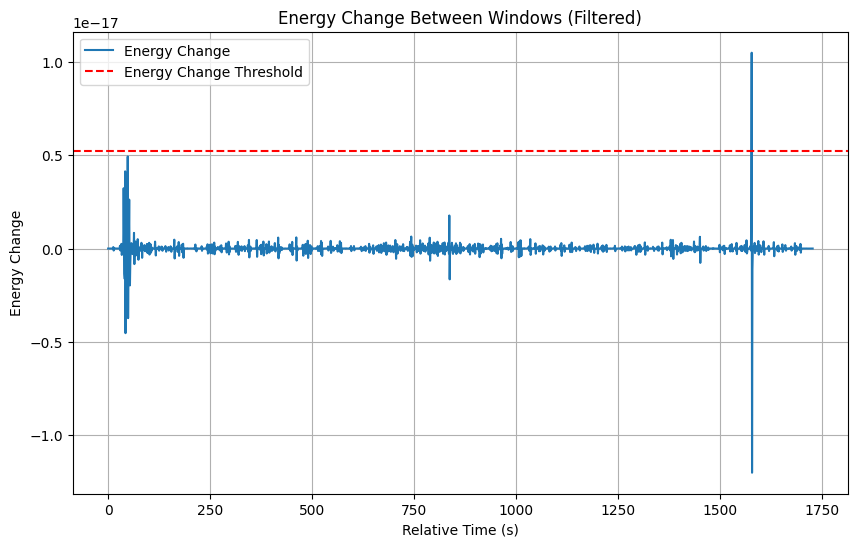

Total signal energy: 3.276675339424192e-16


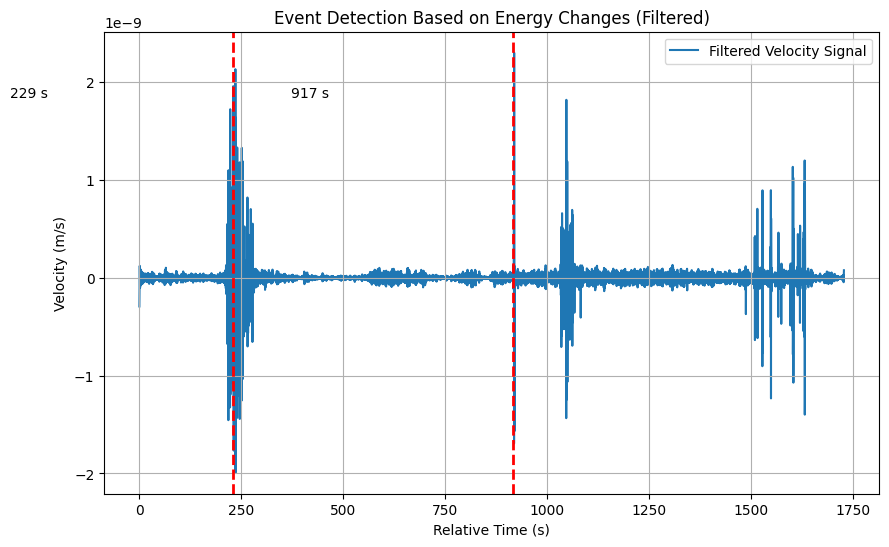

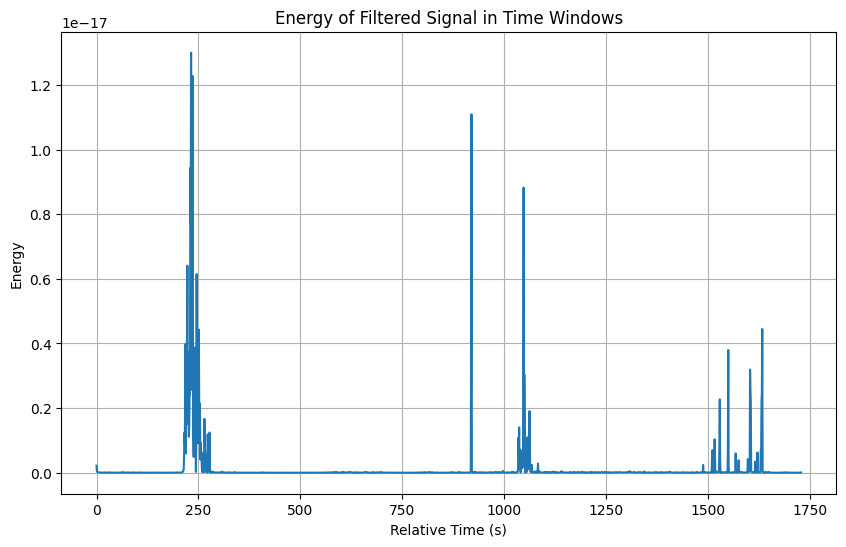

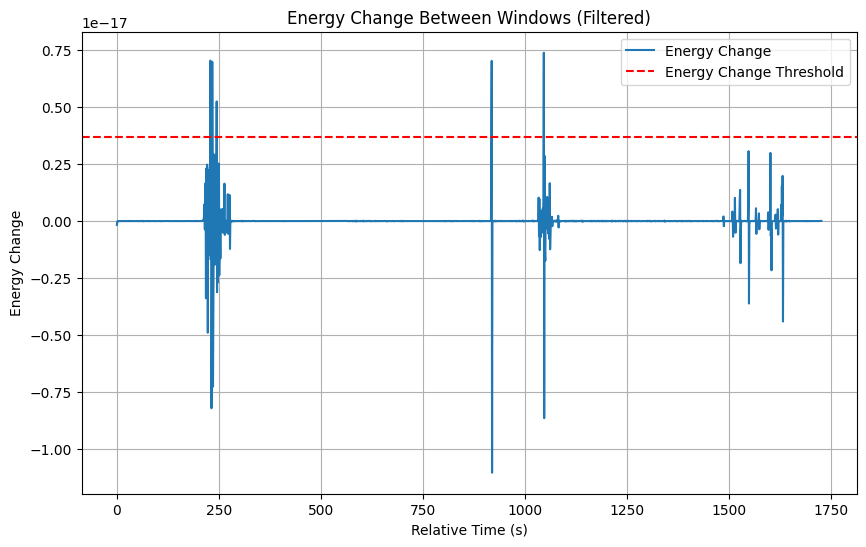

Total signal energy: 3.276675339424192e-16


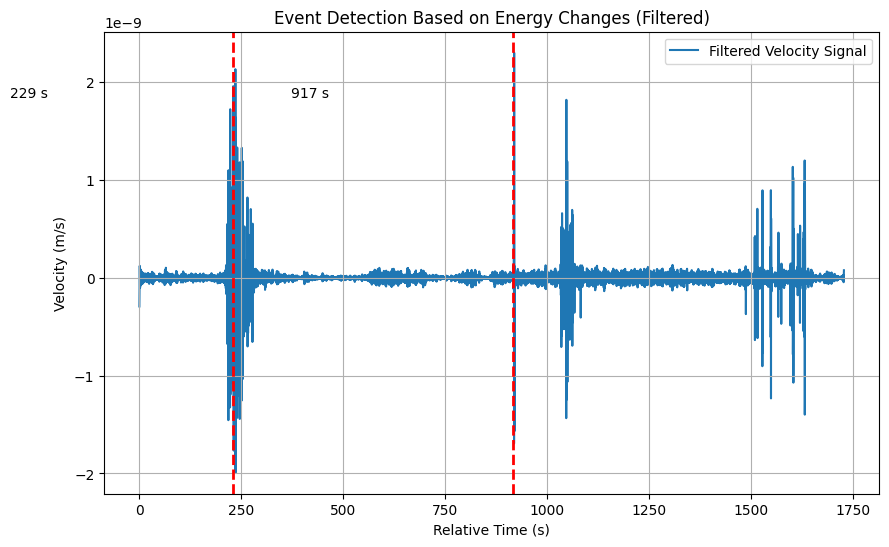

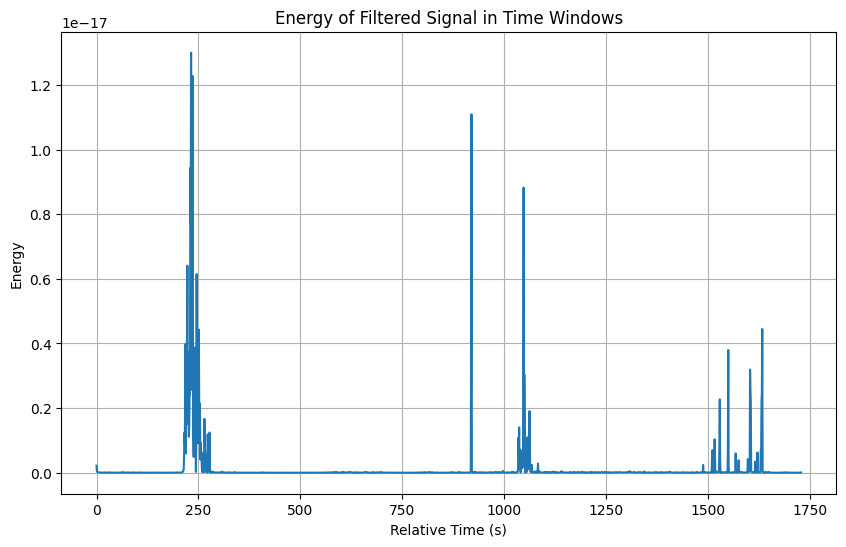

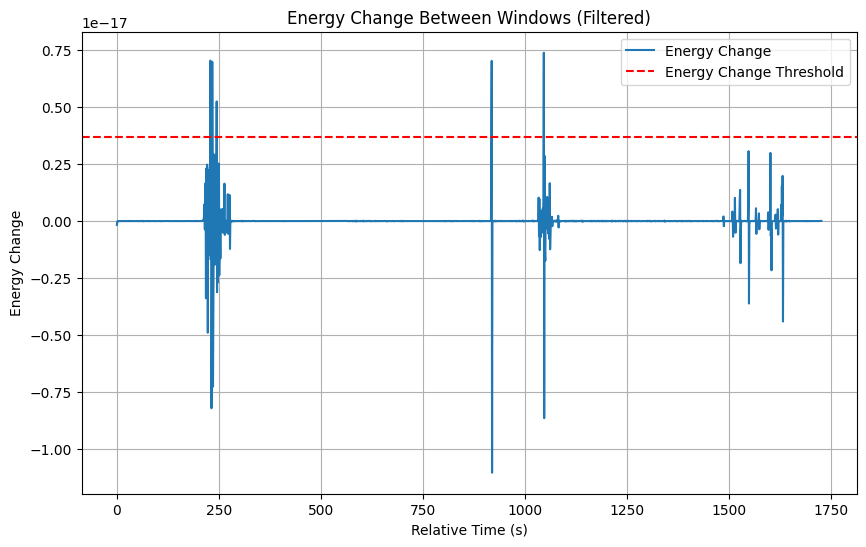

Total signal energy: 6.072564200697506e-16


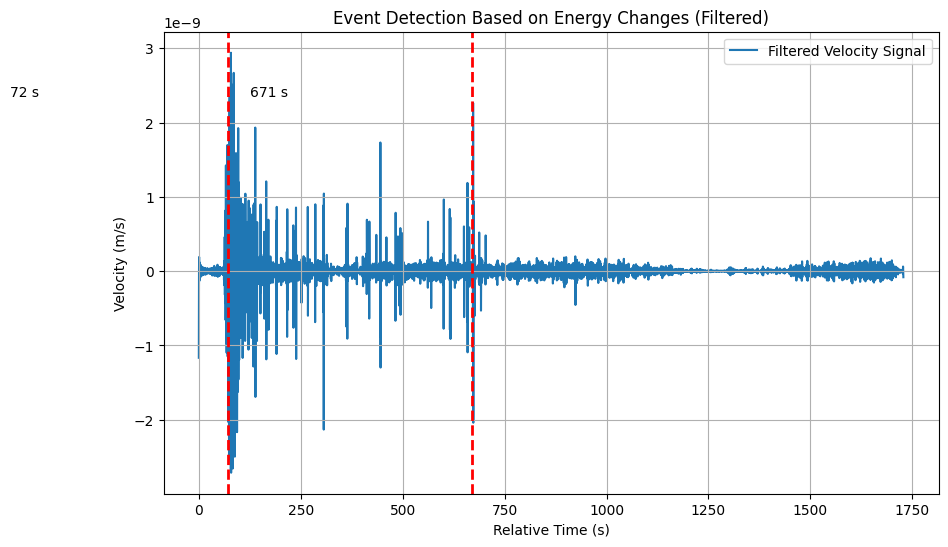

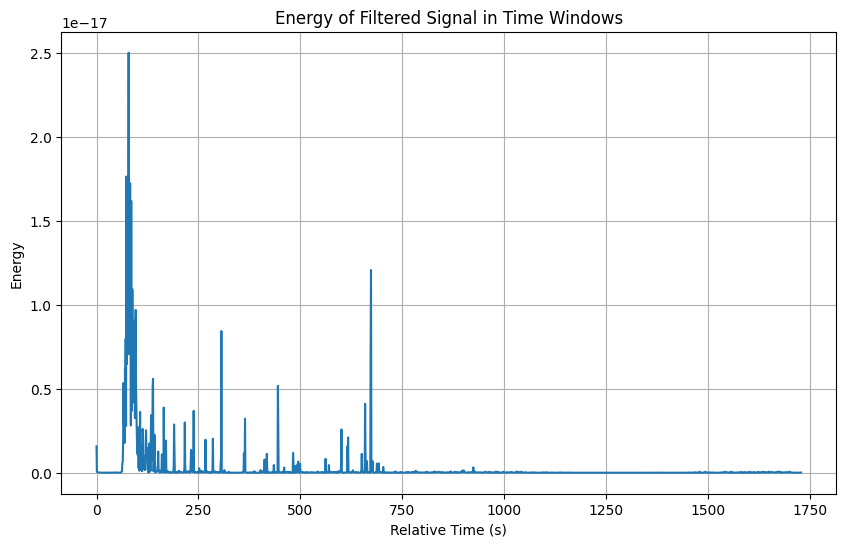

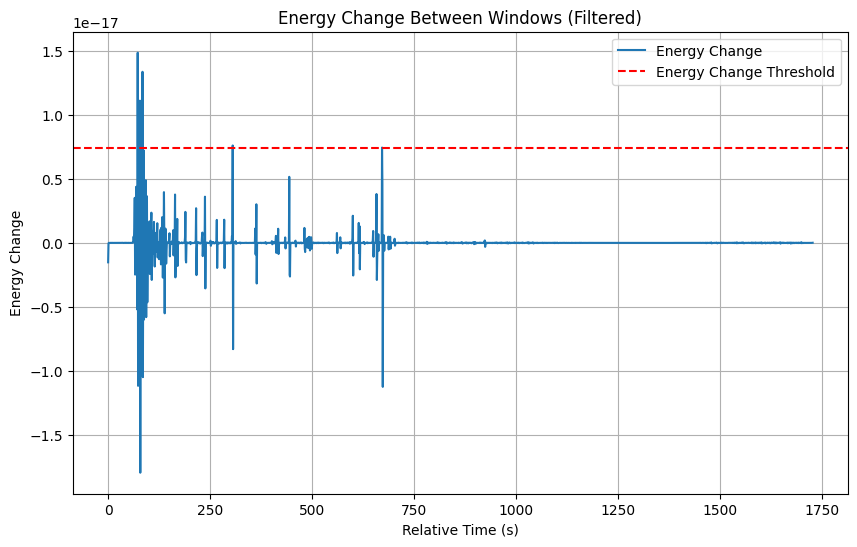

Total signal energy: 3.2483309731290584e-16


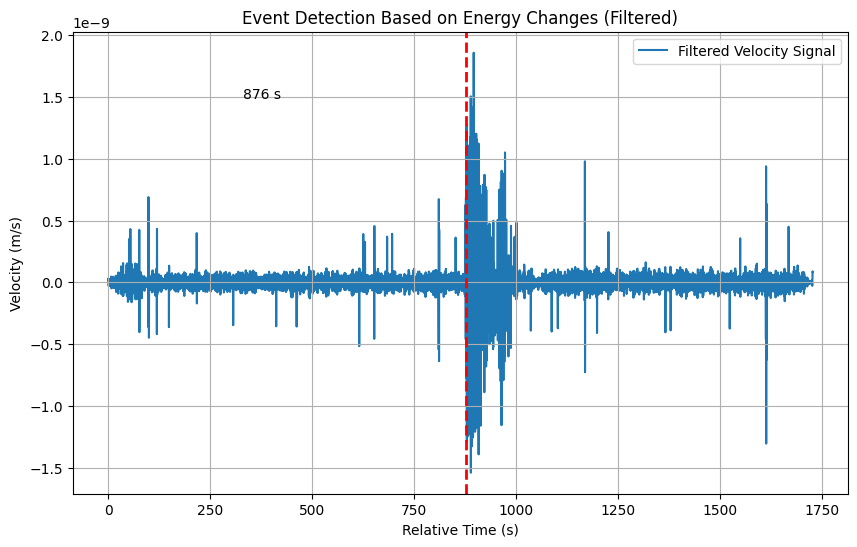

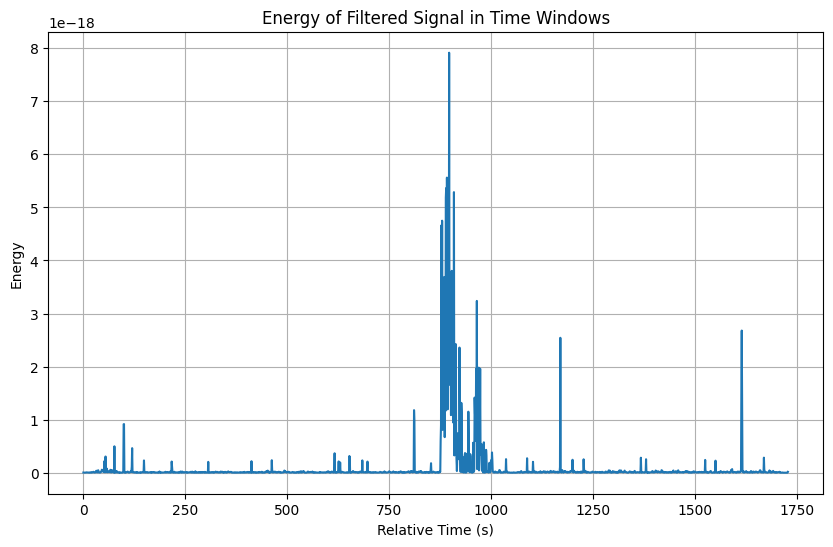

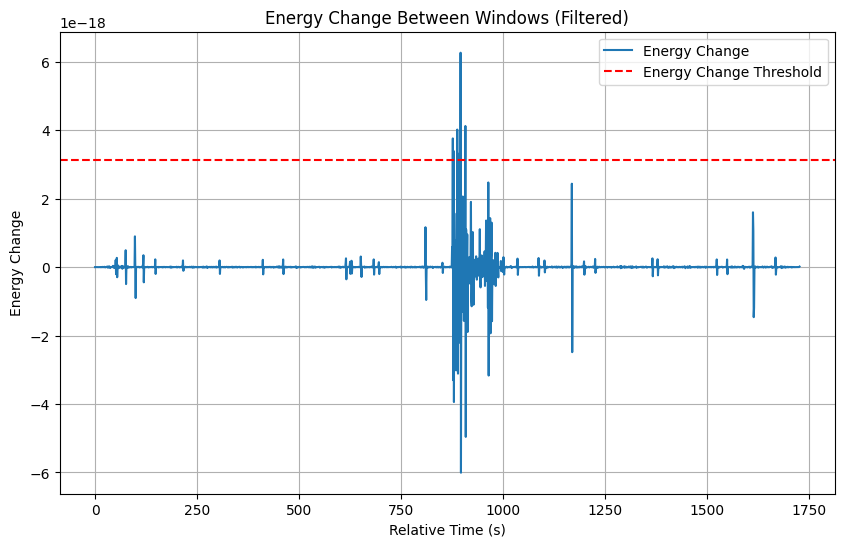

Total signal energy: 4.595520331123447e-16


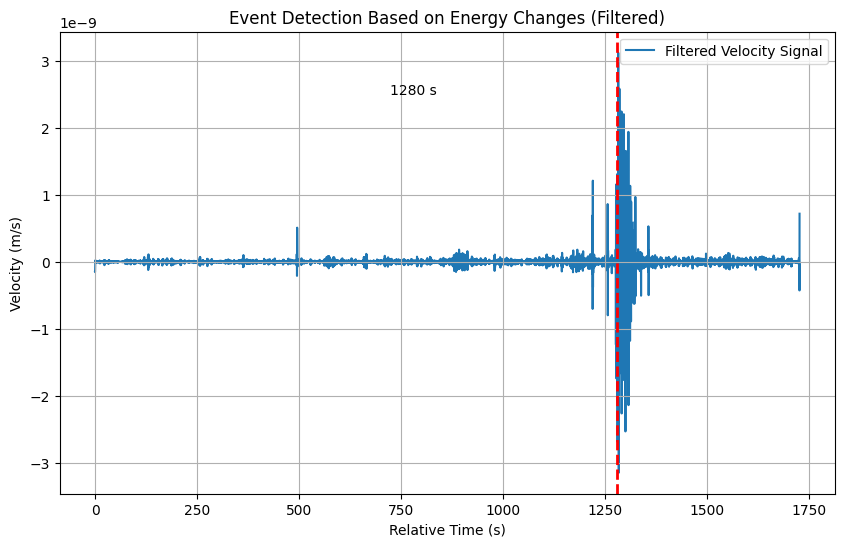

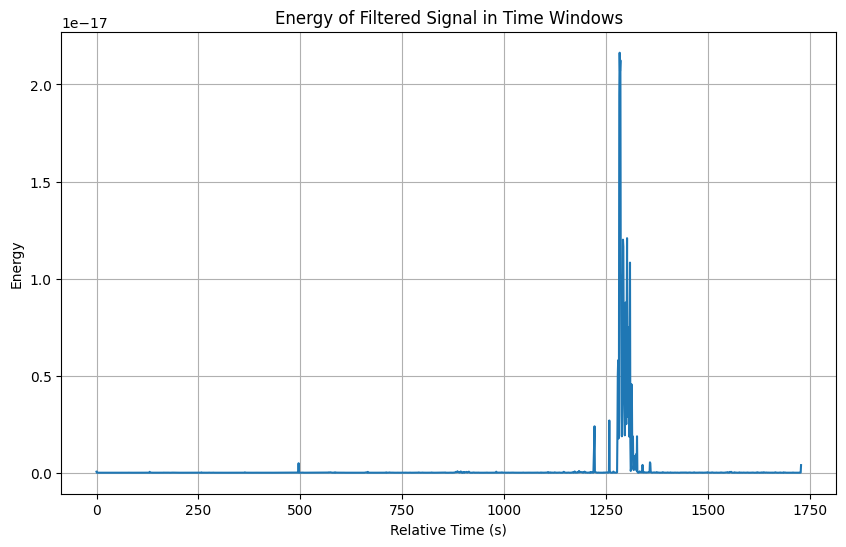

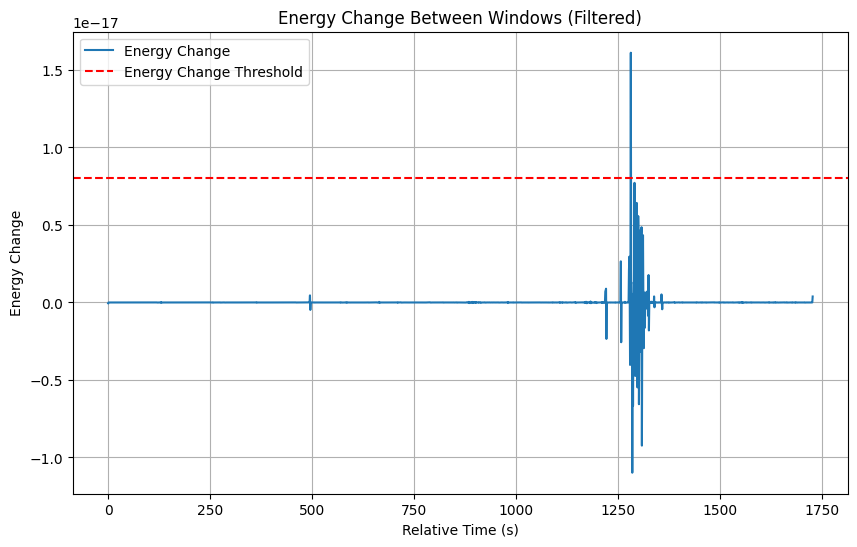

Total signal energy: 3.429688589458535e-14


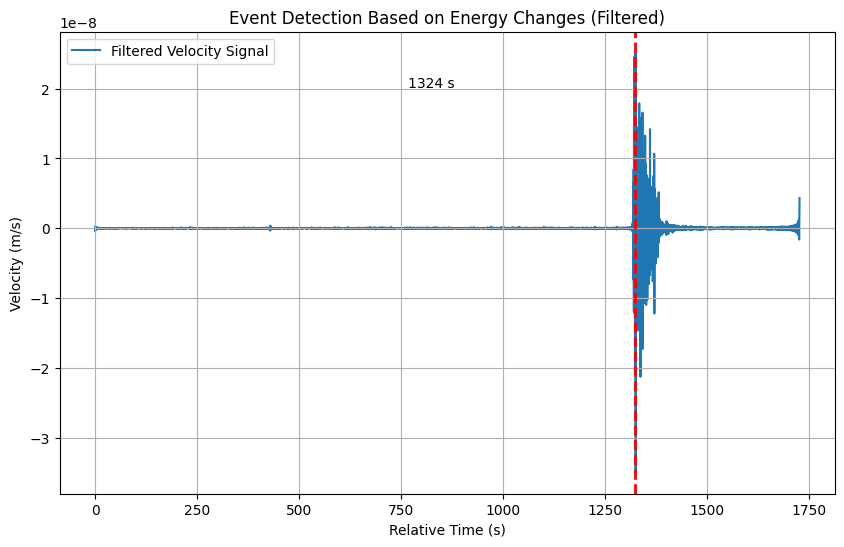

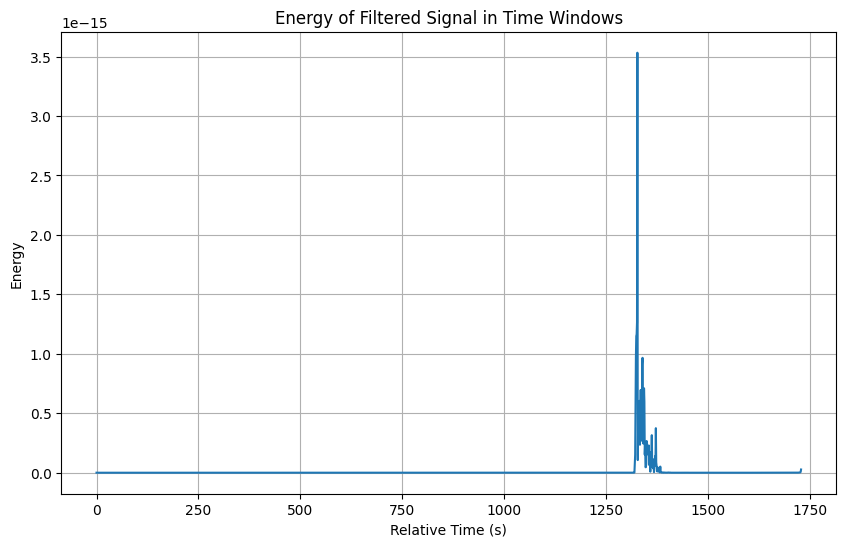

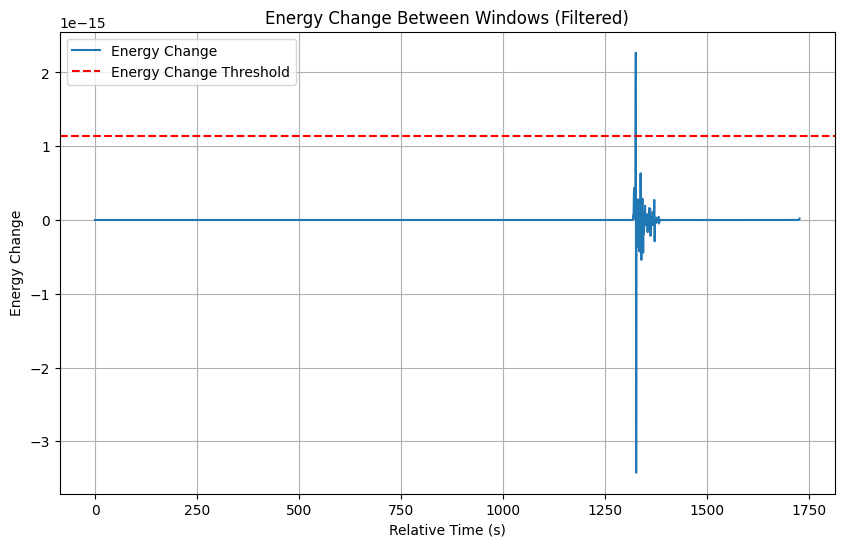

Total signal energy: 1.384868568298927e-13


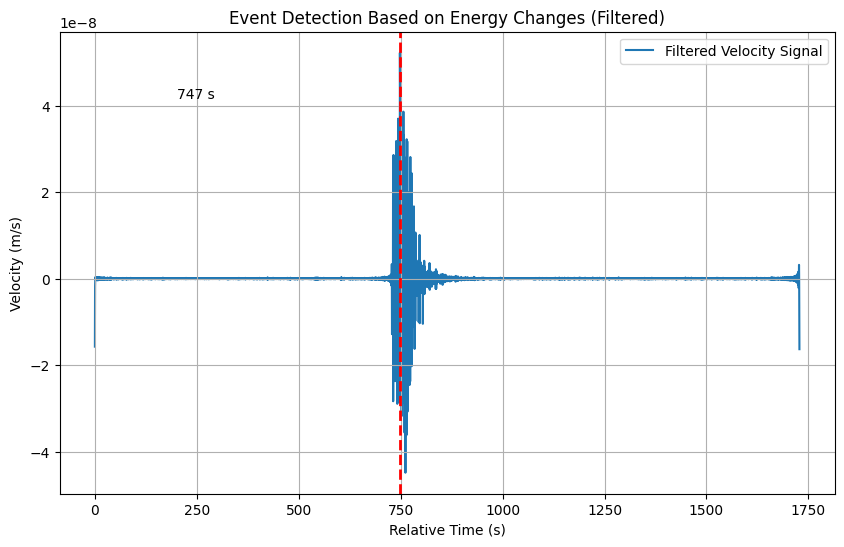

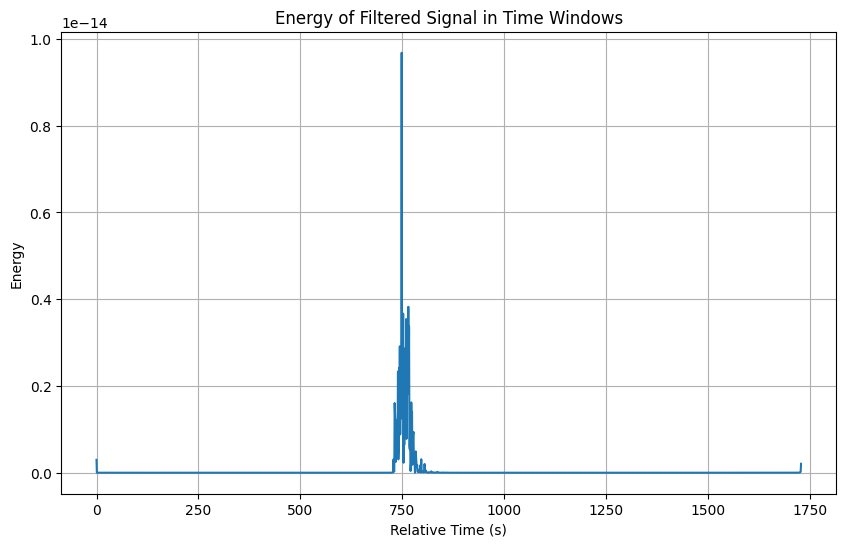

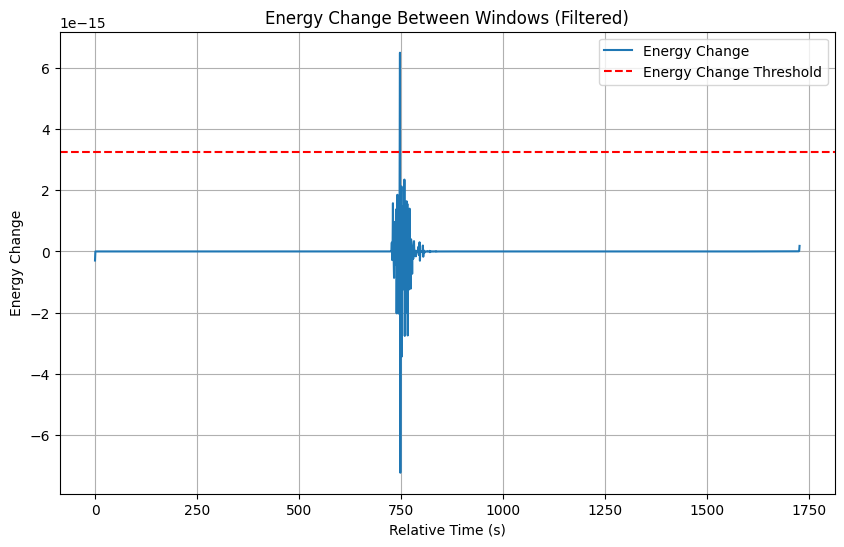

Total signal energy: 2.6690119308818075e-16


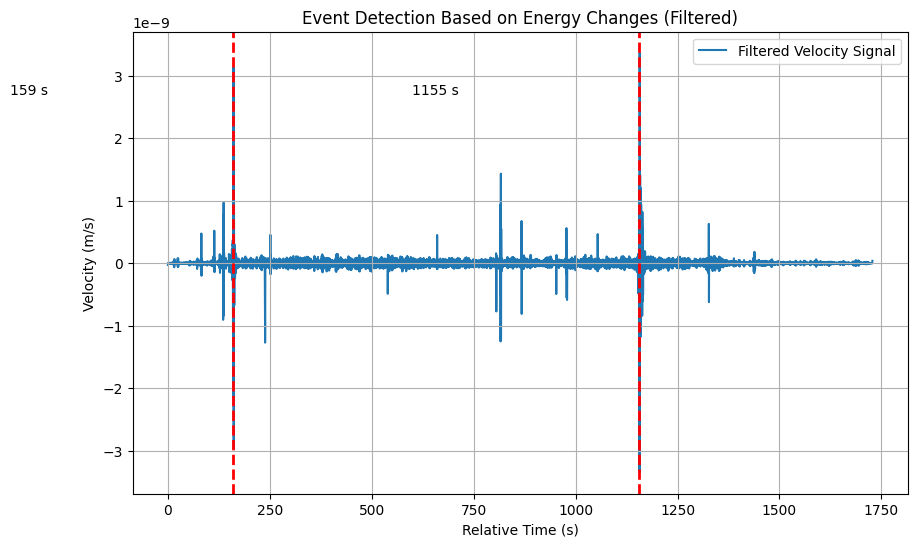

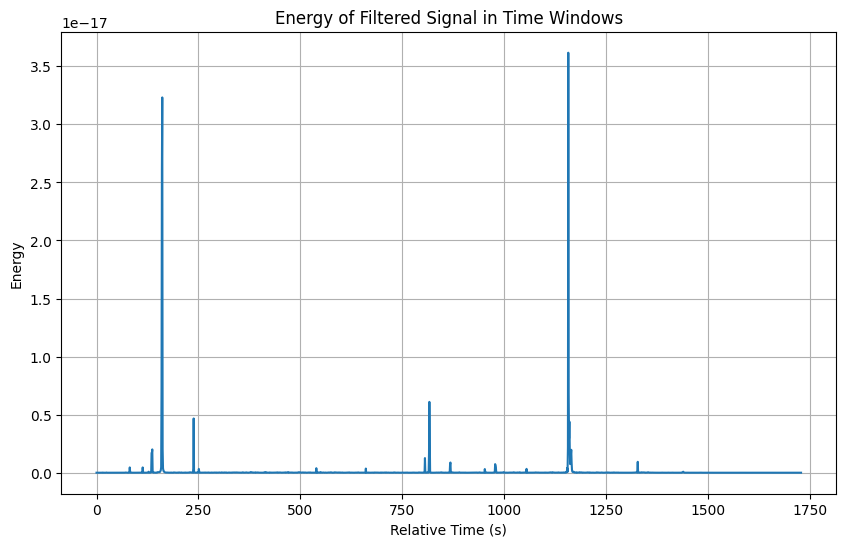

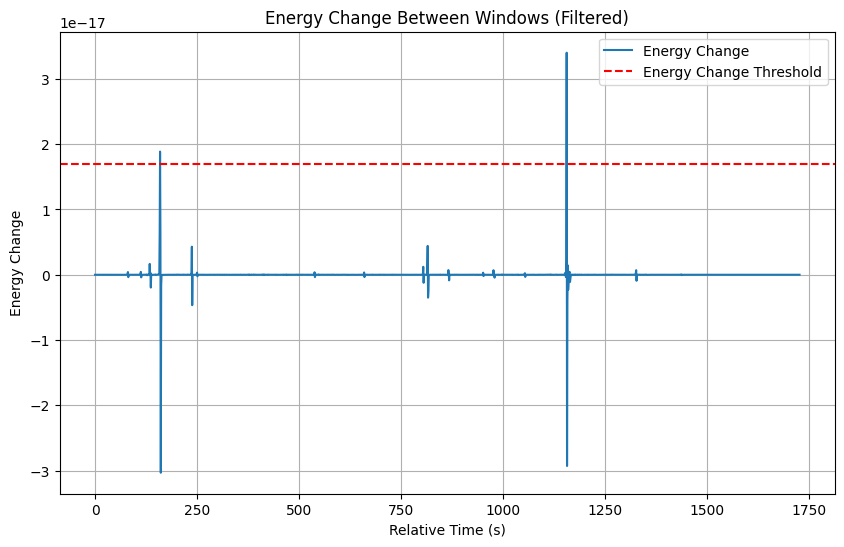

Total signal energy: 2.2003262910872473e-16


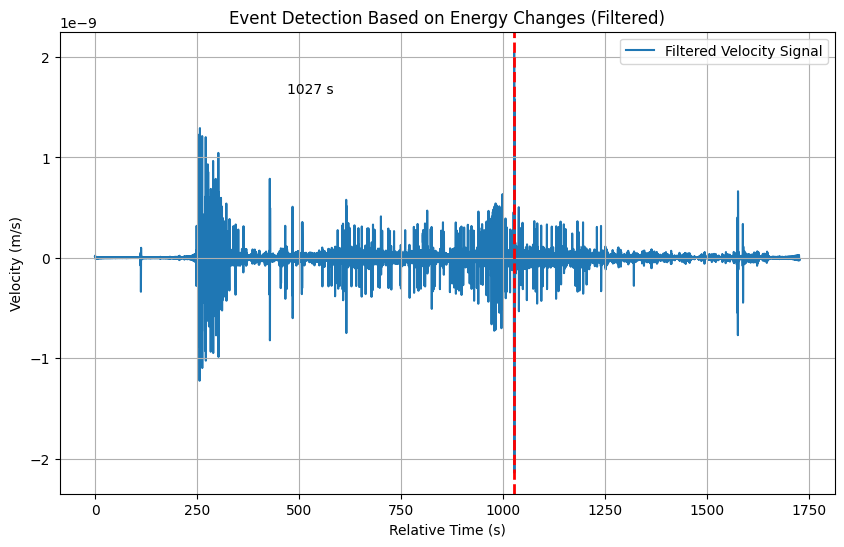

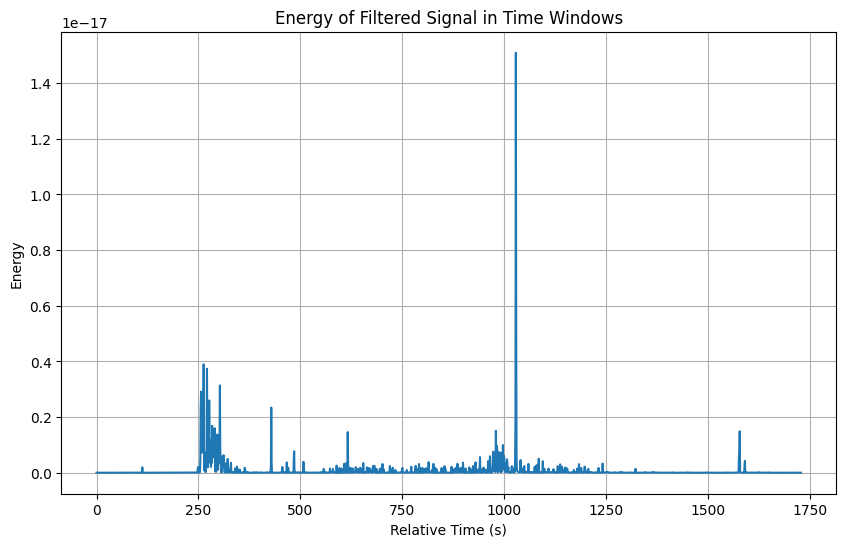

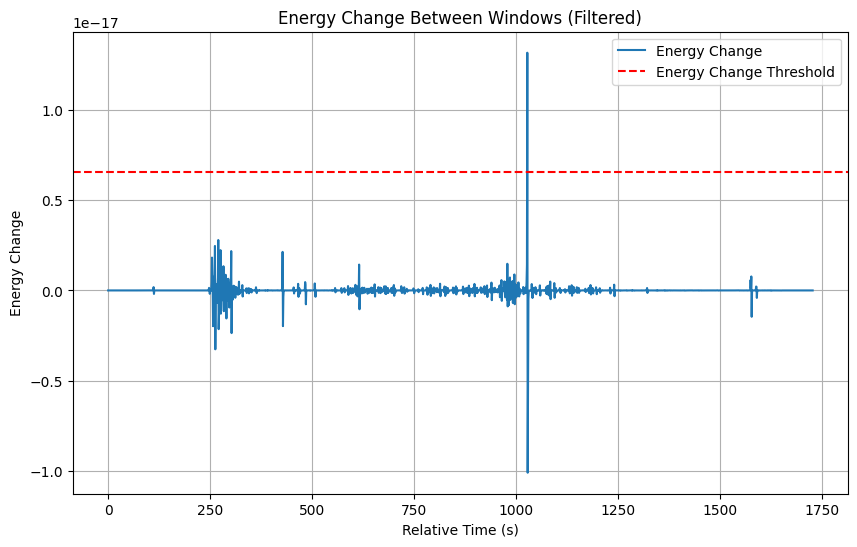

In [56]:
df_det1, df_det2 = [],[]
for df in bigDFmoon:
  # Extraction of relative time and velocity columns
  relative_time = df['time_rel(sec)'].values
  velocity = df['velocity(m/s)'].values

  # Basic signal parameters
  fs = 1/(relative_time[1]-relative_time[0])  # Sampling frequency
  window_size = int(fs * 5000)  # Window size of 1 second to calculate energy

  def butter_bandpass(lowcut, highcut, fs, order=5):
    nyquist = 0.5 * fs  # Nyquist frequency is half the sampling frequency
    low = lowcut / nyquist
    high = highcut / nyquist
    b, a = butter(order, [low, high], btype='band')
    return b, a

  total_energy = sum(velocity ** 2)
  print(f"Total signal energy: {total_energy}")

  # Function to apply a low-pass filter
  def butter_lowpass_filter(data, cutoff, fs, order=5):
      nyquist = 0.5 * fs  # Nyquist frequency
      normal_cutoff = cutoff / nyquist  # Normalize the cutoff frequency
      if normal_cutoff <= 0 or normal_cutoff >= 1:
          raise ValueError(f"Cutoff frequency must be between 0 and 1. Received: {normal_cutoff}")
      b, a = butter(order, normal_cutoff, btype='low', analog=False)
      y = filtfilt(b, a, data)  # Apply the filter
      return y

  sampling_rate = 6.625
 # Low-pass filter parameters
  cutoff = 2.0  # Cutoff frequency set to 2 Hz, lower than the Nyquist frequency
  order = 4     # Filter order

  # Basic signal parameters
  fs = sampling_rate  # Sampling frequency
  window_size = int(fs * 1)  # Window size of 1 second to calculate energy

  # 1. Apply the low-pass filter to the velocity signal
  filtered_velocity = butter_lowpass_filter(velocity, cutoff, fs, order)

  # 2. Calculate the energy of the filtered signal in each sliding window
  energies = []
  for i in range(0, len(filtered_velocity) - window_size, window_size):
      window = filtered_velocity[i:i + window_size]
      window_energy = np.sum(window ** 2)  # Energy is the sum of squares
      energies.append(window_energy)

  # Convert the list of energies into a numpy array
  energies = np.array(energies)

  # 3. Detect changes in energy
  energy_changes = np.diff(energies)  # Calculate the energy difference between consecutive windows

  # Set an energy change threshold based on a percentage of the maximum energy change
  energy_change_threshold = 0.5 * np.max(energy_changes)  # 50% of the maximum change threshold

  # Detect events where the energy change exceeds the threshold
  detected_events = np.where(energy_changes > energy_change_threshold)[0]

  # Select the events with the most significant energy changes
  important_events = detected_events[np.argsort(energy_changes[detected_events])[::-1]]  # Sort from largest to smallest

  # Filter nearby events to avoid false positives
  min_separation = 500  # At least 1 second separation between events
  filtered_events = [detected_events[0]] if len(detected_events) > 0 else []

  for i in range(1, len(detected_events)):
      if detected_events[i] - filtered_events[-1] > min_separation:
          filtered_events.append(detected_events[i])

  # Limit the events to the two most significant ones
  filtered_events = filtered_events[:2]
  df_det1.append(filtered_events[0]*50)
  if len(filtered_events) > 1:
    df_det2.append(filtered_events[1]*50)
  else:
    df_det2.append(0)

  # Plot the original signal and the detected events with vertical lines and labeled times
  time = np.arange(len(velocity)) / fs
  event_times = np.array(filtered_events) * window_size / fs  # Convert indices to time

  plt.figure(figsize=(10, 6))
  plt.plot(time, filtered_velocity, label="Filtered Velocity Signal", zorder=1)

  # Add lines and labels for the detected events
  for i, event_time in enumerate(event_times):
      plt.axvline(x=event_time, color='red', linestyle='--', linewidth=2)  # Vertical line
      plt.text(event_time - 500, max(filtered_velocity) * 0.8,  # Place text to the left
              f"{int(event_time)} s", color='black', ha='center', rotation=0, fontsize=10)

  plt.xlabel("Relative Time (s)")
  plt.ylabel("Velocity (m/s)")
  plt.title("Event Detection Based on Energy Changes (Filtered)")
  plt.legend()
  plt.grid(True)
  plt.show()

  # Plot the energies and energy changes
  window_times = np.arange(len(energies)) * window_size / fs

  plt.figure(figsize=(10, 6))
  plt.plot(window_times, energies, label="Energy in Windows")
  plt.xlabel("Relative Time (s)")
  plt.ylabel("Energy")
  plt.title("Energy of Filtered Signal in Time Windows")
  plt.grid(True)
  plt.show()

  plt.figure(figsize=(10, 6))
  plt.plot(window_times[:-1], energy_changes, label="Energy Change")
  plt.axhline(y=energy_change_threshold, color='r', linestyle='--', label="Energy Change Threshold")
  plt.xlabel("Relative Time (s)")
  plt.ylabel("Energy Change")
  plt.title("Energy Change Between Windows (Filtered)")
  plt.legend()
  plt.grid(True)
  plt.show()


In [52]:
df_out = pd.DataFrame(data = {'filename':df_names, 'main detection(sec)': df_det1, 'posible detection(sec)': df_det2})

In [53]:
df_out.to_csv('detections.csv')
import google.colab.files
google.colab.files.download('detections.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>